In [26]:
import numpy as np
import matplotlib.pyplot as plt
import joblib
from sklearn.ensemble import RandomForestClassifier
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split, KFold
import sys
import json
import pickle
import os
from os import listdir
from os.path import isfile, join
import pandas as pd
from deslib.util.instance_hardness import kdn_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
from sklearn.naive_bayes import BernoulliNB, GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.datasets import make_classification
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_auc_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
from tabulate import tabulate
from tqdm import tqdm
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from deslib.dcs import OLA
# from deslib.dcs import KNORA_U, KNORA_E
from deslib.des import  KNOP, METADES
from deslib.static import SingleBest, StackedClassifier
from deslib.static import StaticSelection
from imblearn.metrics import geometric_mean_score
# from pyhard import HardMetrics

In [2]:
FEATURES_SET = {
    "feature": 1,
    "permission": 2,
    "activity": 3,
    "service_receiver": 3,
    "provider": 3,
    "service": 3,
    "intent": 4,
    "api_call": 5,
    "real_permission": 6,
    "call": 7,
    "url": 8
}


def count_feature_set(lines):
    """
    Count how many features belong to a specific set
    :param lines: features in the text file
    :return:
    """
    features_map = {x: 0 for x in range(1, 9)}
    for l in lines:
        if l != "\n":
            set = l.split("::")[0]
            features_map[FEATURES_SET[set]] += 1
    features = []
    for i in range(1, 9):
        features.append(features_map[i])
    return features


In [3]:
def read(LOAD_DATA=False):
    if LOAD_DATA:
        print("Previous data not loaded. Attempt to read data ...")
        mypath = r"Drebin\MetaData\feature_vectors\feature_vectors"
        onlyfiles = [f for f in listdir(mypath) if isfile(join(mypath, f))]

        print("Reading csv file for ground truth ...")
        ground_truth = np.loadtxt(r"Drebin\MetaData\sha256_family.csv", delimiter=",", skiprows=1, dtype=str)
        # print ground_truth.shape
        # families = np.unique(ground_truth[:, 1])
        # print families
        # print len(families)

        print("Reading positive and negative texts ...")
        pos = []
        neg = []
        for virus in tqdm(onlyfiles):
            if virus in ground_truth[:, 0]:
                pos.append(virus)
            else:
                neg.append(virus)

        print("Extracting features ...")
        x = []
        y = []
        for text_file in tqdm(pos):
            sys.stdin = open("%s/%s" % (mypath, text_file))
            features = sys.stdin.readlines()
            sample = count_feature_set(features)
            x.append(sample)
            y.append(1)

        for text_file in tqdm(neg):
            sys.stdin = open("%s/%s" % (mypath, text_file))
            features = sys.stdin.readlines()
            sample = count_feature_set(features)
            x.append(sample)
            y.append(0)

        print("Data is read successfully:")
        x = np.array(x)
        y = np.array(y)
        print(x.shape, y.shape)

        print("Saving data under data_numpy directory ...")
        np.save(r"x_all.npy", x)
        np.save(r"y_all.npy", y)

        return x, y
    else:
        print("Loading previous data ...")
        x_ = np.load(r"x_all.npy")
        y_ = np.load(r"y_all.npy")
        print(x_.shape, y_.shape)
        # print x == x_, y == y_
        return x_, y_


def map_family_to_category(families):
    out = {}
    count = 1
    for family in families:
        out[family] = count
        count += 1
    return out


if __name__ == "__main__":
    #x, y = read(LOAD_DATA=True)
    x, y = read()

Loading previous data ...
(129013, 8) (129013,)


In [56]:
# import json

# x0, y0 = read(LOAD_DATA=False)

# y_dict = {}

# for random_state in range(30):
#         x_train, x_test, y_train, y_test = train_test_split(
#                 np.arange(len(x0)), y0, test_size=0.2, stratify=y0, random_state=random_state)
        
#         y_dict[f'seed-{random_state}'] = {f'index-{int(key)}': int(value) for key, value in zip(x_test, y_test)}

# with open('y_dict.json', 'w') as json_file:
#         json.dump(y_dict, json_file, indent=4)

# # y_dict

Loading previous data ...
(129013, 8) (129013,)


In [42]:
# import numpy as np
# from sklearn.model_selection import train_test_split
# from deslib.util.instance_hardness import kdn_score
# import json
# from sklearn.neighbors import NearestNeighbors

# test_kdn_scores = {}

# x0, y0 = read(LOAD_DATA= False)

# def calculate_kdn_for_seed(random_state, x0, y0, k=7, balanced = False):
#     test_kdn_scores[f'seed-{random_state}'] = dict() 
    
#     # Dividir os dados de treino e teste
#     x_train, x_test, y_train, y_test = train_test_split(
#         np.arange(len(x0)), y0, test_size=0.2, stratify=y0, random_state=random_state)
    
#     # Checar o Instance Hardness 
#     if balanced:
#         smote = SMOTE(sampling_strategy='auto', k_neighbors=5, random_state=random_state)
#         x_train_balanced, y_train_balanced = smote.fit_resample(x0[x_train], y_train)
#         x_train_new = np.concatenate([x_train, np.arange(len(x0)-1, (len(x_train_balanced)-len(x_train)+len(x0)))])
#         x0 = np.concatenate([x0, x_train_balanced[len(x_train)-1:]])
#         y_train = np.concatenate([y_train, y_train_balanced[len(y_train)-1:]])
#         x_train = x_train_new
        

#     # Calcular os vizinhos mais próximos usando os dados de treino
#     nbrs = NearestNeighbors(n_neighbors=k, algorithm='kd_tree').fit(x0[x_train])
    
#     # Encontrar os vizinhos mais próximos para os pontos de teste
#     _, indices = nbrs.kneighbors(x0[x_test])
    
#     # Calcular o KDN score para cada ponto de teste
#     for i, idxs in enumerate(indices):
#         # Verificar se os k vizinhos pertencem a uma classe diferente
#         diff_class = y_train[idxs] != y_test[i]
#         score = np.sum(diff_class) / k
        
#         # Armazenar o resultado no dicionário
#         test_kdn_scores[f'seed-{random_state}'][f'index-{int(x_test[i])}'] = score

#     if balanced:
#         with open('test_kdn_scores_balanced.json', 'w') as json_file:
#             json.dump(test_kdn_scores, json_file, indent=4)
#     else:
#          with open('test_kdn_scores_unbalanced.json', 'w') as json_file:
#             json.dump(test_kdn_scores, json_file, indent=4)


# # Calcular o KDN score para diferentes sementes
# for seed in range(30):
#     calculate_kdn_for_seed(seed, x0, y0, k=7, balanced= False)

# for seed in range(30):
#     calculate_kdn_for_seed(seed, x0, y0, k=7, balanced= True)    

Loading previous data ...
(129013, 8) (129013,)


KeyboardInterrupt: 

In [46]:
# x_train, x_test, y_train, y_test = train_test_split(
#                 np.arange(len(x0)), y0, test_size=0.2, stratify=y0, random_state=0)

# path = r'E:\DrebinStudy\Balanced\DecisionTree\model_1.joblib'

# model = joblib.load(path)
# y_pred = model.predict(x0[x_test])
# indices_diferentes = np.where(y_pred != y_test)[0].tolist()

# x_test[indices_diferentes], x_test

(array([ 46263,   1481,   2898,  33401,    737,  42257,  44721,   4192,
         20816,  75829,  20353,  83143,  66912,  94611,   5249,   4232,
        124227,  98882,   2512, 110373,   9987, 101705,  48813,  93633,
        105716,  36620,  22842,  23893, 128519,  11351, 109961,   1298,
         94184,   3955,  19436,   8474,  78381,  48315, 112759,  47184,
         94888,    596, 106265, 103309,  69073,  36252,   1978,  41992,
         86137,  87917,  31711,  81094, 114429,  84724,  74373,  36466,
         62469,  43354,   7587,  77416, 123257,  53808, 116292,   3206,
        103538, 122661,  76925, 124306,  84869,   1336,  49673,  74057,
         70961,   2298,  35016, 107093, 110484,  72069, 105049,   4105,
         48370,  57333,  79753,   1507,  38185,  83017,  25349,   4216,
         89964,  27814,  47138,  31063,   5562,  27128,   4933, 122634,
        105094,  49405,  87680, 108961,  41586,   3186, 126470, 120697,
        115252,   4900,  56008,  91180,  12483,   2435,    326, 

Loading previous data ...
(129013, 8) (129013,)
Processando pasta: BaggingDecisionTree
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\BaggingDecisionTree\model_1.joblib


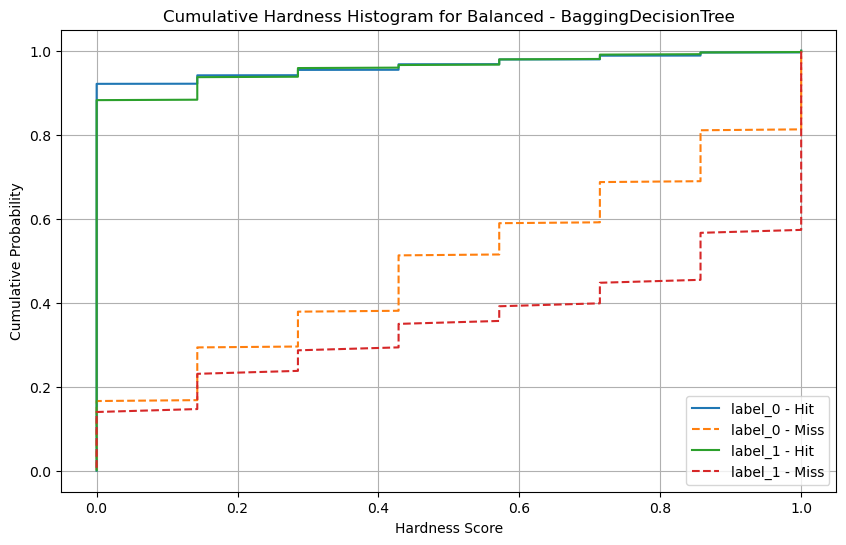

Processando pasta: BaggingKnn
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\BaggingKnn\model_1.joblib


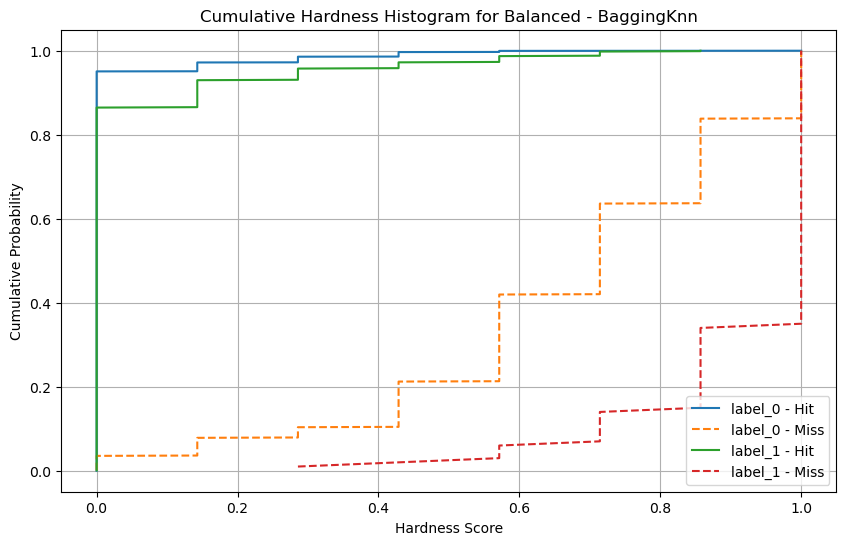

Processando pasta: BaggingMLP
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\BaggingMLP\model_1.joblib


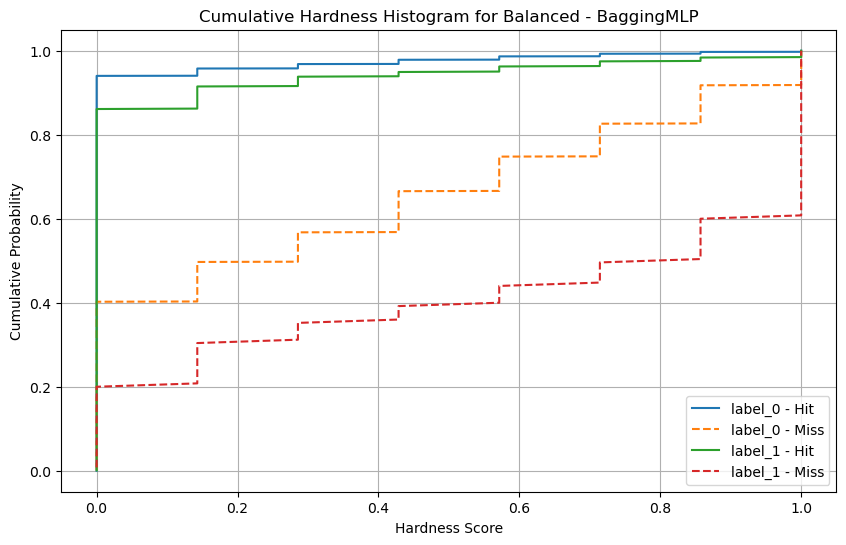

Processando pasta: BaggingNaiveBayes
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\BaggingNaiveBayes\model_1.joblib


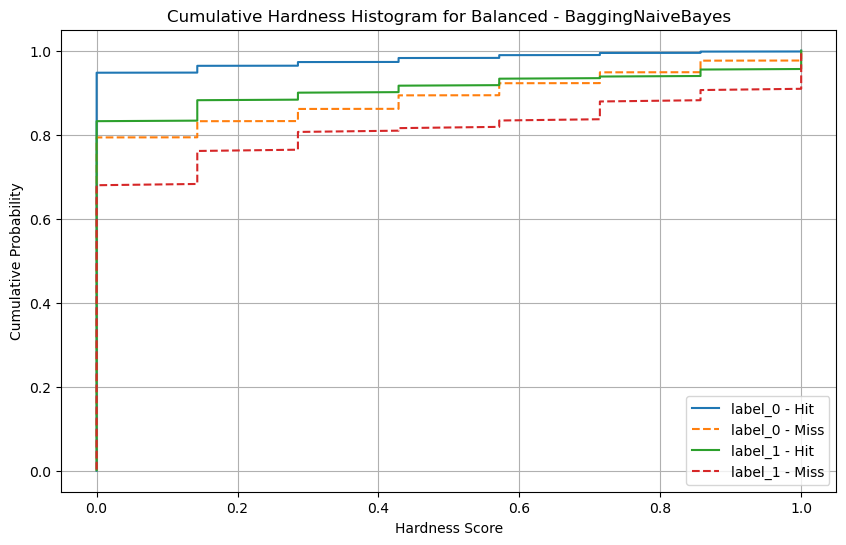

Processando pasta: DecisionTree
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\DecisionTree\model_1.joblib


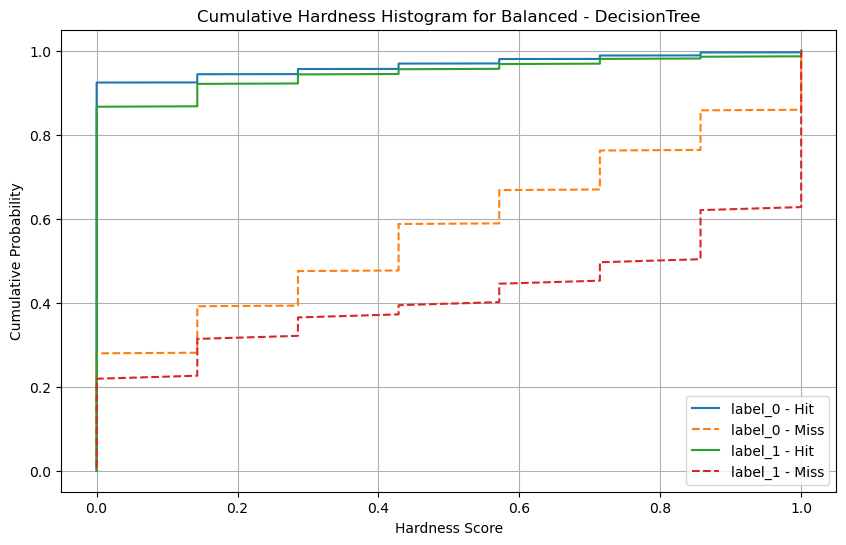

Processando pasta: GradientBoostedDecisionTree
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\GradientBoostedDecisionTree\model_1.joblib


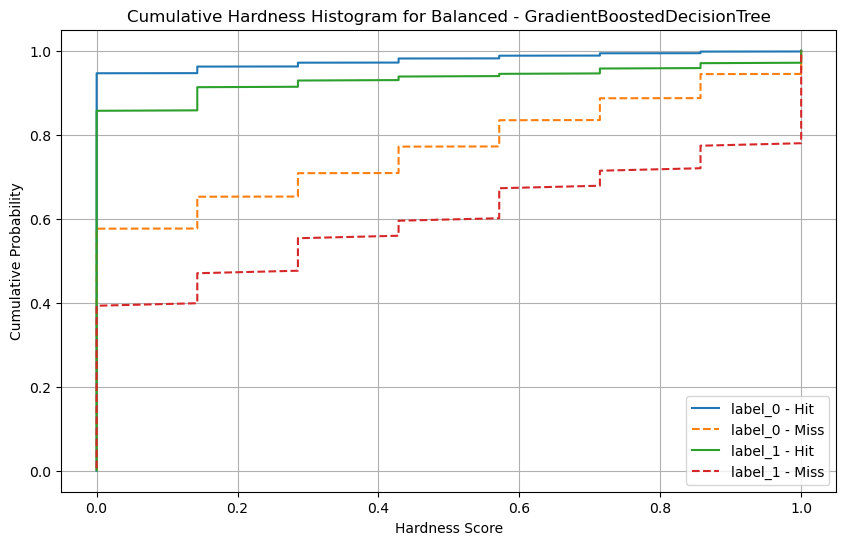

Processando pasta: Knn
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Knn\model_1.joblib


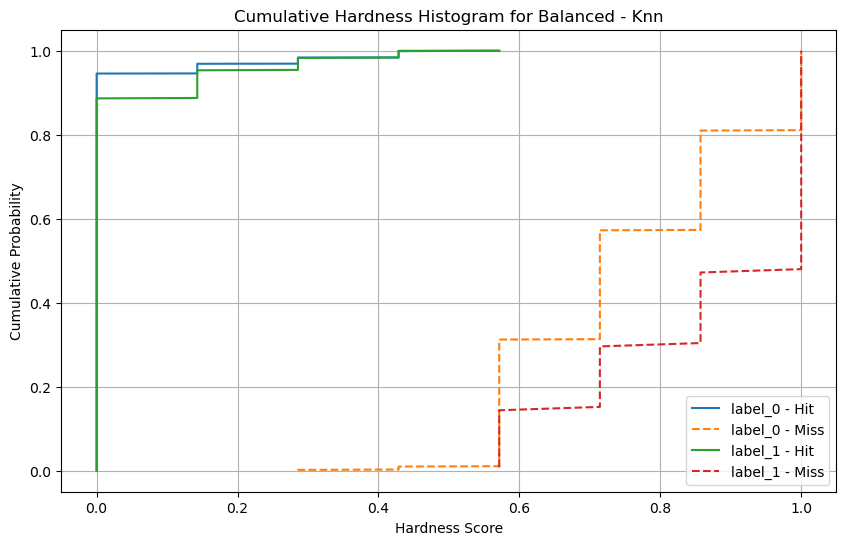

Processando pasta: MLP
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_1.joblib


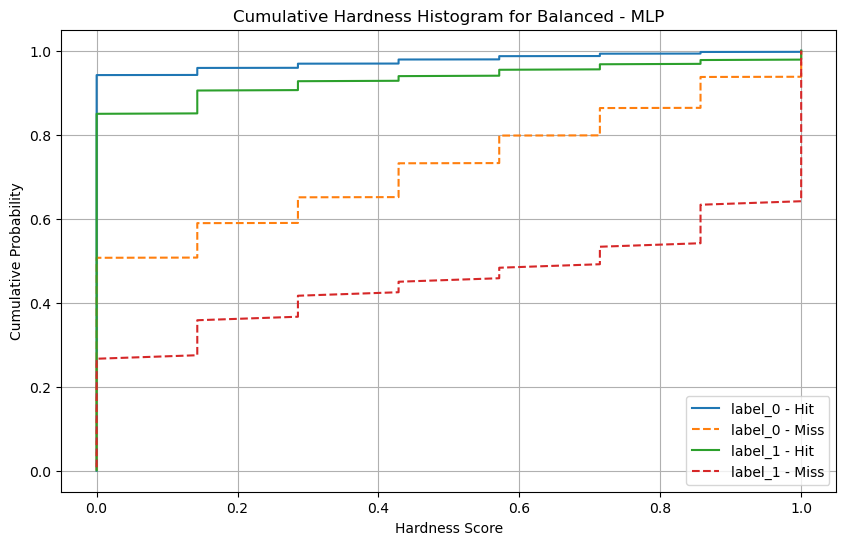

Processando pasta: NaiveBayes
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_1.joblib


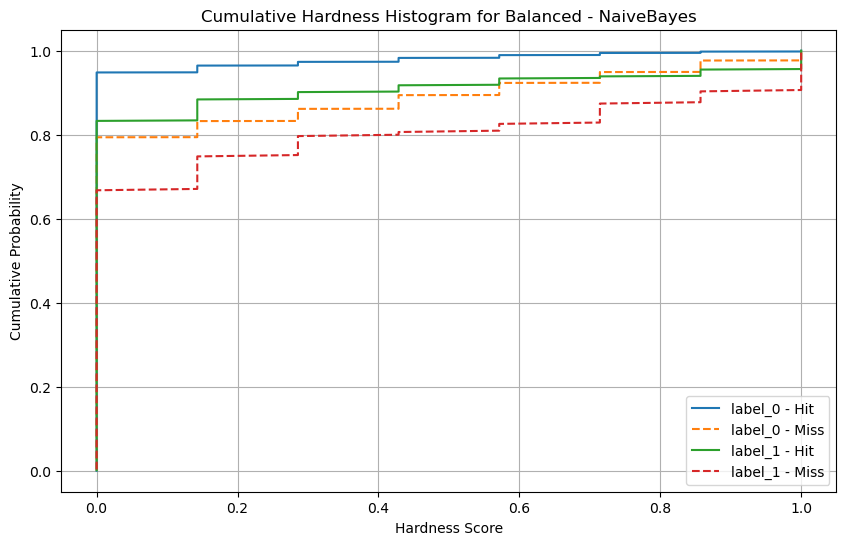

Processando pasta: RandomForest
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_1.joblib


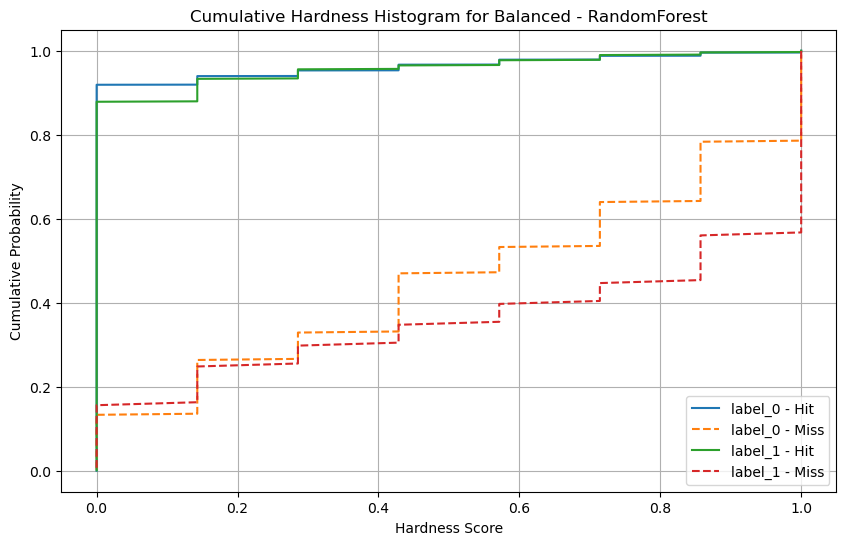

In [12]:
import os
import joblib
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

models = {}

# Função para ler os dados
x0, y0 = read(LOAD_DATA=False)

model_predict = {}

# Caminho do diretório com os modelos
dir_path = r'E:\DrebinStudy\Balanced'

def natural_sort_key(s):
    return int(s[6:-7])

with open('test_kdn_scores_balanced.json', 'r') as f:
    kdn_scores = json.load(f)

# Função para criar o gráfico cumulativo para uma seed específica
def plot_cumulative_histogram_single_seed(hardness_table, seed, title):
    plt.figure(figsize=(10, 6))

    for label in ['label_0', 'label_1']:
        # Hits para a seed especificada
        hit_scores = hardness_table[label]['Hit'][seed]
        sorted_hits = np.sort(hit_scores)
        cumulative_hits = np.arange(1, len(sorted_hits) + 1) / len(sorted_hits)
        plt.plot(sorted_hits, cumulative_hits, label=f"{label} - Hit")

        # Misses para a seed especificada
        miss_scores = hardness_table[label]['Miss'][seed]
        sorted_misses = np.sort(miss_scores)
        cumulative_misses = np.arange(1, len(sorted_misses) + 1) / len(sorted_misses)
        plt.plot(sorted_misses, cumulative_misses, label=f"{label} - Miss", linestyle='--')

    # Configurações do gráfico
    plt.title(f'Cumulative Hardness Histogram for {title}')
    plt.xlabel('Hardness Score')
    plt.ylabel('Cumulative Probability')
    plt.legend()
    plt.grid(True)
    plt.show()

# Loop para percorrer todas as pastas no diretório (tirando 'Metrics')
for folder_name in os.listdir(dir_path):
    folder_path = os.path.join(dir_path, folder_name)
    
    # Verifica se é uma pasta e se não é a pasta 'Metrics'
    if os.path.isdir(folder_path) and folder_name != 'Metrics' and folder_name != 'Bagging2' and folder_name != 'OLA' and folder_name != 'METADES' and folder_name != 'KNOP' and folder_name != 'SingleBest' and folder_name != 'StaticSelection':
        print(f'Processando pasta: {folder_name}')
        i = 0
        hardness_table = {'label_0': {'Hit':{}, 'Miss':{}}, 'label_1': {'Hit':{}, 'Miss':{}}}

        model_predict[folder_path] = dict()
        # Processar os modelos dentro da pasta
        lisdta = sorted(os.listdir(folder_path), key=natural_sort_key)
        print(lisdta)
        for file_name in lisdta[:1]:

            file_path = os.path.join(folder_path, file_name)
            x_train, x_test, y_train, y_test = train_test_split(
                np.arange(len(x0)), y0, test_size=0.2, stratify=y0, random_state=i)
            hardness_score = np.array(list(kdn_scores[f"seed-{i}"].values()))
            
            model = joblib.load(file_path)
            y_pred = model.predict(x0[x_test])
            indices_diferentes = np.where(y_pred != y_test)[0].tolist()

            model_predict[folder_path][file_name] = indices_diferentes

            with open("modelPredictBalanced.json", "w") as file:
                json.dump(model_predict, file, indent=4)

            # Separar os scores por label
            for label in [0, 1]:
                hit_scores = hardness_score[(y_test == y_pred) & (y_test == label)]
                miss_scores = hardness_score[(y_test != y_pred) & (y_test == label)]
                hardness_table[f'label_{label}']['Hit'][f'seed-{str(i)}'] = hit_scores
                hardness_table[f'label_{label}']['Miss'][f'seed-{str(i)}'] = miss_scores

            print(f"Hardness médio para seed-{i}: {np.mean(hardness_score):.4f}")
            i += 1   
            print(f'Arquivo de modelo encontrado: {file_path}')
            
            # Gerar gráfico cumulativo para o modelo atual
            plot_cumulative_histogram_single_seed(hardness_table, f'seed-{i-1}', f'Balanced - {file_path[24:-15]}')  # Mostrar para o último seed processado
        
        # Salvar a hardness_table por pasta
        models[folder_name] = hardness_table

Loading previous data ...
(129013, 8) (129013,)
Processando pasta: BaggingDecisionTree
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_1.joblib


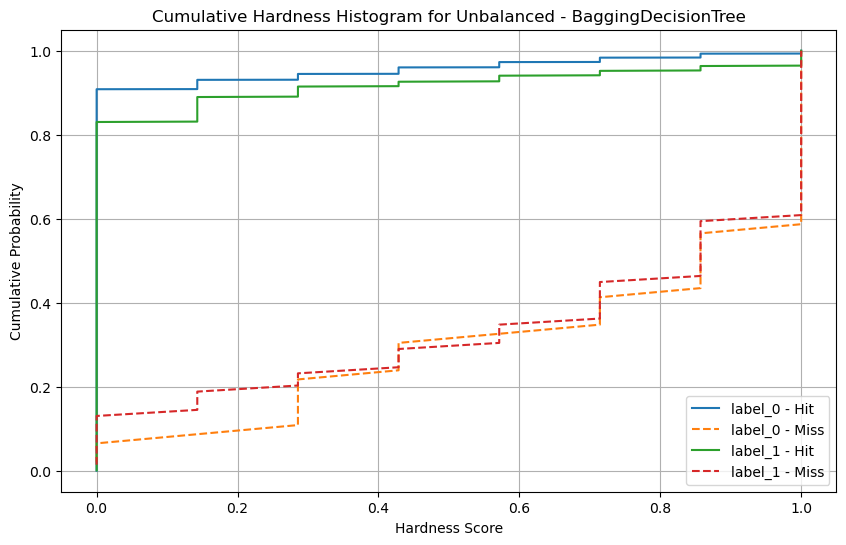

Processando pasta: BaggingKnn
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_1.joblib


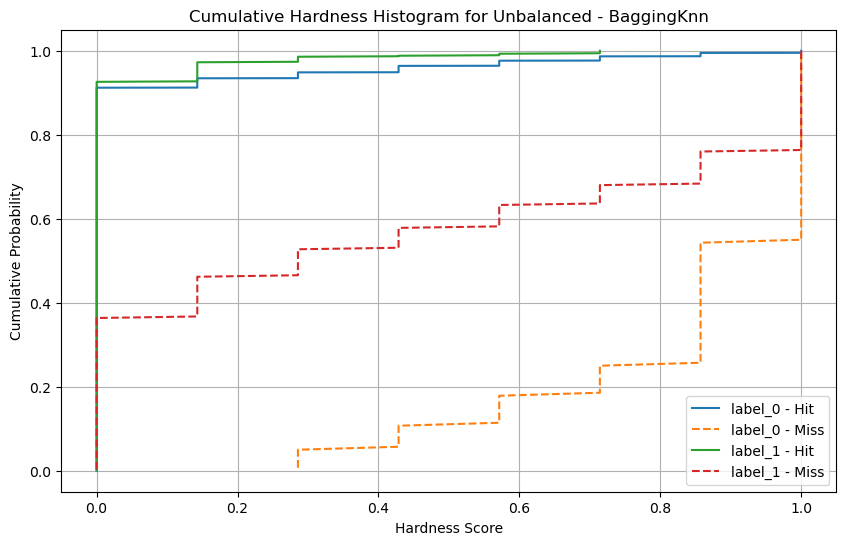

Processando pasta: BaggingMLP
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_1.joblib


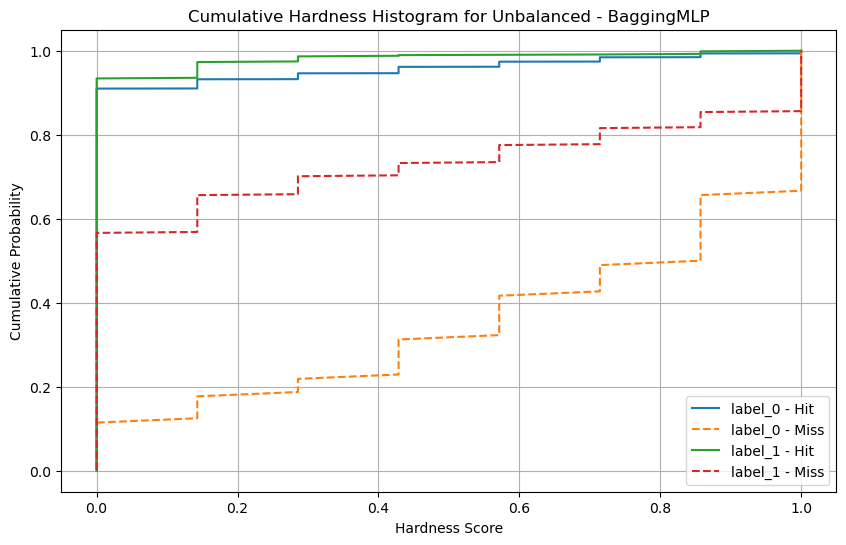

Processando pasta: BaggingNaiveBayes
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_1.joblib


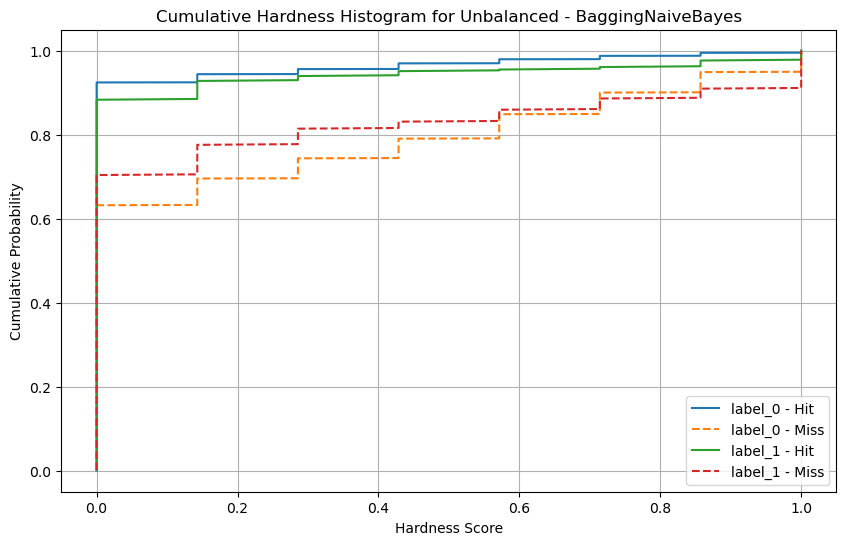

Processando pasta: DecisionTree
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_1.joblib


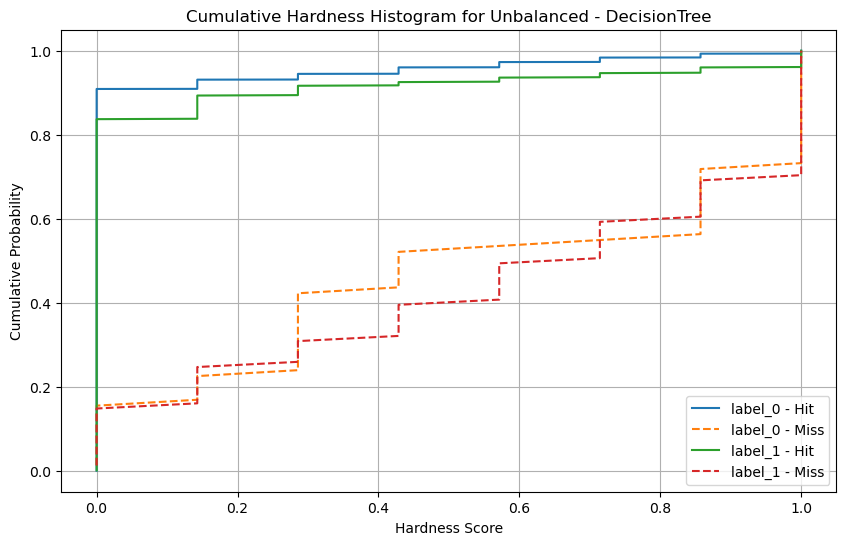

Processando pasta: GradientBoostedDecisionTree
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_1.joblib


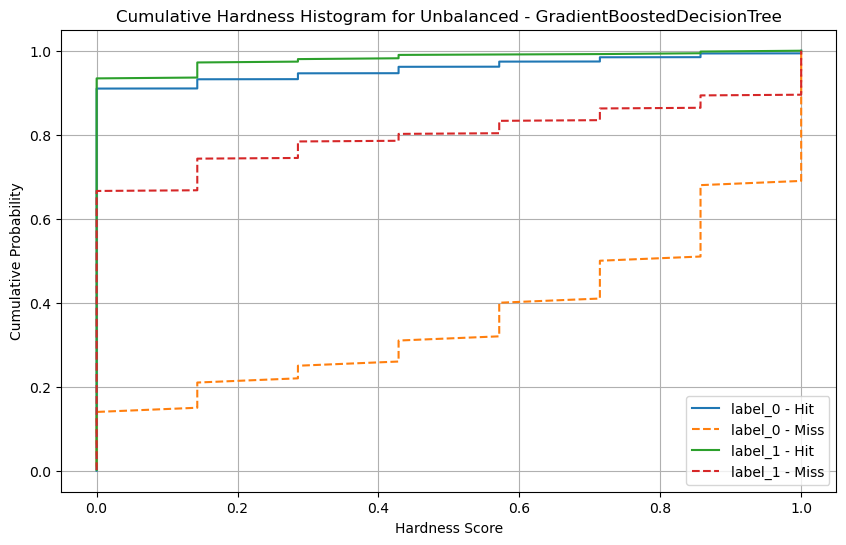

Processando pasta: Knn
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_1.joblib


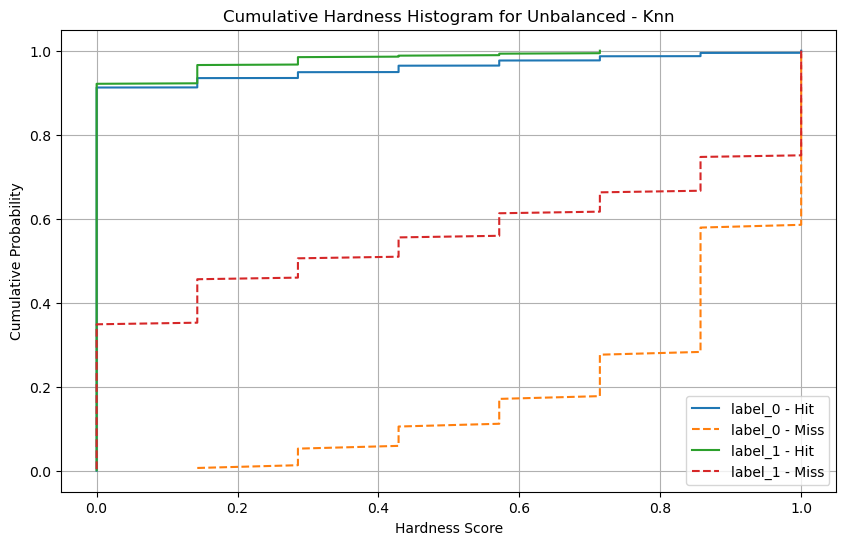

Processando pasta: MLP
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_1.joblib


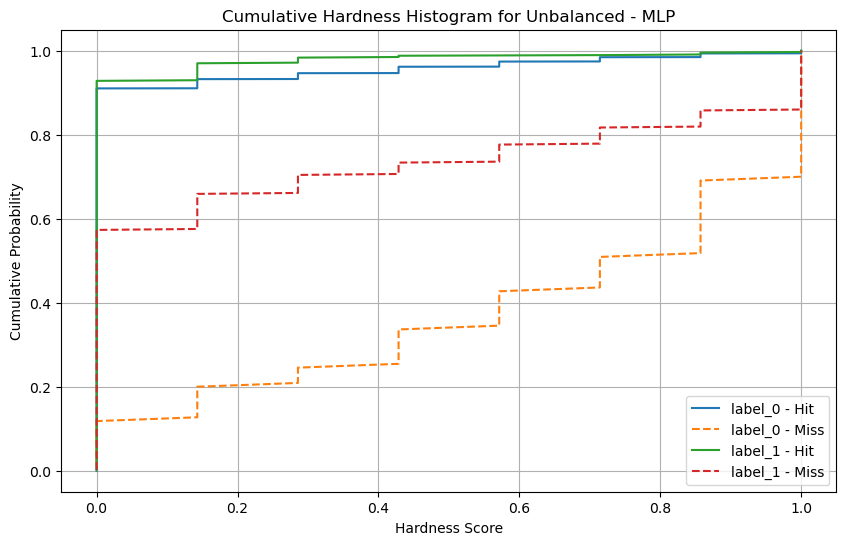

Processando pasta: NaiveBayes
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_1.joblib


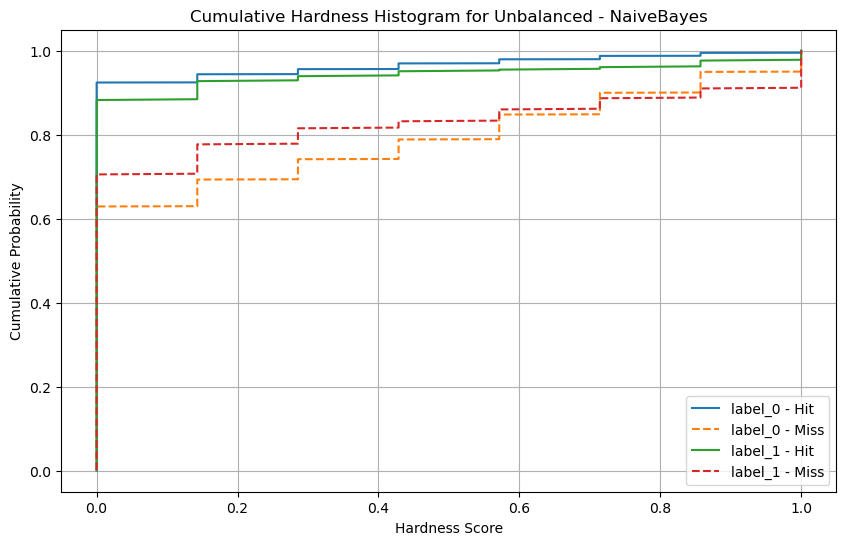

Processando pasta: RandomForest
['model_1.joblib', 'model_2.joblib', 'model_3.joblib', 'model_4.joblib', 'model_5.joblib', 'model_6.joblib', 'model_7.joblib', 'model_8.joblib', 'model_9.joblib', 'model_10.joblib', 'model_11.joblib', 'model_12.joblib', 'model_13.joblib', 'model_14.joblib', 'model_15.joblib', 'model_16.joblib', 'model_17.joblib', 'model_18.joblib', 'model_19.joblib', 'model_20.joblib', 'model_21.joblib', 'model_22.joblib', 'model_23.joblib', 'model_24.joblib', 'model_25.joblib', 'model_26.joblib', 'model_27.joblib', 'model_28.joblib', 'model_29.joblib', 'model_30.joblib']
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_1.joblib


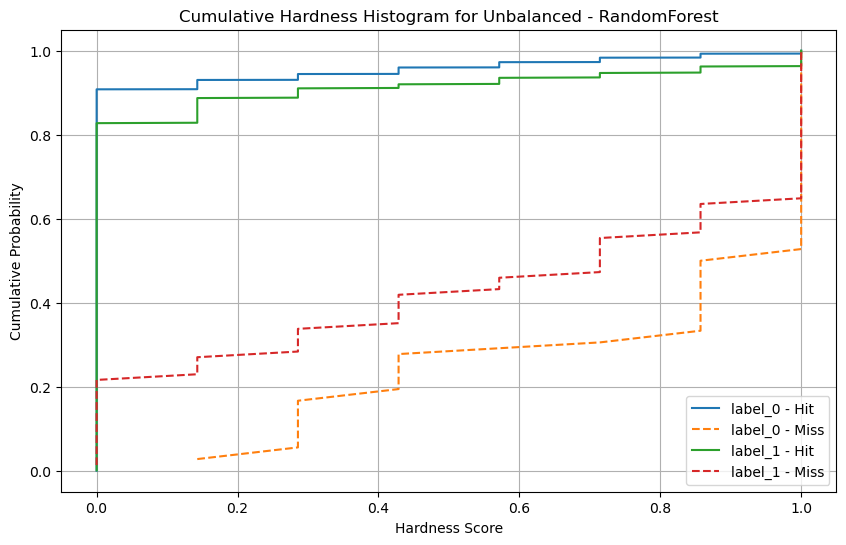

In [14]:
import os
import joblib
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

models = {}

# Função para ler os dados
x0, y0 = read(LOAD_DATA=False)

model_predict = {}

# Caminho do diretório com os modelos
dir_path = r'E:\DrebinStudy\Unbalanced'

def natural_sort_key(s):
    return int(s[6:-7])

with open('test_kdn_scores_balanced.json', 'r') as f:
    kdn_scores = json.load(f)

# Função para criar o gráfico cumulativo para uma seed específica
def plot_cumulative_histogram_single_seed(hardness_table, seed, title):
    plt.figure(figsize=(10, 6))

    for label in ['label_0', 'label_1']:
        # Hits para a seed especificada
        hit_scores = hardness_table[label]['Hit'][seed]
        sorted_hits = np.sort(hit_scores)
        cumulative_hits = np.arange(1, len(sorted_hits) + 1) / len(sorted_hits)
        plt.plot(sorted_hits, cumulative_hits, label=f"{label} - Hit")

        # Misses para a seed especificada
        miss_scores = hardness_table[label]['Miss'][seed]
        sorted_misses = np.sort(miss_scores)
        cumulative_misses = np.arange(1, len(sorted_misses) + 1) / len(sorted_misses)
        plt.plot(sorted_misses, cumulative_misses, label=f"{label} - Miss", linestyle='--')

    # Configurações do gráfico
    plt.title(f'Cumulative Hardness Histogram for {title}')
    plt.xlabel('Hardness Score')
    plt.ylabel('Cumulative Probability')
    plt.legend()
    plt.grid(True)
    plt.show()

# Loop para percorrer todas as pastas no diretório (tirando 'Metrics')
for folder_name in os.listdir(dir_path):
    folder_path = os.path.join(dir_path, folder_name)
    
    # Verifica se é uma pasta e se não é a pasta 'Metrics'
    if os.path.isdir(folder_path) and folder_name != 'Metrics' and folder_name != 'Bagging2' and folder_name != 'OLA' and folder_name != 'METADES' and folder_name != 'KNOP' and folder_name != 'SingleBest' and folder_name != 'StaticSelection':
        print(f'Processando pasta: {folder_name}')
        i = 0
        hardness_table = {'label_0': {'Hit':{}, 'Miss':{}}, 'label_1': {'Hit':{}, 'Miss':{}}}

        model_predict[folder_path] = dict()
        # Processar os modelos dentro da pasta
        lisdta = sorted(os.listdir(folder_path), key=natural_sort_key)
        print(lisdta)
        for file_name in lisdta[:1]:

            file_path = os.path.join(folder_path, file_name)
            x_train, x_test, y_train, y_test = train_test_split(
                np.arange(len(x0)), y0, test_size=0.2, stratify=y0, random_state=i)
            hardness_score = np.array(list(kdn_scores[f"seed-{i}"].values()))
            
            model = joblib.load(file_path)
            y_pred = model.predict(x0[x_test])
            indices_diferentes = np.where(y_pred != y_test)[0].tolist()

            model_predict[folder_path][file_name] = indices_diferentes

            with open("modelPredictBalanced.json", "w") as file:
                json.dump(model_predict, file, indent=4)

            # Separar os scores por label
            for label in [0, 1]:
                hit_scores = hardness_score[(y_test == y_pred) & (y_test == label)]
                miss_scores = hardness_score[(y_test != y_pred) & (y_test == label)]
                hardness_table[f'label_{label}']['Hit'][f'seed-{str(i)}'] = hit_scores
                hardness_table[f'label_{label}']['Miss'][f'seed-{str(i)}'] = miss_scores

            print(f"Hardness médio para seed-{i}: {np.mean(hardness_score):.4f}")
            i += 1   
            print(f'Arquivo de modelo encontrado: {file_path}')
            
            # Gerar gráfico cumulativo para o modelo atual
            plot_cumulative_histogram_single_seed(hardness_table, f'seed-{i-1}', f'Unbalanced - {file_path[26:-15]}')  # Mostrar para o último seed processado
        
        # Salvar a hardness_table por pasta
        models[folder_name] = hardness_table

In [28]:
def CreateDESModel(x_all, y_all, model, modelName, balance, num_rep=30):
    if balance:
        model_dir = os.path.join("E:/DrebinStudy/Balanced", modelName)
    else:
        model_dir = os.path.join("E:/DrebinStudy/Unbalanced", modelName)
    
    os.makedirs(model_dir, exist_ok=True)

    acuracias = []
    precisoes = []
    recalls = []
    f1_scores = []
    roc_auc_scores = []
    gmean_scores = []
    mcc_scores = []
    cohen_scores = []

    for i in tqdm(range(num_rep)):
        x_train, x_test, y_train, y_test = train_test_split(x_all, y_all, test_size=0.2, stratify=y_all, random_state= i)

        if balance:
            smote = SMOTE(sampling_strategy='auto', k_neighbors=5, random_state=i)
            x_train, y_train = smote.fit_resample(x_train, y_train)

        # Train an ensemble of classifiers
        ensemble = RandomForestClassifier(n_estimators=100)
        ensemble.fit(x_train, y_train)

        # Initialize and train the DES model on the training set
        des_model = model(ensemble)
        des_model.fit(x_train, y_train)

        # Make predictions on the test set
        previsoes = des_model.predict(x_test)

        # Avaliar as métricas do modelo e armazenar na lista temporaria
        cm = confusion_matrix(y_test, previsoes)
        acuracia = accuracy_score(y_test, previsoes)
        precisao = precision_score(y_test, previsoes)
        recall = recall_score(y_test, previsoes)
        f1 = f1_score(y_test, previsoes)
        roc_auc = roc_auc_score(y_test, previsoes)
        geoMedia = geometric_mean_score(y_test, previsoes)
        mcc = matthews_corrcoef(y_test, previsoes)
        kappa = cohen_kappa_score(y_test, previsoes)

        
        acuracias.append(acuracia)
        precisoes.append(precisao)
        recalls.append(recall)
        f1_scores.append(f1)
        roc_auc_scores.append(roc_auc)
        gmean_scores.append(geoMedia)
        mcc_scores.append(mcc)
        cohen_scores.append(kappa)
        
        # Salva o modelo treinado
        model_path = os.path.join(model_dir, f'model_{i+1}.pkl')
    
        # Salvando o modelo com pickle
        with open(model_path, 'wb') as file:
            pickle.dump(model, file)

        # plt.figure(figsize=(8, 6))
        # sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
        # plt.xlabel('Predicted')
        # plt.ylabel('Actual')
        # plt.title('Confusion Matrix')
        # plt.show()
        print(f'Repetição {i+1} {modelName} - Acurácia: {acuracia:.2f}, Precisão: {precisao:.2f}, Recall: {recall:.2f}, F1-score: {f1:.2f}, ROC AUC: {roc_auc:.2f}')

    # Criar um DataFrame com as métricas
    metrics_df = pd.DataFrame({
        'Accuracy': [np.mean(acuracias)],
        'Precision': [np.mean(precisoes)],
        'Recall': [np.mean(recalls)],
        'F1_score': [np.mean(f1_scores)],
        'Roc_auc': [np.mean(roc_auc_scores)],
        'G-Mean': [np.mean(gmean_scores)],
        'MCC': [np.mean(mcc_scores)],
        'Cohen_Kappa': [np.mean(cohen_scores)],
        'Accuracy_std': [np.std(acuracias)],
        'Precision_std': [np.std(precisoes)],
        'Recall_std': [np.std(recalls)],
        'F1_score_std': [np.std(f1_scores)],
        'Roc_auc_std': [np.std(roc_auc_scores)],
        'G-Mean_std': [np.std(gmean_scores)],
        'MCC_std': [np.std(mcc_scores)],
        'Cohen_Kappa_std': [np.std(cohen_scores)],
    })


    if balance:
        # Salvar o DataFrame em um arquivo CSV
        csv_path = os.path.join("E:/DrebinStudy/Balanced/Metrics", f'{modelName}_metrics.csv')
        metrics_df.to_csv(csv_path, index=False)
    
    else:
        # Salvar o DataFrame em um arquivo CSV
        csv_path = os.path.join("E:/DrebinStudy/Unbalanced/Metrics", f'{modelName}_metrics.csv')
        metrics_df.to_csv(csv_path, index=False)
    print(f'Métricas salvas em {csv_path}')

Loading previous data ...
(129013, 8) (129013,)
Processando pasta: KNOP
['model_1.pkl', 'model_2.pkl', 'model_3.pkl', 'model_4.pkl', 'model_5.pkl', 'model_6.pkl', 'model_7.pkl', 'model_8.pkl', 'model_9.pkl', 'model_10.pkl', 'model_11.pkl', 'model_12.pkl', 'model_13.pkl', 'model_14.pkl', 'model_15.pkl', 'model_16.pkl', 'model_17.pkl', 'model_18.pkl', 'model_19.pkl', 'model_20.pkl', 'model_21.pkl', 'model_22.pkl', 'model_23.pkl', 'model_24.pkl', 'model_25.pkl', 'model_26.pkl', 'model_27.pkl', 'model_28.pkl', 'model_29.pkl', 'model_30.pkl']


TypeError: BaseDS.predict() missing 1 required positional argument: 'X'

Loading previous data ...
(129013, 8) (129013,)
Processando pasta: BaggingDecisionTree
Processando pasta: BaggingKnn
Processando pasta: BaggingMLP
Processando pasta: BaggingNaiveBayes
Processando pasta: DecisionTree
Processando pasta: GradientBoostedDecisionTree
Processando pasta: Knn
Processando pasta: MLP
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_1.joblib


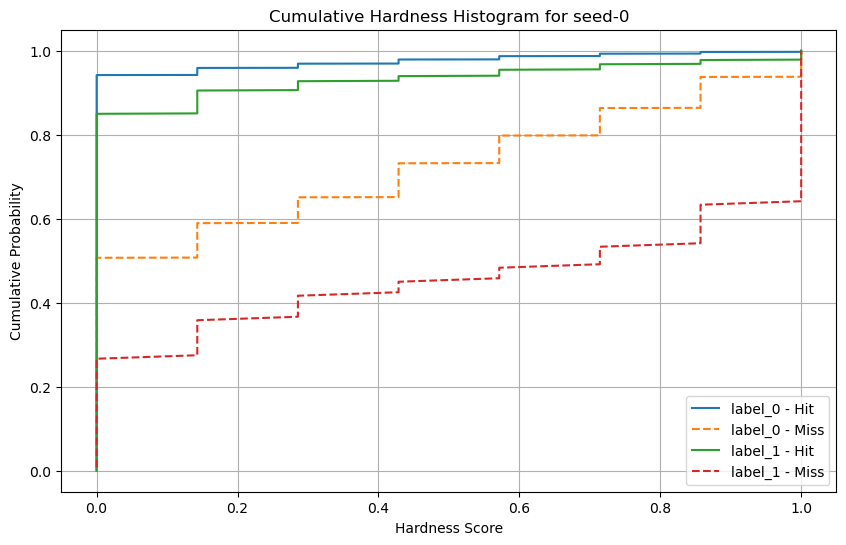

Hardness médio para seed-1: 0.0476
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_2.joblib


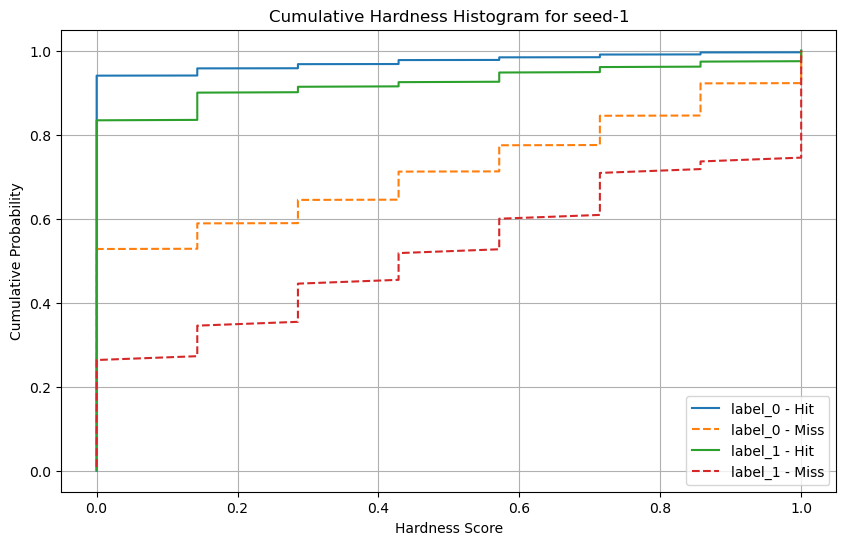

Hardness médio para seed-2: 0.0470
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_3.joblib


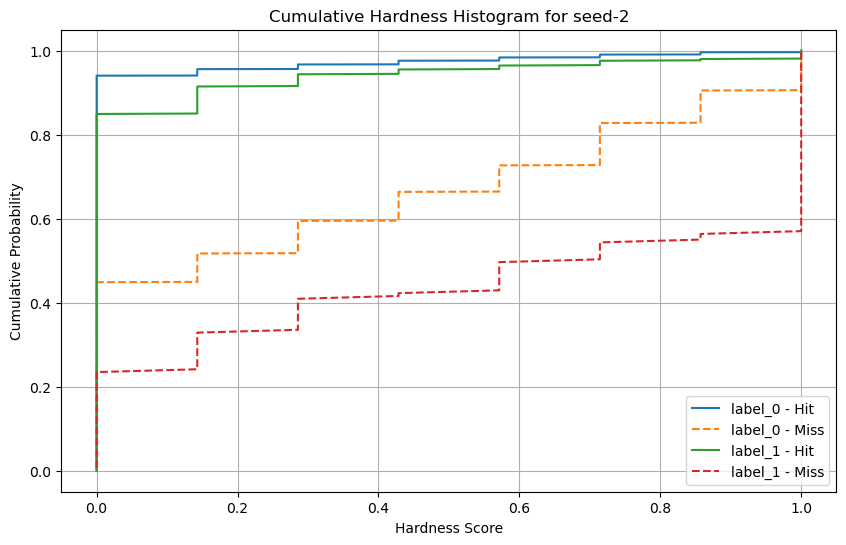

Hardness médio para seed-3: 0.0468
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_4.joblib


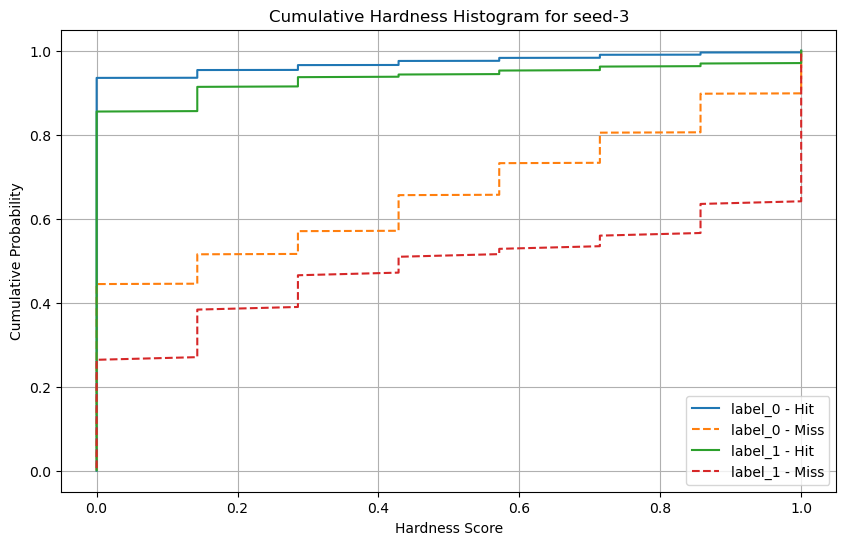

Hardness médio para seed-4: 0.0464
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_5.joblib


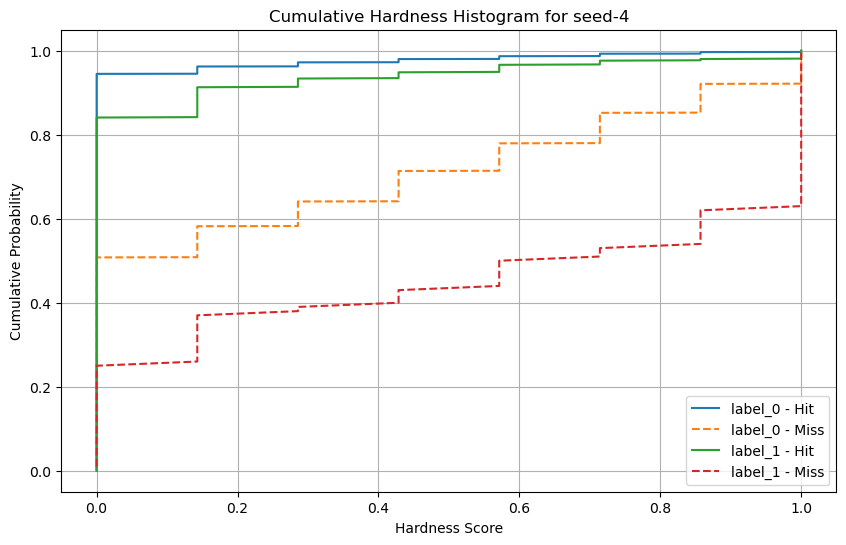

Hardness médio para seed-5: 0.0478
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_6.joblib


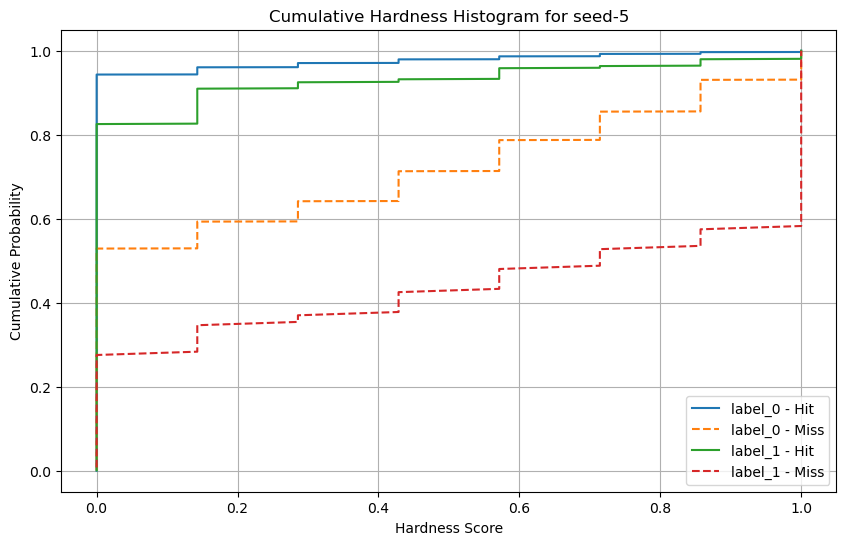

Hardness médio para seed-6: 0.0482
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_7.joblib


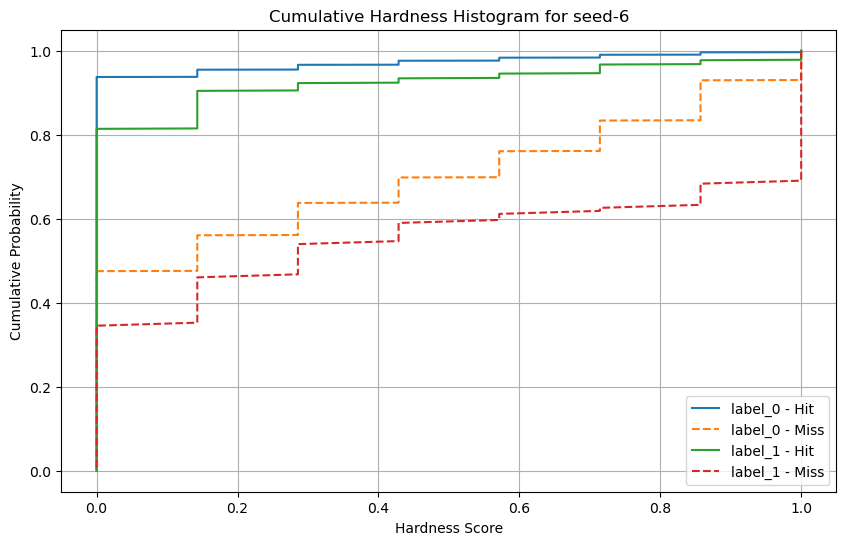

Hardness médio para seed-7: 0.0478
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_8.joblib


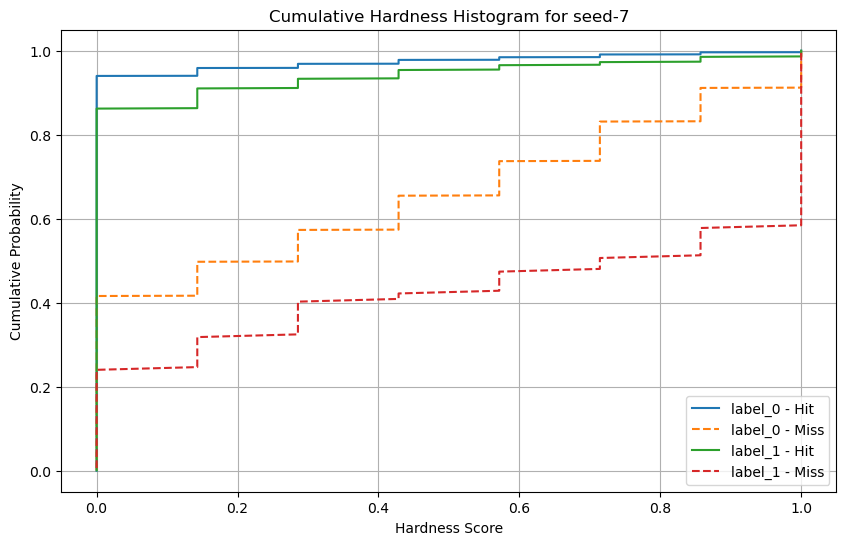

Hardness médio para seed-8: 0.0475
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_9.joblib


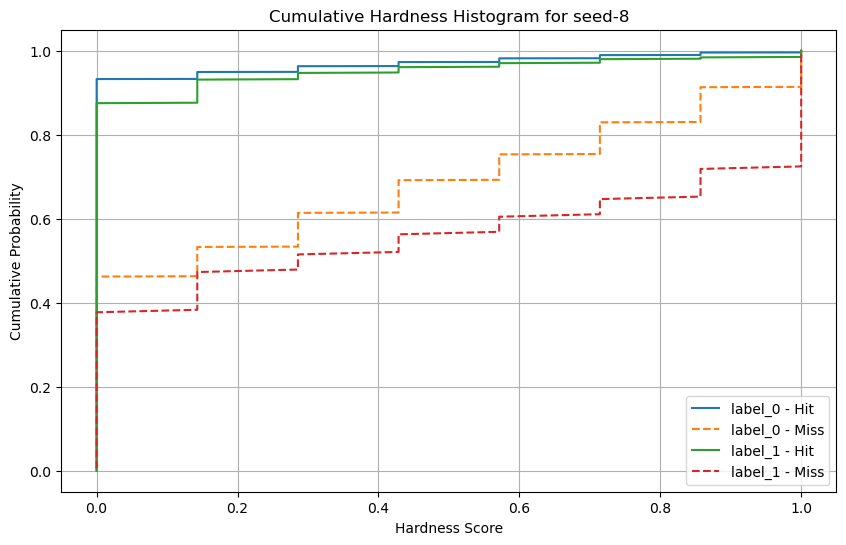

Hardness médio para seed-9: 0.0477
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_10.joblib


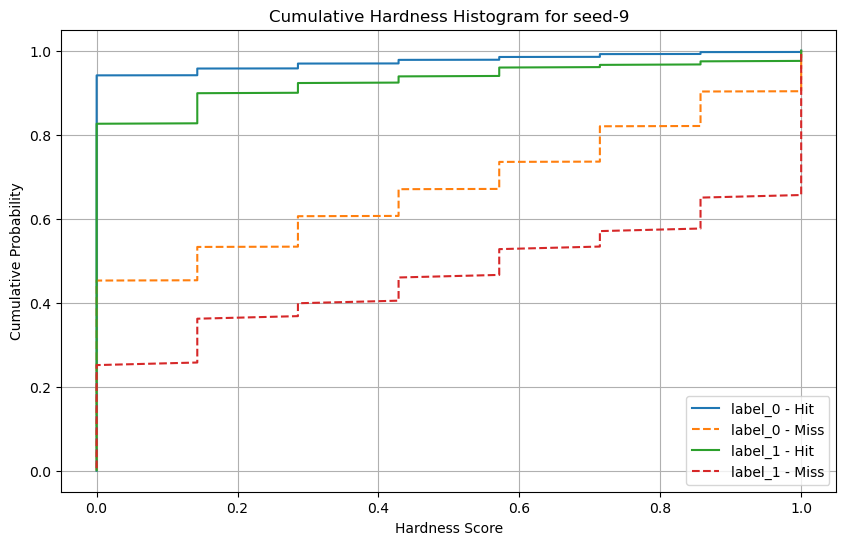

Hardness médio para seed-10: 0.0484
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_11.joblib


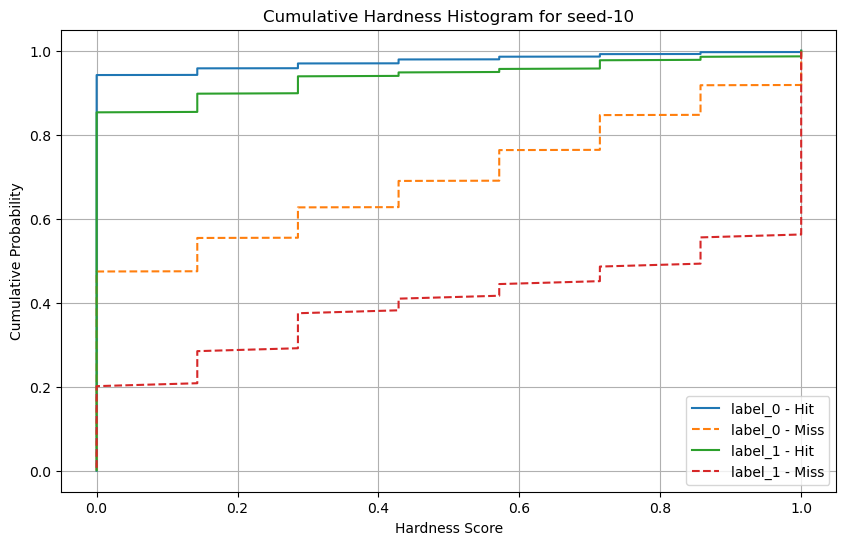

Hardness médio para seed-11: 0.0488
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_12.joblib


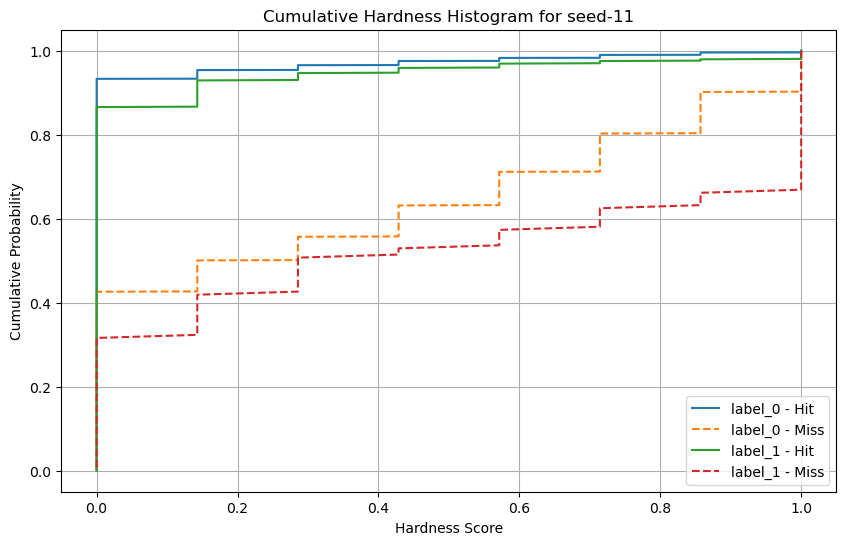

Hardness médio para seed-12: 0.0469
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_13.joblib


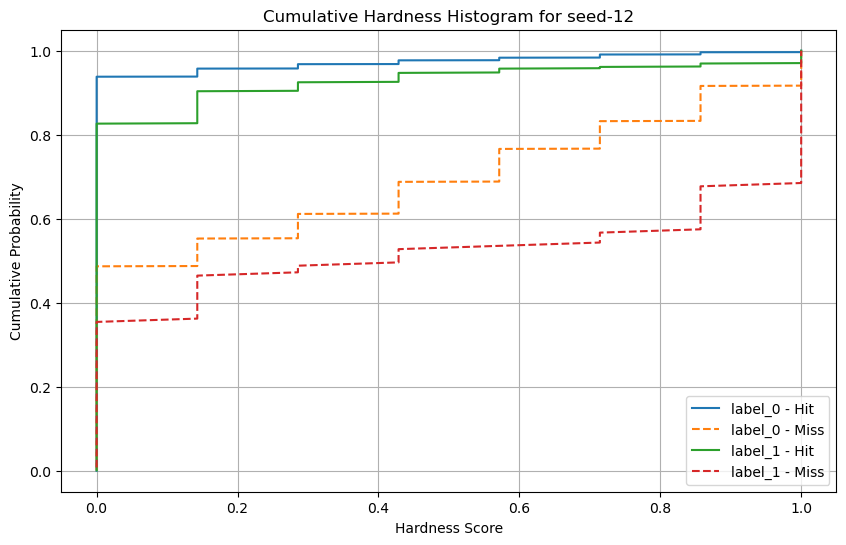

Hardness médio para seed-13: 0.0467
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_14.joblib


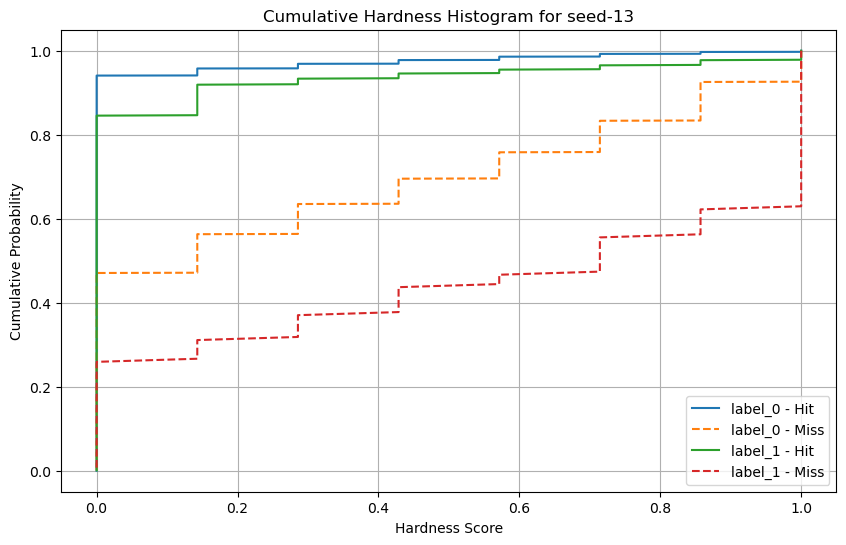

Hardness médio para seed-14: 0.0476
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_15.joblib


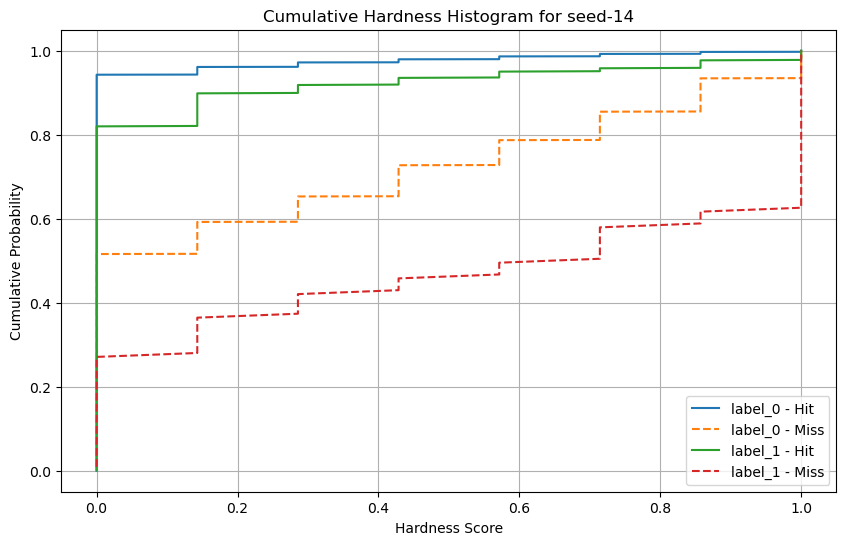

Hardness médio para seed-15: 0.0461
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_16.joblib


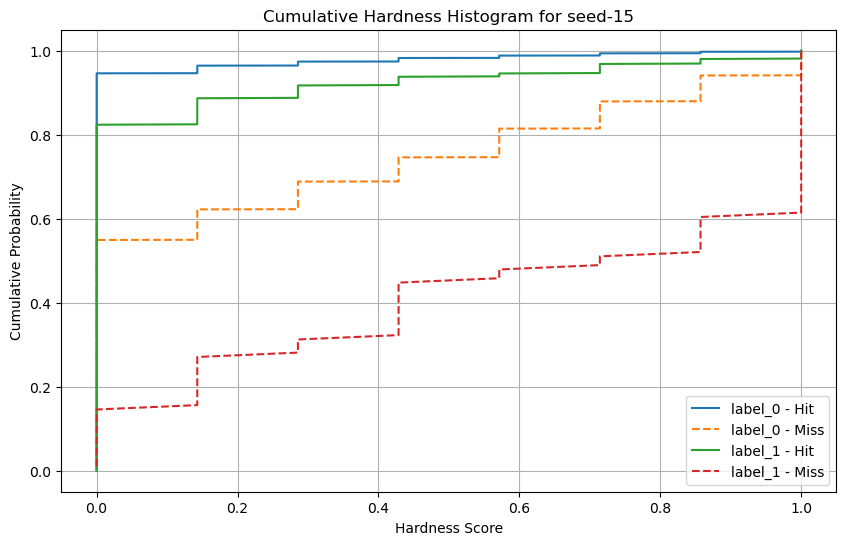

Hardness médio para seed-16: 0.0469
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_17.joblib


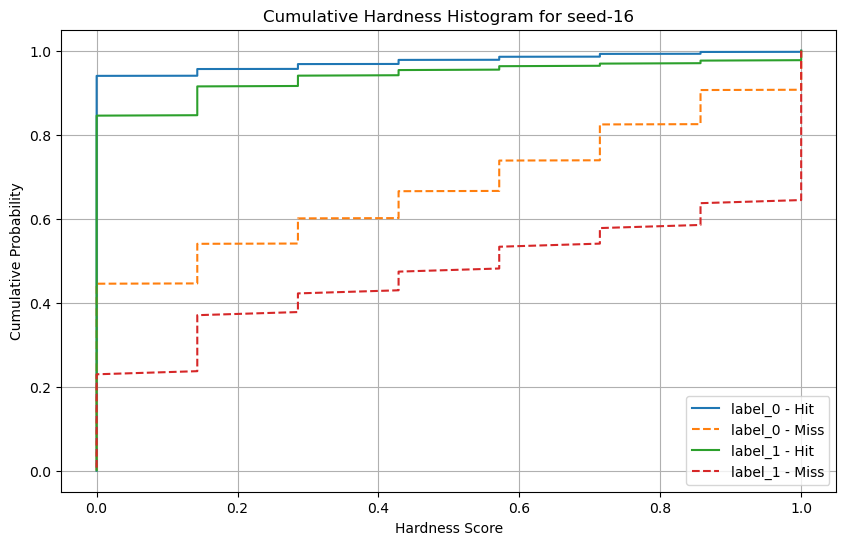

Hardness médio para seed-17: 0.0476
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_18.joblib


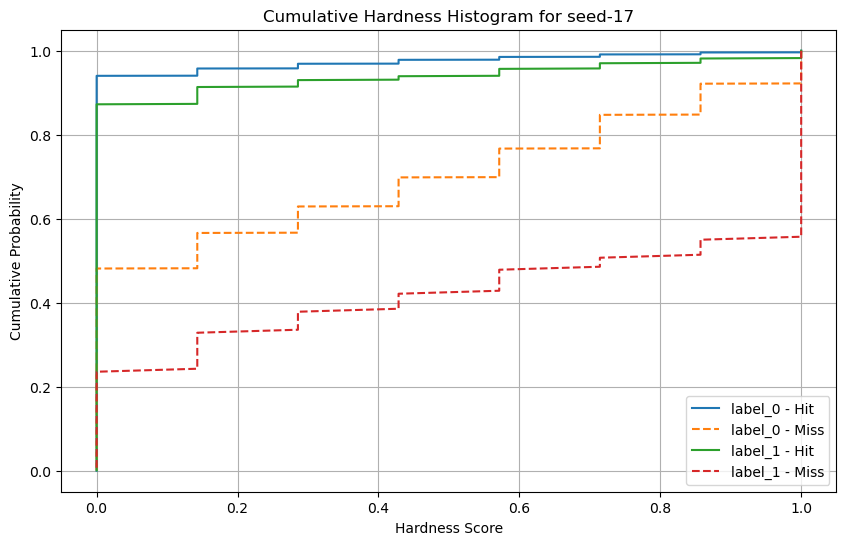

Hardness médio para seed-18: 0.0464
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_19.joblib


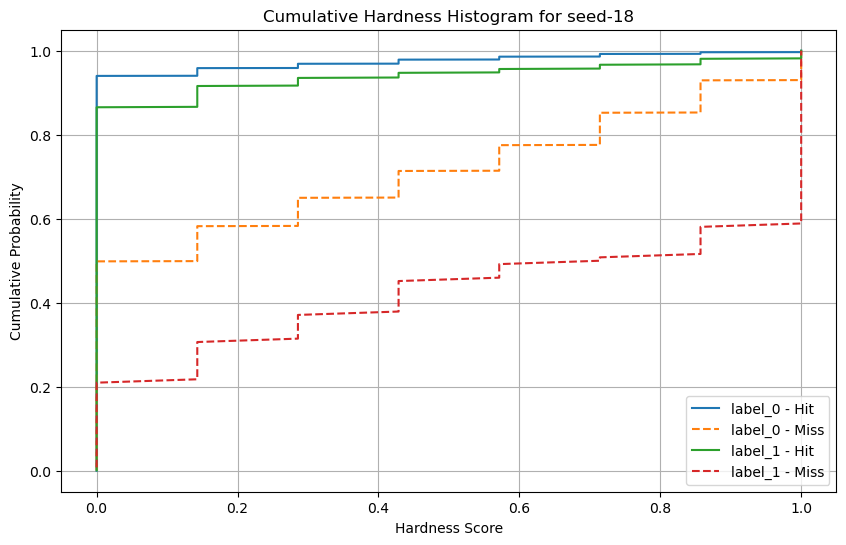

Hardness médio para seed-19: 0.0476
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_20.joblib


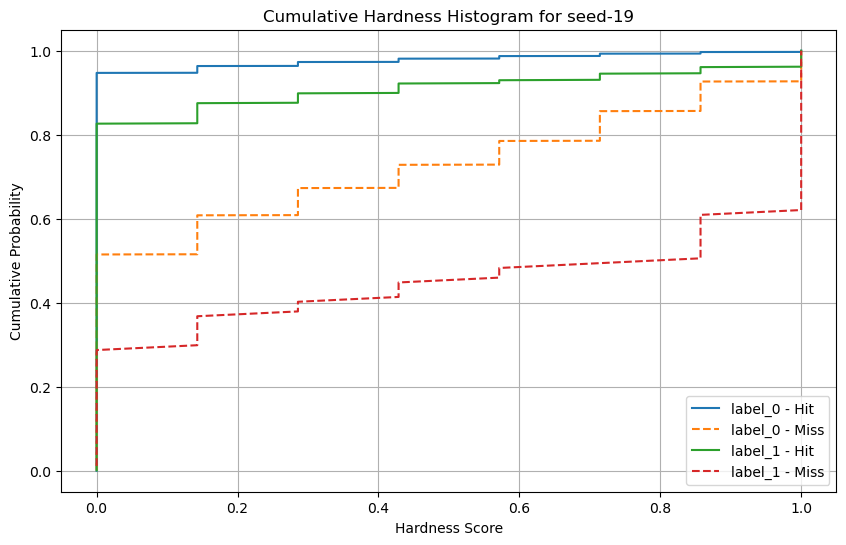

Hardness médio para seed-20: 0.0458
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_21.joblib


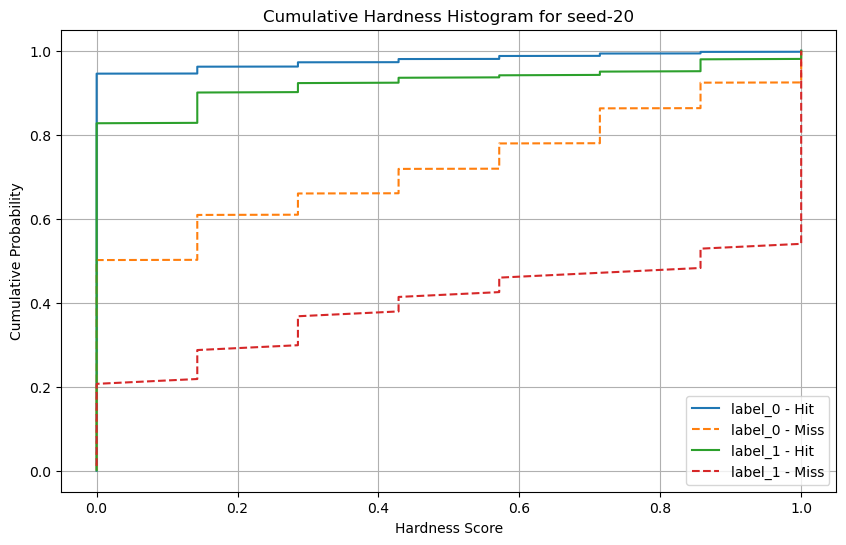

Hardness médio para seed-21: 0.0472
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_22.joblib


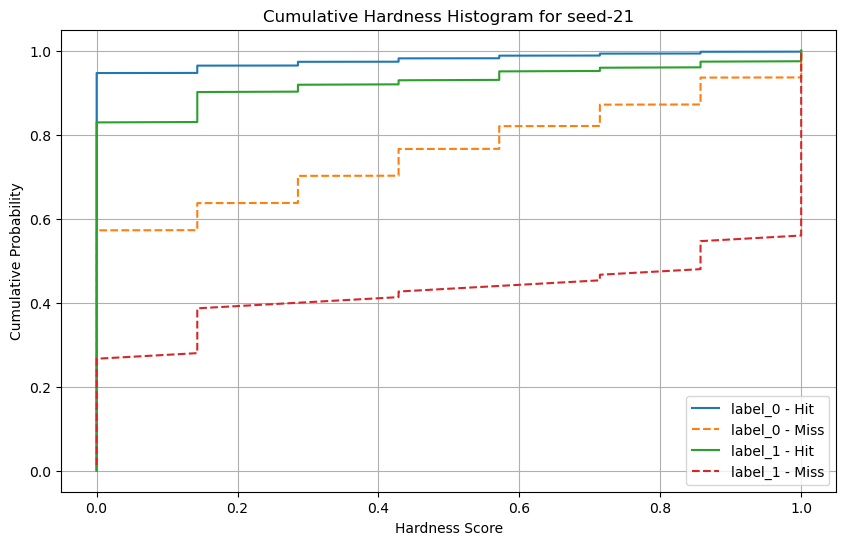

Hardness médio para seed-22: 0.0462
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_23.joblib


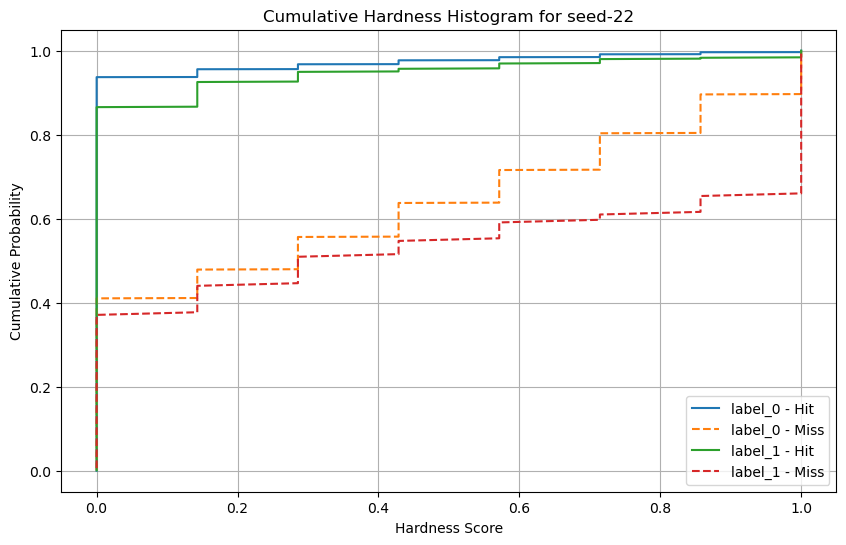

Hardness médio para seed-23: 0.0481
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_24.joblib


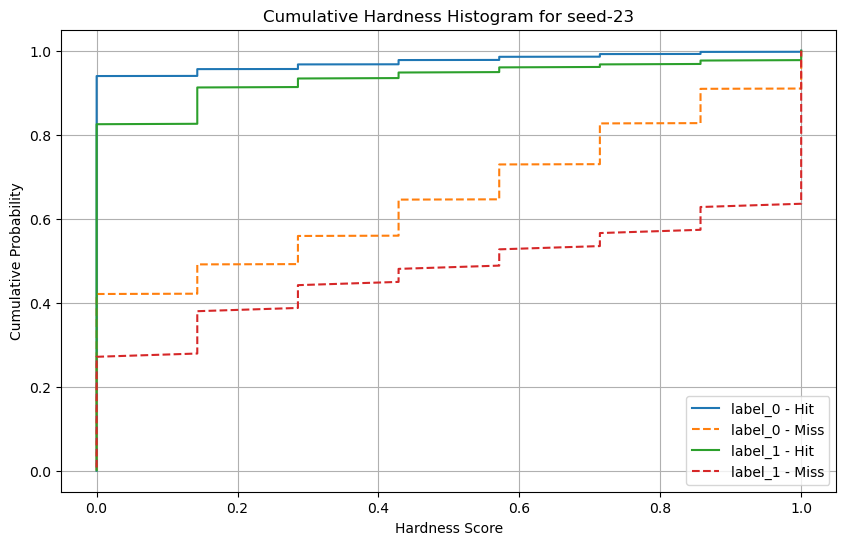

Hardness médio para seed-24: 0.0476
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_25.joblib


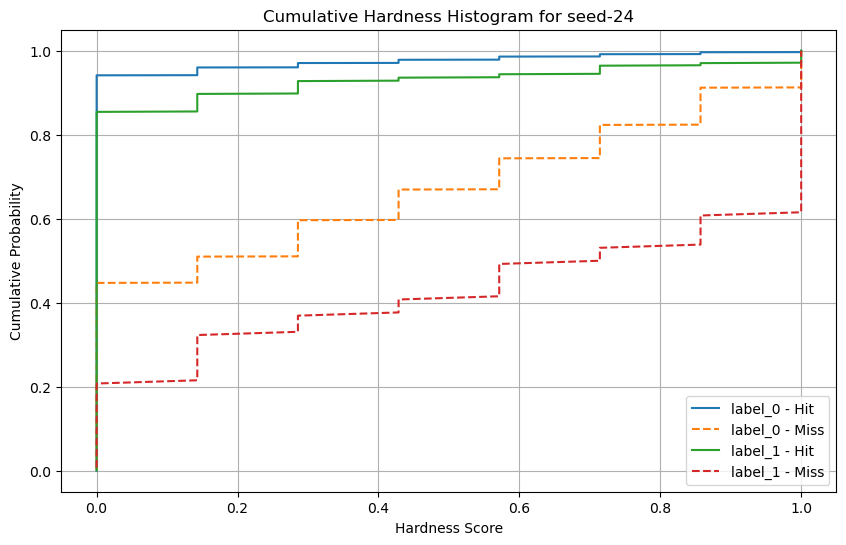

Hardness médio para seed-25: 0.0461
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_26.joblib


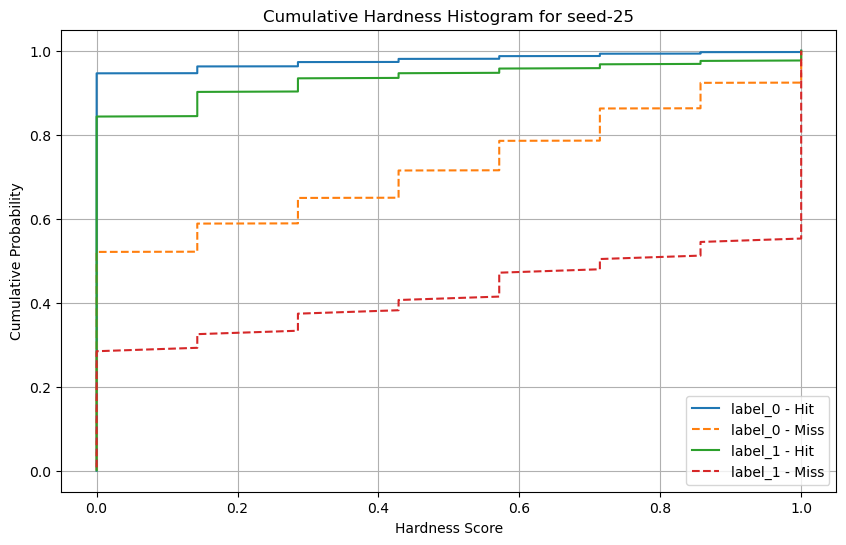

Hardness médio para seed-26: 0.0472
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_27.joblib


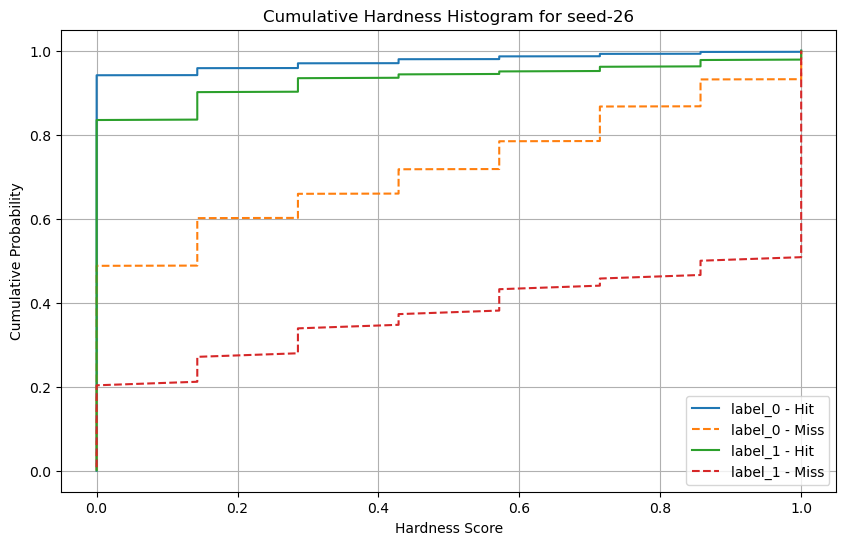

Hardness médio para seed-27: 0.0478
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_28.joblib


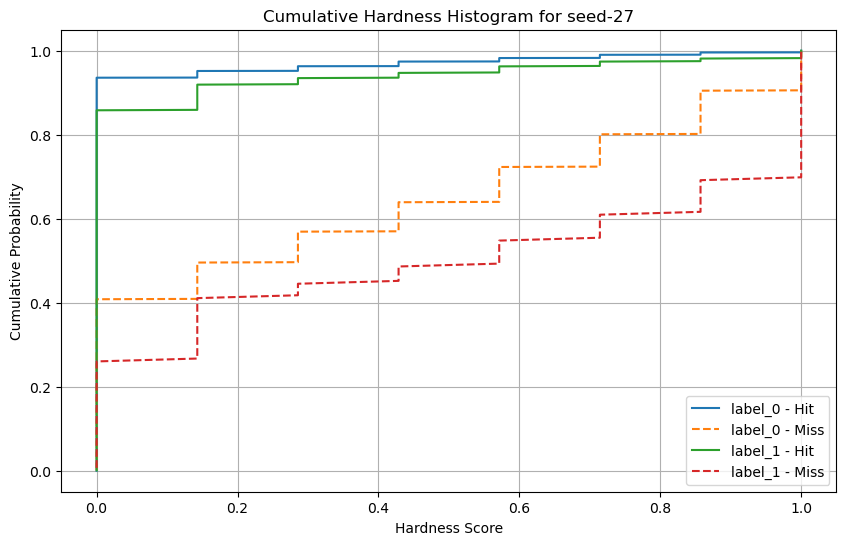

Hardness médio para seed-28: 0.0484
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_29.joblib


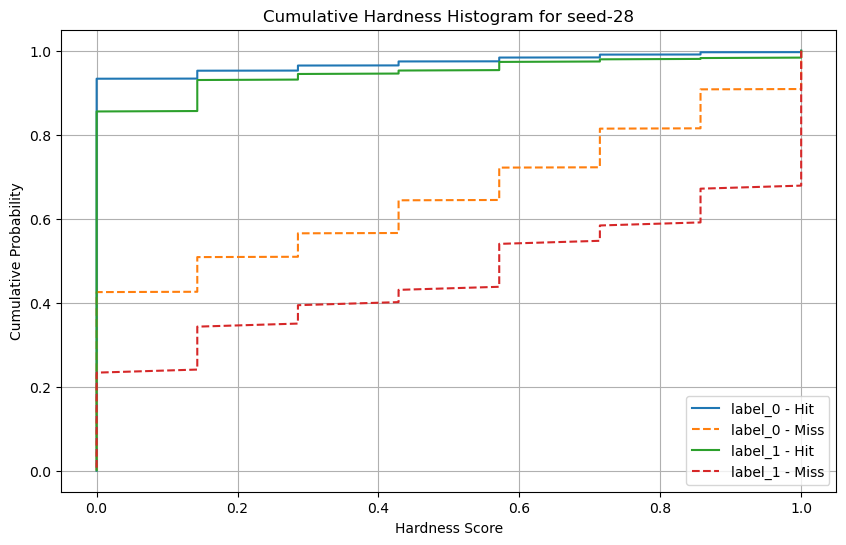

Hardness médio para seed-29: 0.0478
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\MLP\model_30.joblib


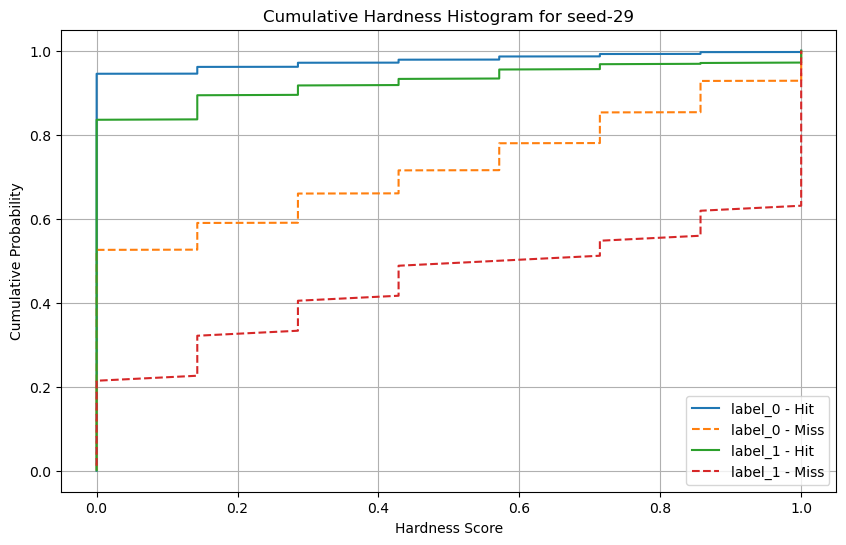

Processando pasta: NaiveBayes
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_1.joblib


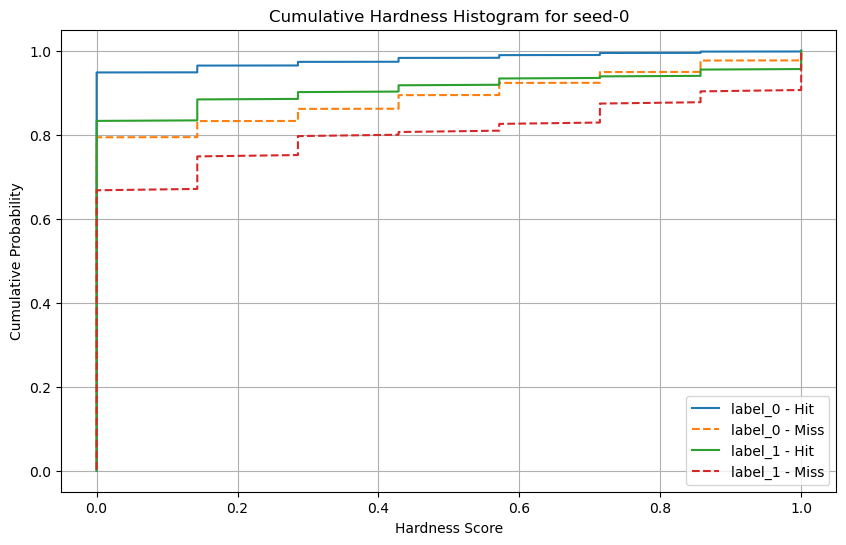

Hardness médio para seed-1: 0.0476
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_2.joblib


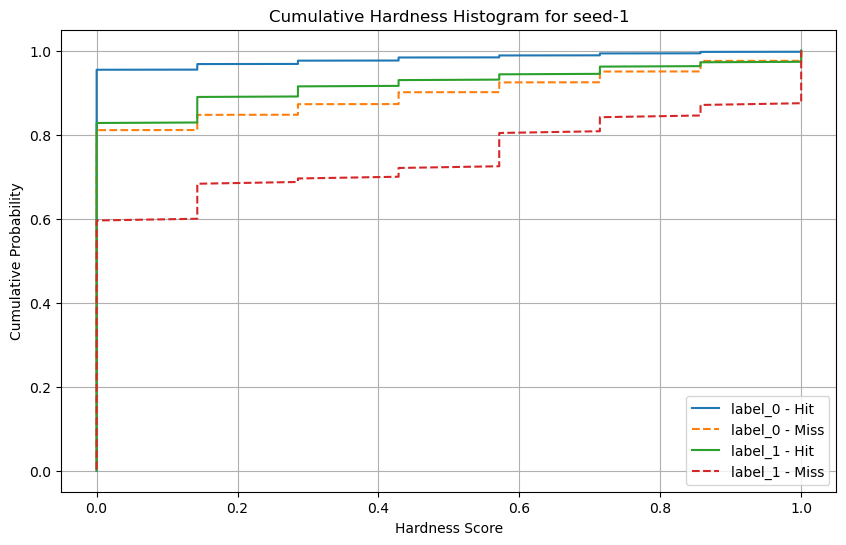

Hardness médio para seed-2: 0.0470
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_3.joblib


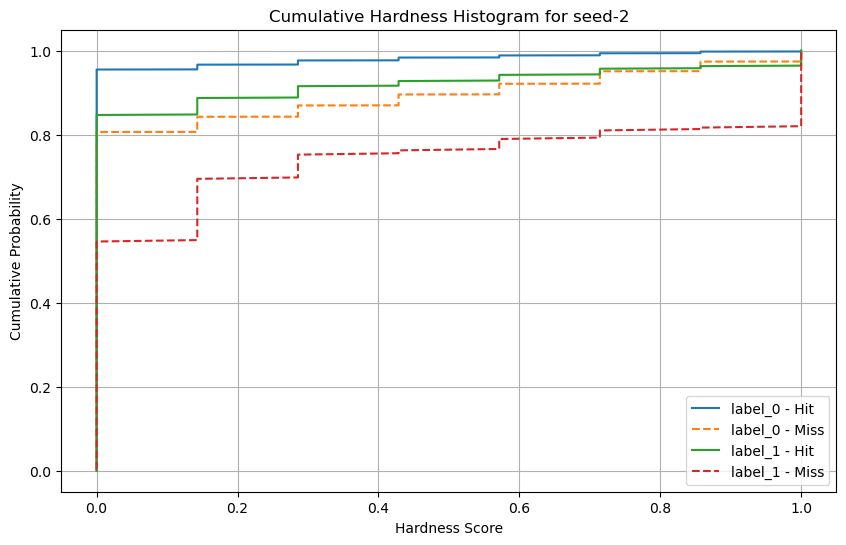

Hardness médio para seed-3: 0.0468
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_4.joblib


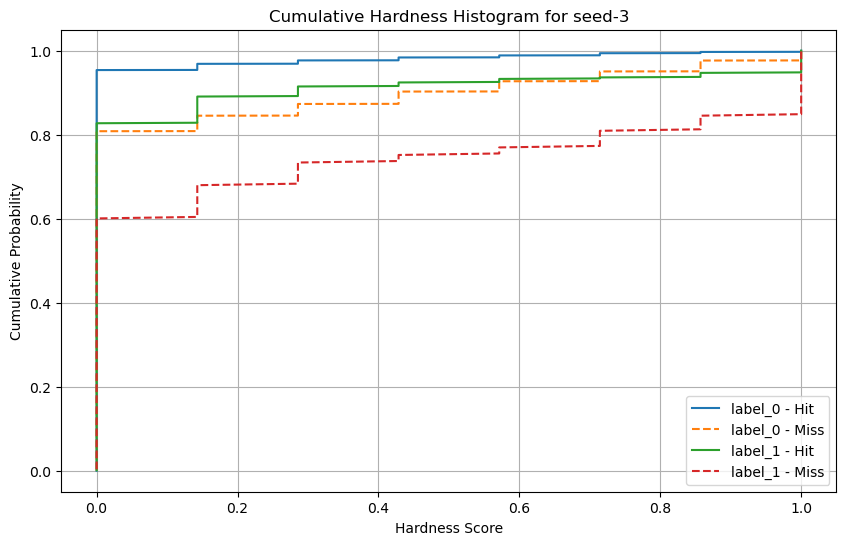

Hardness médio para seed-4: 0.0464
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_5.joblib


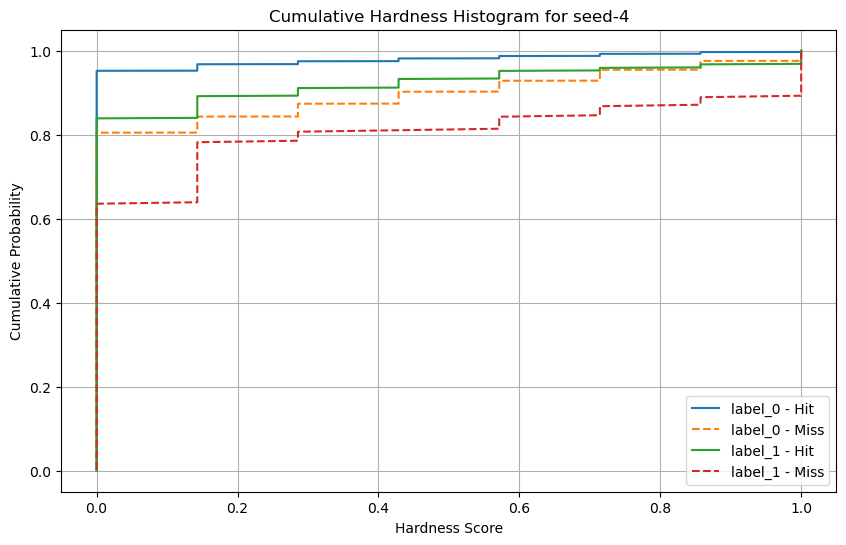

Hardness médio para seed-5: 0.0478
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_6.joblib


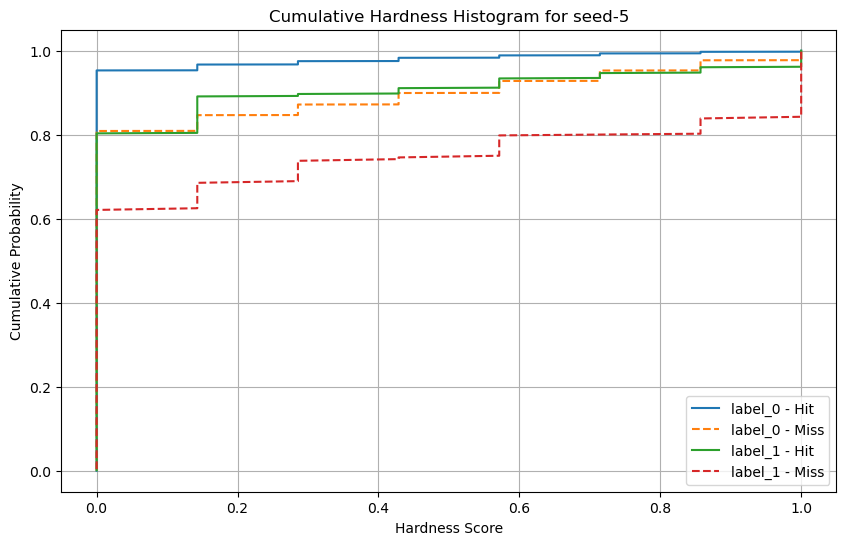

Hardness médio para seed-6: 0.0482
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_7.joblib


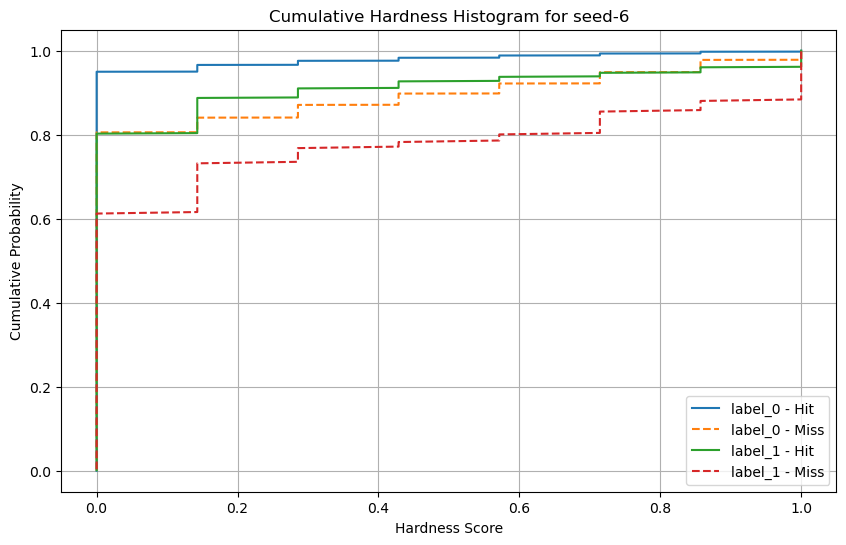

Hardness médio para seed-7: 0.0478
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_8.joblib


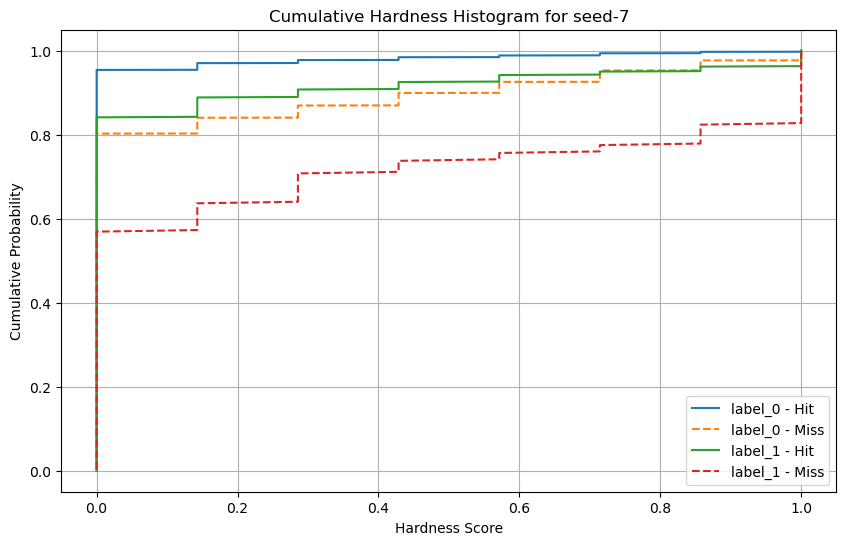

Hardness médio para seed-8: 0.0475
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_9.joblib


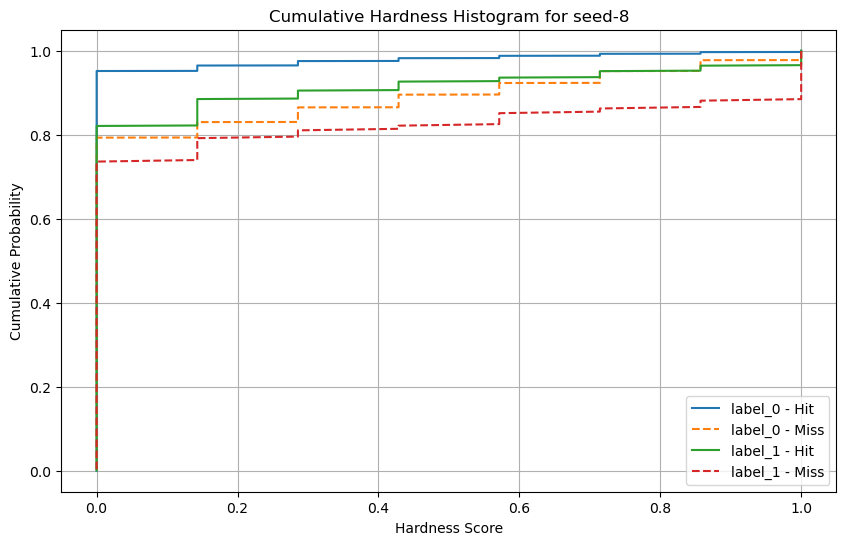

Hardness médio para seed-9: 0.0477
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_10.joblib


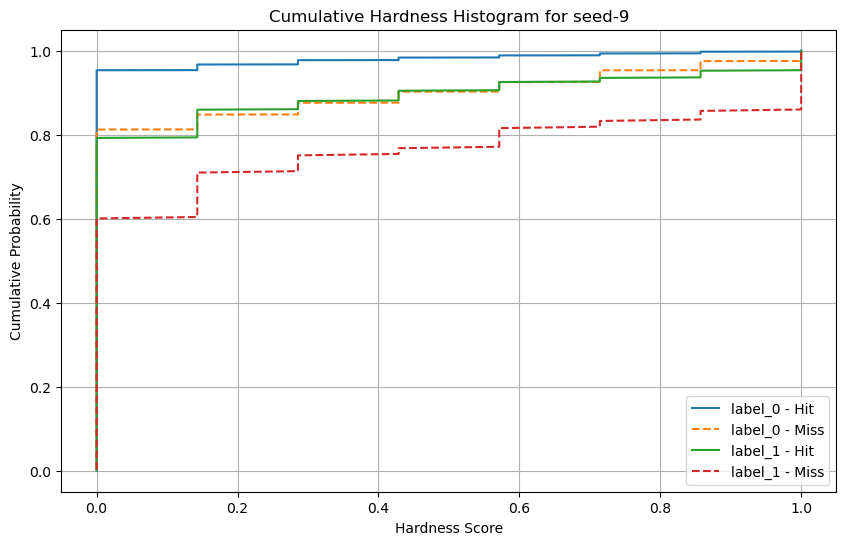

Hardness médio para seed-10: 0.0484
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_11.joblib


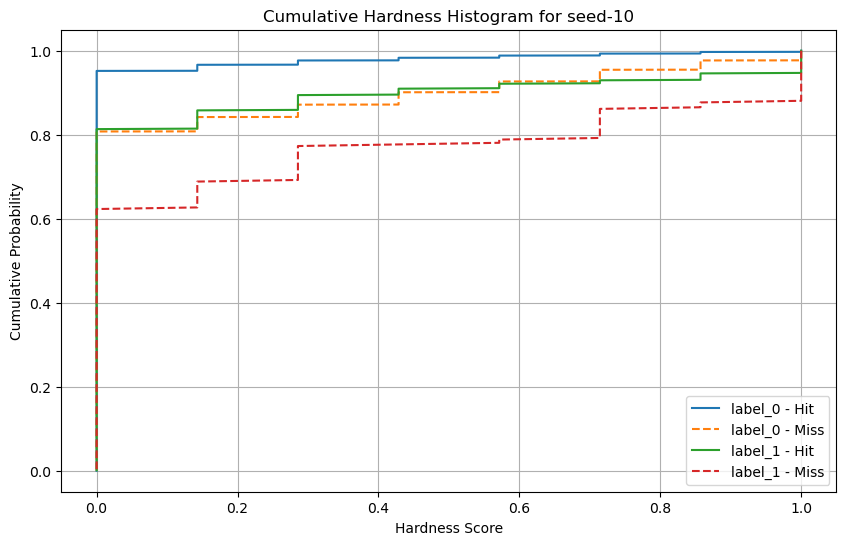

Hardness médio para seed-11: 0.0488
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_12.joblib


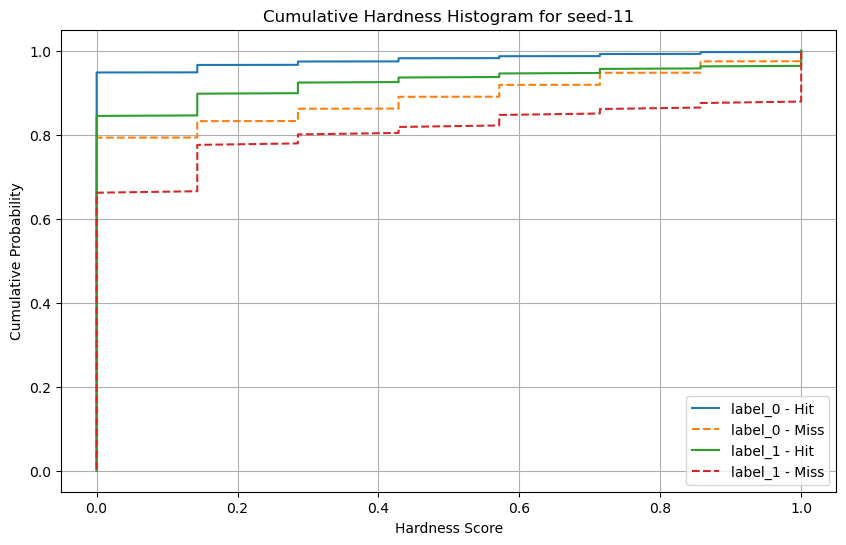

Hardness médio para seed-12: 0.0469
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_13.joblib


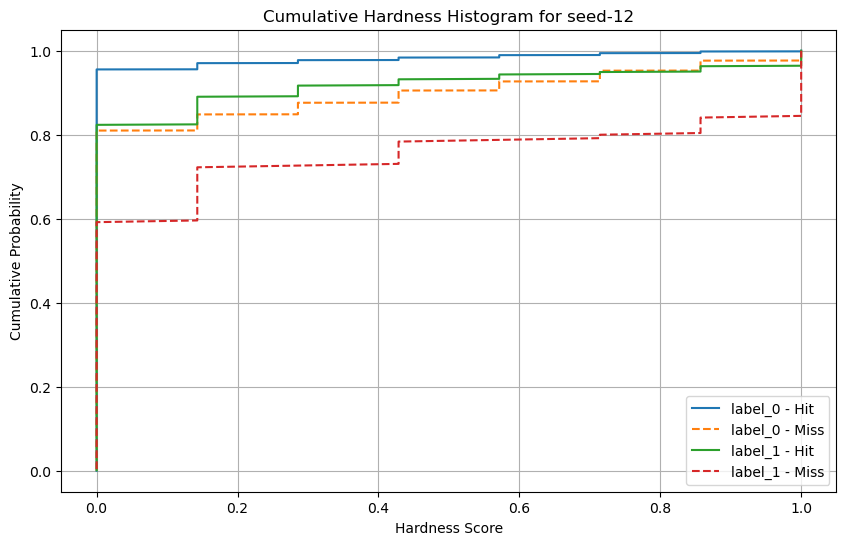

Hardness médio para seed-13: 0.0467
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_14.joblib


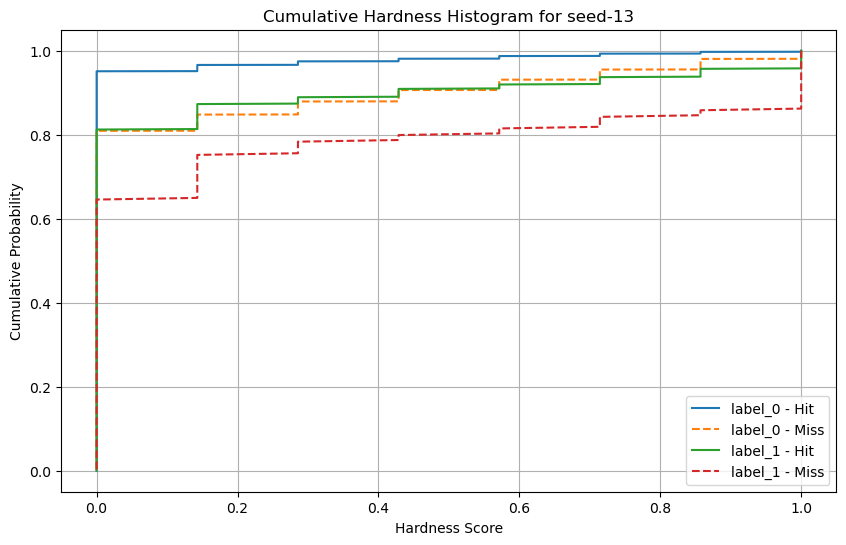

Hardness médio para seed-14: 0.0476
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_15.joblib


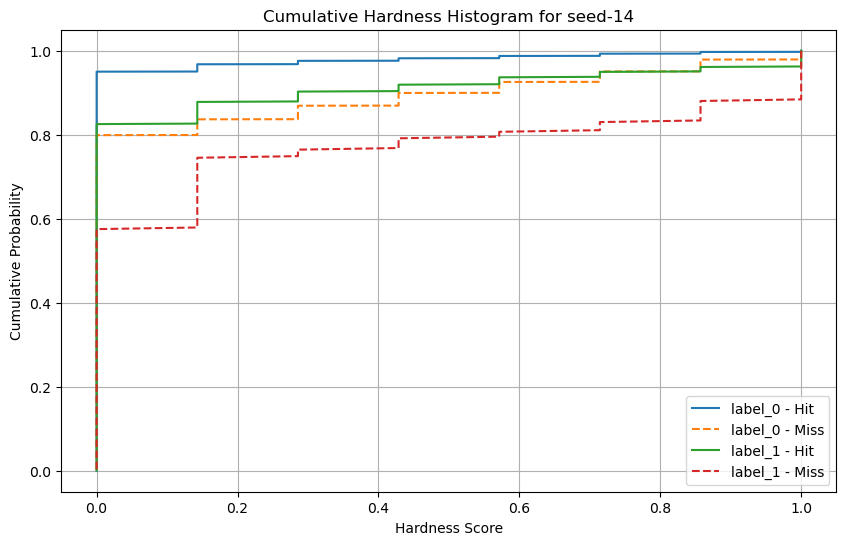

Hardness médio para seed-15: 0.0461
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_16.joblib


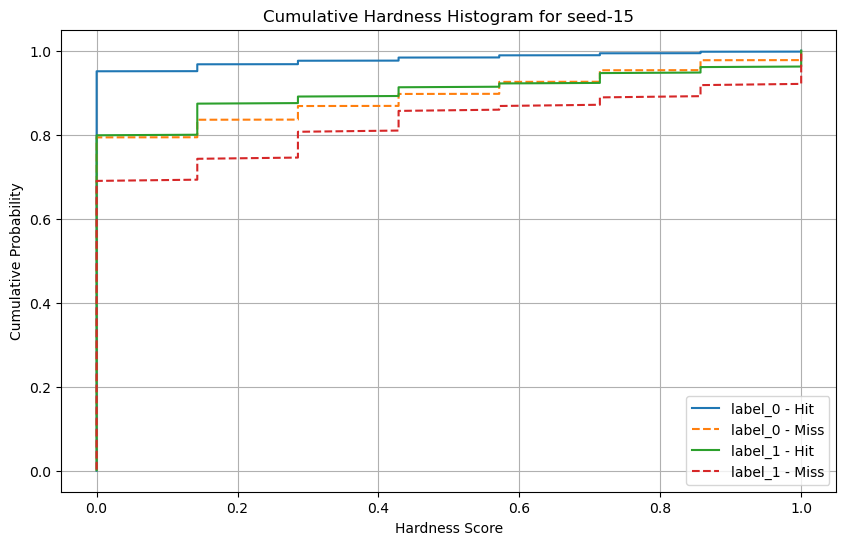

Hardness médio para seed-16: 0.0469
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_17.joblib


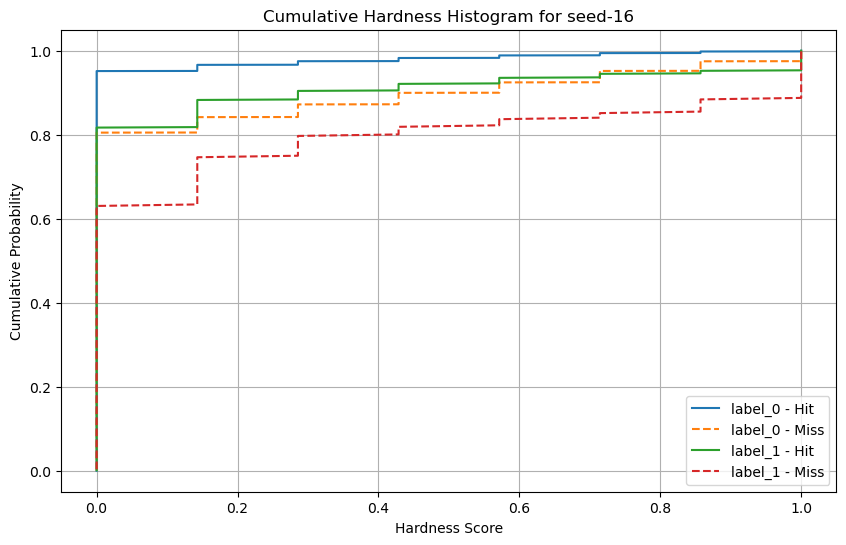

Hardness médio para seed-17: 0.0476
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_18.joblib


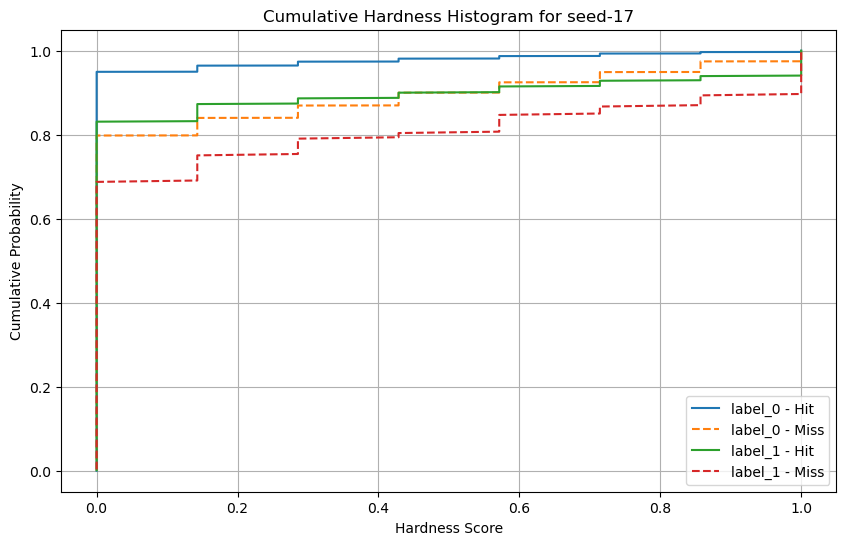

Hardness médio para seed-18: 0.0464
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_19.joblib


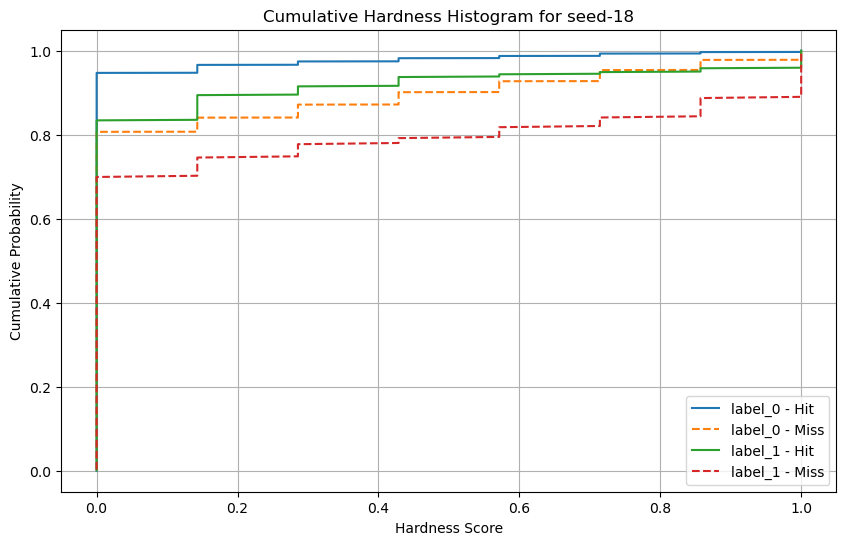

Hardness médio para seed-19: 0.0476
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_20.joblib


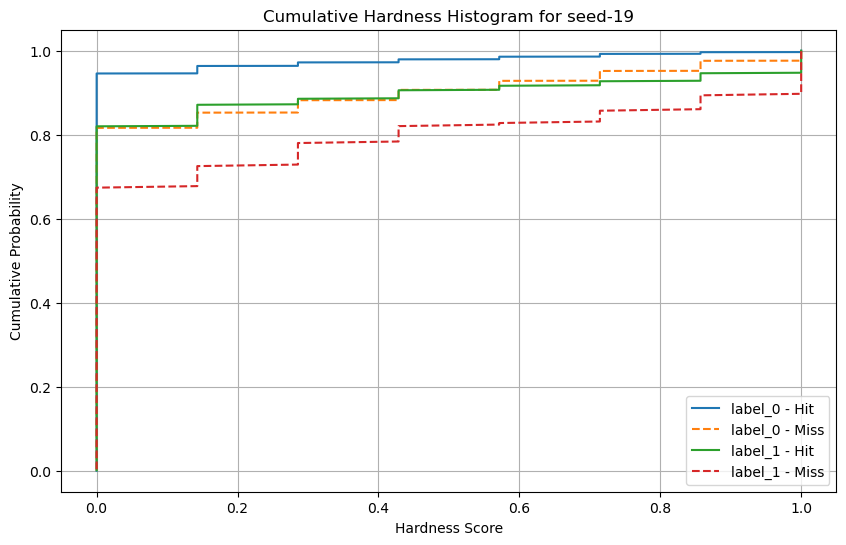

Hardness médio para seed-20: 0.0458
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_21.joblib


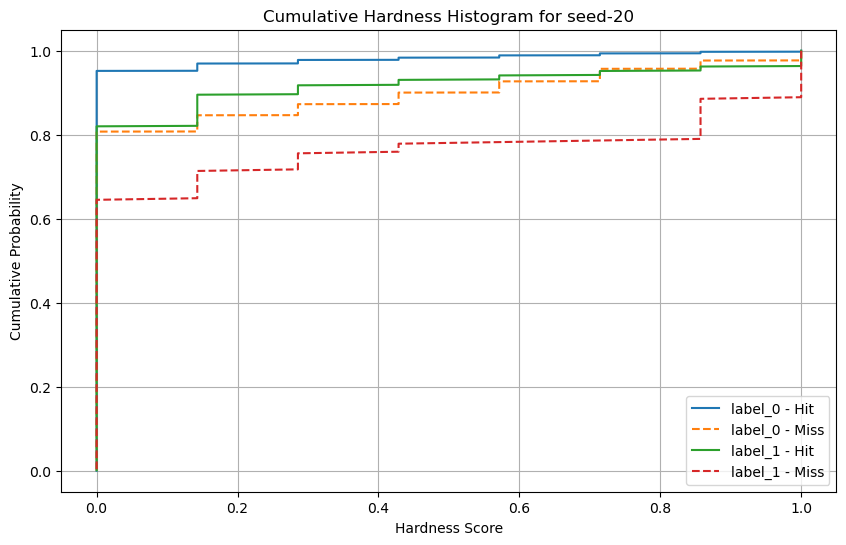

Hardness médio para seed-21: 0.0472
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_22.joblib


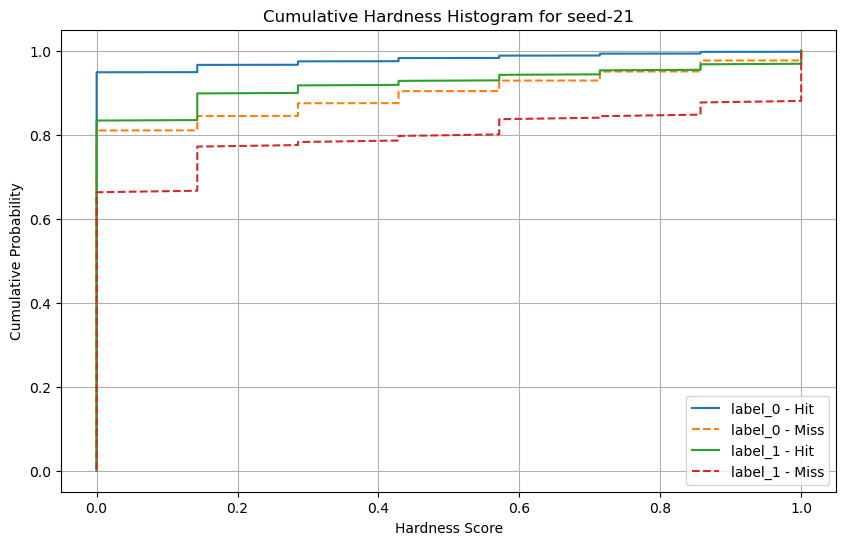

Hardness médio para seed-22: 0.0462
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_23.joblib


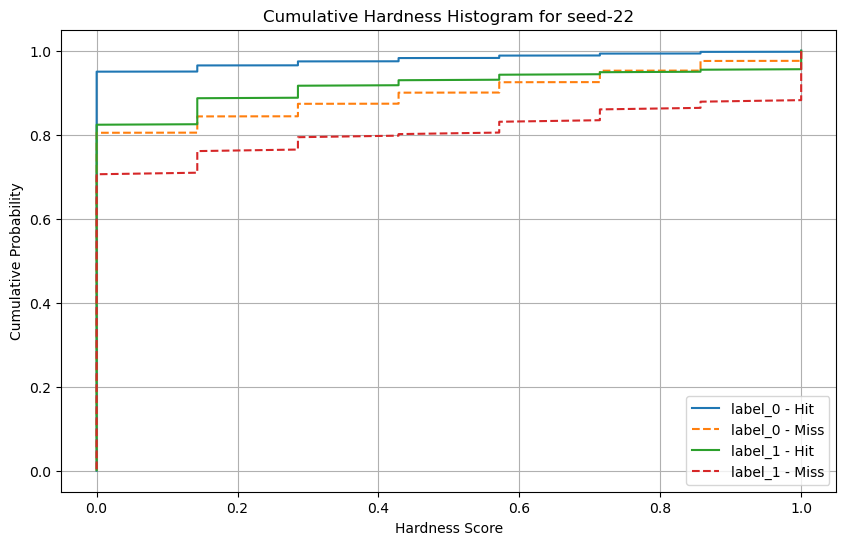

Hardness médio para seed-23: 0.0481
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_24.joblib


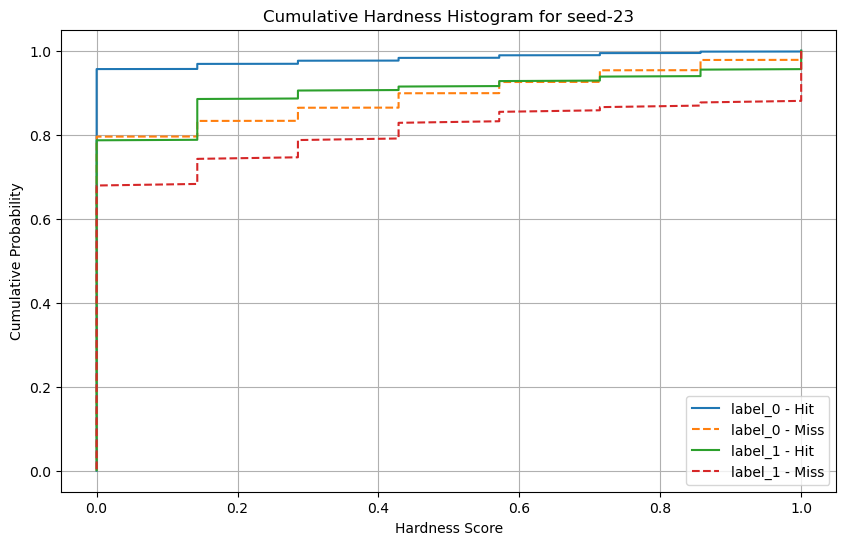

Hardness médio para seed-24: 0.0476
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_25.joblib


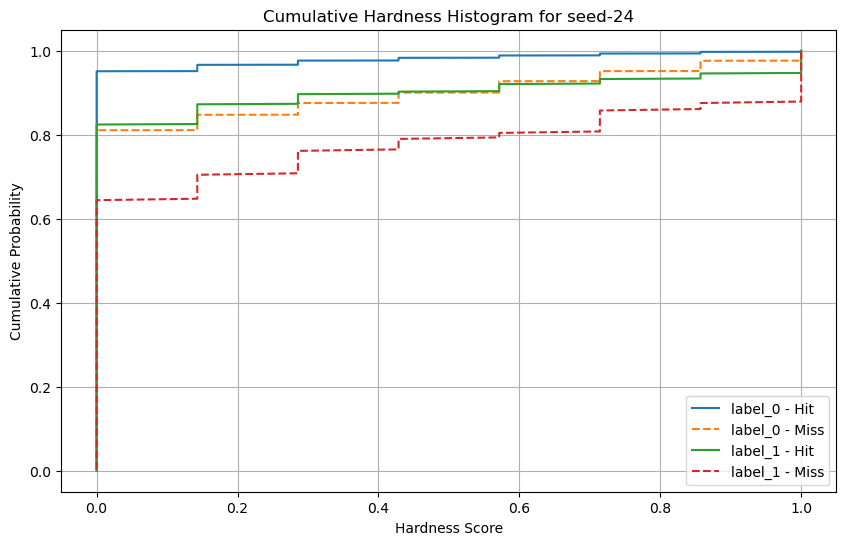

Hardness médio para seed-25: 0.0461
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_26.joblib


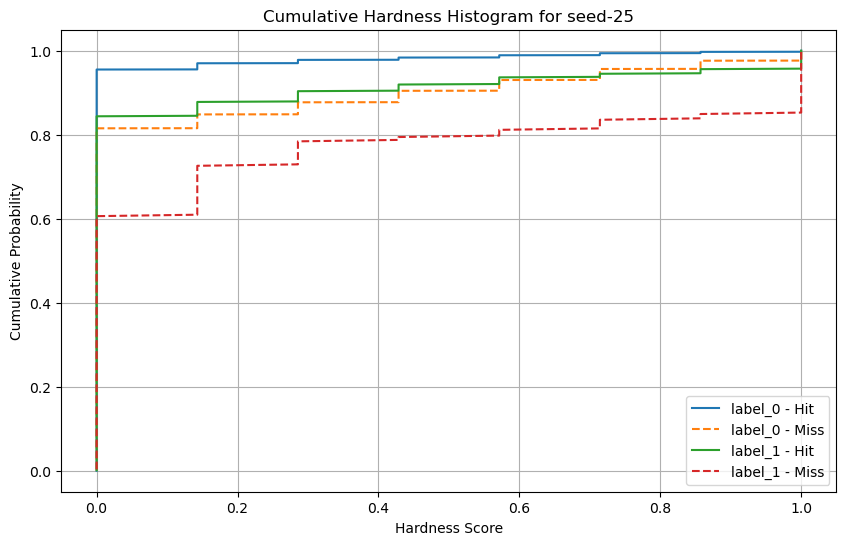

Hardness médio para seed-26: 0.0472
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_27.joblib


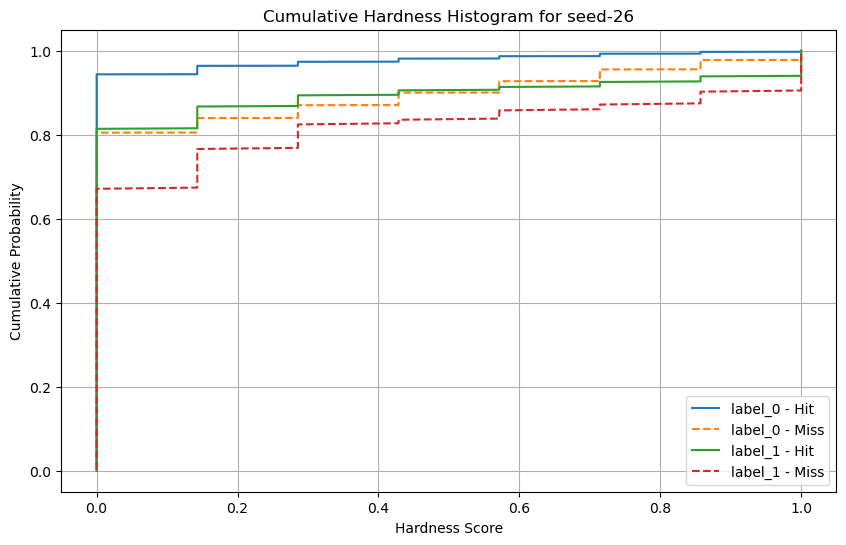

Hardness médio para seed-27: 0.0478
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_28.joblib


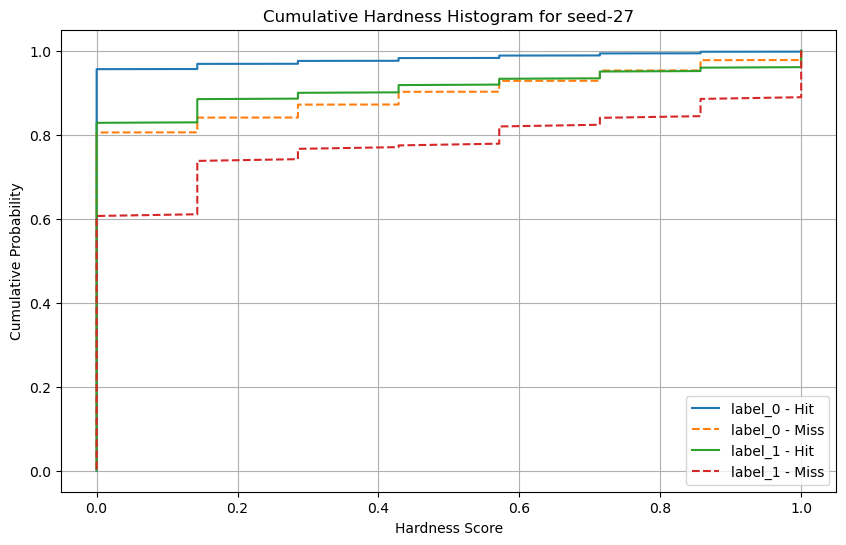

Hardness médio para seed-28: 0.0484
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_29.joblib


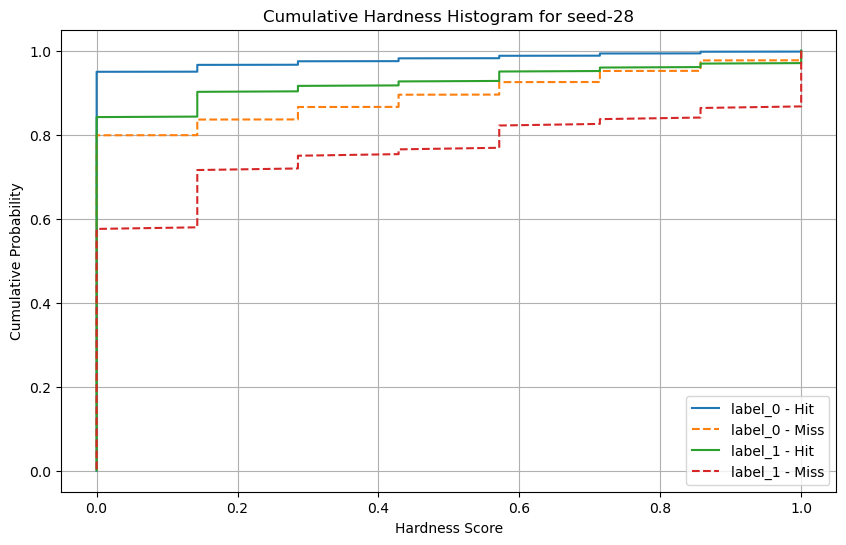

Hardness médio para seed-29: 0.0478
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\NaiveBayes\model_30.joblib


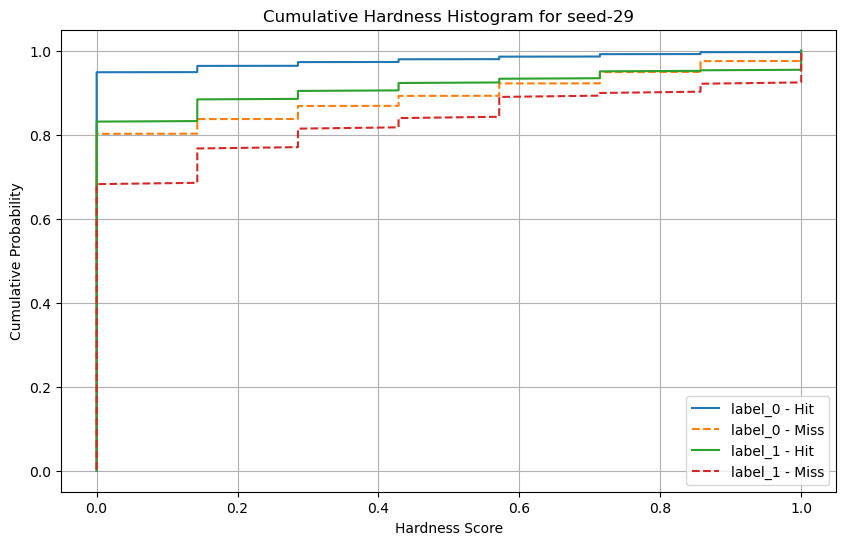

Processando pasta: RandomForest
Hardness médio para seed-0: 0.0483
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_1.joblib


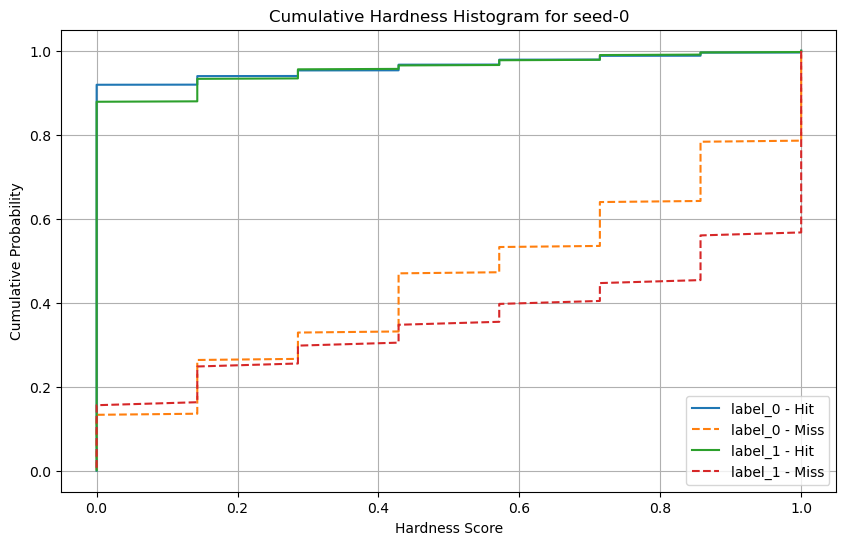

Hardness médio para seed-1: 0.0476
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_2.joblib


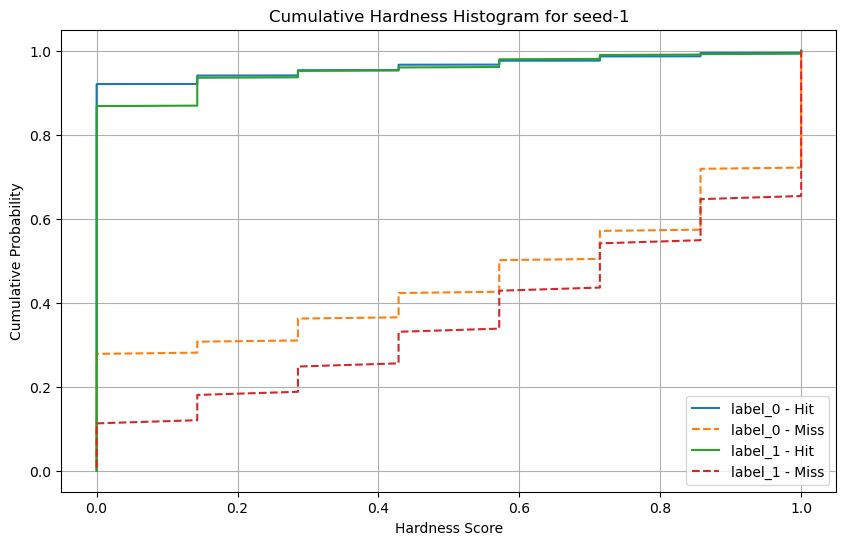

Hardness médio para seed-2: 0.0470
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_3.joblib


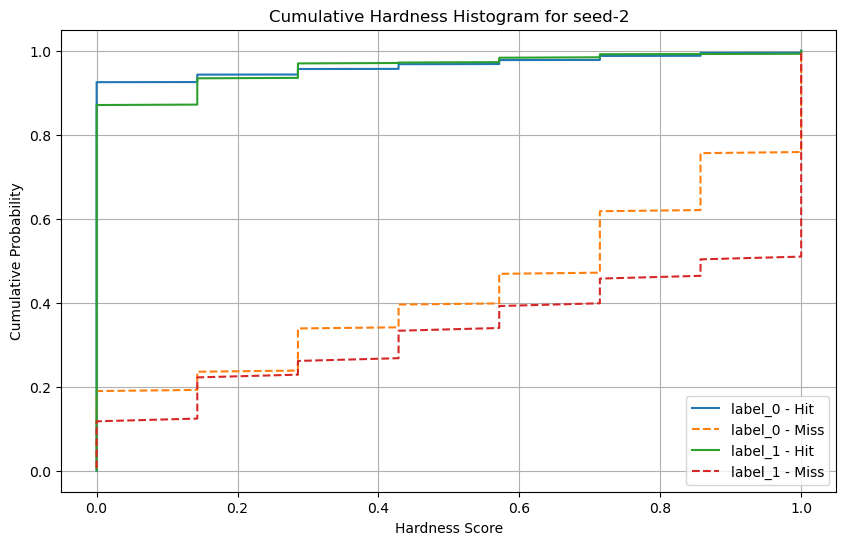

Hardness médio para seed-3: 0.0468
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_4.joblib


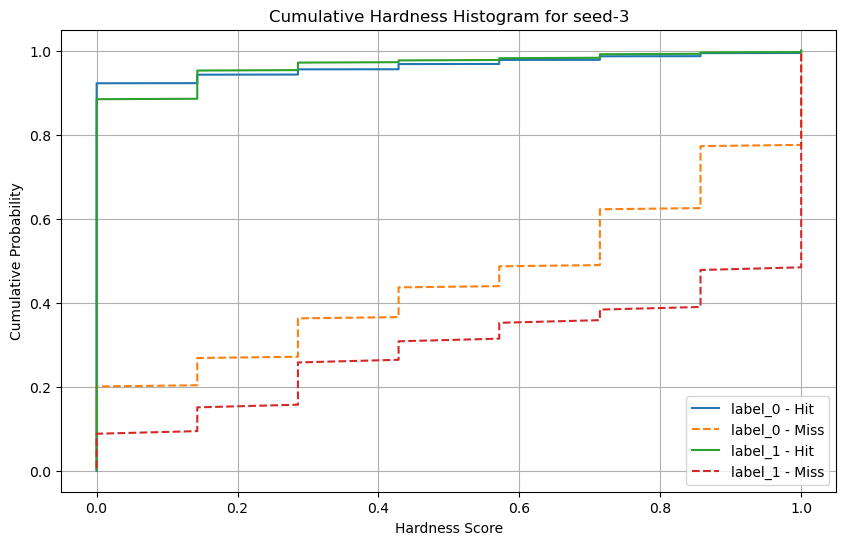

Hardness médio para seed-4: 0.0464
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_5.joblib


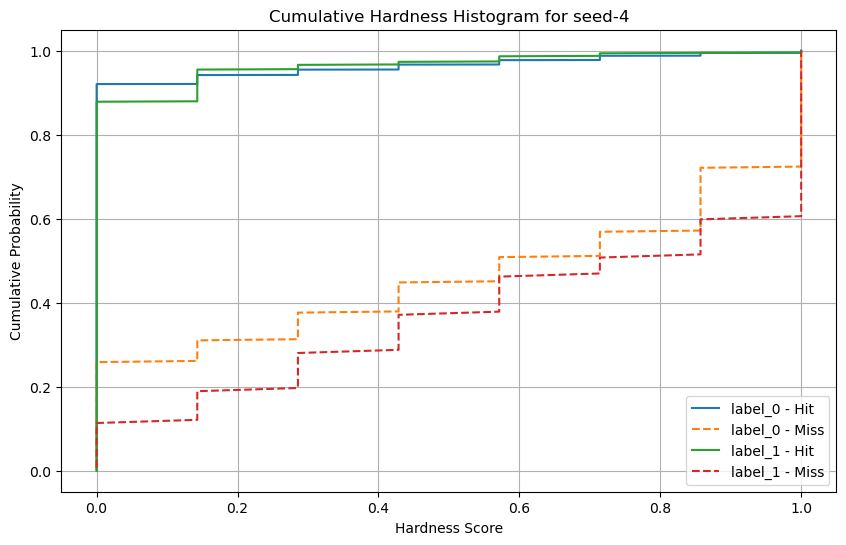

Hardness médio para seed-5: 0.0478
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_6.joblib


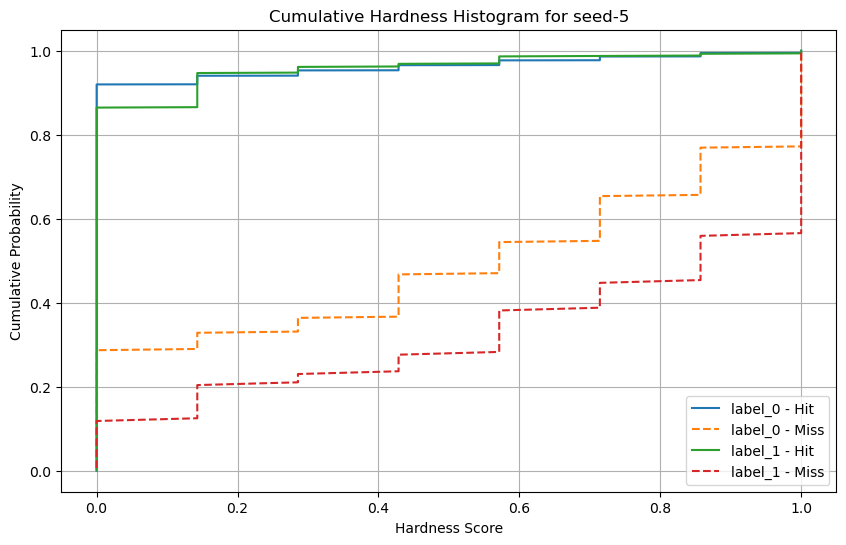

Hardness médio para seed-6: 0.0482
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_7.joblib


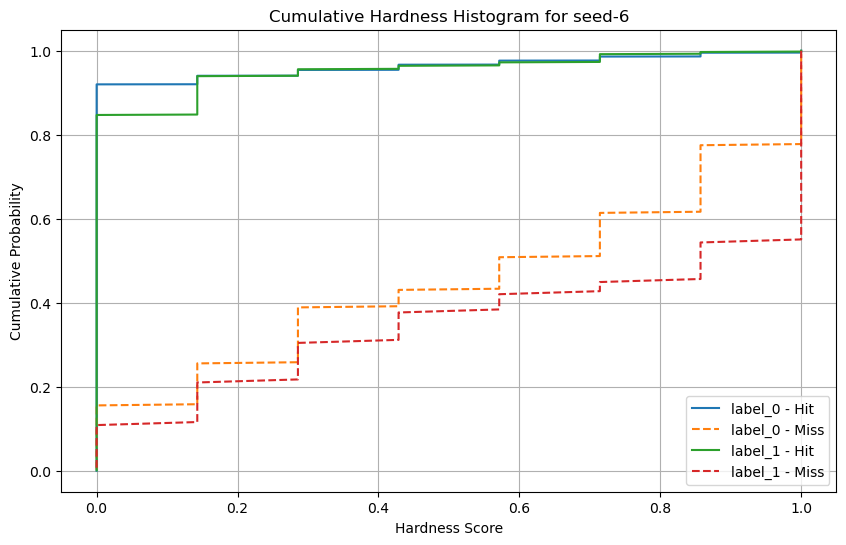

Hardness médio para seed-7: 0.0478
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_8.joblib


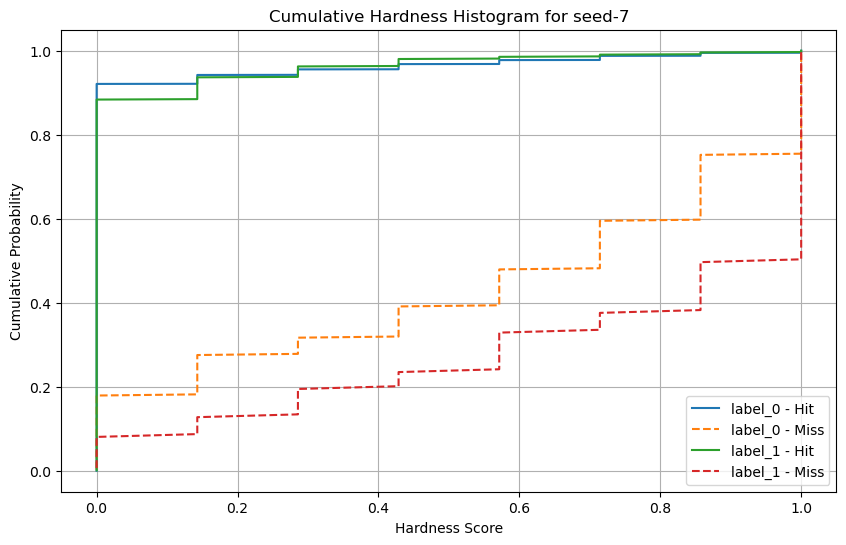

Hardness médio para seed-8: 0.0475
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_9.joblib


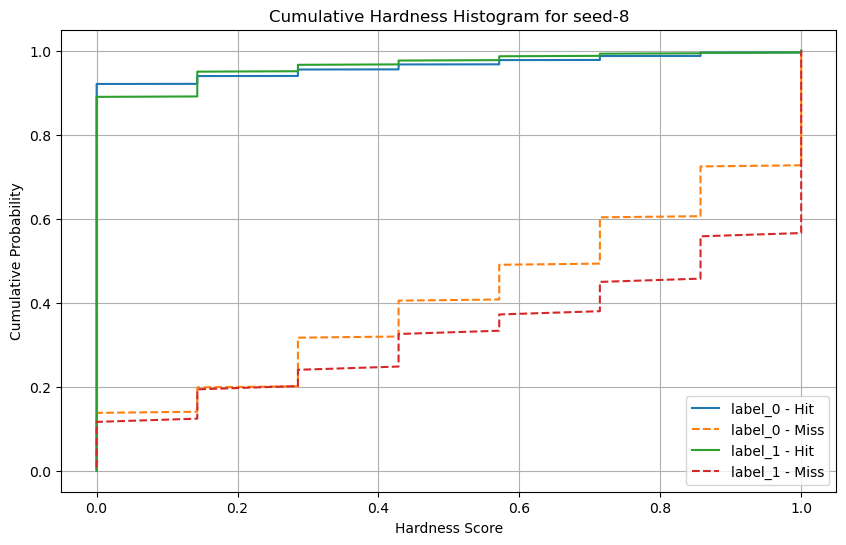

Hardness médio para seed-9: 0.0477
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_10.joblib


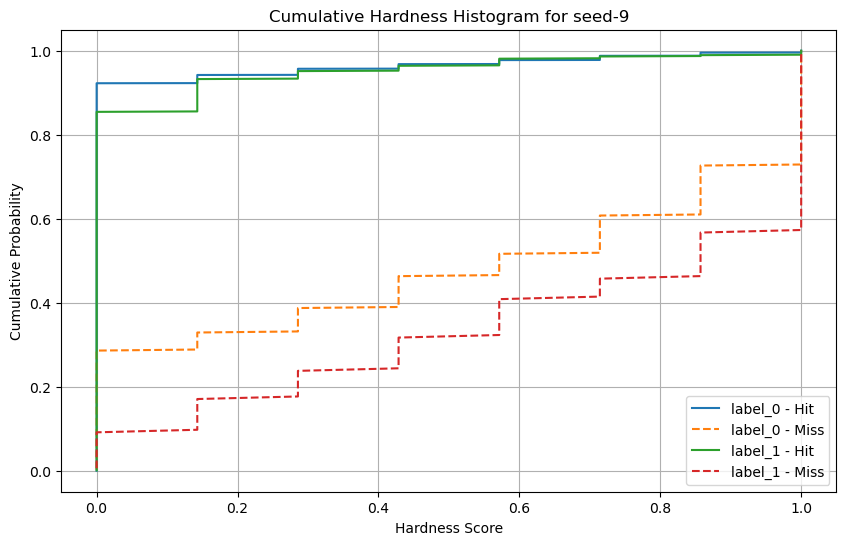

Hardness médio para seed-10: 0.0484
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_11.joblib


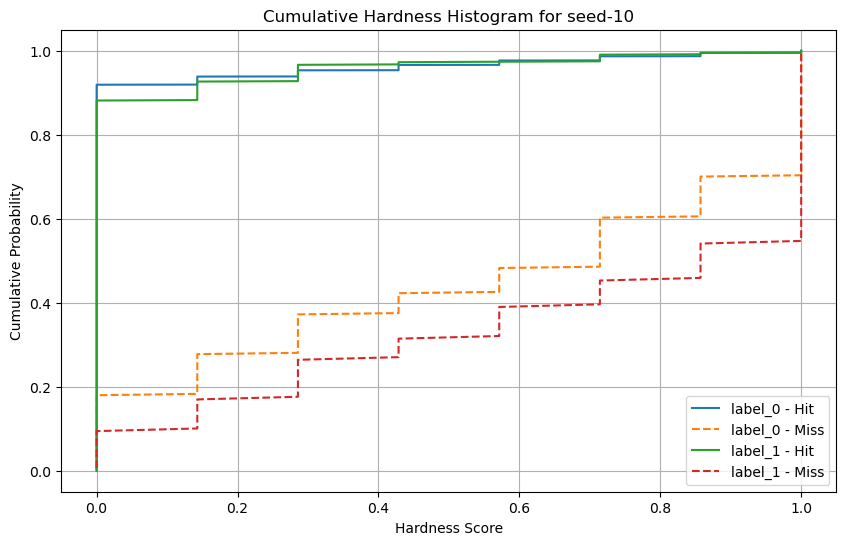

Hardness médio para seed-11: 0.0488
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_12.joblib


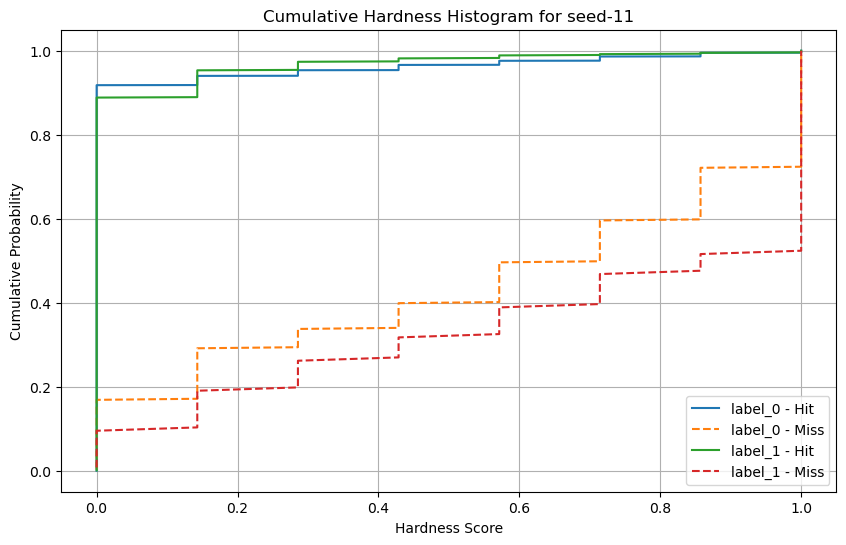

Hardness médio para seed-12: 0.0469
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_13.joblib


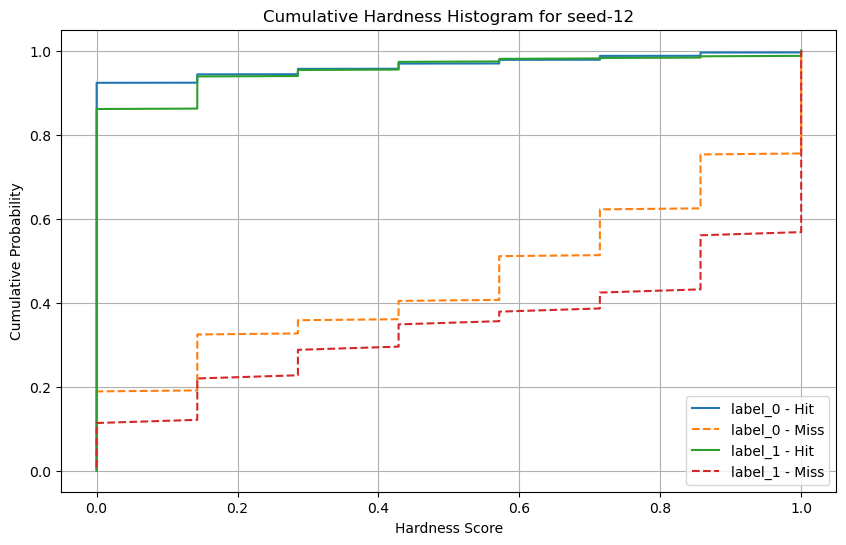

Hardness médio para seed-13: 0.0467
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_14.joblib


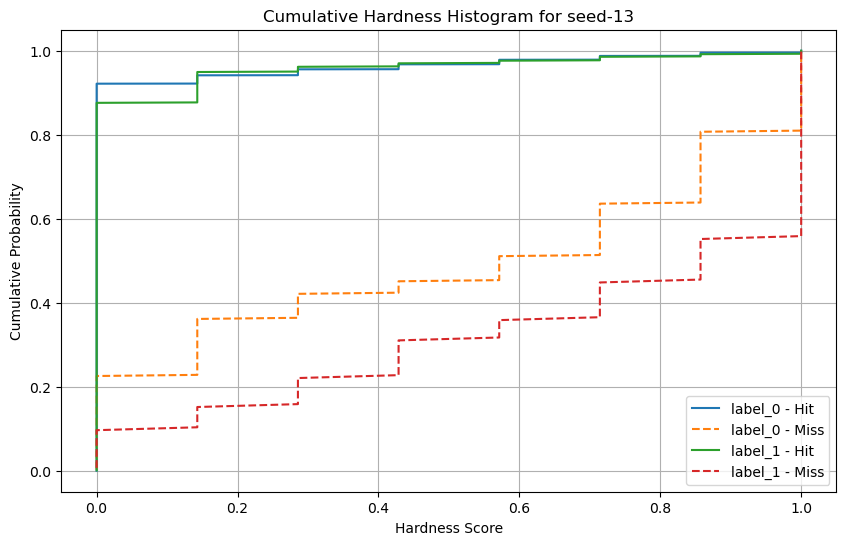

Hardness médio para seed-14: 0.0476
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_15.joblib


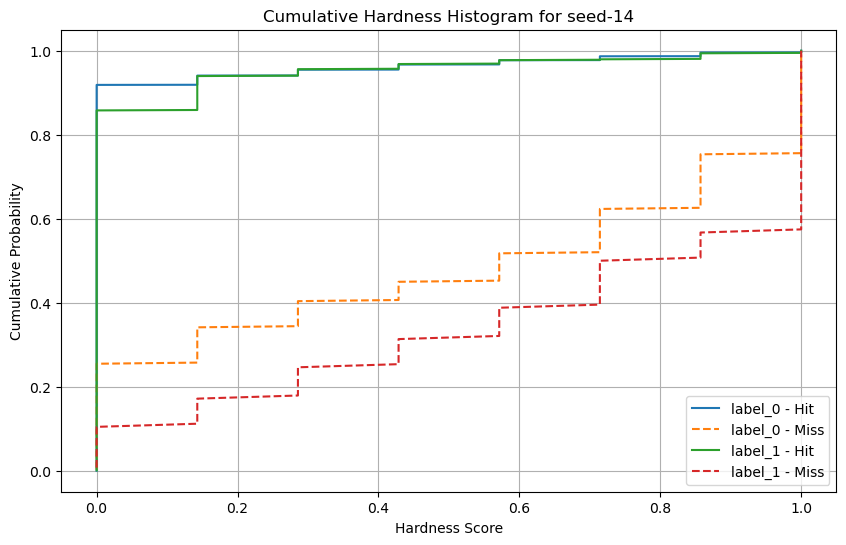

Hardness médio para seed-15: 0.0461
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_16.joblib


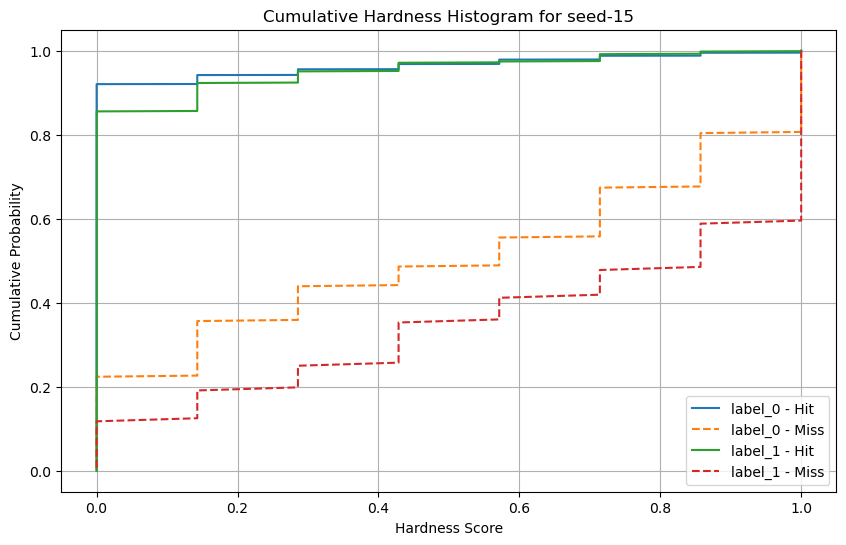

Hardness médio para seed-16: 0.0469
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_17.joblib


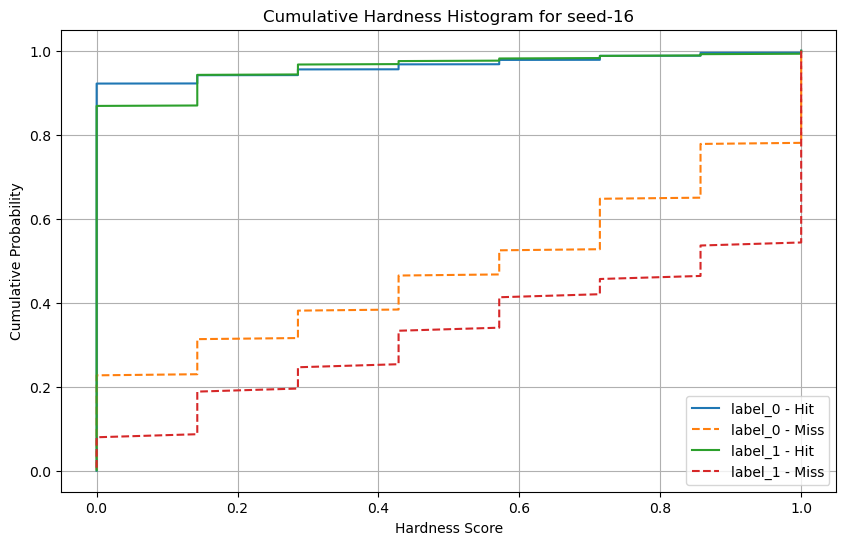

Hardness médio para seed-17: 0.0476
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_18.joblib


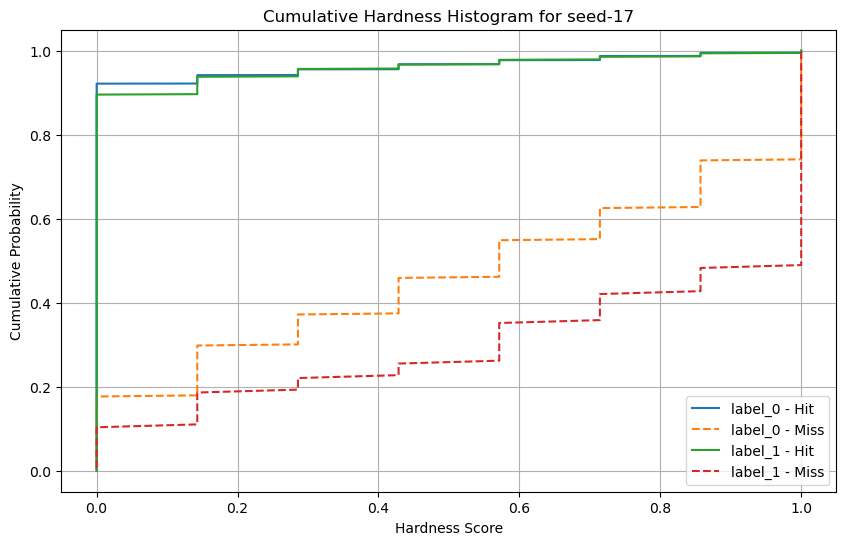

Hardness médio para seed-18: 0.0464
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_19.joblib


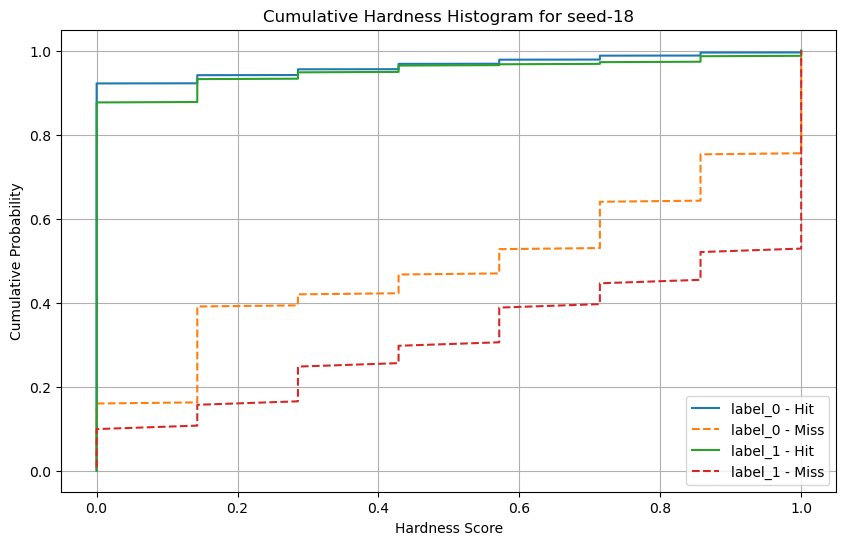

Hardness médio para seed-19: 0.0476
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_20.joblib


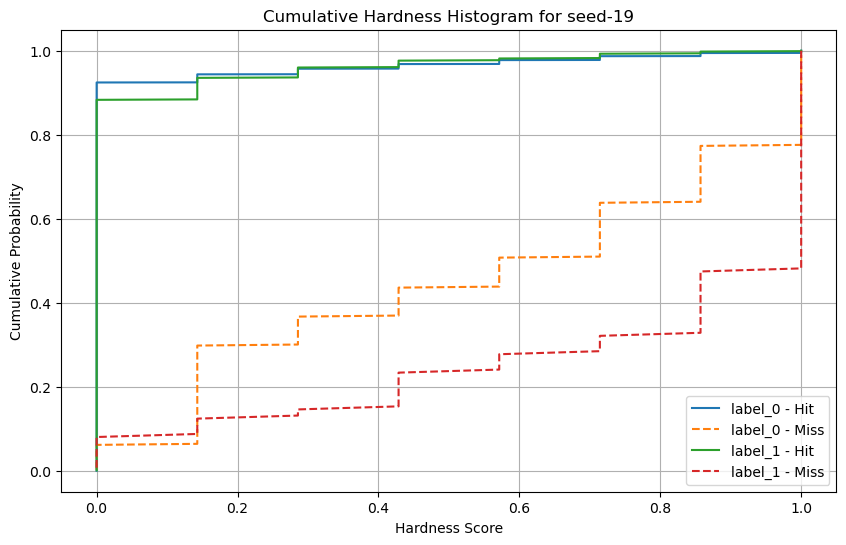

Hardness médio para seed-20: 0.0458
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_21.joblib


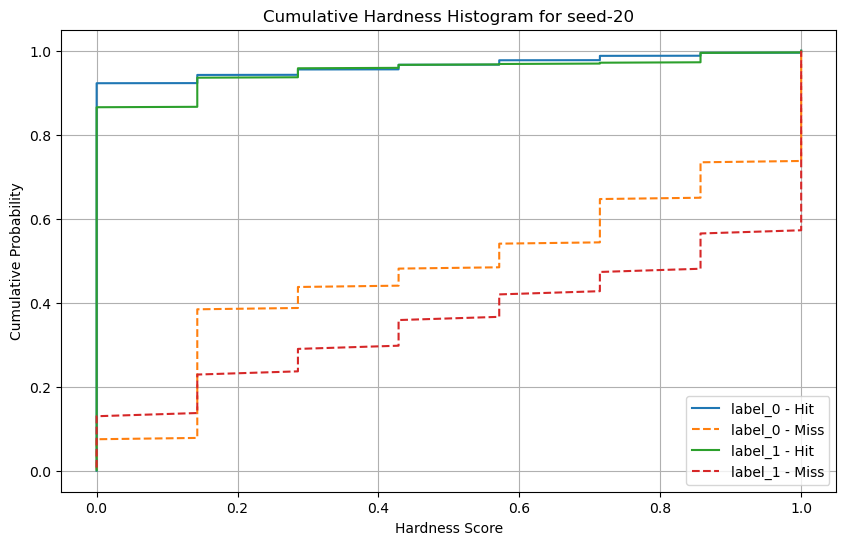

Hardness médio para seed-21: 0.0472
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_22.joblib


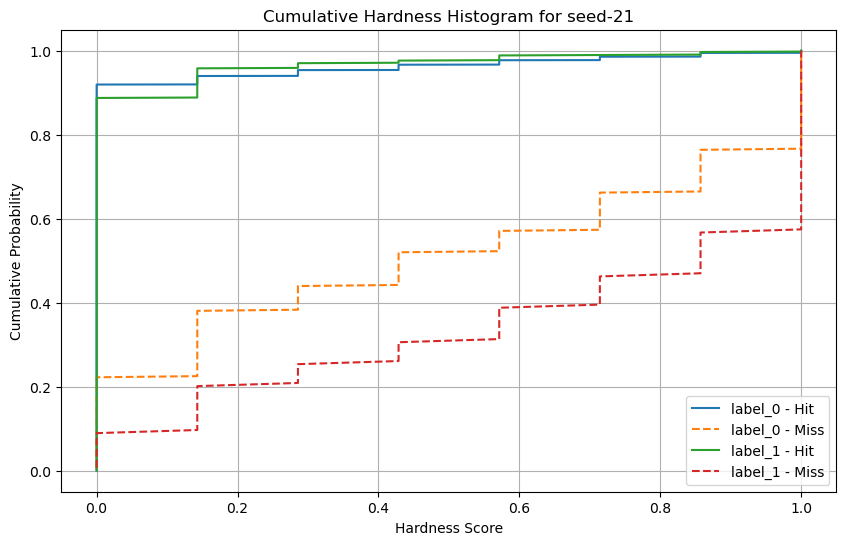

Hardness médio para seed-22: 0.0462
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_23.joblib


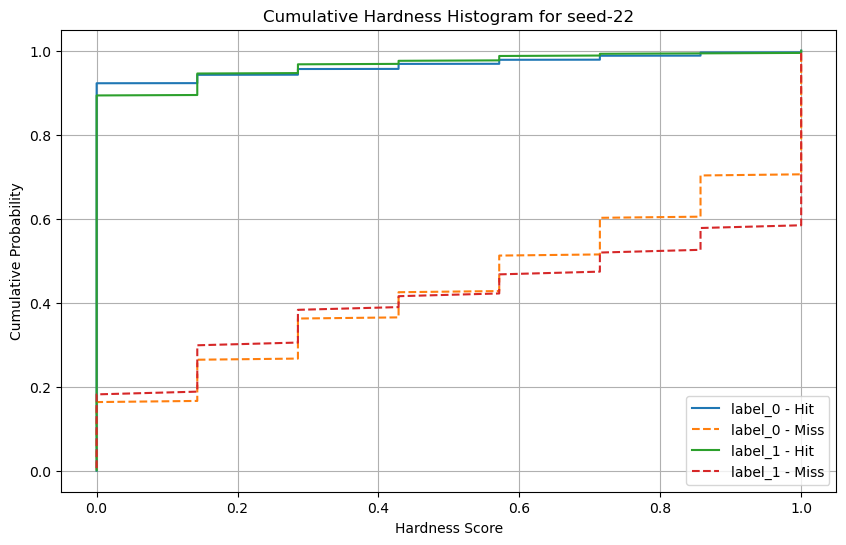

Hardness médio para seed-23: 0.0481
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_24.joblib


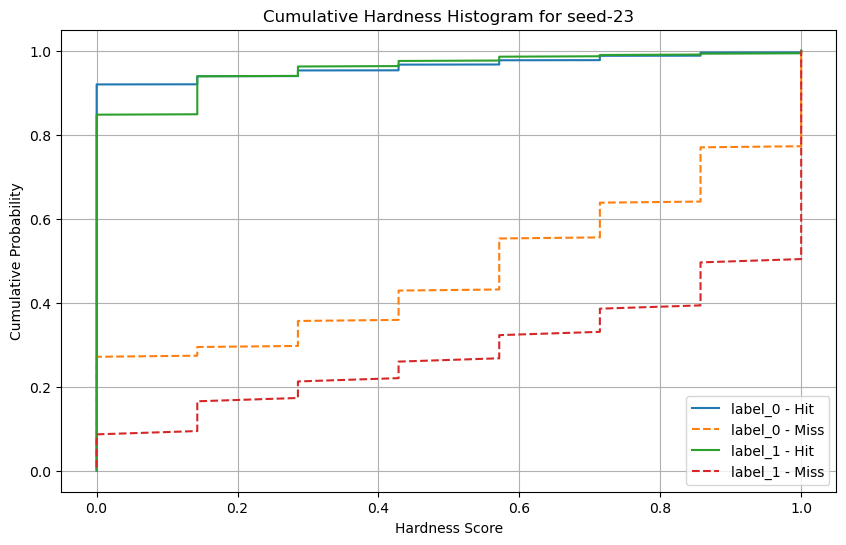

Hardness médio para seed-24: 0.0476
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_25.joblib


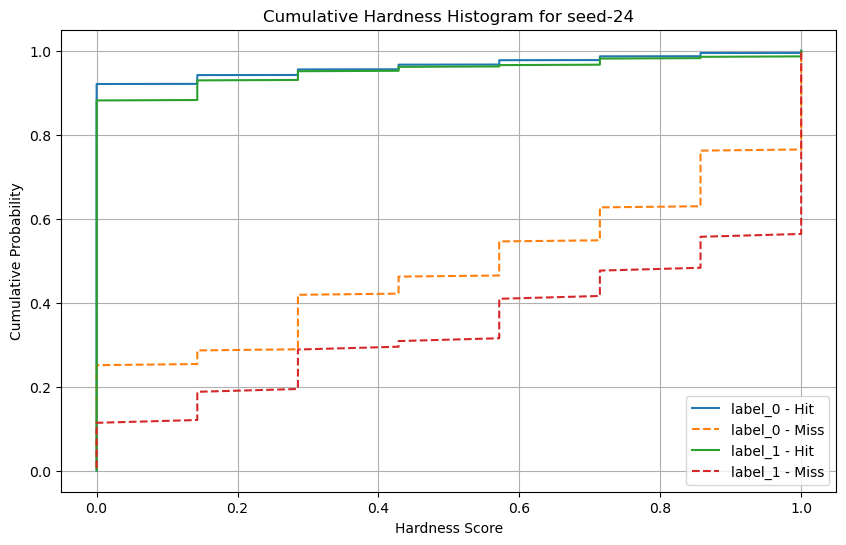

Hardness médio para seed-25: 0.0461
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_26.joblib


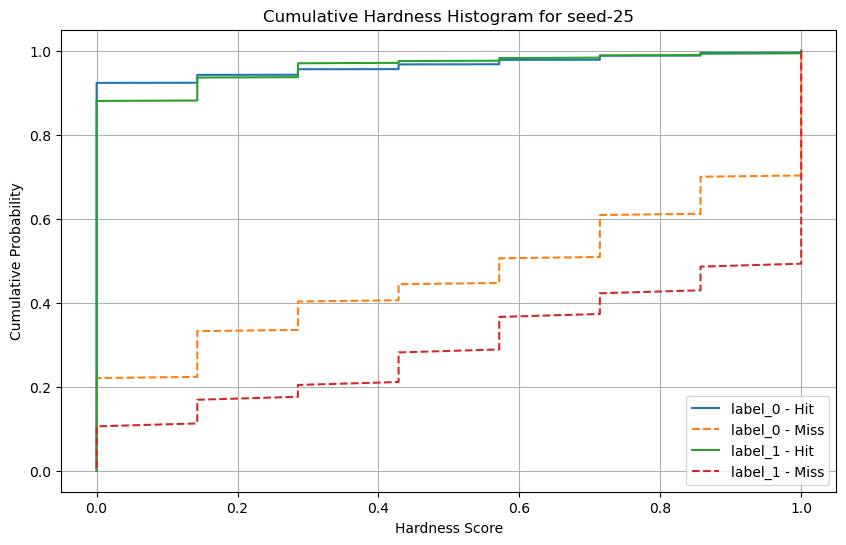

Hardness médio para seed-26: 0.0472
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_27.joblib


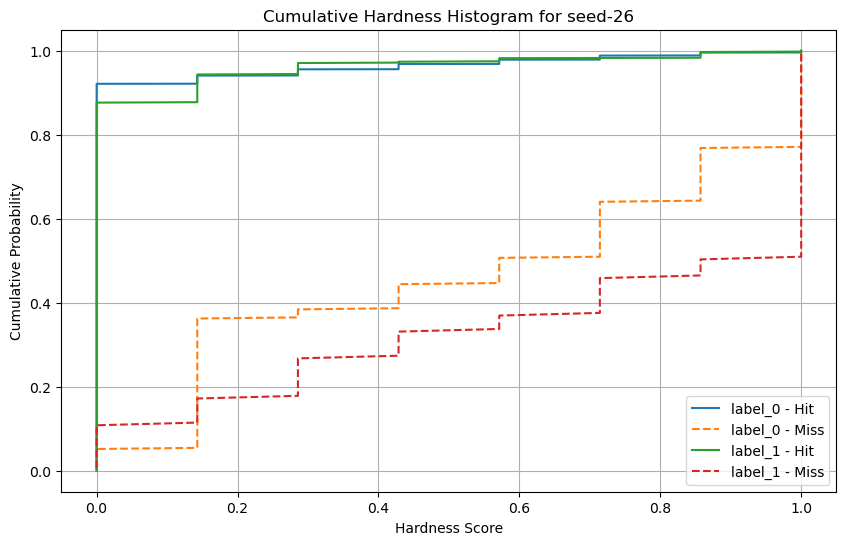

Hardness médio para seed-27: 0.0478
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_28.joblib


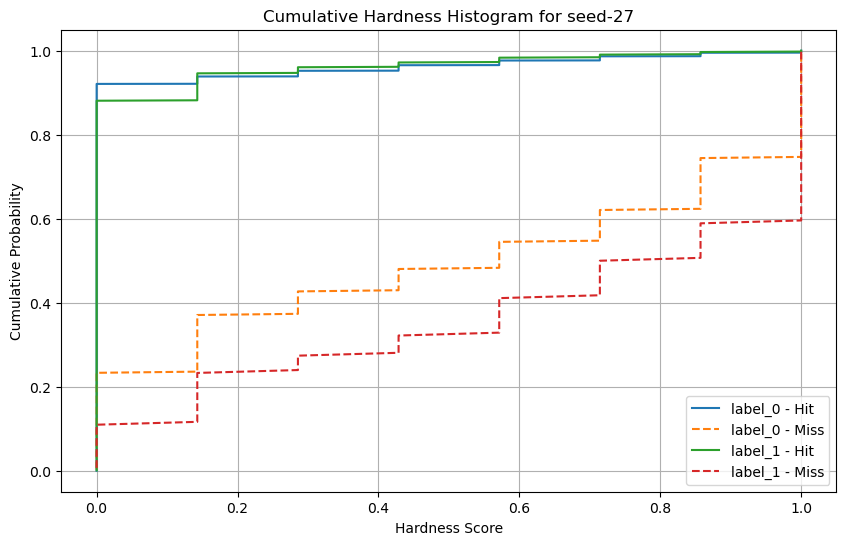

Hardness médio para seed-28: 0.0484
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_29.joblib


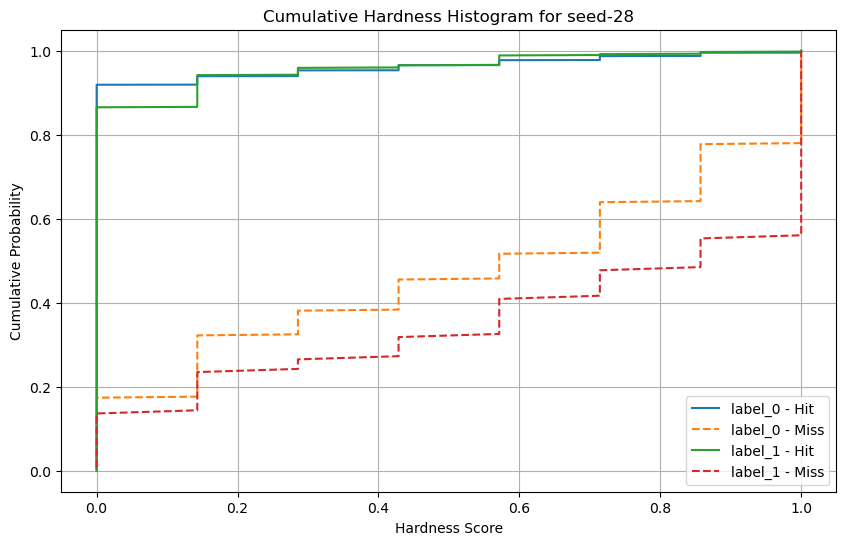

Hardness médio para seed-29: 0.0478
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\RandomForest\model_30.joblib


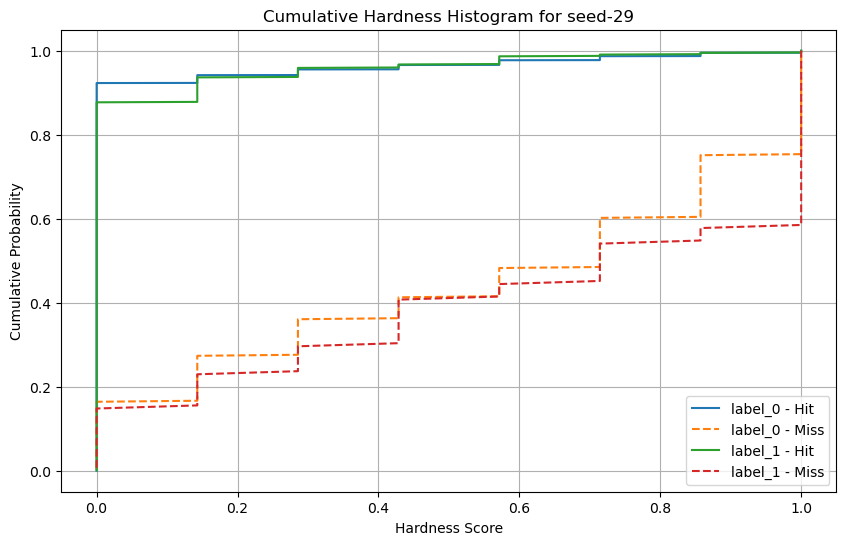

Processando pasta: SingleBest


TypeError: SingleBest.predict() missing 1 required positional argument: 'X'

In [13]:
import os
import joblib
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

models = {}

# Função para ler os dados
x0, y0 = read(LOAD_DATA=False)

with open('modelPredictBalanced.json', 'r') as f:
    model_predict = json.load(f)


# Caminho do diretório com os modelos
dir_path = r'E:\DrebinStudy\Balanced'

def natural_sort_key(s):
    return int(s[6:-7])

with open('test_kdn_scores_balanced.json', 'r') as f:
    kdn_scores = json.load(f)

# Função para criar o gráfico cumulativo para uma seed específica
def plot_cumulative_histogram_single_seed(hardness_table, seed):
    plt.figure(figsize=(10, 6))

    for label in ['label_0', 'label_1']:
        # Hits para a seed especificada
        hit_scores = hardness_table[label]['Hit'][seed]
        sorted_hits = np.sort(hit_scores)
        cumulative_hits = np.arange(1, len(sorted_hits) + 1) / len(sorted_hits)
        plt.plot(sorted_hits, cumulative_hits, label=f"{label} - Hit")

        # Misses para a seed especificada
        miss_scores = hardness_table[label]['Miss'][seed]
        sorted_misses = np.sort(miss_scores)
        cumulative_misses = np.arange(1, len(sorted_misses) + 1) / len(sorted_misses)
        plt.plot(sorted_misses, cumulative_misses, label=f"{label} - Miss", linestyle='--')

    # Configurações do gráfico
    plt.title(f'Cumulative Hardness Histogram for {seed}')
    plt.xlabel('Hardness Score')
    plt.ylabel('Cumulative Probability')
    plt.legend()
    plt.grid(True)
    plt.show()

# Loop para percorrer todas as pastas no diretório (tirando 'Metrics')
for folder_name in os.listdir(dir_path):
    folder_path = os.path.join(dir_path, folder_name)
    
    # Verifica se é uma pasta e se não é a pasta 'Metrics'
    if os.path.isdir(folder_path) and folder_name != 'Metrics' and folder_name != 'Bagging2' and folder_name != 'KNOP' and folder_name != 'METADES' and folder_name != 'OLA':
        print(f'Processando pasta: {folder_name}')
        i = 0
        hardness_table = {'label_0': {'Hit':{}, 'Miss':{}}, 'label_1': {'Hit':{}, 'Miss':{}}}

        if folder_path not in list(model_predict.keys()):
            model_predict[folder_path] = dict()
        # Processar os modelos dentro da pasta
        for file_name in sorted(os.listdir(folder_path), key=natural_sort_key):
            if file_name in list(model_predict[folder_path].keys()):
                i += 1
                continue
            file_path = os.path.join(folder_path, file_name)
            x_train, x_test, y_train, y_test = train_test_split(
                np.arange(len(x0)), y0, test_size=0.2, stratify=y0, random_state=i)
            hardness_score = np.array(list(kdn_scores[f"seed-{i}"].values()))
            
            model = joblib.load(file_path)
            y_pred = model.predict(x0[x_test])
            indices_diferentes = np.where(y_pred != y_test)[0].tolist()

            model_predict[folder_path][file_name] = indices_diferentes

            with open("modelPredictBalanced.json", "w") as file:
                json.dump(model_predict, file, indent=4)

            # Separar os scores por label
            for label in [0, 1]:
                hit_scores = hardness_score[(y_test == y_pred) & (y_test == label)]
                miss_scores = hardness_score[(y_test != y_pred) & (y_test == label)]
                hardness_table[f'label_{label}']['Hit'][f'seed-{str(i)}'] = hit_scores
                hardness_table[f'label_{label}']['Miss'][f'seed-{str(i)}'] = miss_scores

            print(f"Hardness médio para seed-{i}: {np.mean(hardness_score):.4f}")
            i += 1   
            print(f'Arquivo de modelo encontrado: {file_path}')
            
            # Gerar gráfico cumulativo para o modelo atual
            plot_cumulative_histogram_single_seed(hardness_table, f'seed-{i-1}')  # Mostrar para o último seed processado
        
        # Salvar a hardness_table por pasta
        models[folder_name] = hardness_table

In [20]:
import json

def comparar_quantidades_multiplos(modelos, seed, erros_modelos):
    # Inicializa a interseção com o conjunto de erros do primeiro modelo
    erros_comuns = set(erros_modelos[modelos[0]][f"model_{seed+1}.joblib"])
    
    # Itera sobre os modelos restantes e calcula a interseção sucessiva
    for modelo in modelos[1:]:
        erros_comuns &= set(erros_modelos[modelo][f"model_{seed+1}.joblib"])
    
    # Calcula a união de todos os erros (para calcular a porcentagem de erros comuns)
    erros_totais = set(erros_modelos[modelos[0]][f"model_{seed+1}.joblib"])
    for modelo in modelos[1:]:
        erros_totais |= set(erros_modelos[modelo][f"model_{seed+1}.joblib"])
    
    # Calcula as quantidades e a porcentagem
    quantidade_comum = len(erros_comuns)
    porcentagem_comum = len(erros_comuns) / len(erros_totais) * 100
    
    # Retorna apenas as quantidades
    return {
        'quantidade_comum': quantidade_comum,
        'porcentagem_comum': porcentagem_comum
    }

# Carrega o JSON com os dados de erros dos modelos
with open('modelPredictBalanced.json') as f:
    erros_modelos = json.load(f)

# Lista todos os modelos no dicionário
modelos = list(erros_modelos.keys())
# modelos = ["E:\\DrebinStudy\\Balanced\\BaggingDecisionTree", "E:\\DrebinStudy\\Balanced\\DecisionTree", "E:\\DrebinStudy\\Balanced\\RandomForest"]

# Itera pelas 30 seeds e calcula os resultados para cada seed
for i in range(30):
    resultado = comparar_quantidades_multiplos(modelos, i, erros_modelos)

    print(f"Quantidade de instâncias que todos os modelos erraram em comum na seed {i}: {resultado['quantidade_comum']}")
    print(f"Porcentagem de erros comuns entre os modelos na seed {i}: {resultado['porcentagem_comum']:.2f}%")

Quantidade de instâncias que todos os modelos erraram em comum na seed 0: 107
Porcentagem de erros comuns entre os modelos na seed 0: 1.21%
Quantidade de instâncias que todos os modelos erraram em comum na seed 1: 78
Porcentagem de erros comuns entre os modelos na seed 1: 0.85%
Quantidade de instâncias que todos os modelos erraram em comum na seed 2: 99
Porcentagem de erros comuns entre os modelos na seed 2: 1.15%
Quantidade de instâncias que todos os modelos erraram em comum na seed 3: 83
Porcentagem de erros comuns entre os modelos na seed 3: 0.94%
Quantidade de instâncias que todos os modelos erraram em comum na seed 4: 91
Porcentagem de erros comuns entre os modelos na seed 4: 1.02%
Quantidade de instâncias que todos os modelos erraram em comum na seed 5: 80
Porcentagem de erros comuns entre os modelos na seed 5: 0.88%
Quantidade de instâncias que todos os modelos erraram em comum na seed 6: 85
Porcentagem de erros comuns entre os modelos na seed 6: 0.96%
Quantidade de instâncias q

Loading previous data ...
(129013, 8) (129013,)
Processando pasta: BaggingDecisionTree
Hardness médio para seed-0: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_1.joblib


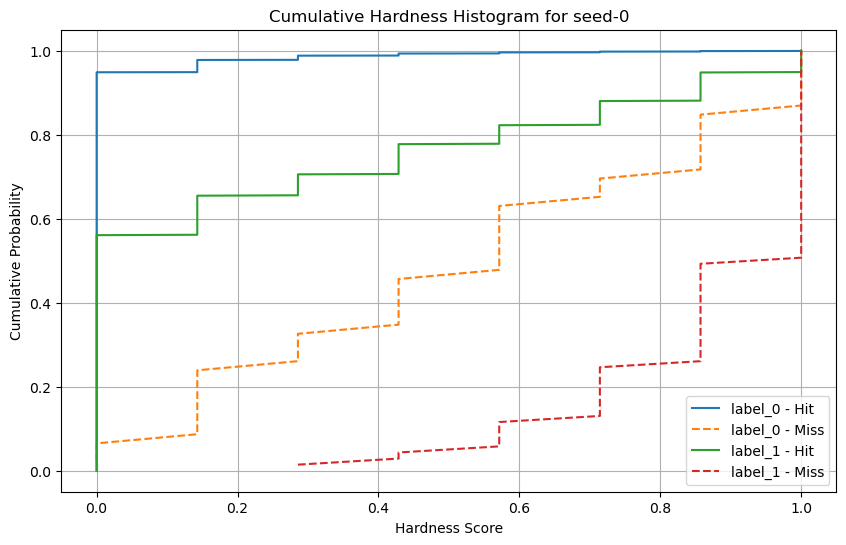

Hardness médio para seed-1: 0.0252
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_2.joblib


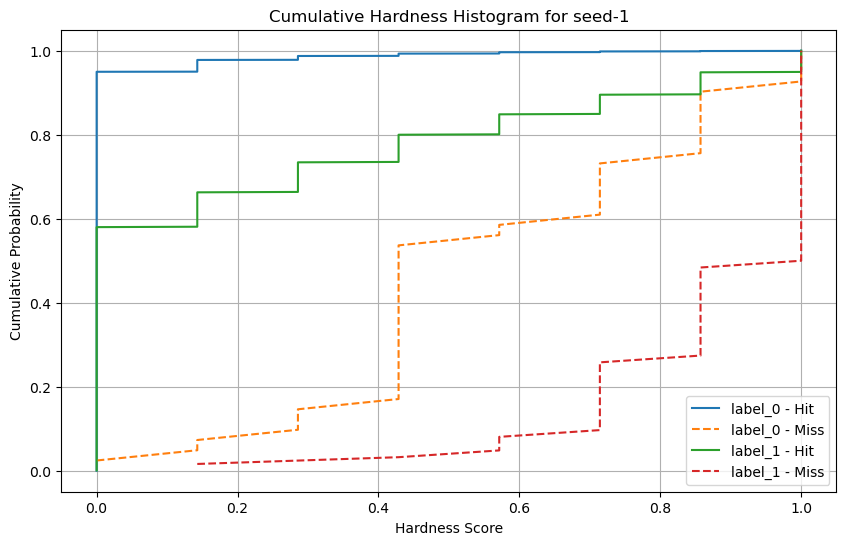

Hardness médio para seed-2: 0.0258
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_3.joblib


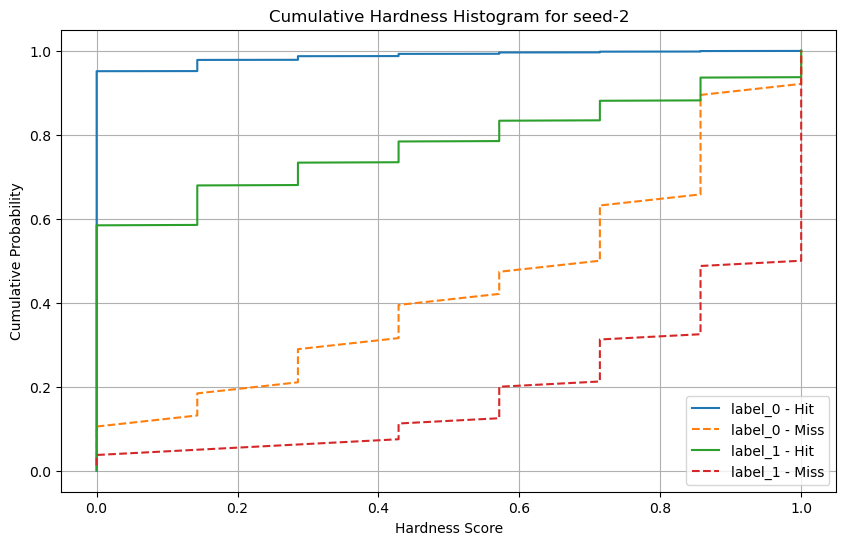

Hardness médio para seed-3: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_4.joblib


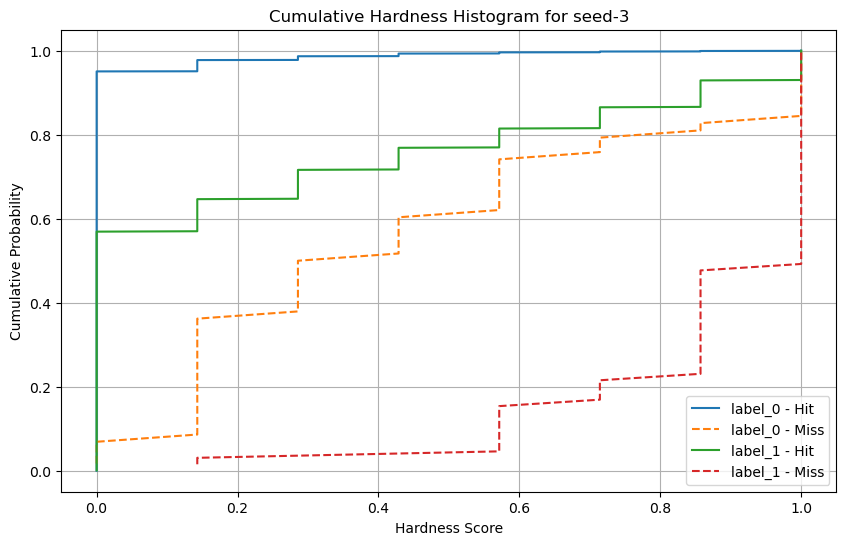

Hardness médio para seed-4: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_5.joblib


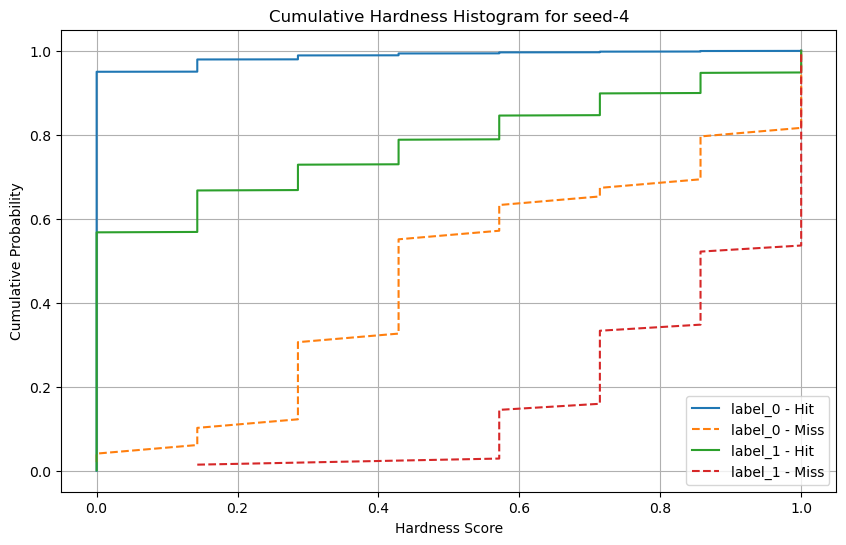

Hardness médio para seed-5: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_6.joblib


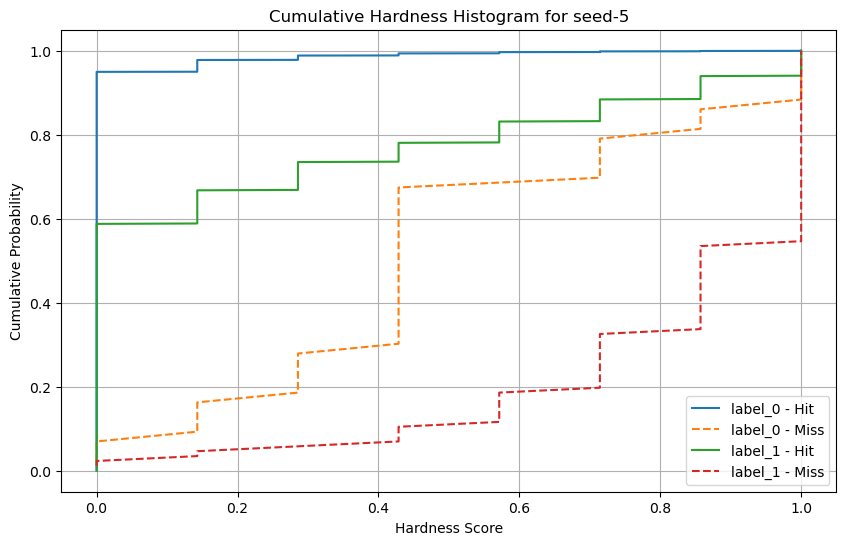

Hardness médio para seed-6: 0.0272
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_7.joblib


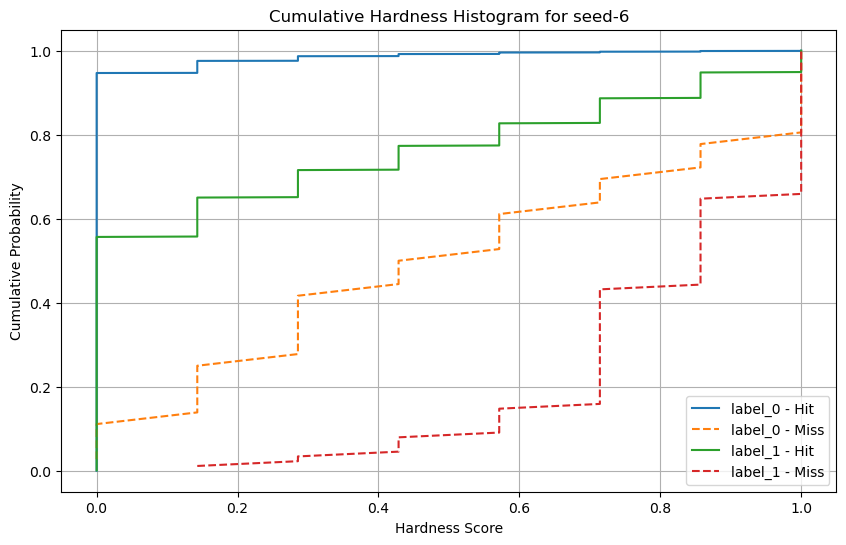

Hardness médio para seed-7: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_8.joblib


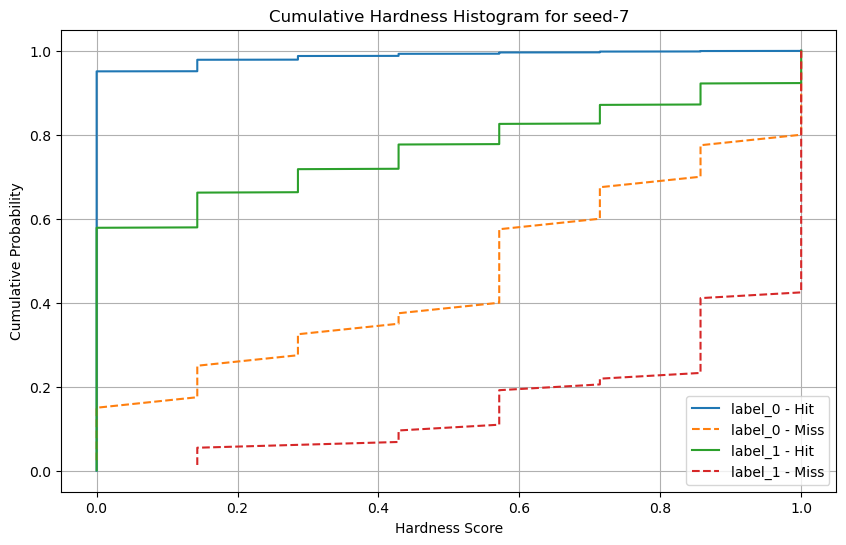

Hardness médio para seed-8: 0.0253
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_9.joblib


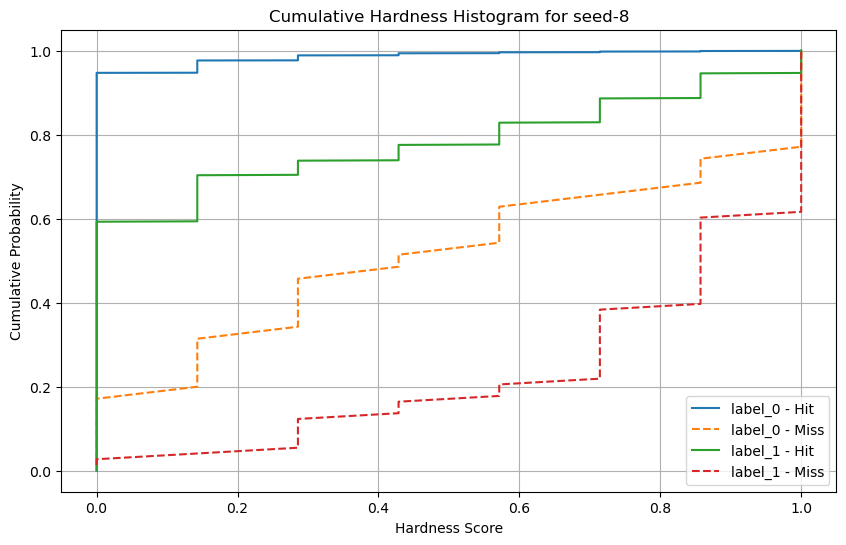

Hardness médio para seed-9: 0.0268
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_10.joblib


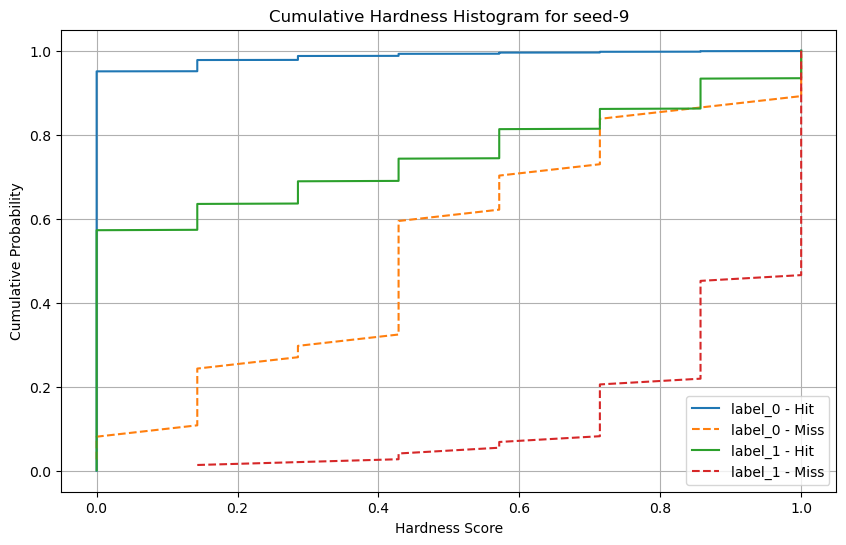

Hardness médio para seed-10: 0.0262
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_11.joblib


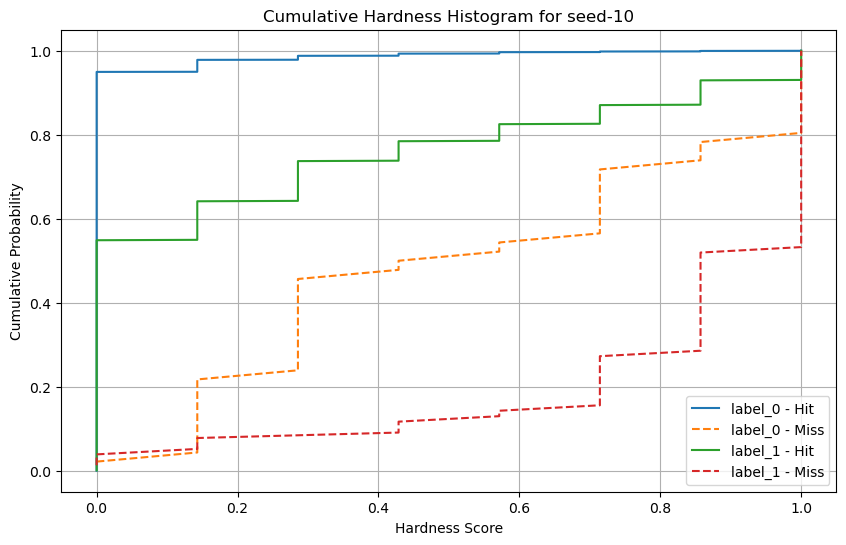

Hardness médio para seed-11: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_12.joblib


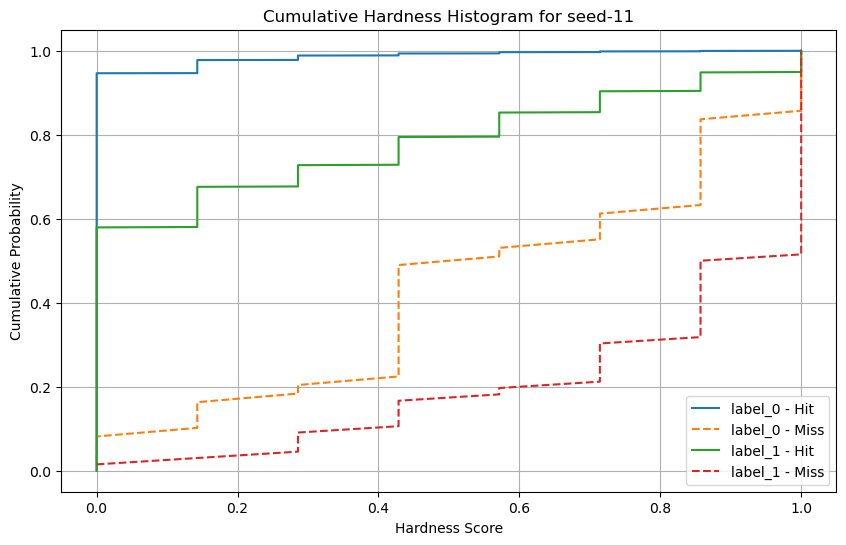

Hardness médio para seed-12: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_13.joblib


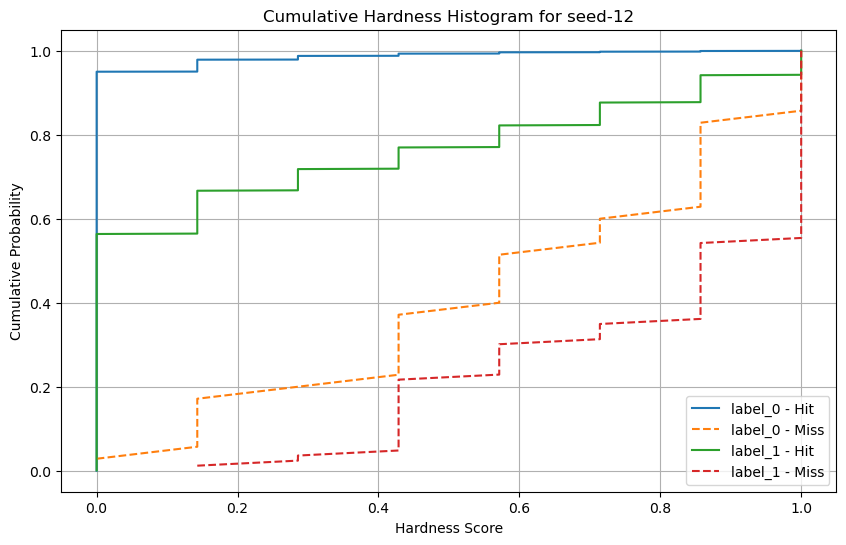

Hardness médio para seed-13: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_14.joblib


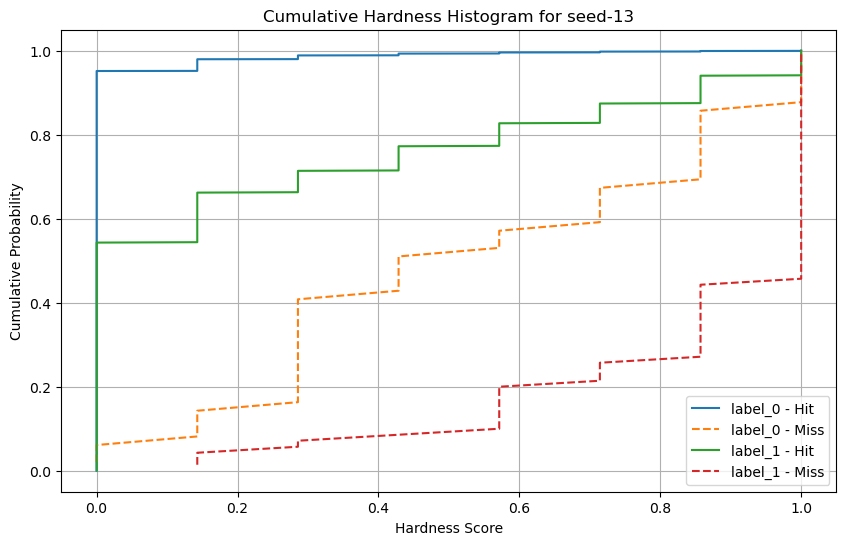

Hardness médio para seed-14: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_15.joblib


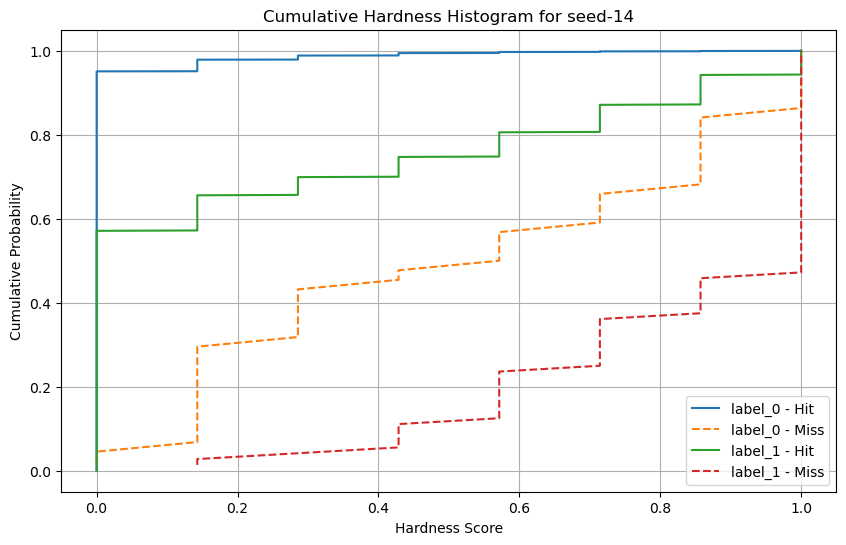

Hardness médio para seed-15: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_16.joblib


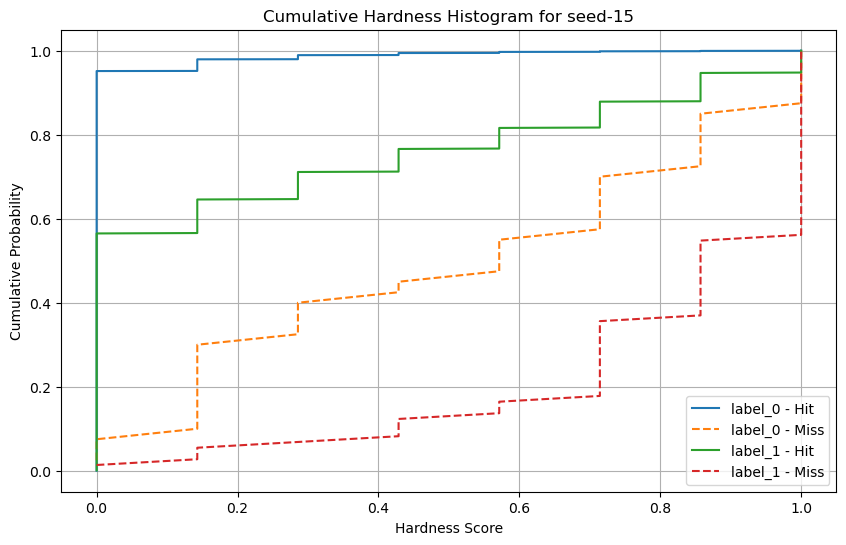

Hardness médio para seed-16: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_17.joblib


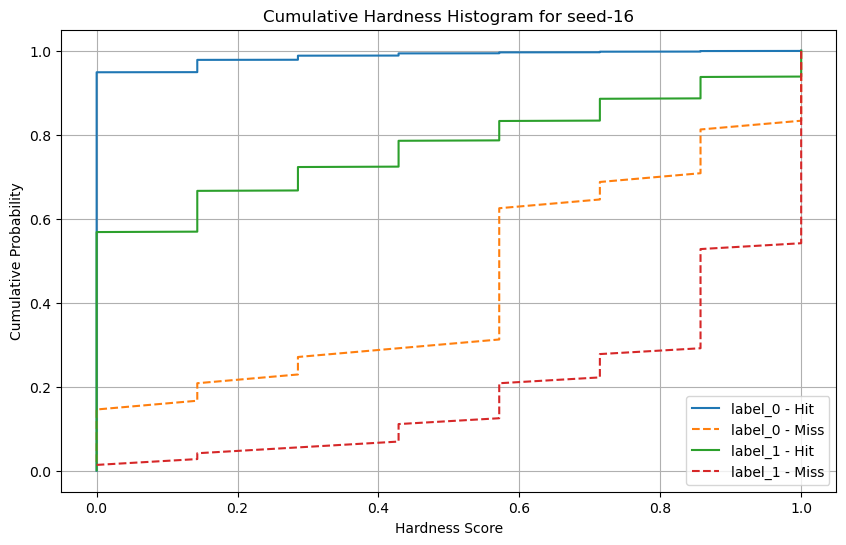

Hardness médio para seed-17: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_18.joblib


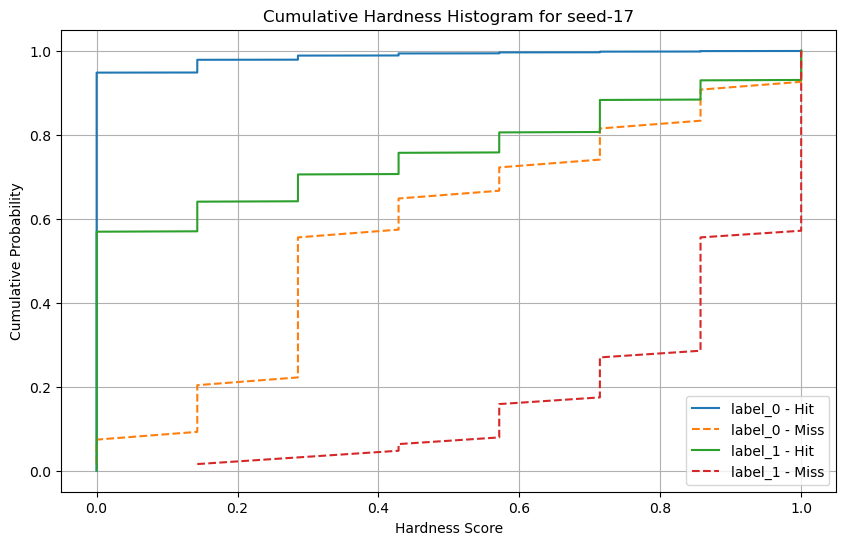

Hardness médio para seed-18: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_19.joblib


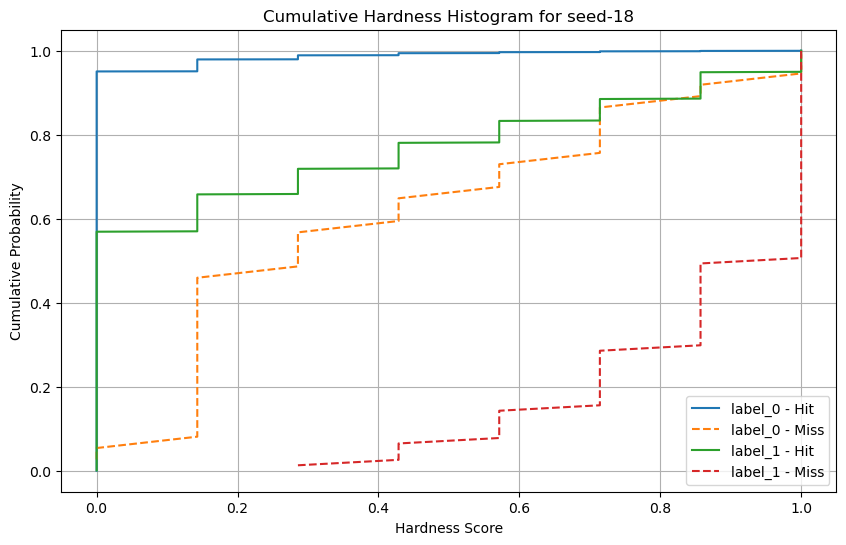

Hardness médio para seed-19: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_20.joblib


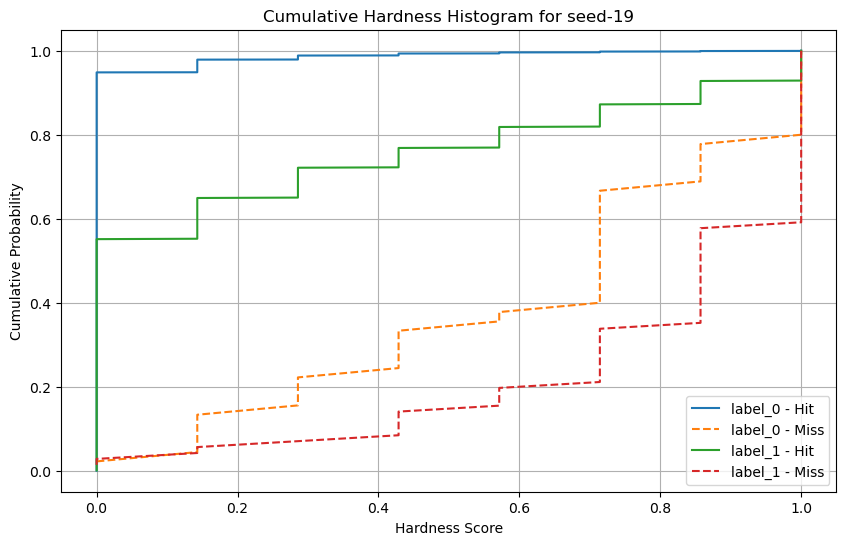

Hardness médio para seed-20: 0.0250
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_21.joblib


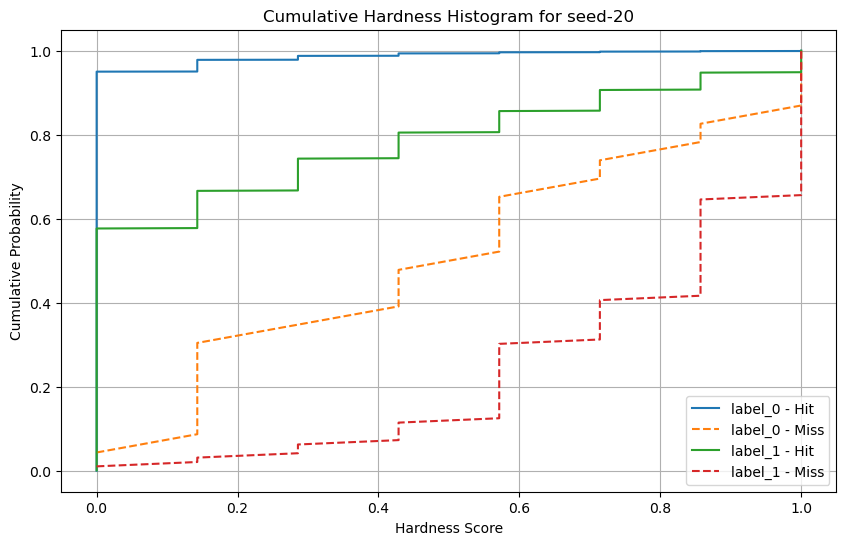

Hardness médio para seed-21: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_22.joblib


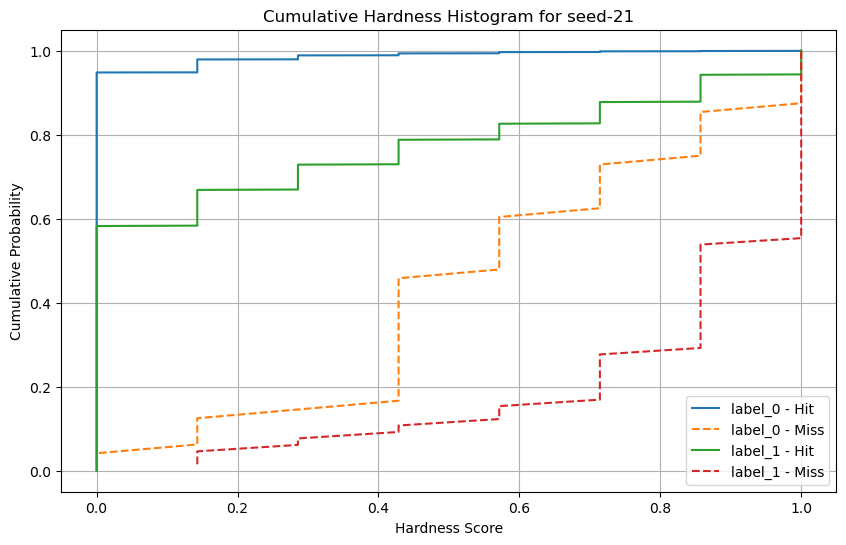

Hardness médio para seed-22: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_23.joblib


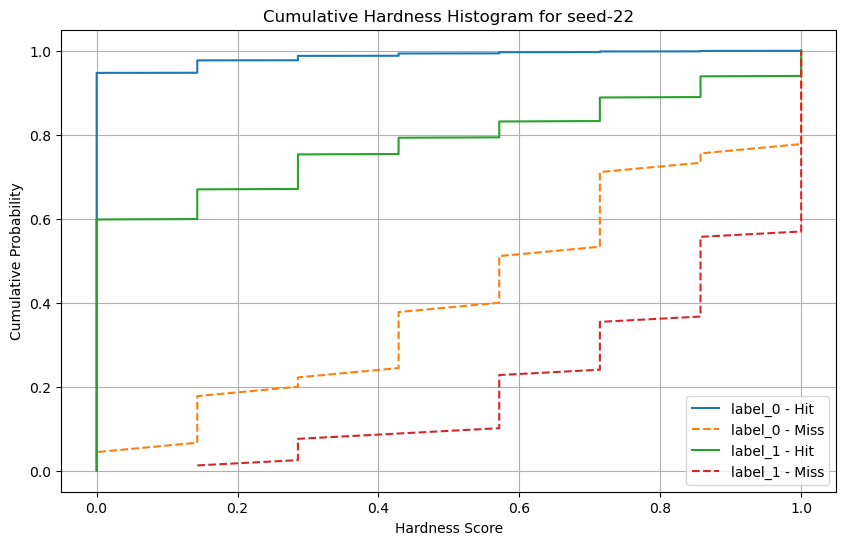

Hardness médio para seed-23: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_24.joblib


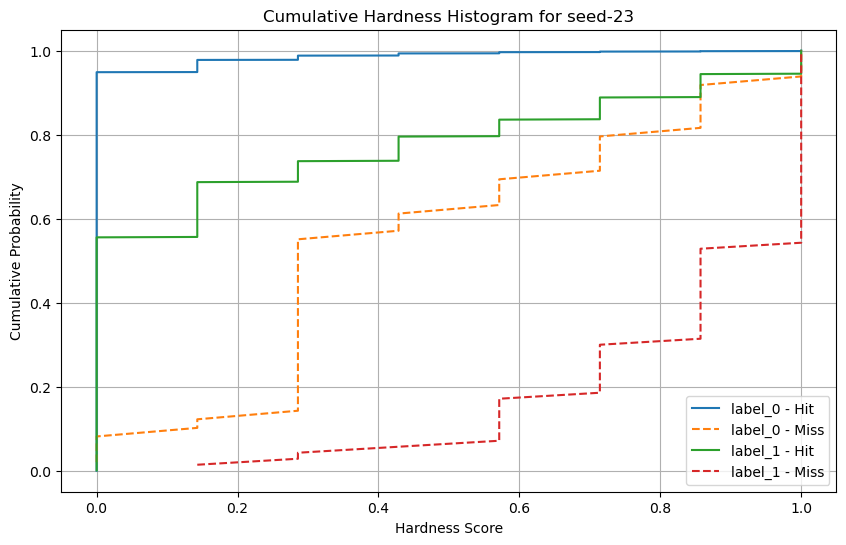

Hardness médio para seed-24: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_25.joblib


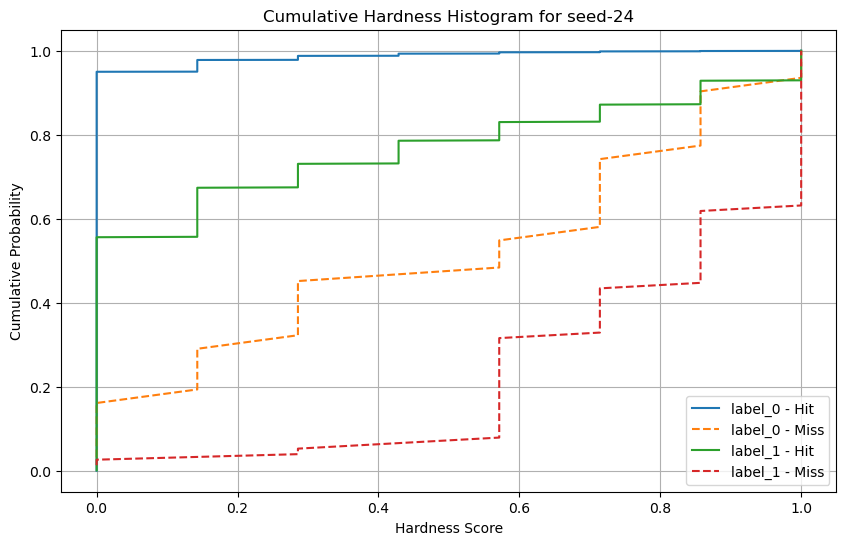

Hardness médio para seed-25: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_26.joblib


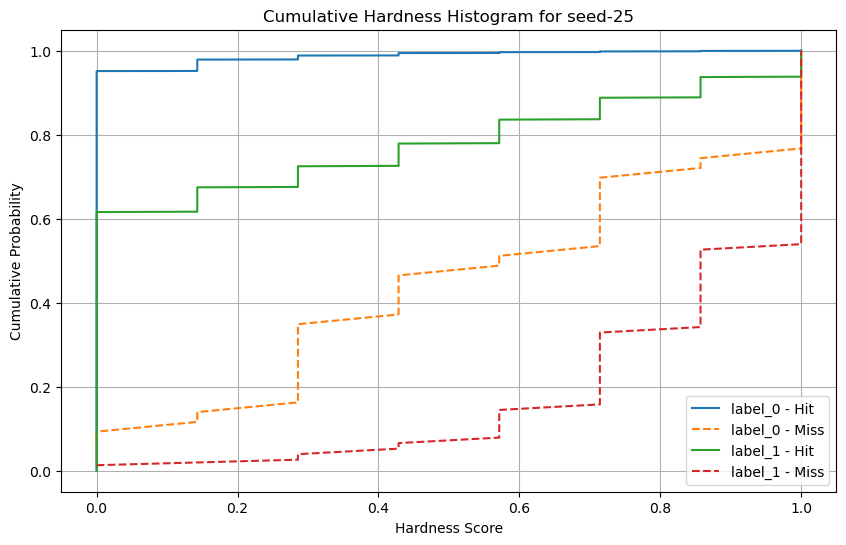

Hardness médio para seed-26: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_27.joblib


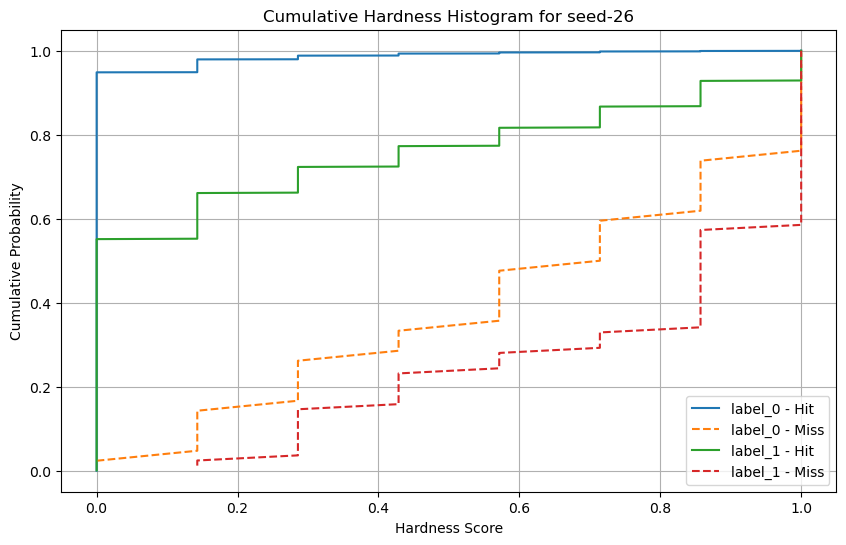

Hardness médio para seed-27: 0.0248
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_28.joblib


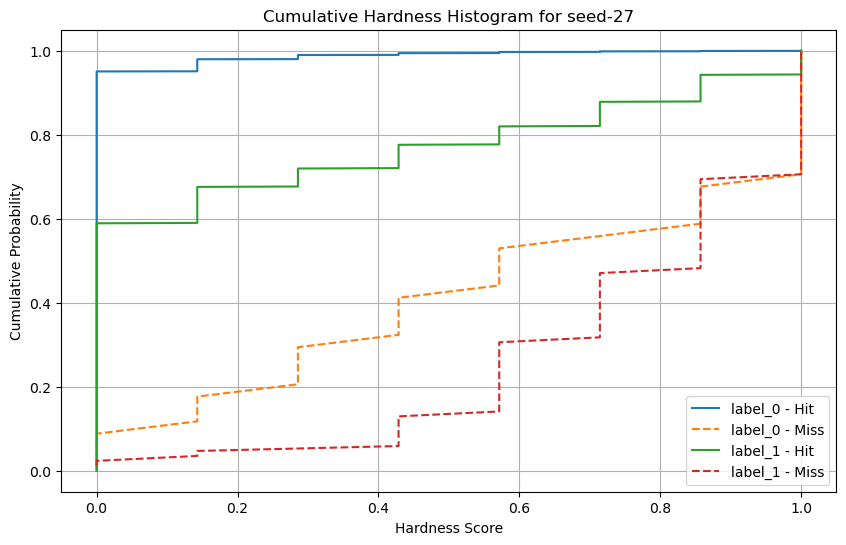

Hardness médio para seed-28: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_29.joblib


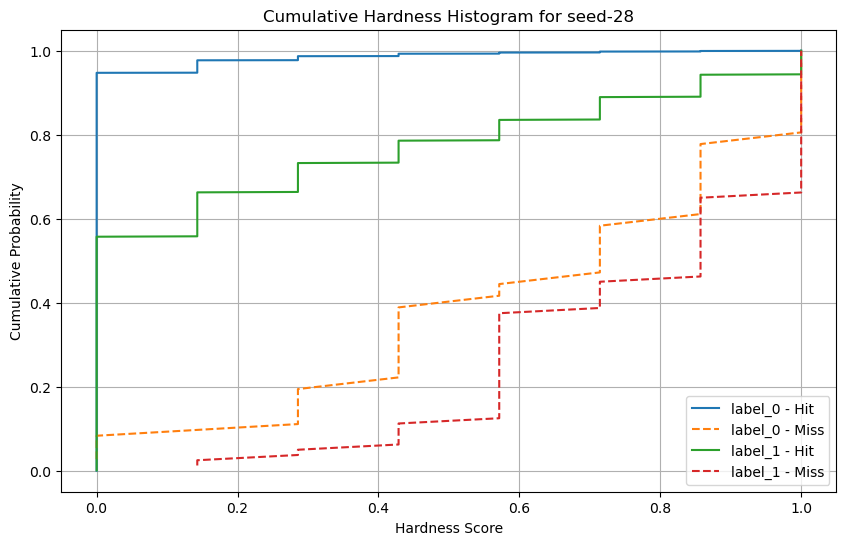

Hardness médio para seed-29: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingDecisionTree\model_30.joblib


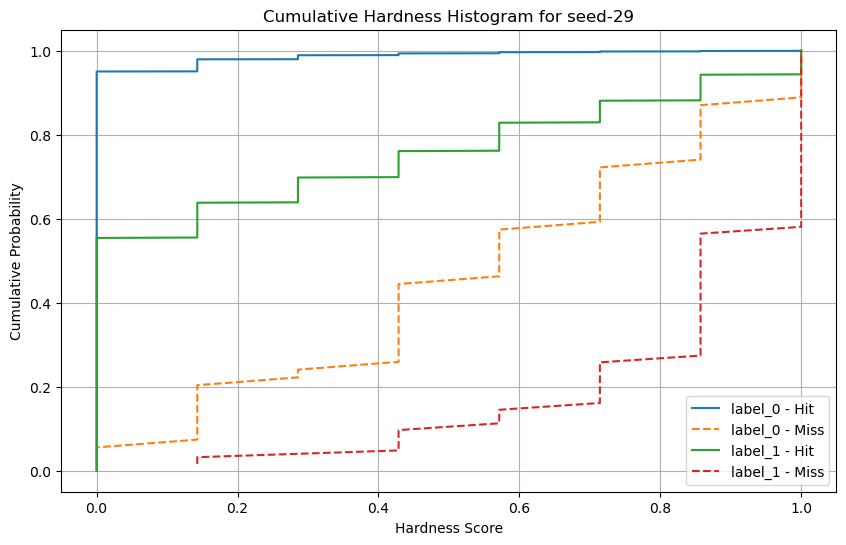

Processando pasta: BaggingKnn
Hardness médio para seed-0: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_1.joblib


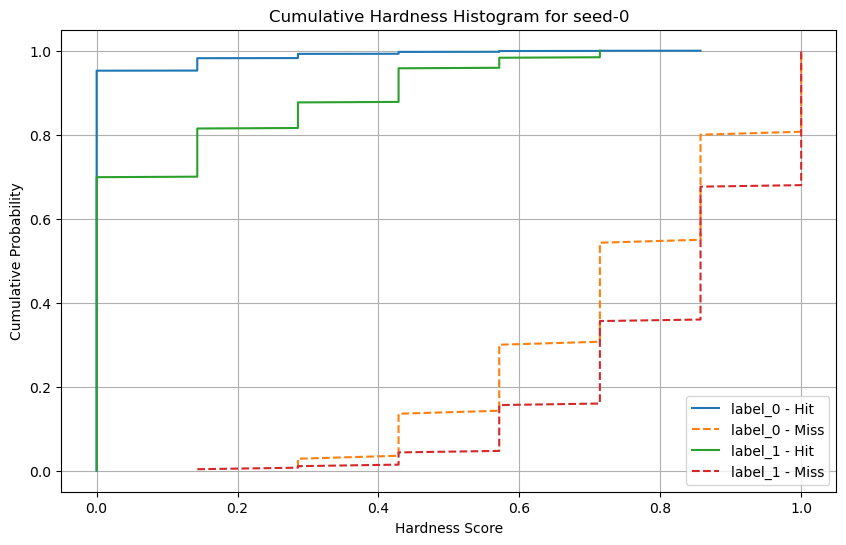

Hardness médio para seed-1: 0.0252
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_2.joblib


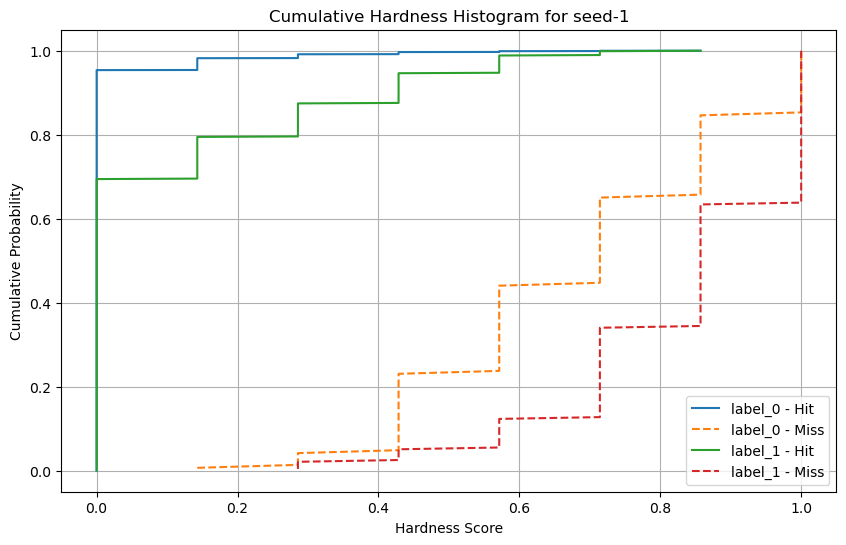

Hardness médio para seed-2: 0.0258
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_3.joblib


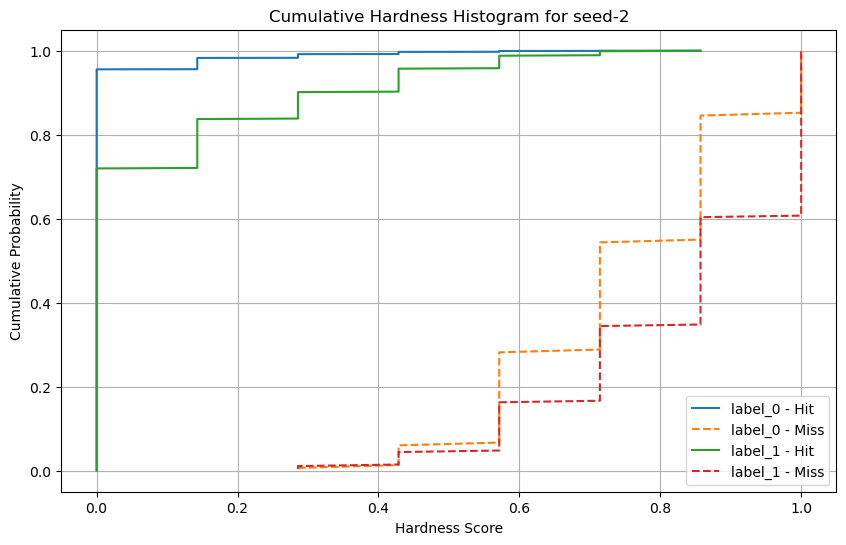

Hardness médio para seed-3: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_4.joblib


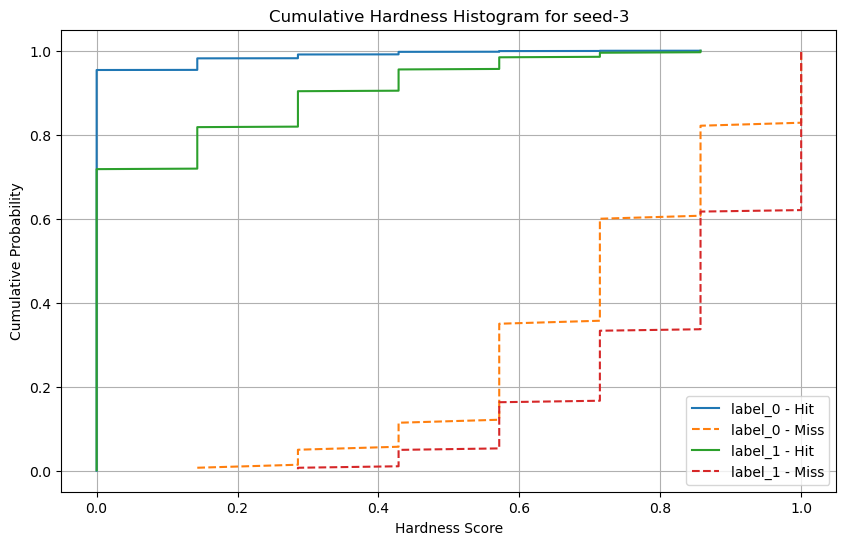

Hardness médio para seed-4: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_5.joblib


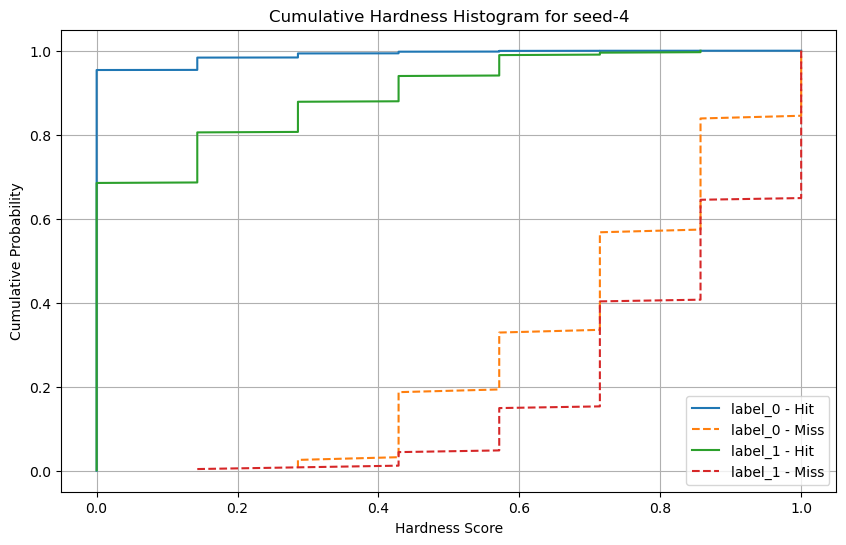

Hardness médio para seed-5: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_6.joblib


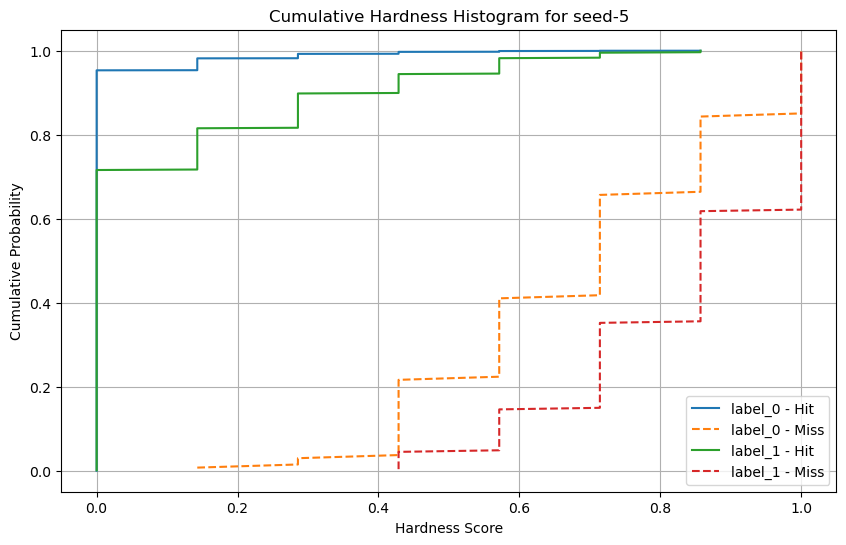

Hardness médio para seed-6: 0.0272
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_7.joblib


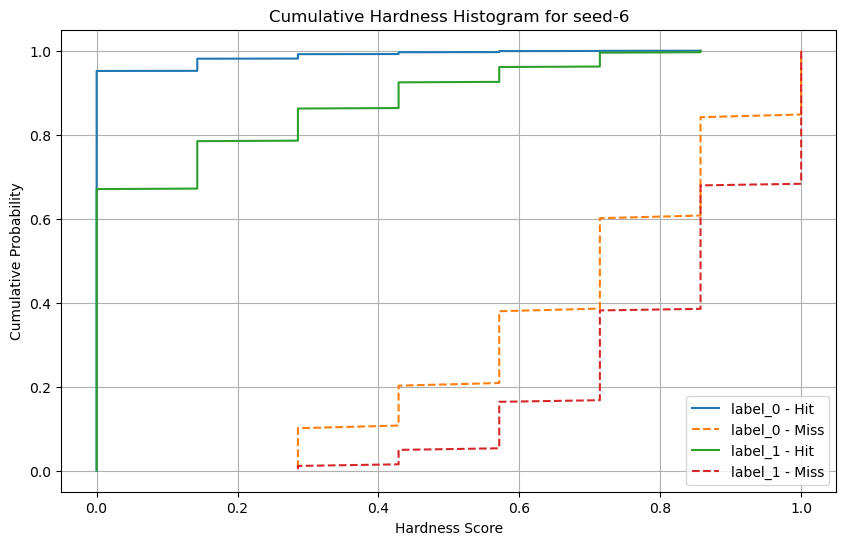

Hardness médio para seed-7: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_8.joblib


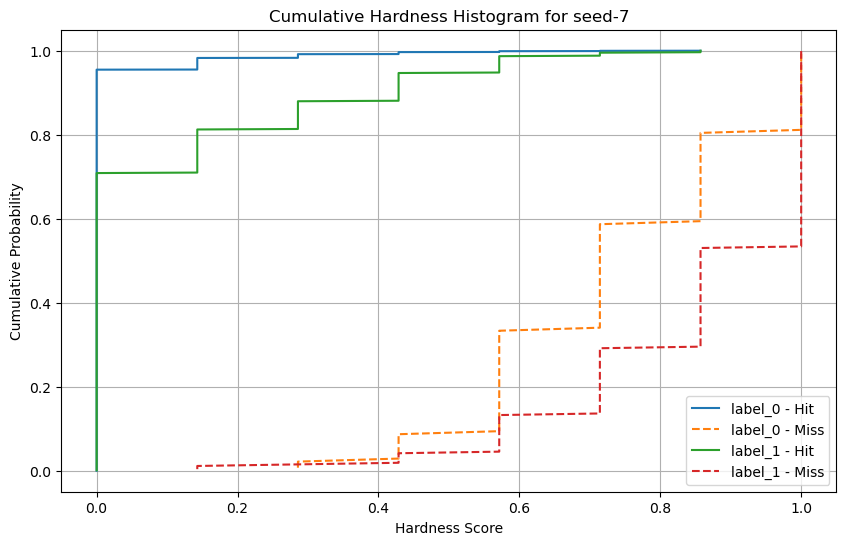

Hardness médio para seed-8: 0.0253
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_9.joblib


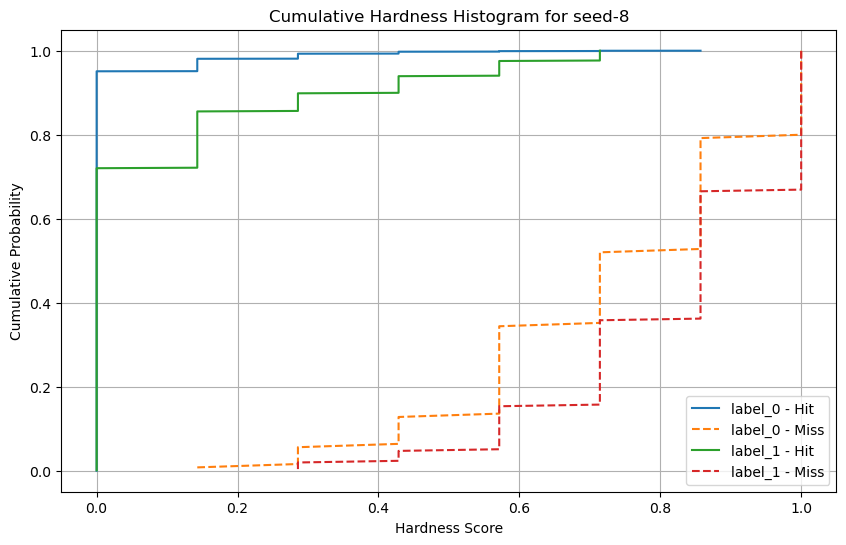

Hardness médio para seed-9: 0.0268
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_10.joblib


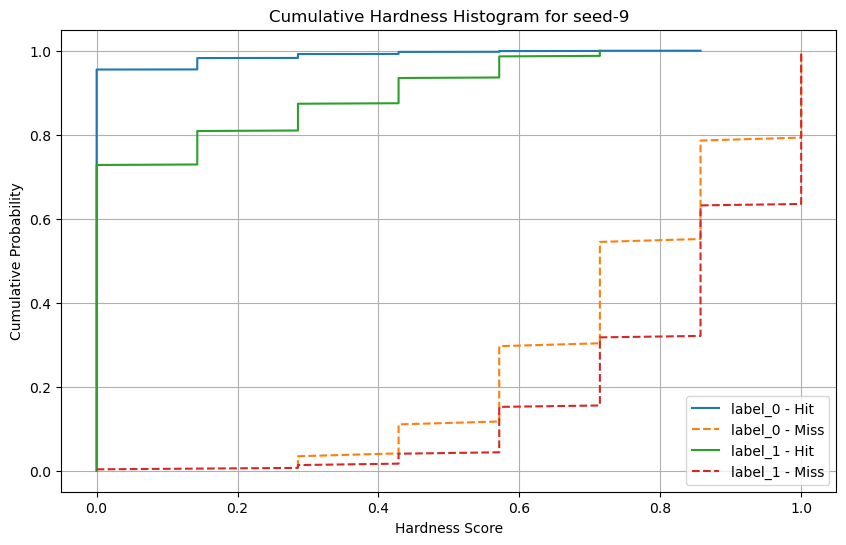

Hardness médio para seed-10: 0.0262
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_11.joblib


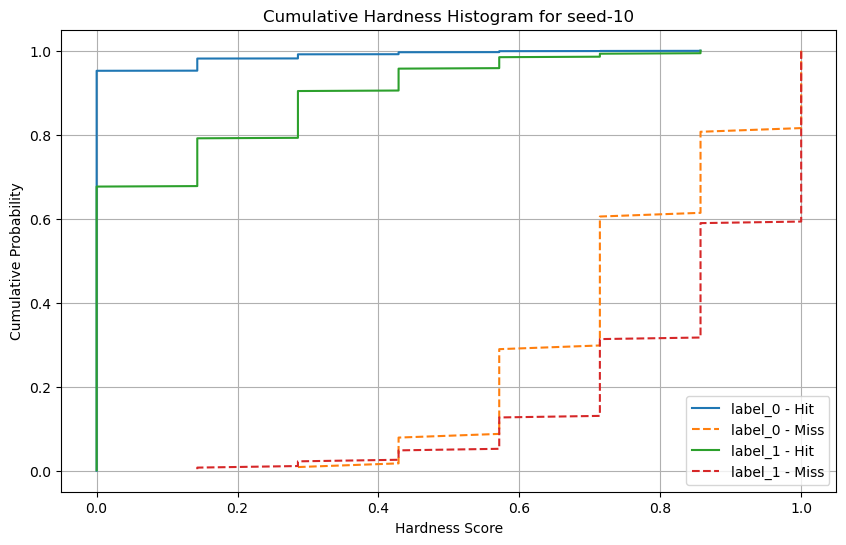

Hardness médio para seed-11: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_12.joblib


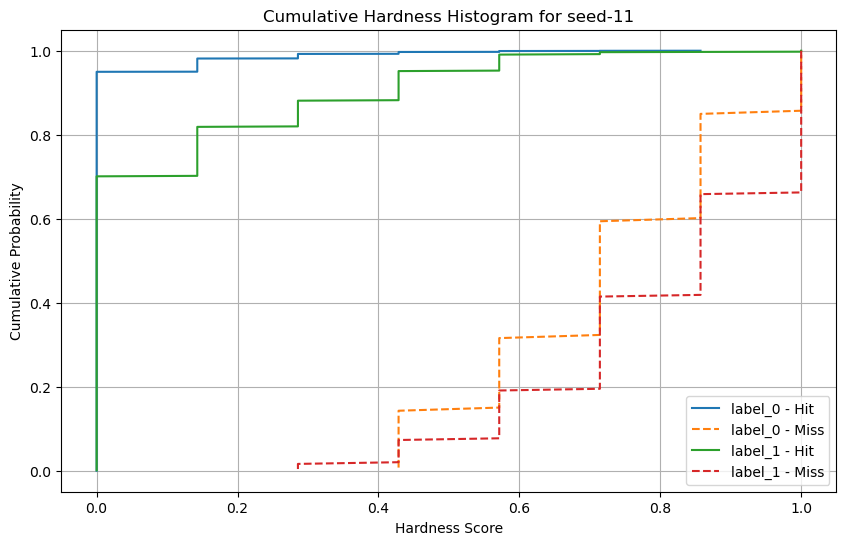

Hardness médio para seed-12: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_13.joblib


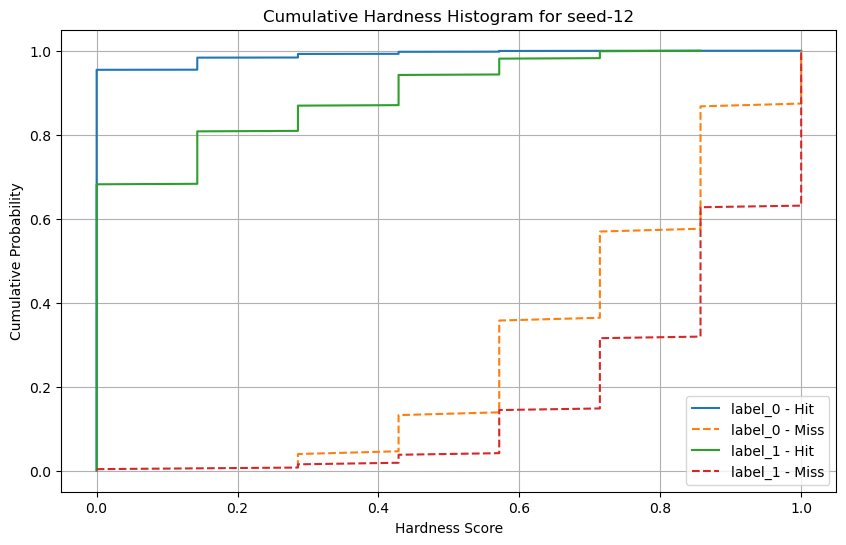

Hardness médio para seed-13: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_14.joblib


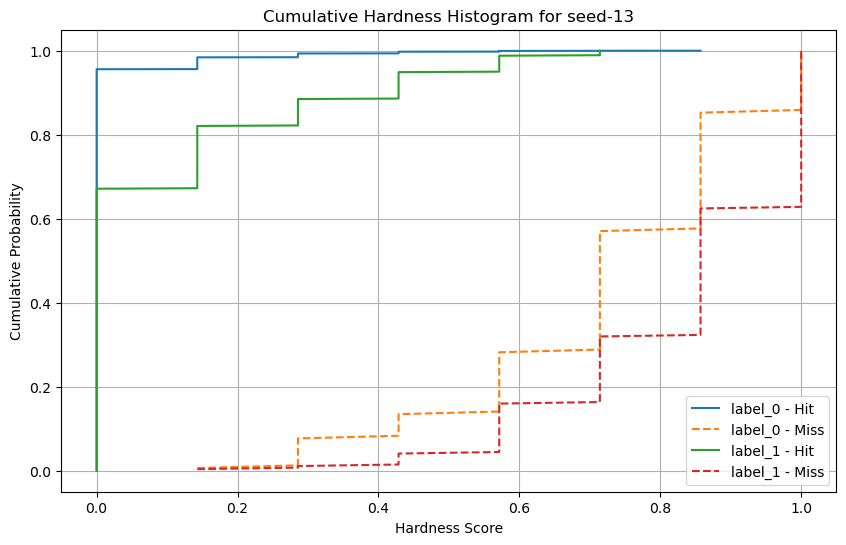

Hardness médio para seed-14: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_15.joblib


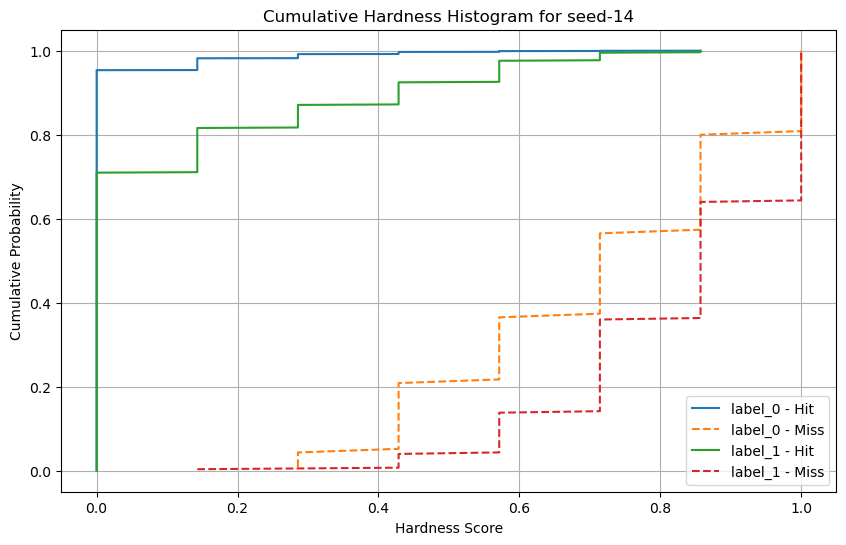

Hardness médio para seed-15: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_16.joblib


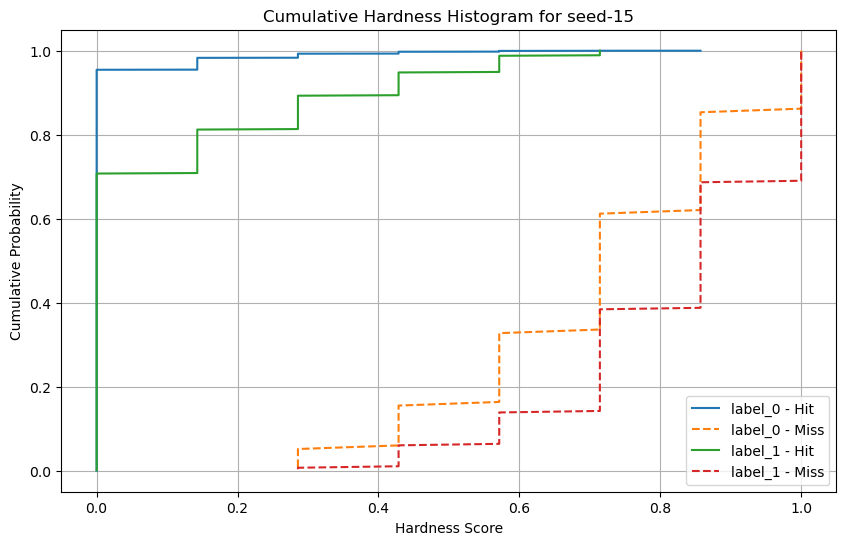

Hardness médio para seed-16: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_17.joblib


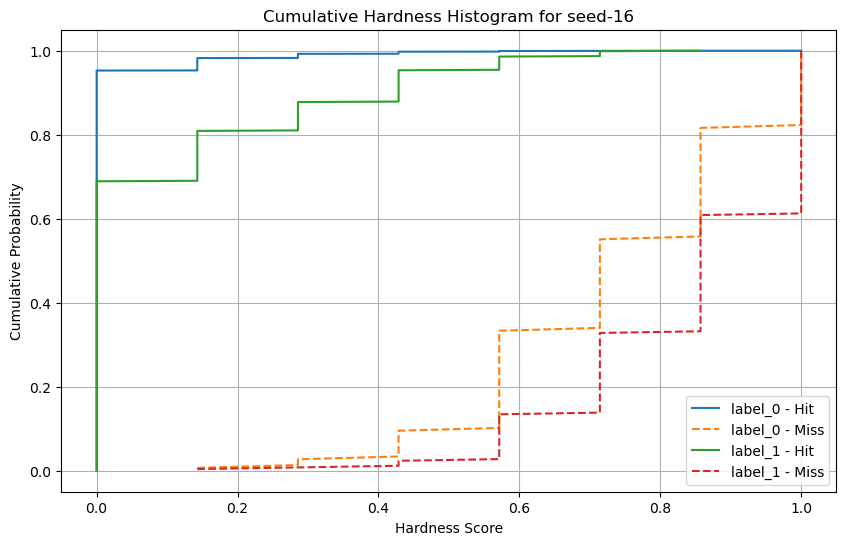

Hardness médio para seed-17: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_18.joblib


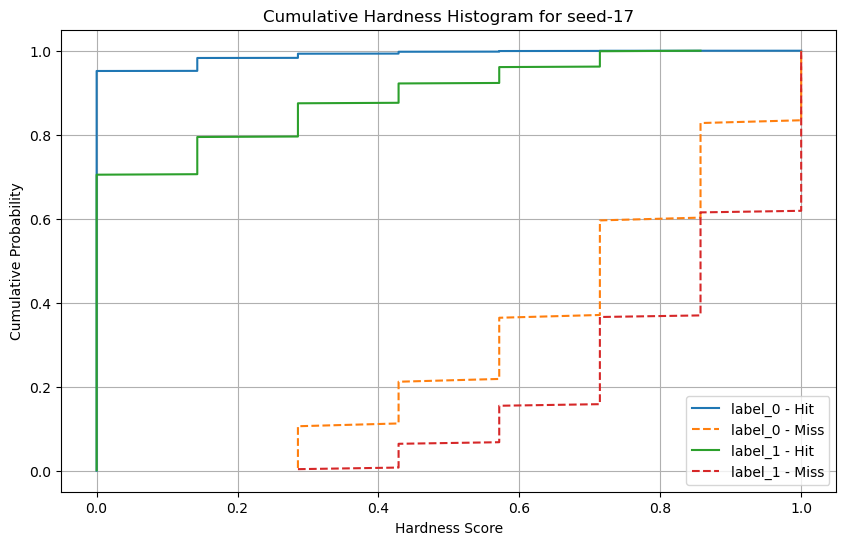

Hardness médio para seed-18: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_19.joblib


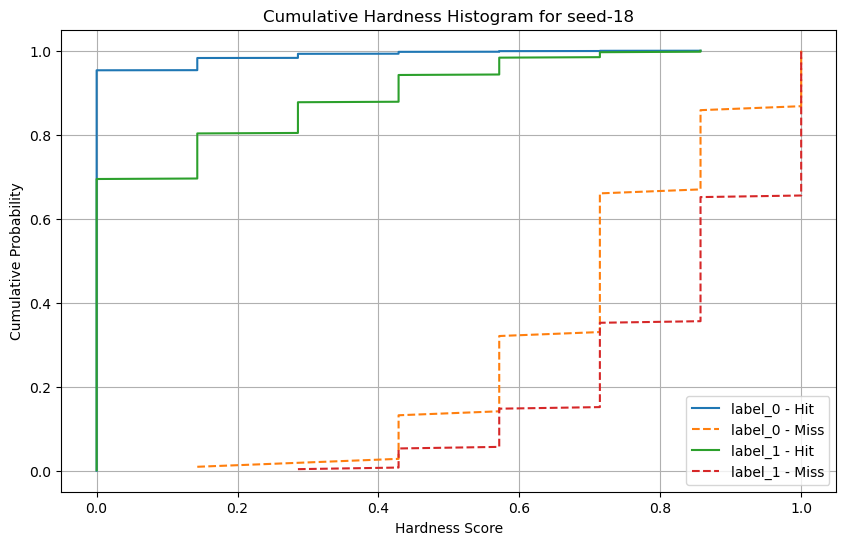

Hardness médio para seed-19: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_20.joblib


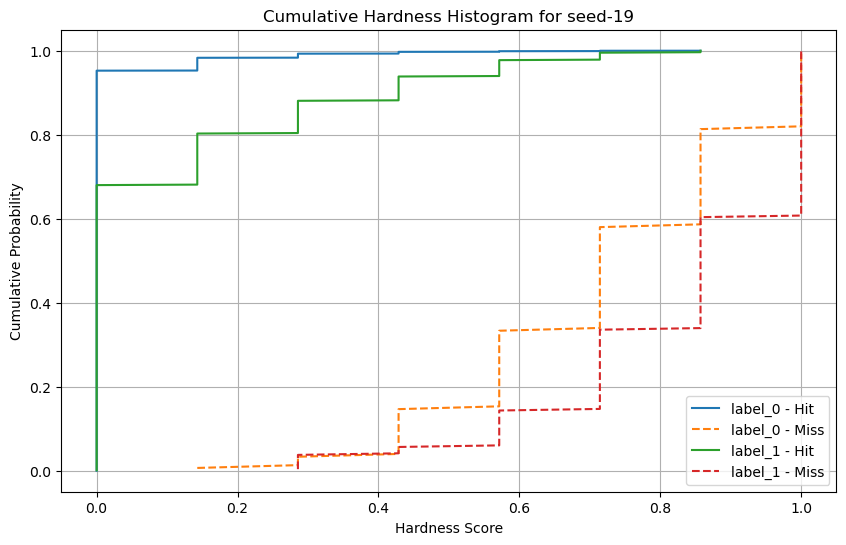

Hardness médio para seed-20: 0.0250
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_21.joblib


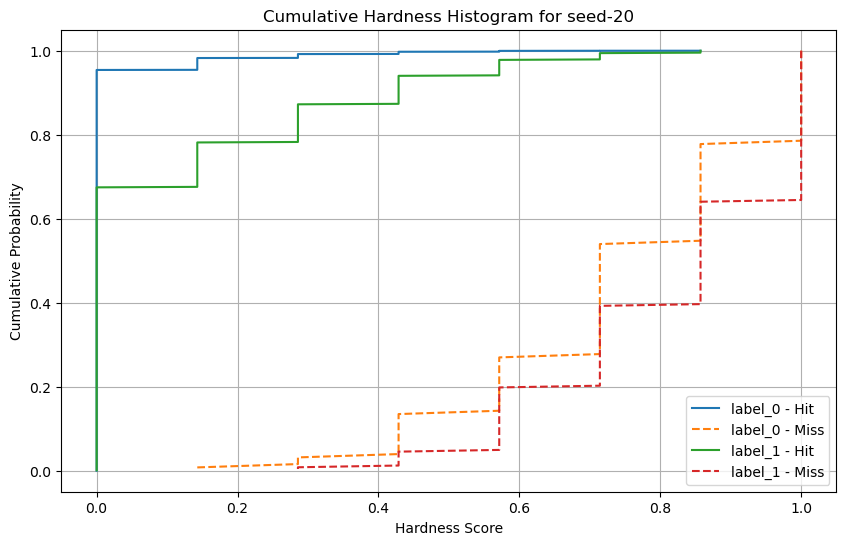

Hardness médio para seed-21: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_22.joblib


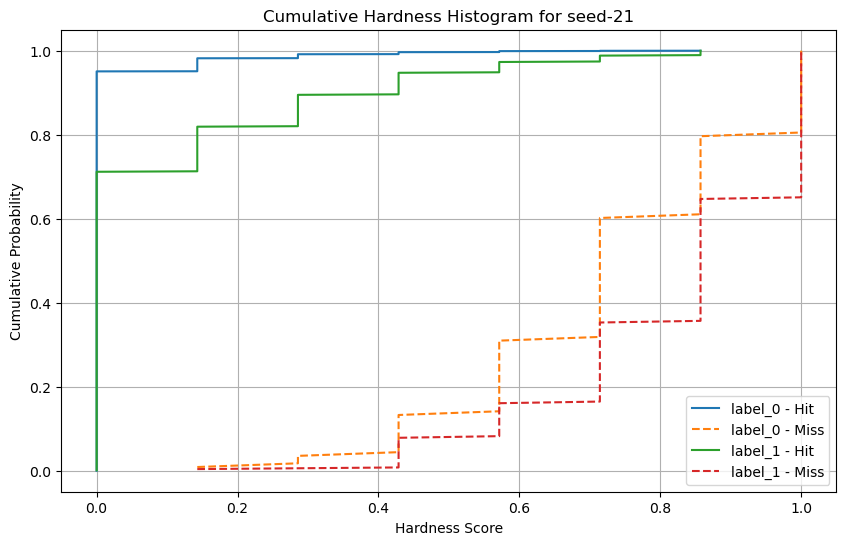

Hardness médio para seed-22: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_23.joblib


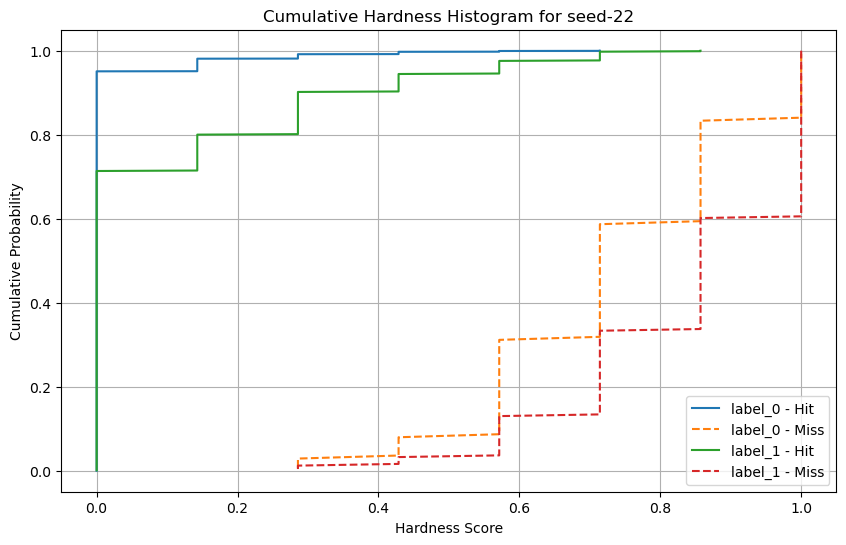

Hardness médio para seed-23: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_24.joblib


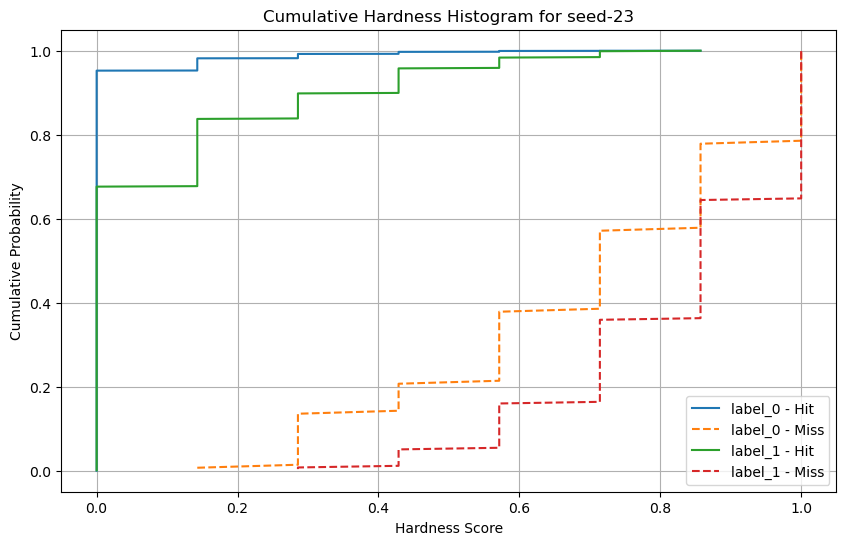

Hardness médio para seed-24: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_25.joblib


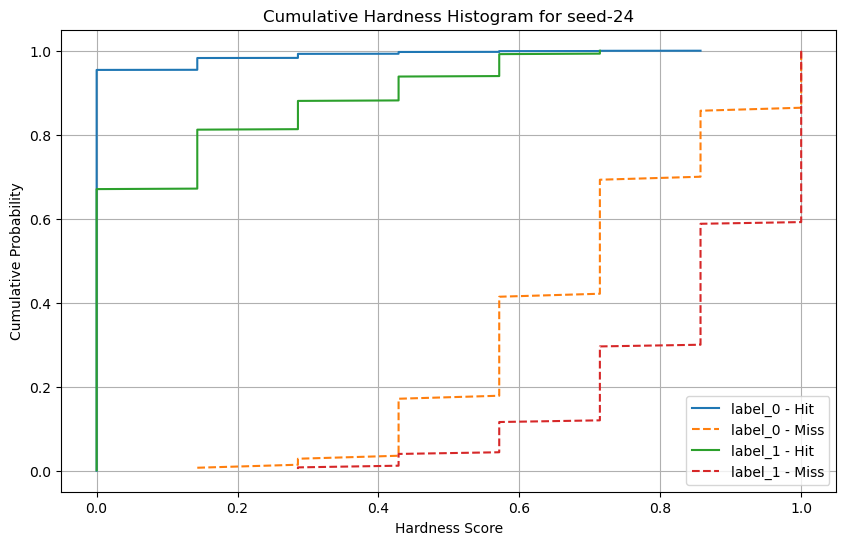

Hardness médio para seed-25: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_26.joblib


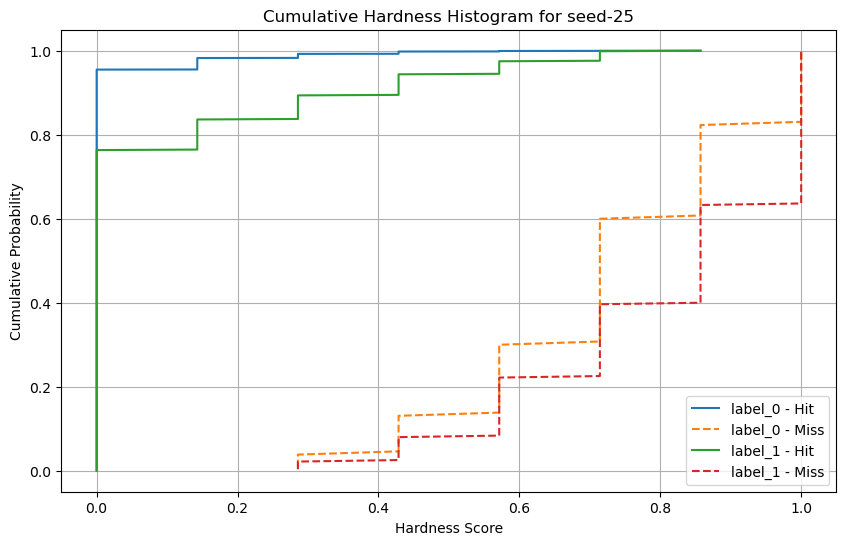

Hardness médio para seed-26: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_27.joblib


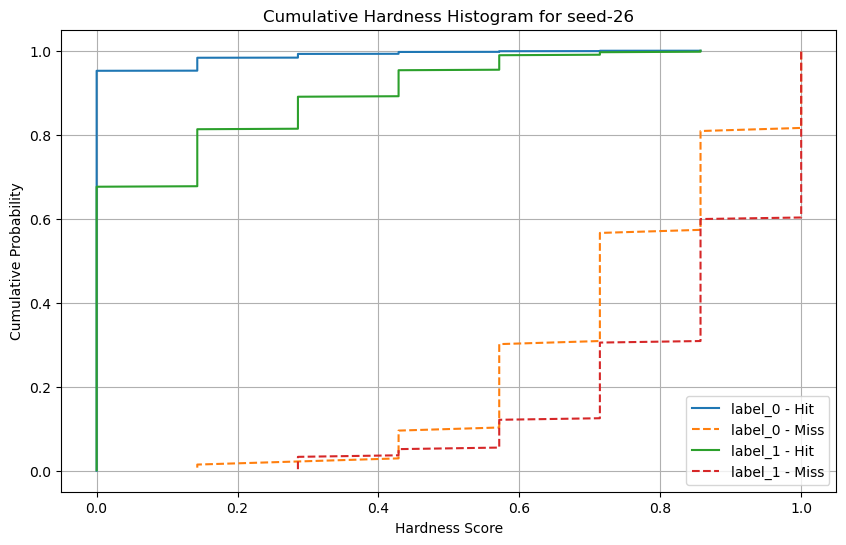

Hardness médio para seed-27: 0.0248
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_28.joblib


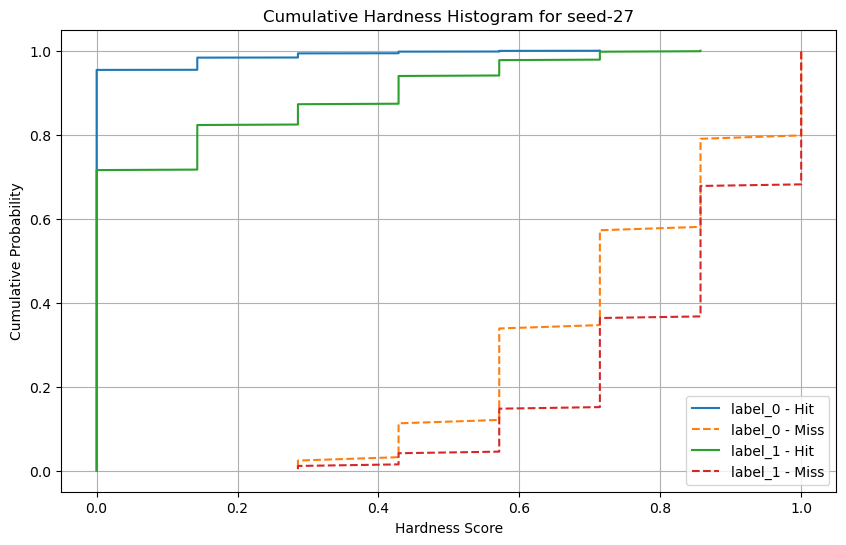

Hardness médio para seed-28: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_29.joblib


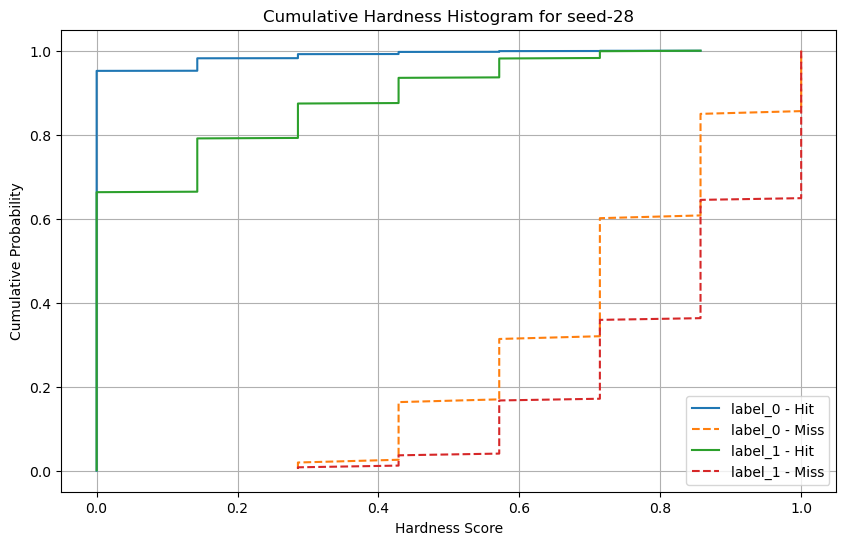

Hardness médio para seed-29: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingKnn\model_30.joblib


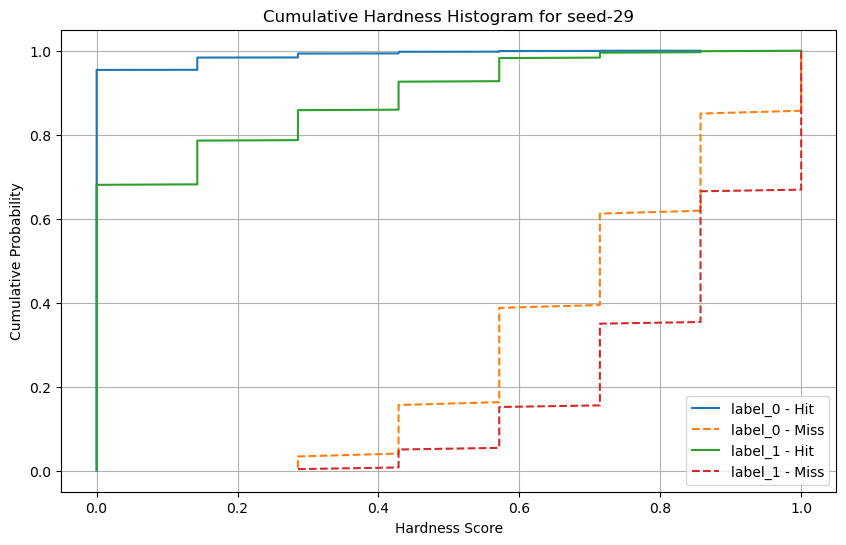

Processando pasta: BaggingMLP
Hardness médio para seed-0: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_1.joblib


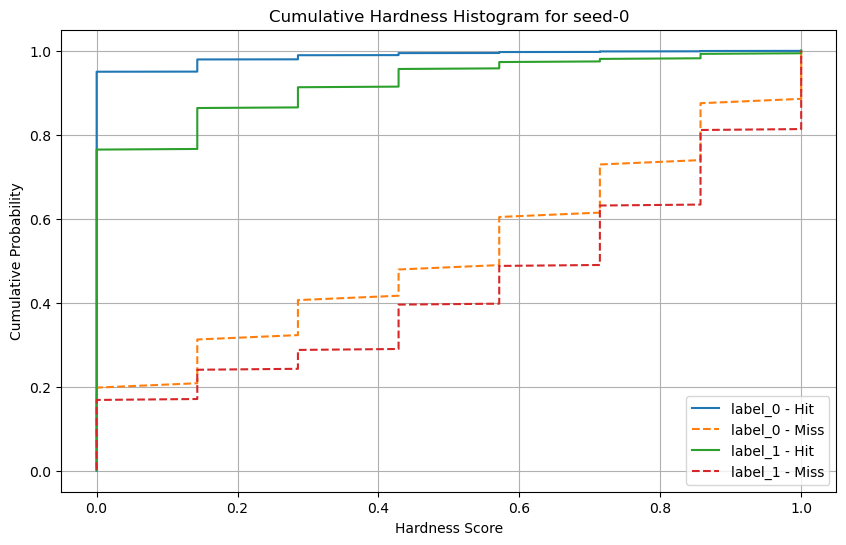

Hardness médio para seed-1: 0.0252
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_2.joblib


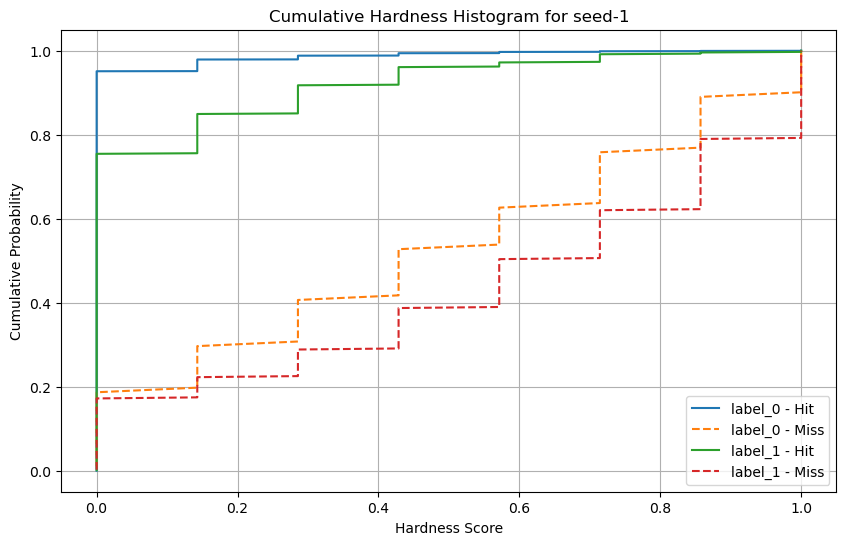

Hardness médio para seed-2: 0.0258
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_3.joblib


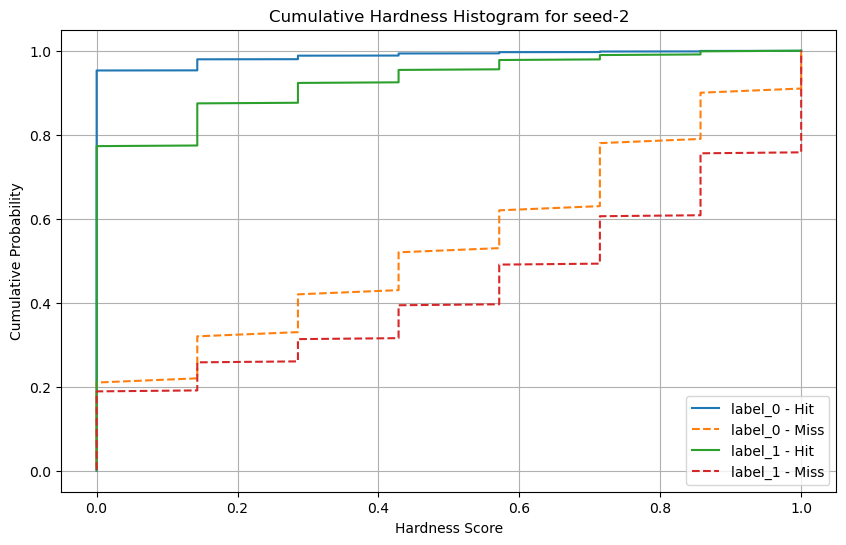

Hardness médio para seed-3: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_4.joblib


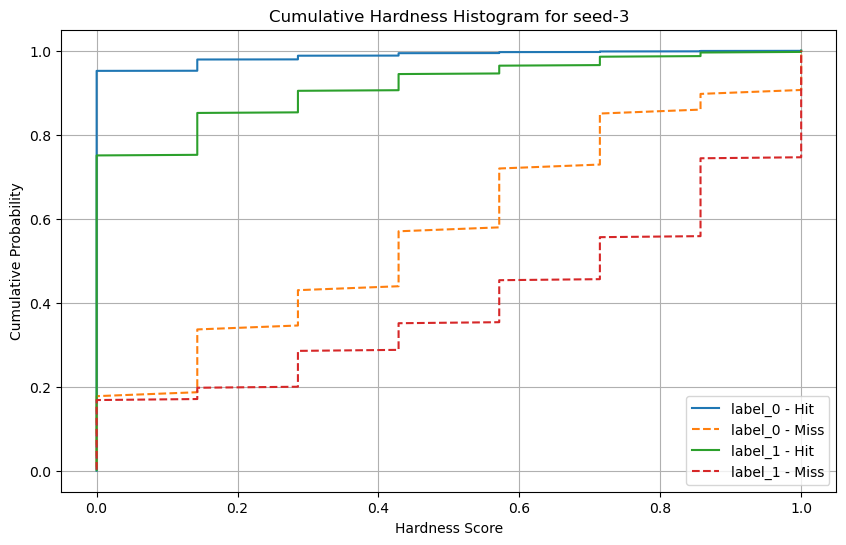

Hardness médio para seed-4: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_5.joblib


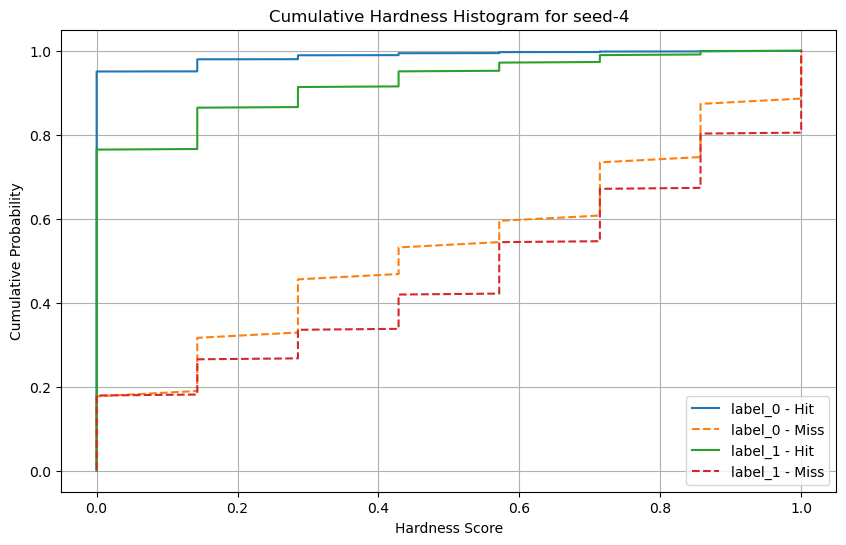

Hardness médio para seed-5: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_6.joblib


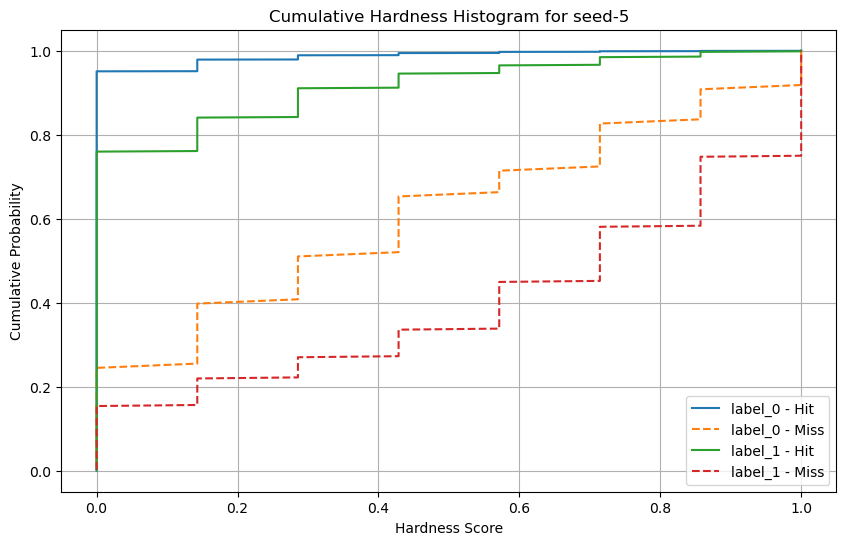

Hardness médio para seed-6: 0.0272
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_7.joblib


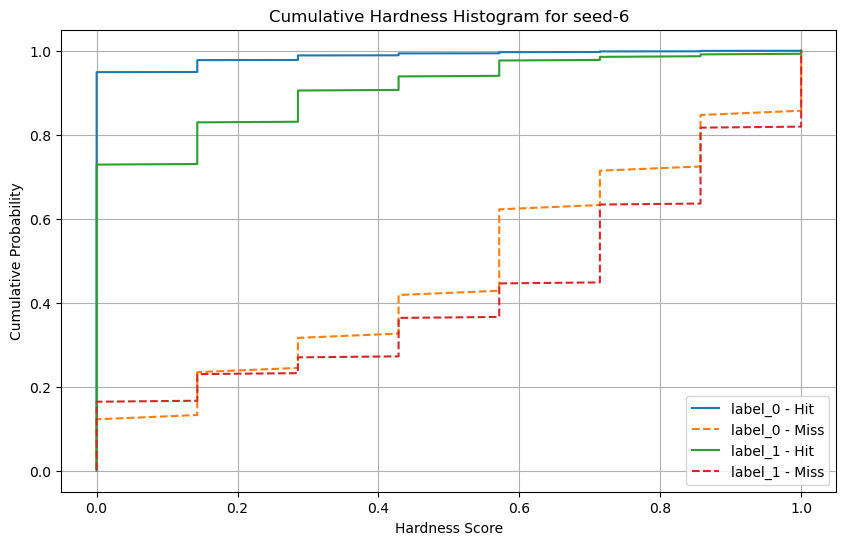

Hardness médio para seed-7: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_8.joblib


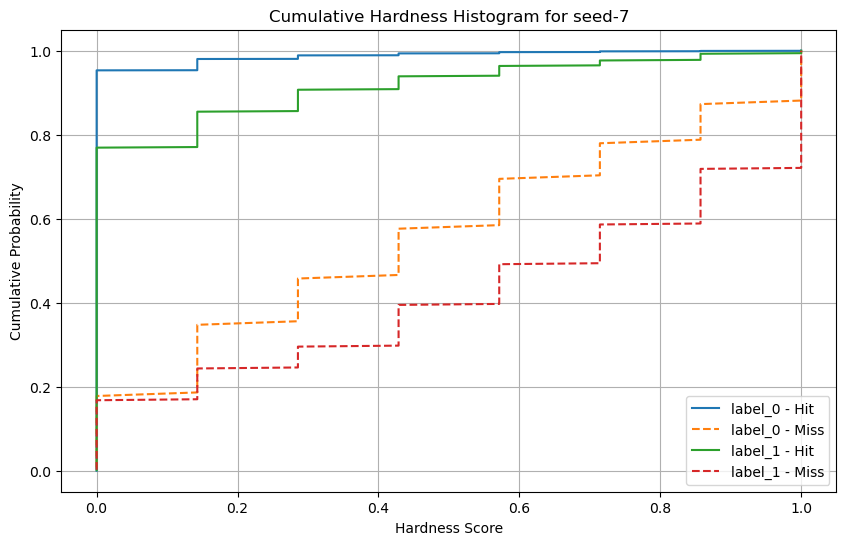

Hardness médio para seed-8: 0.0253
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_9.joblib


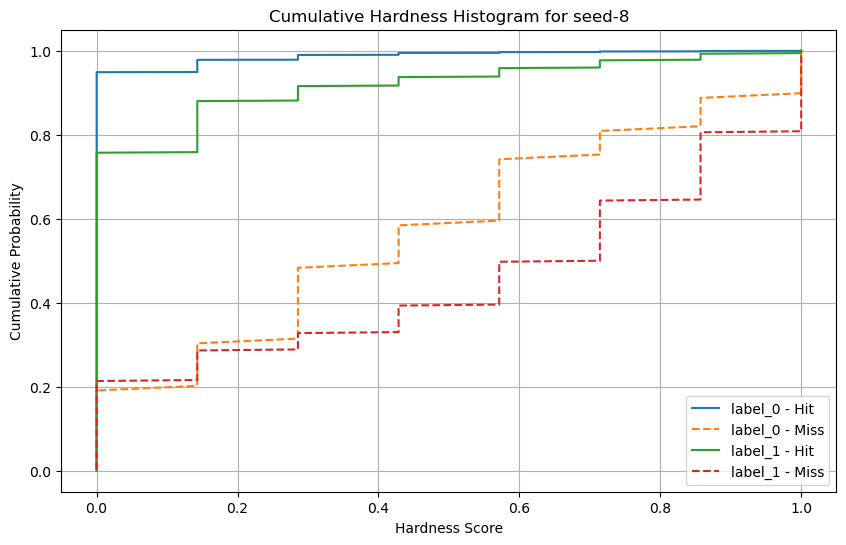

Hardness médio para seed-9: 0.0268
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_10.joblib


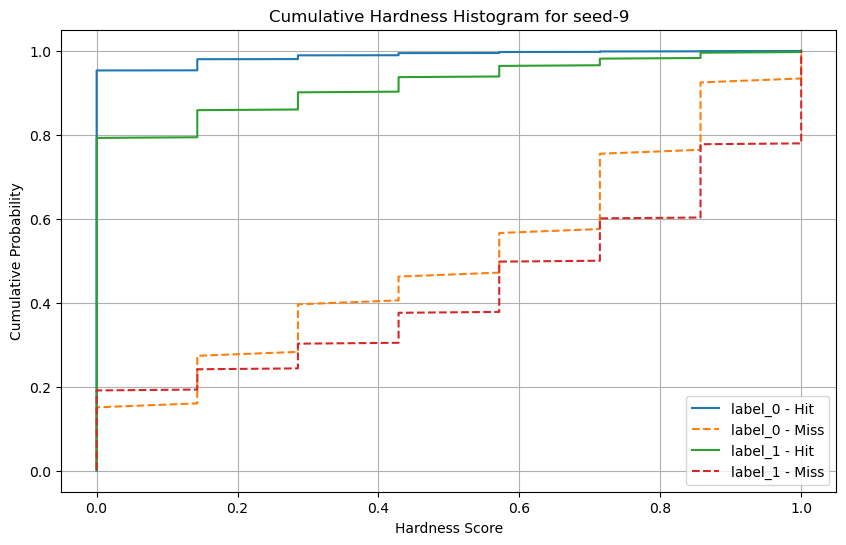

Hardness médio para seed-10: 0.0262
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_11.joblib


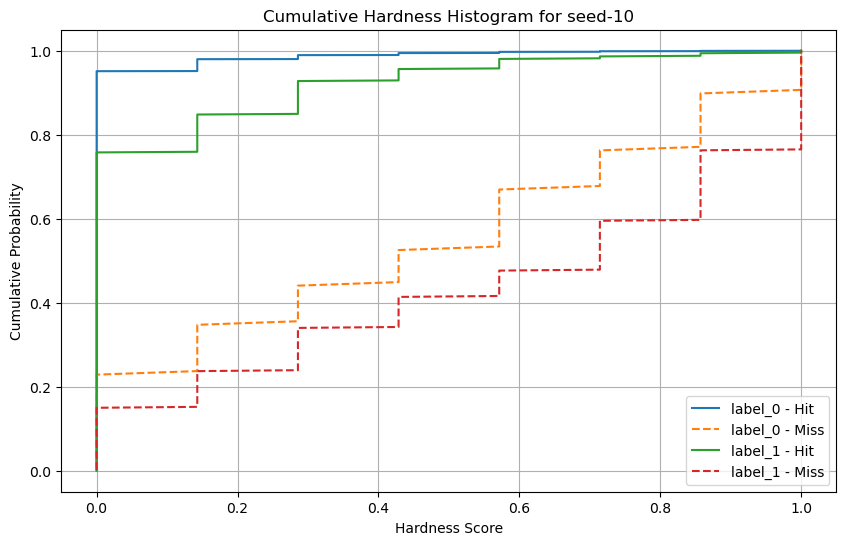

Hardness médio para seed-11: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_12.joblib


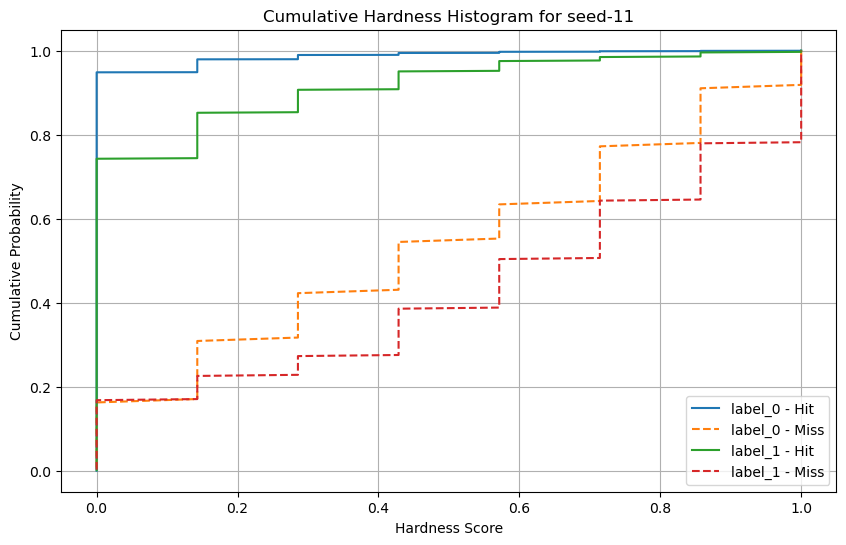

Hardness médio para seed-12: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_13.joblib


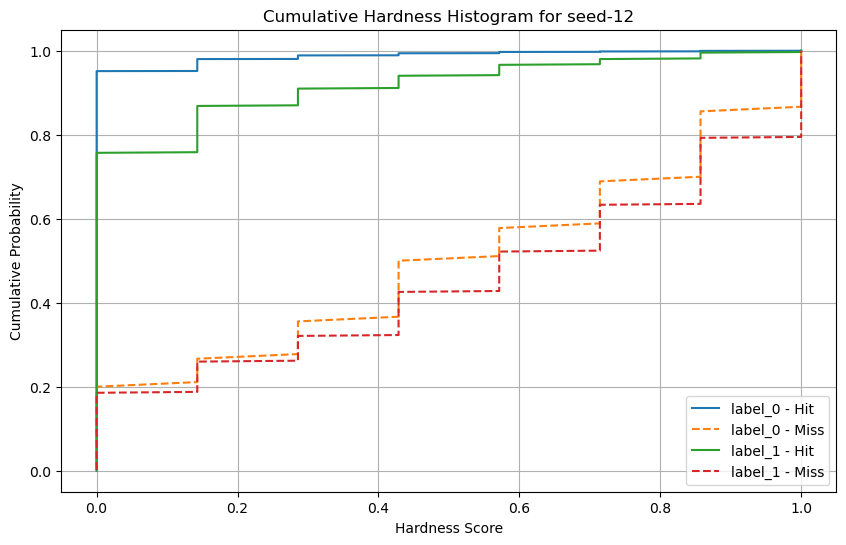

Hardness médio para seed-13: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_14.joblib


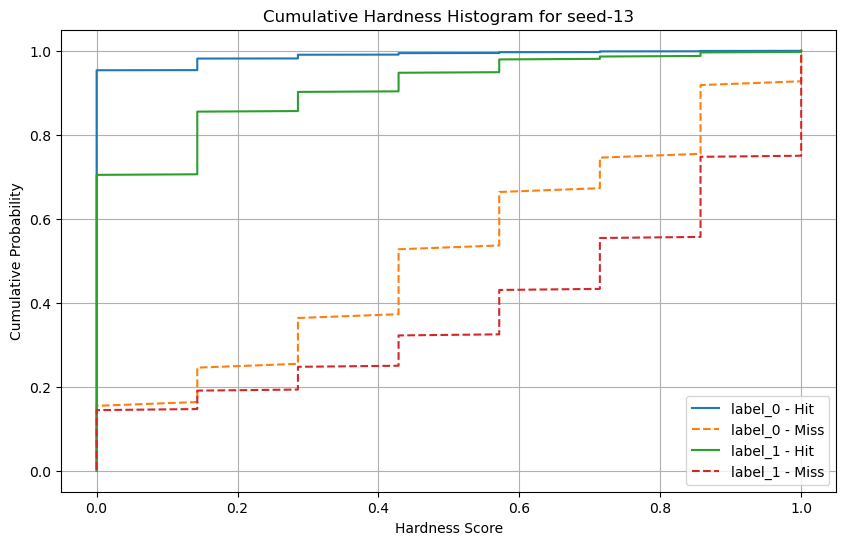

Hardness médio para seed-14: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_15.joblib


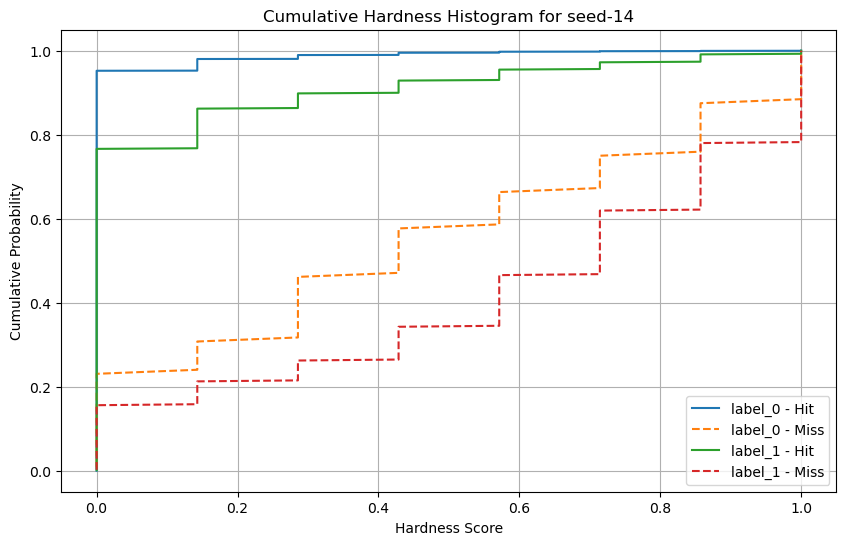

Hardness médio para seed-15: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_16.joblib


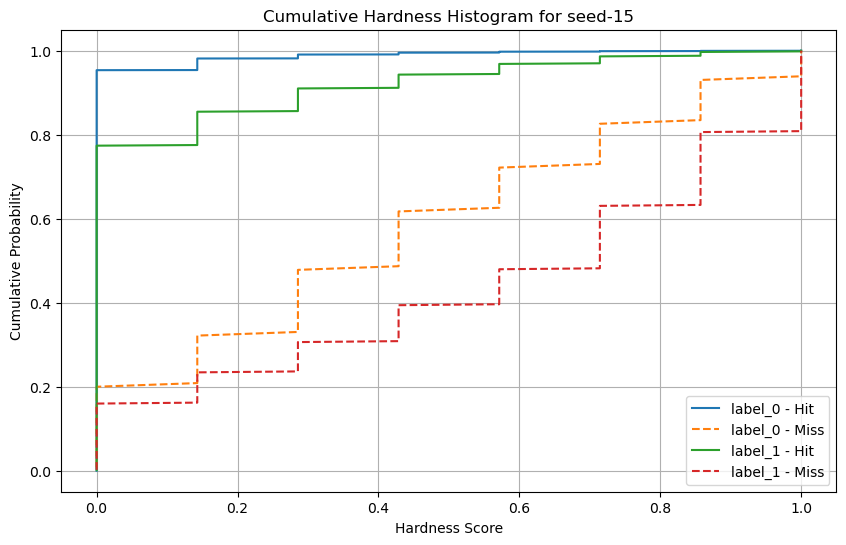

Hardness médio para seed-16: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_17.joblib


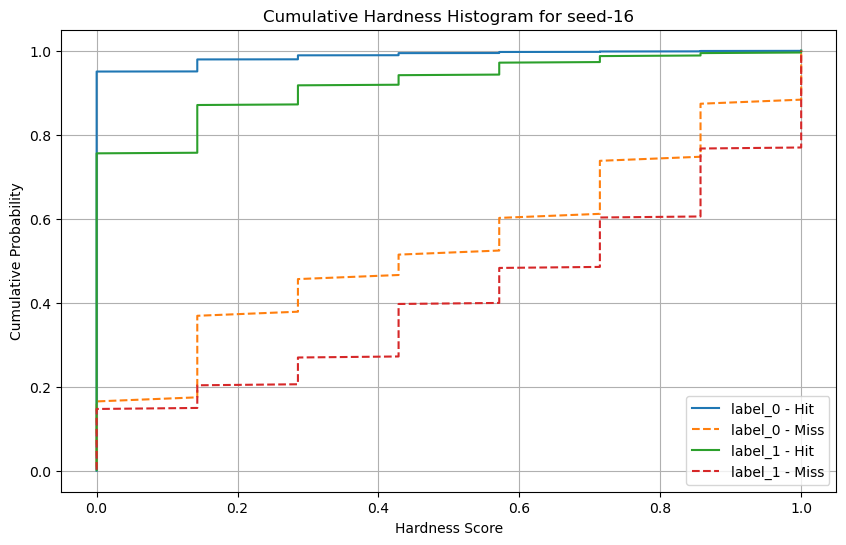

Hardness médio para seed-17: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_18.joblib


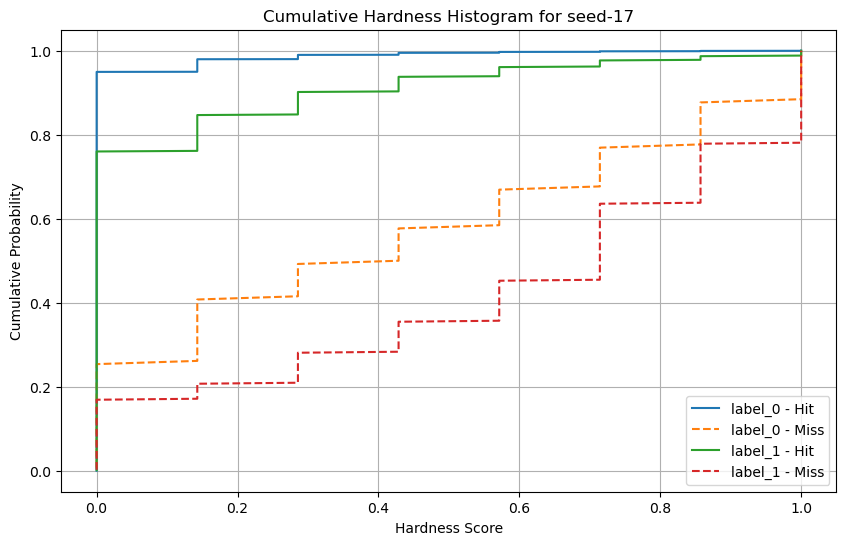

Hardness médio para seed-18: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_19.joblib


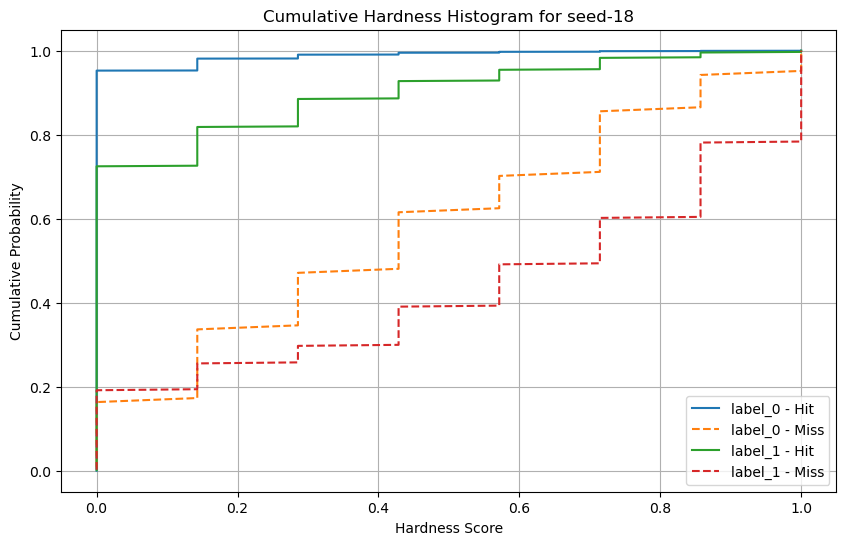

Hardness médio para seed-19: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_20.joblib


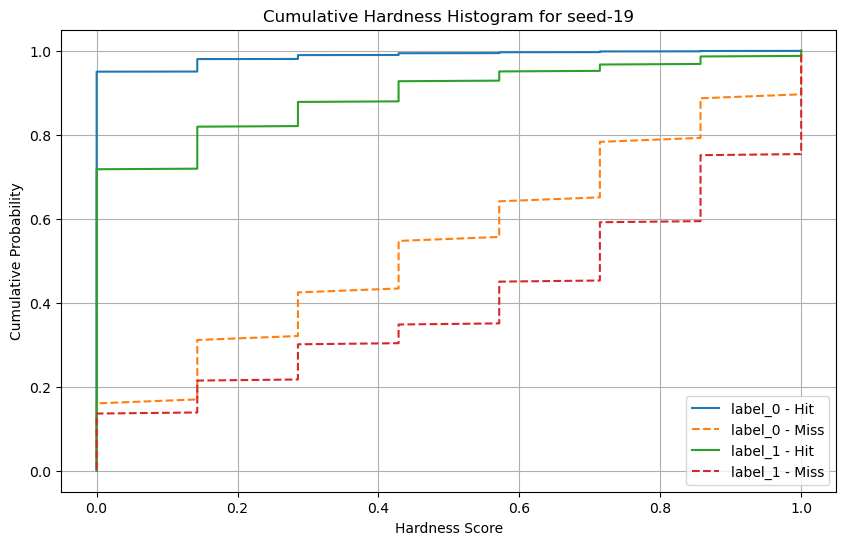

Hardness médio para seed-20: 0.0250
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_21.joblib


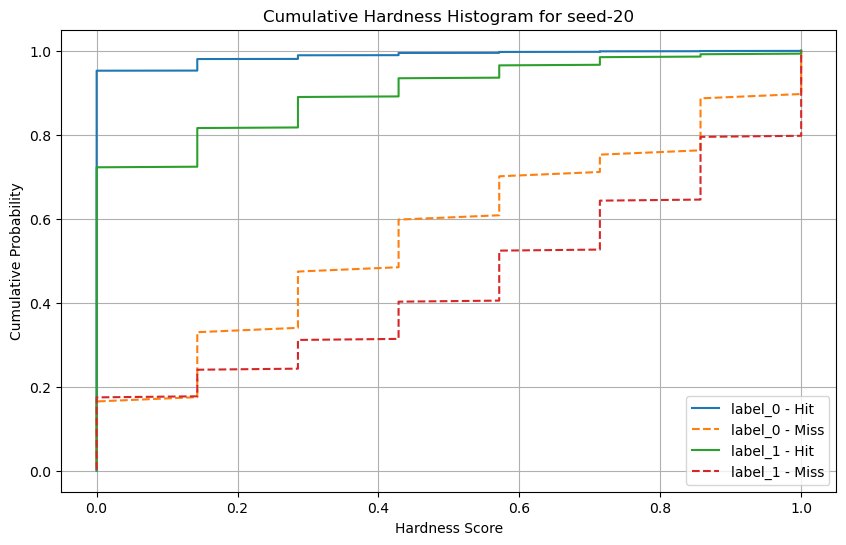

Hardness médio para seed-21: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_22.joblib


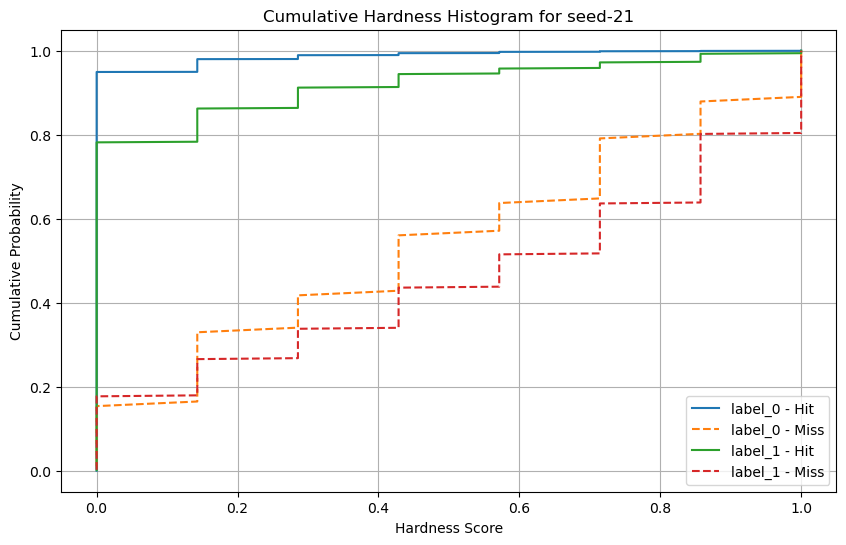

Hardness médio para seed-22: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_23.joblib


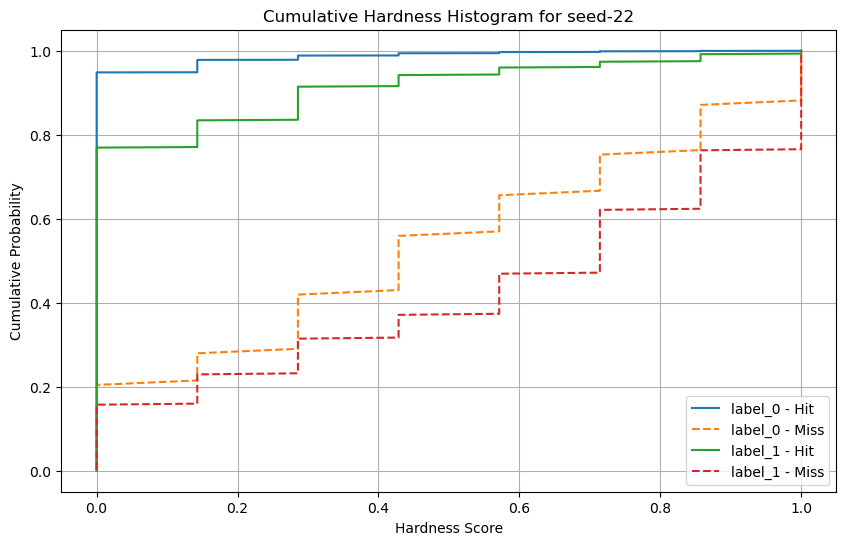

Hardness médio para seed-23: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_24.joblib


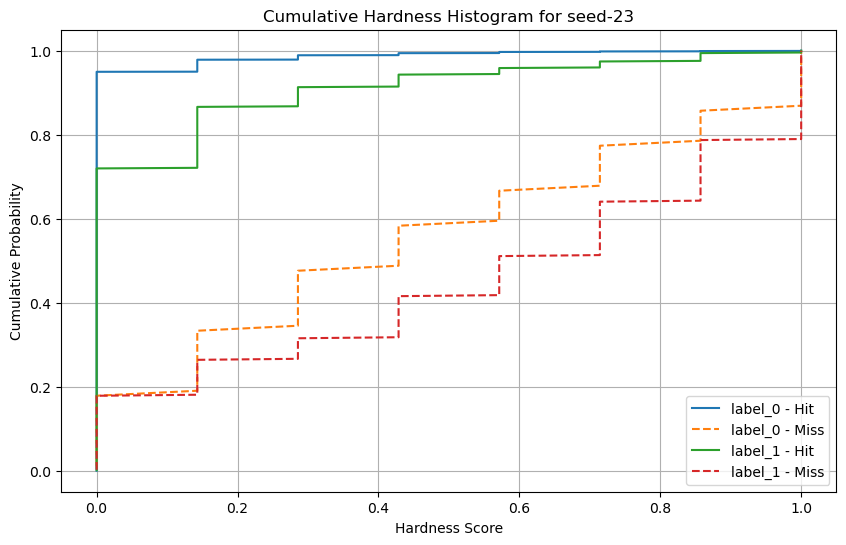

Hardness médio para seed-24: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_25.joblib


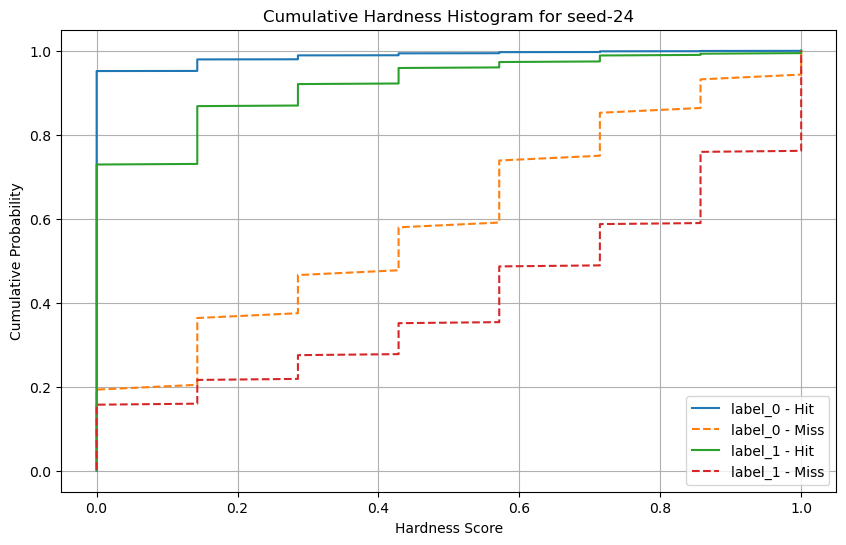

Hardness médio para seed-25: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_26.joblib


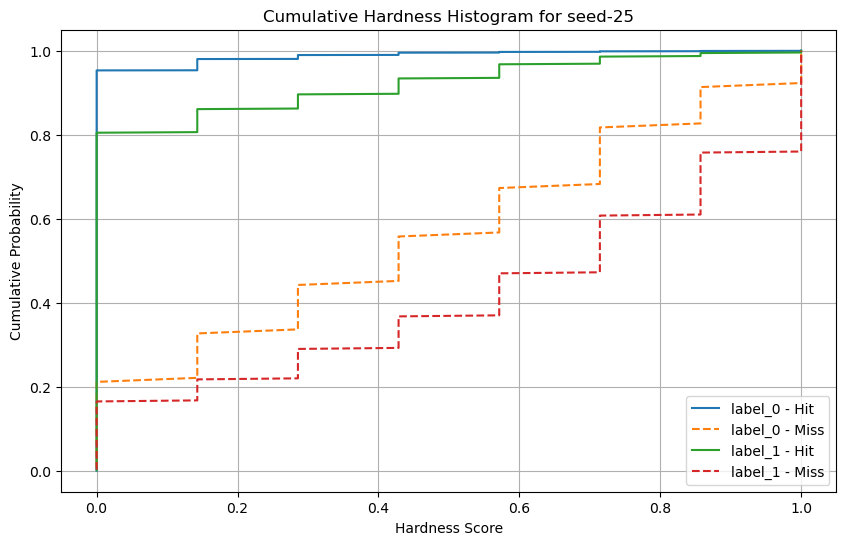

Hardness médio para seed-26: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_27.joblib


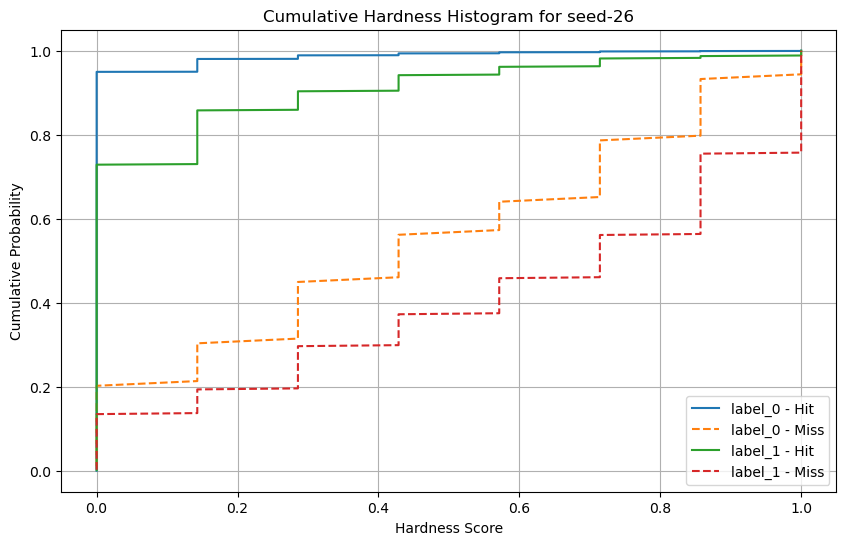

Hardness médio para seed-27: 0.0248
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_28.joblib


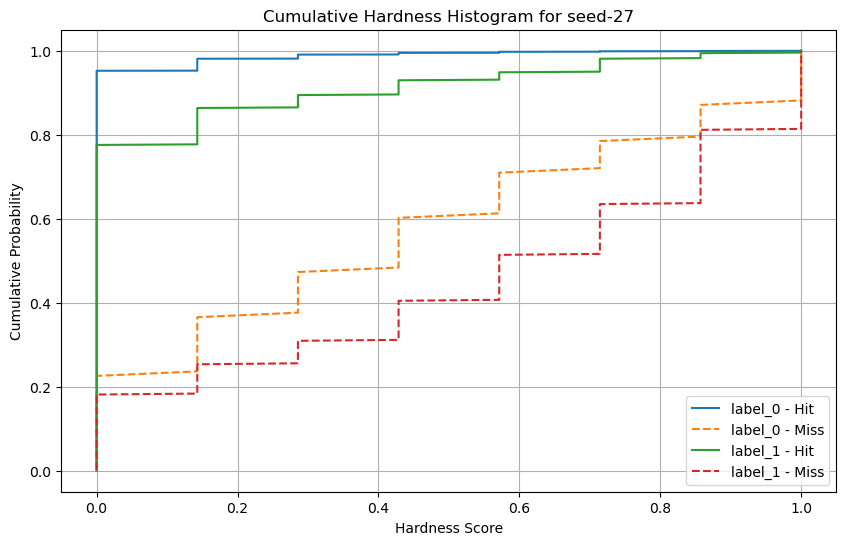

Hardness médio para seed-28: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_29.joblib


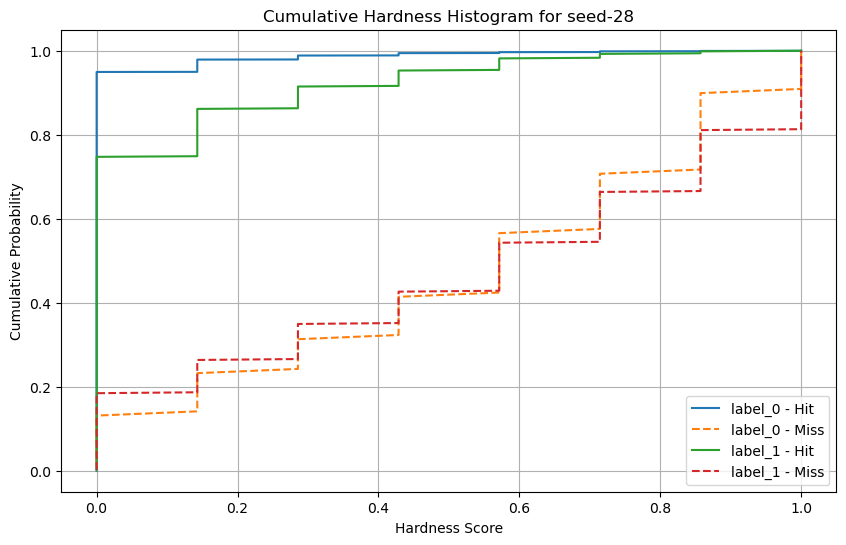

Hardness médio para seed-29: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingMLP\model_30.joblib


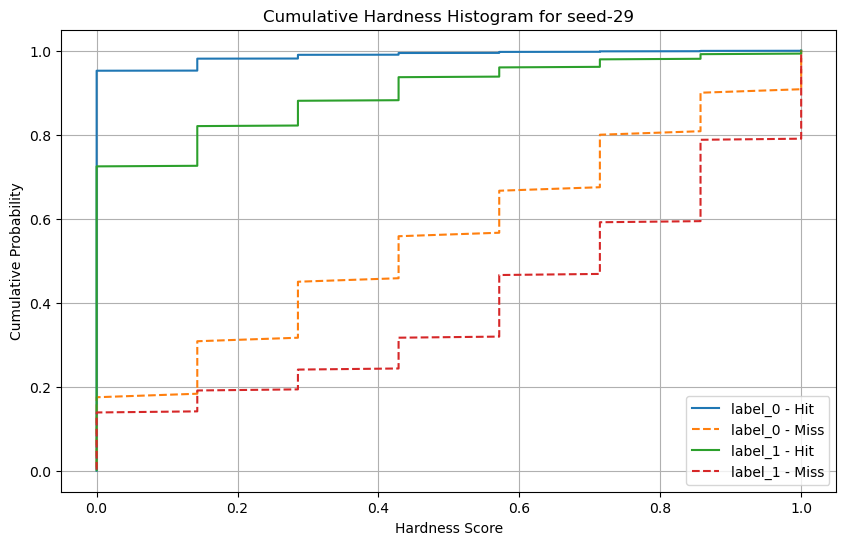

Processando pasta: BaggingNaiveBayes
Hardness médio para seed-0: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_1.joblib


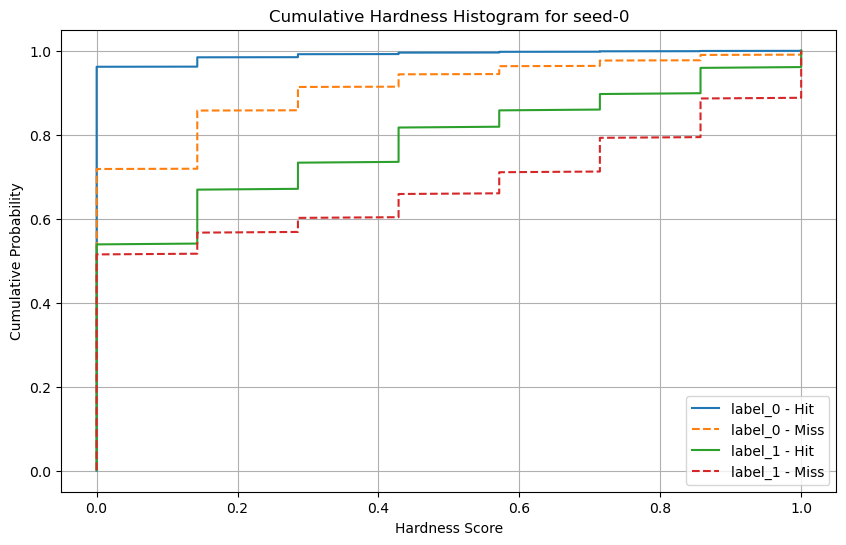

Hardness médio para seed-1: 0.0252
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_2.joblib


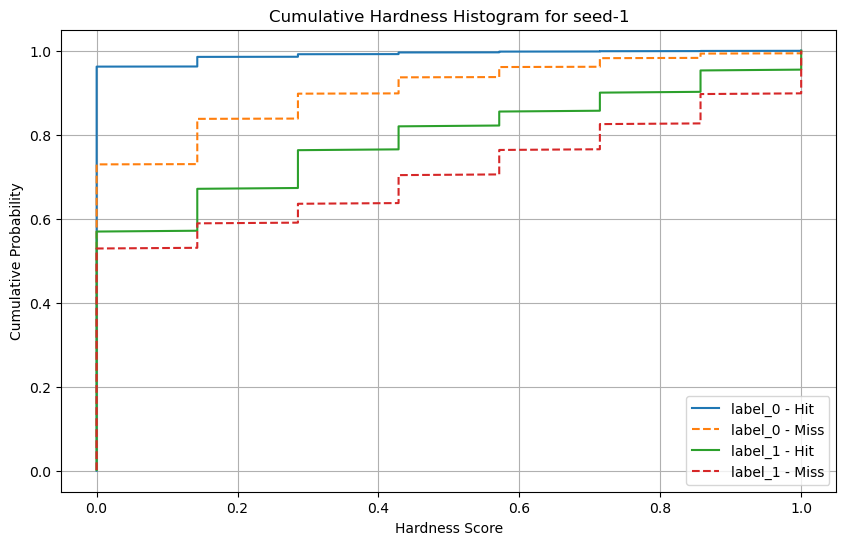

Hardness médio para seed-2: 0.0258
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_3.joblib


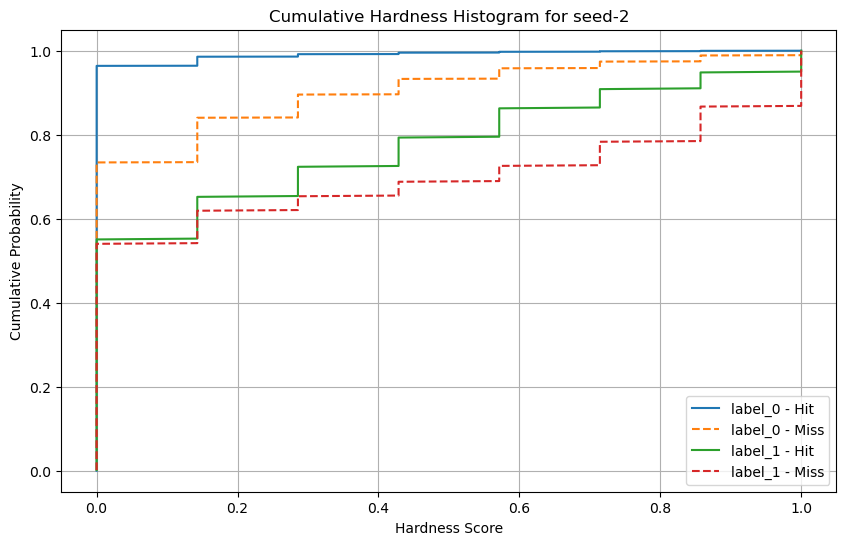

Hardness médio para seed-3: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_4.joblib


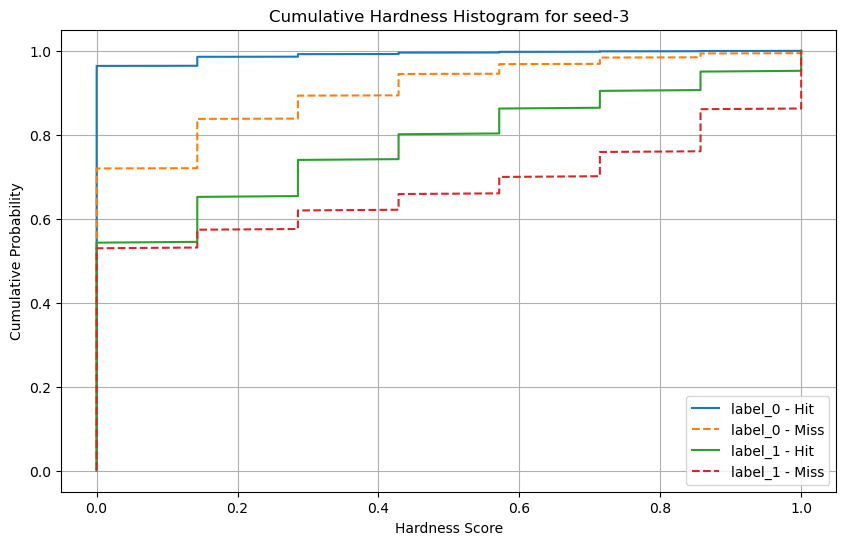

Hardness médio para seed-4: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_5.joblib


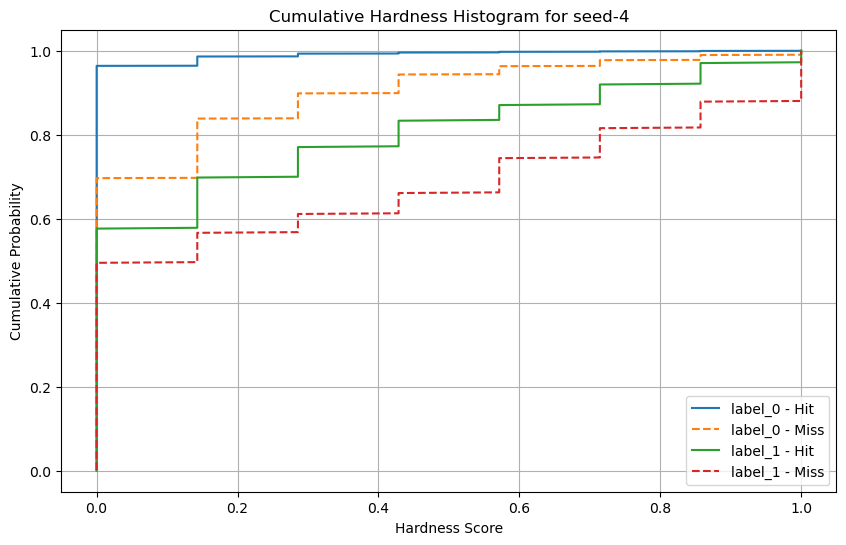

Hardness médio para seed-5: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_6.joblib


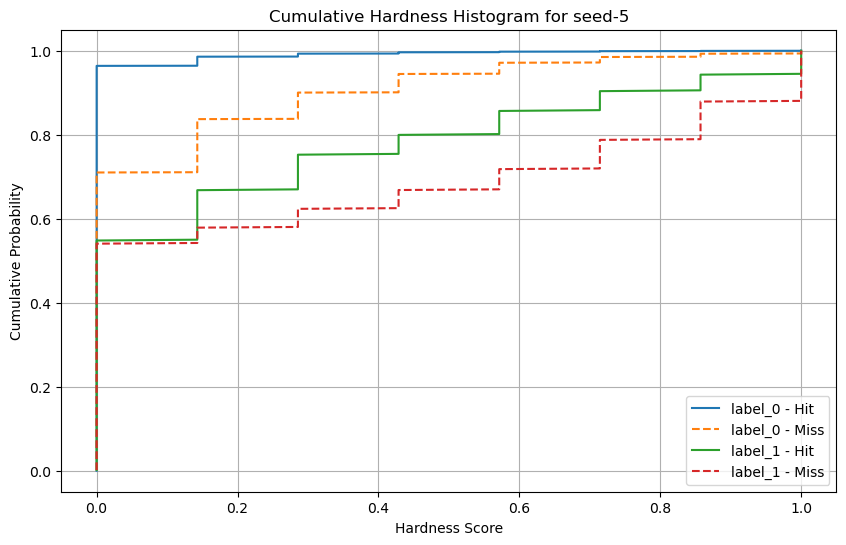

Hardness médio para seed-6: 0.0272
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_7.joblib


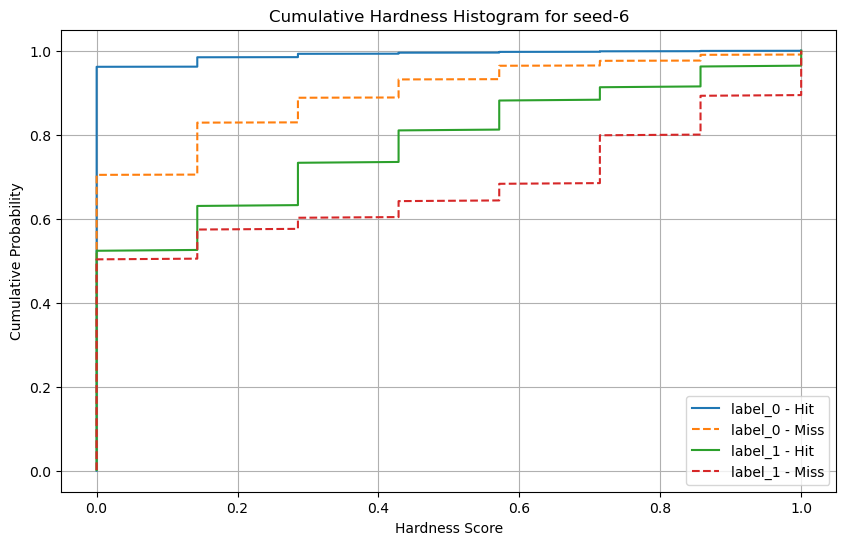

Hardness médio para seed-7: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_8.joblib


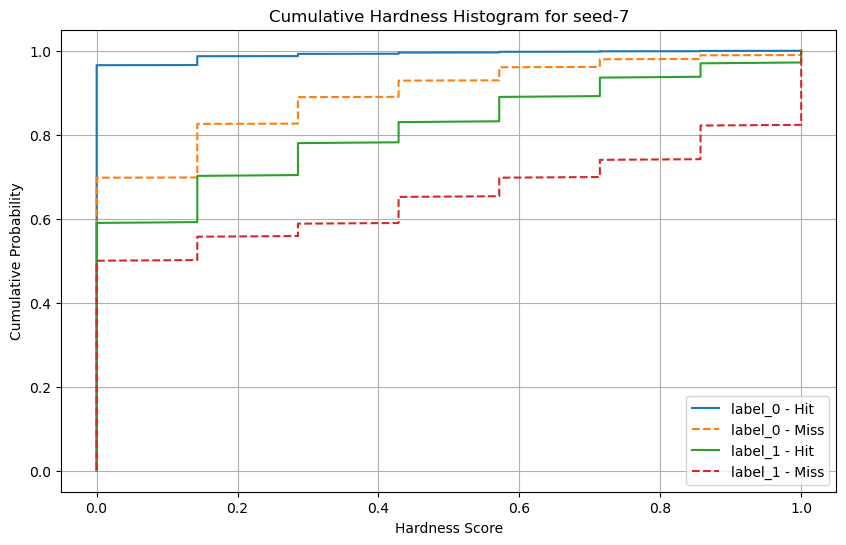

Hardness médio para seed-8: 0.0253
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_9.joblib


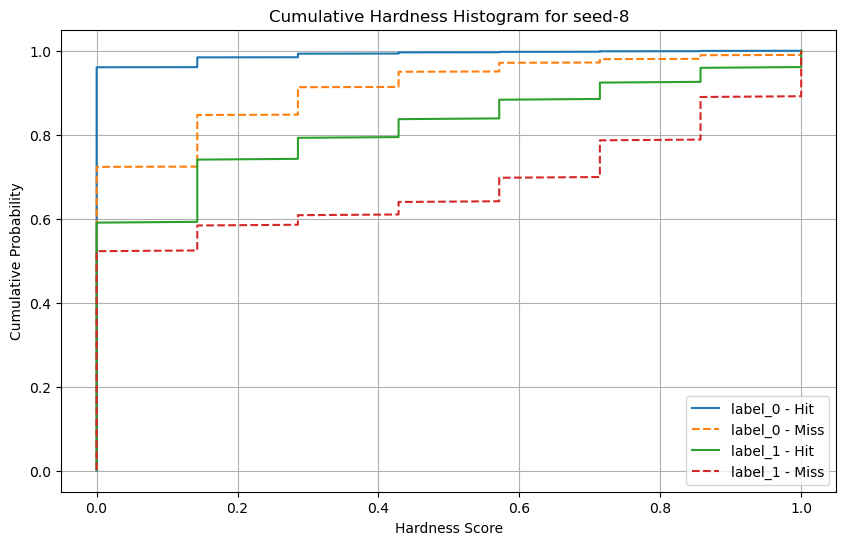

Hardness médio para seed-9: 0.0268
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_10.joblib


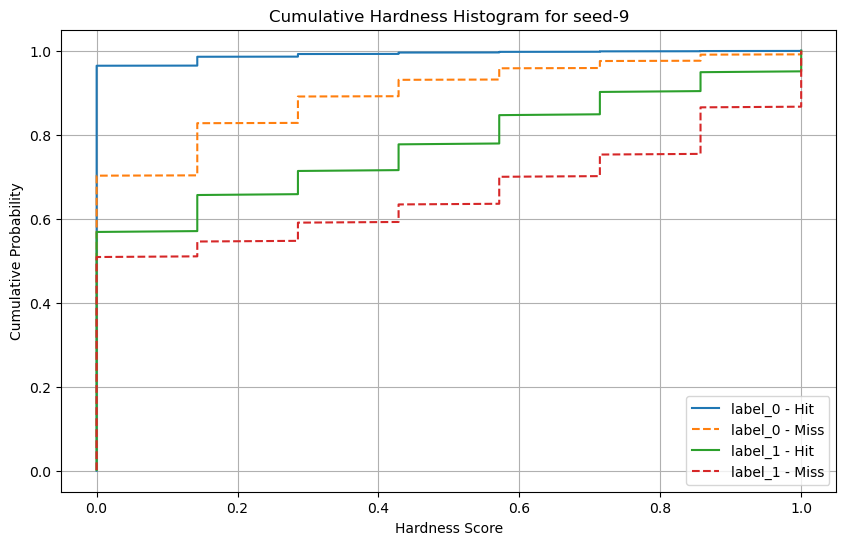

Hardness médio para seed-10: 0.0262
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_11.joblib


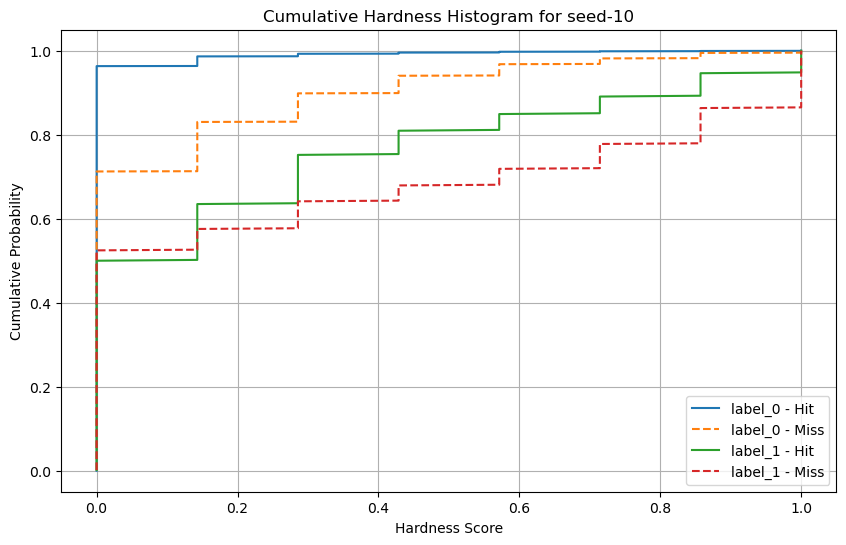

Hardness médio para seed-11: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_12.joblib


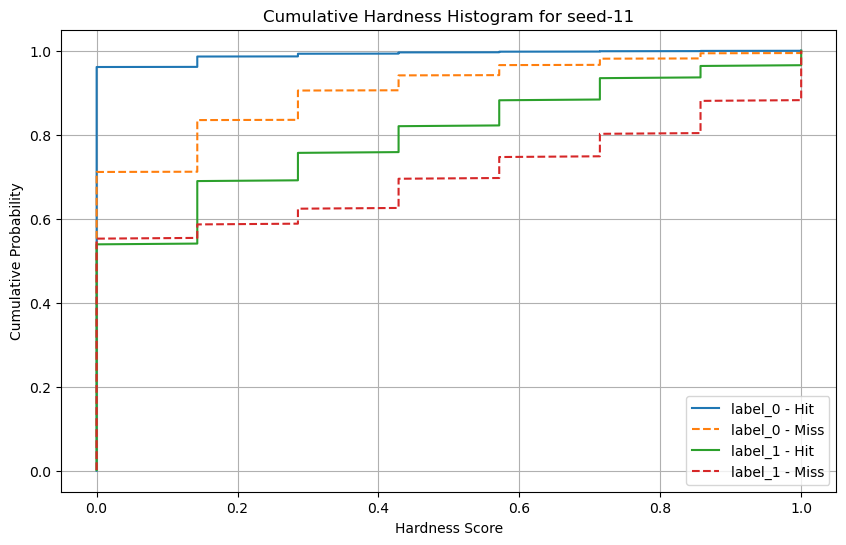

Hardness médio para seed-12: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_13.joblib


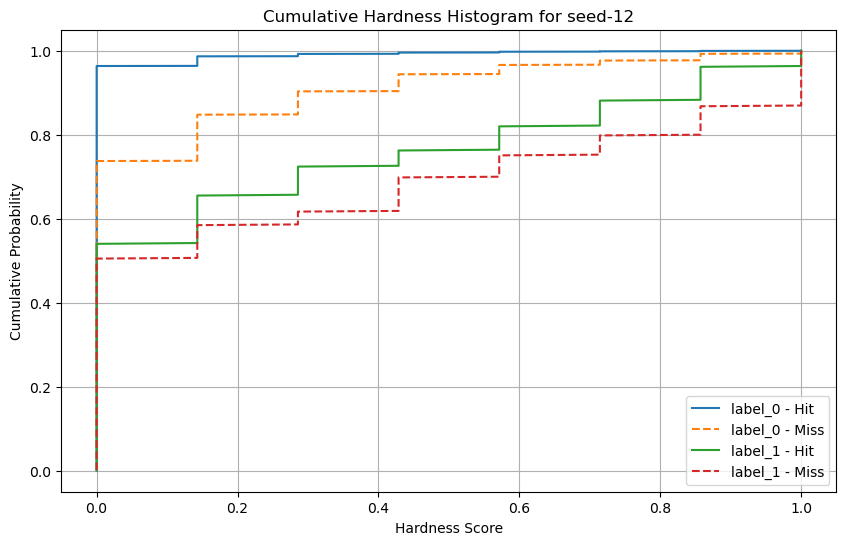

Hardness médio para seed-13: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_14.joblib


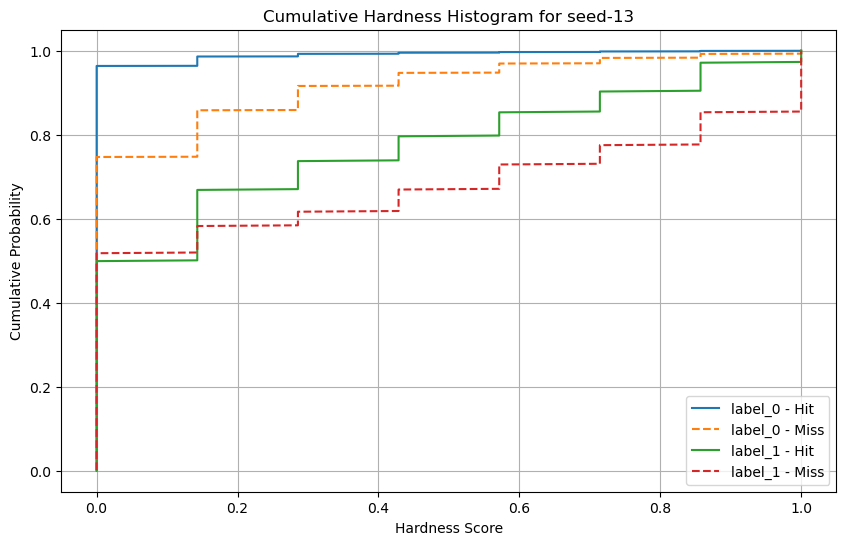

Hardness médio para seed-14: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_15.joblib


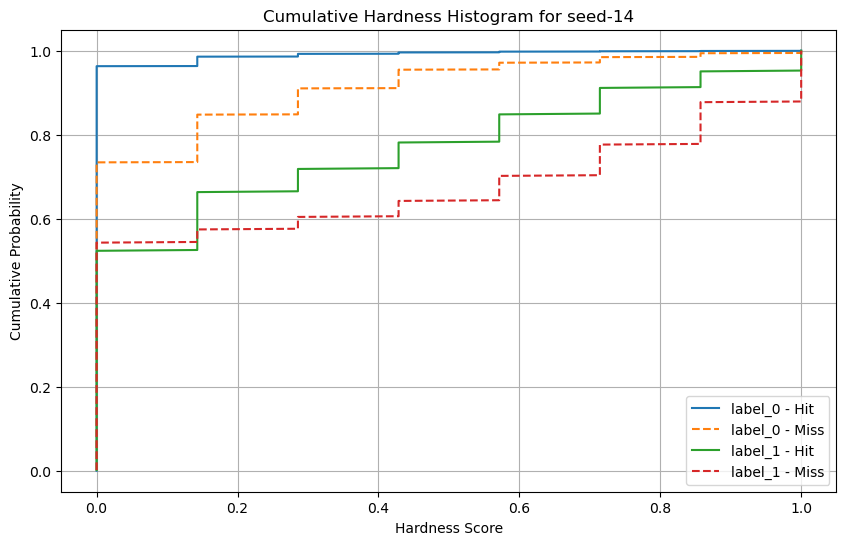

Hardness médio para seed-15: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_16.joblib


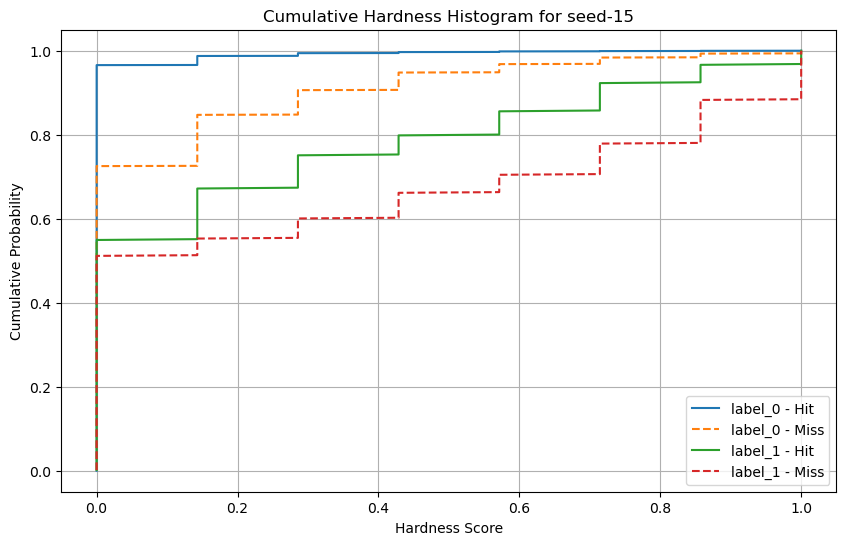

Hardness médio para seed-16: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_17.joblib


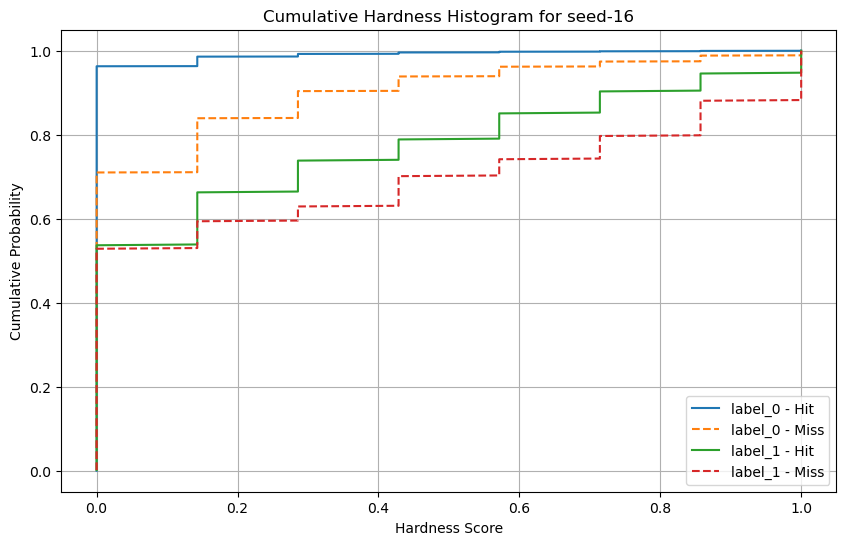

Hardness médio para seed-17: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_18.joblib


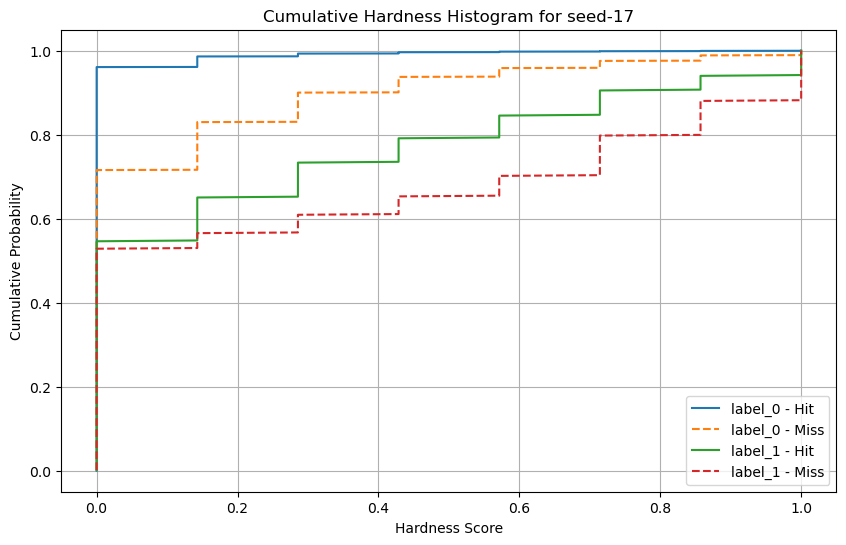

Hardness médio para seed-18: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_19.joblib


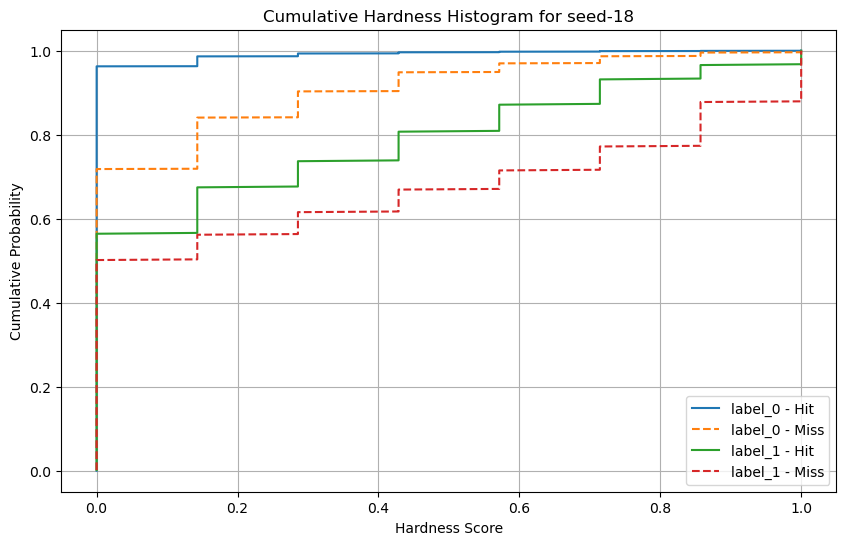

Hardness médio para seed-19: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_20.joblib


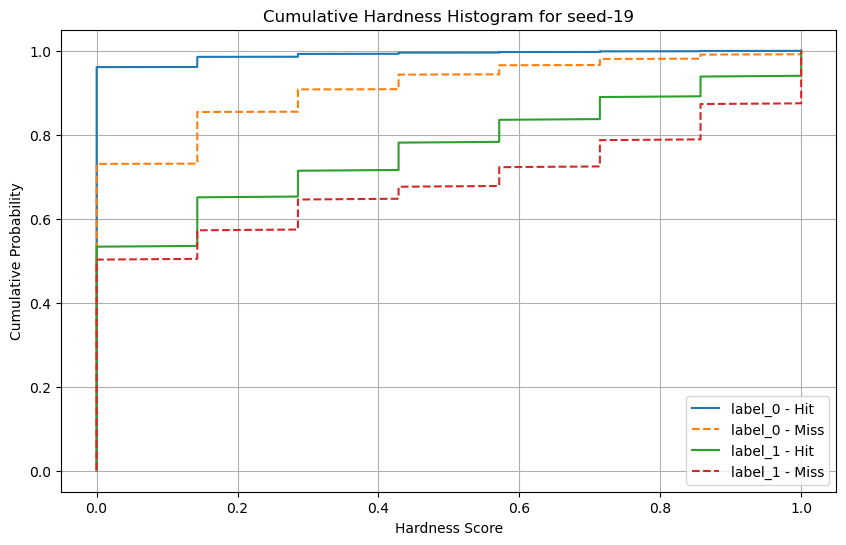

Hardness médio para seed-20: 0.0250
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_21.joblib


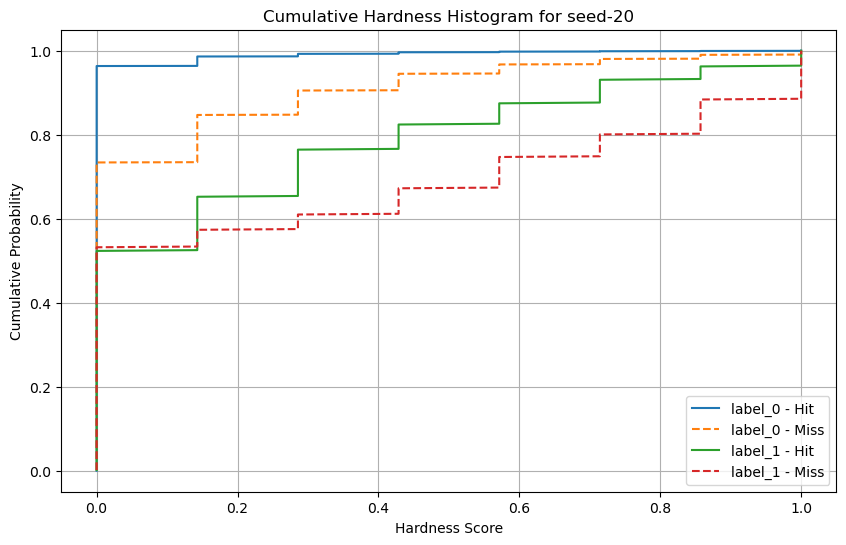

Hardness médio para seed-21: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_22.joblib


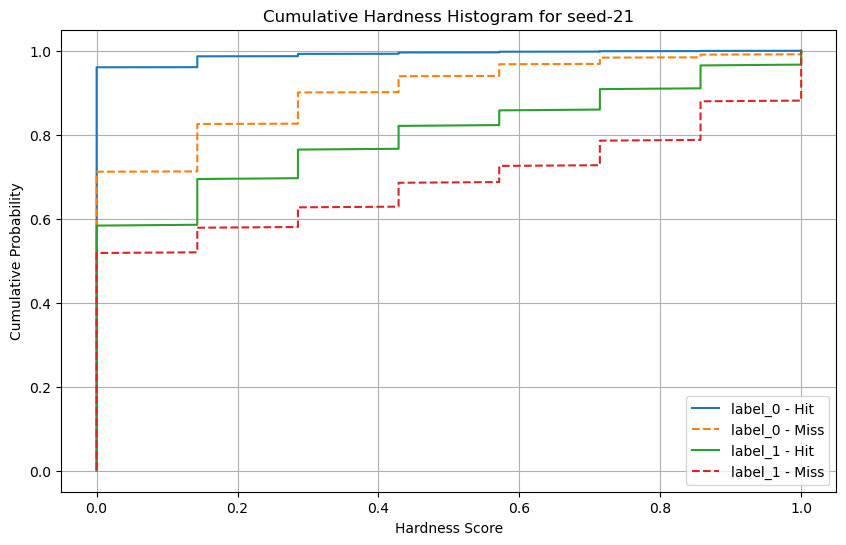

Hardness médio para seed-22: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_23.joblib


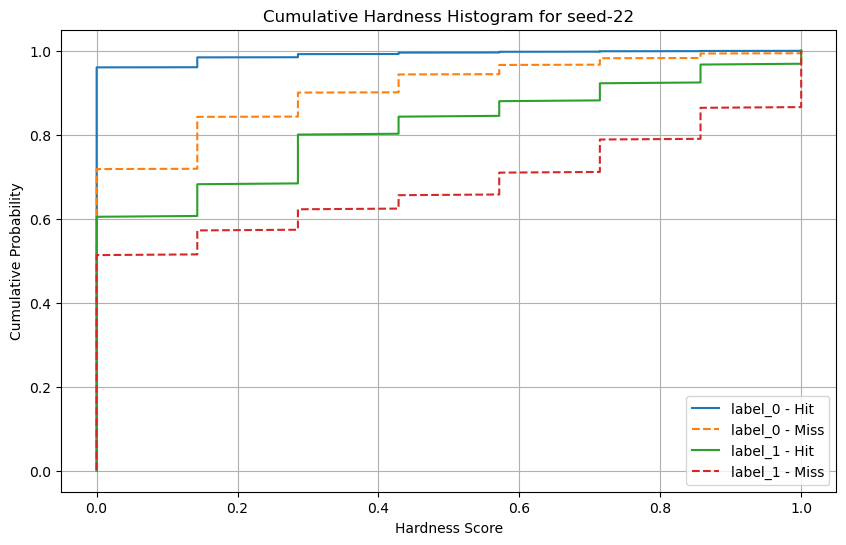

Hardness médio para seed-23: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_24.joblib


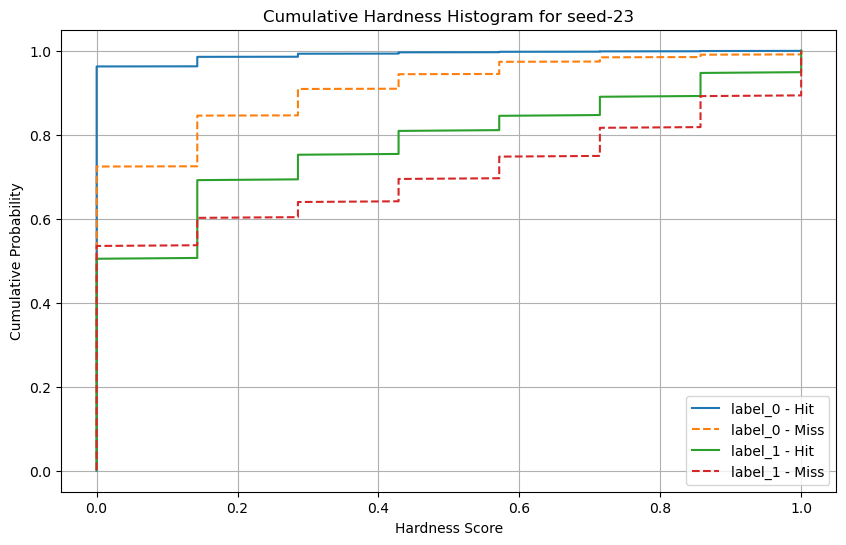

Hardness médio para seed-24: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_25.joblib


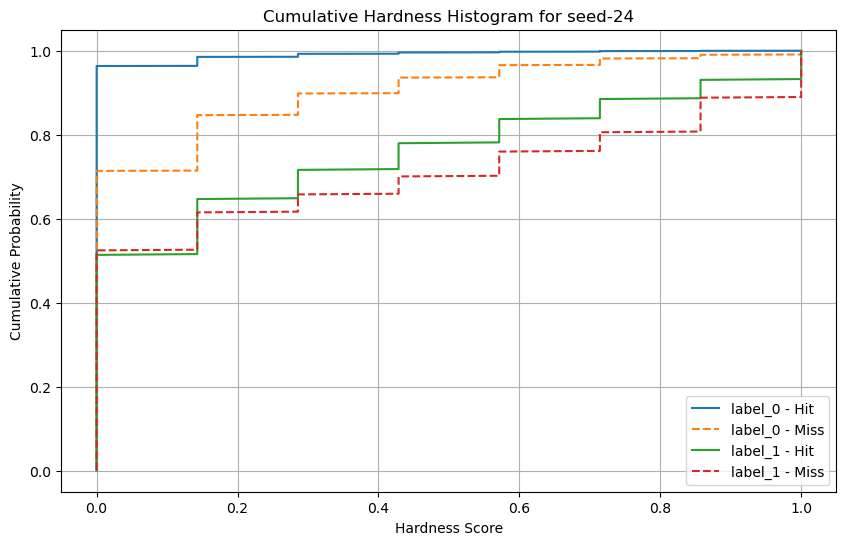

Hardness médio para seed-25: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_26.joblib


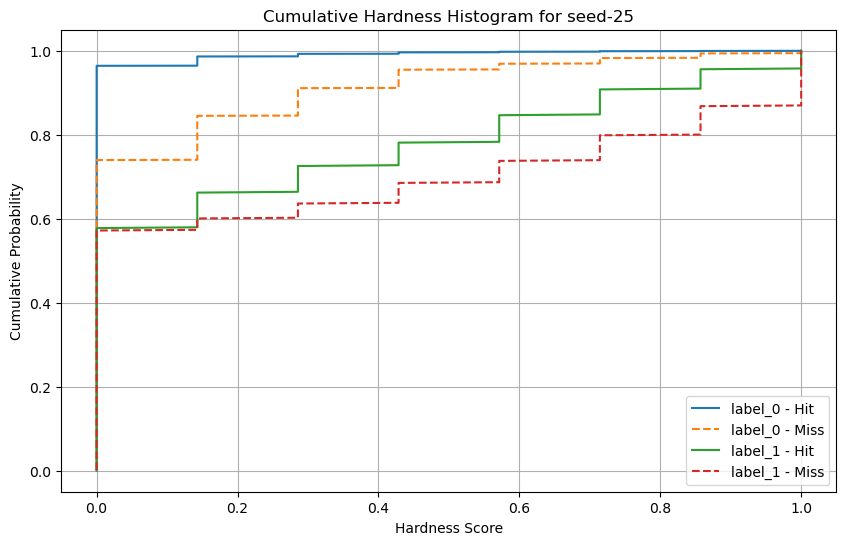

Hardness médio para seed-26: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_27.joblib


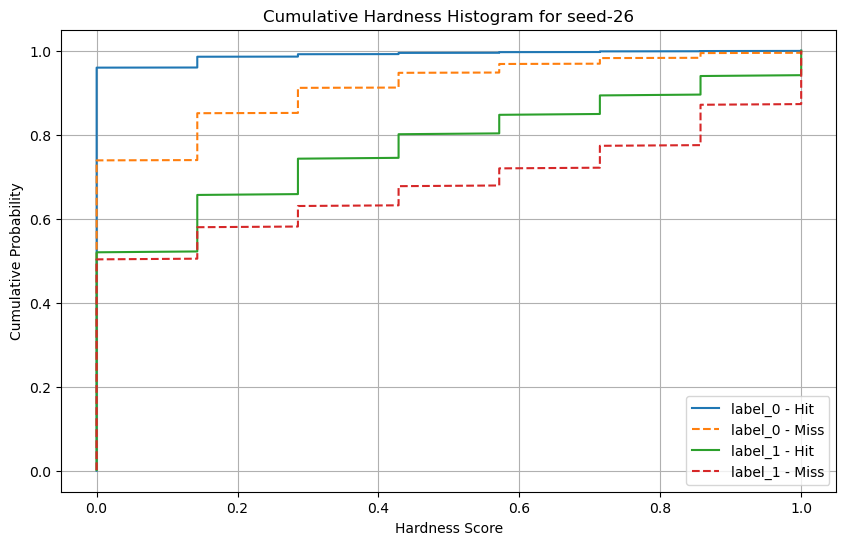

Hardness médio para seed-27: 0.0248
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_28.joblib


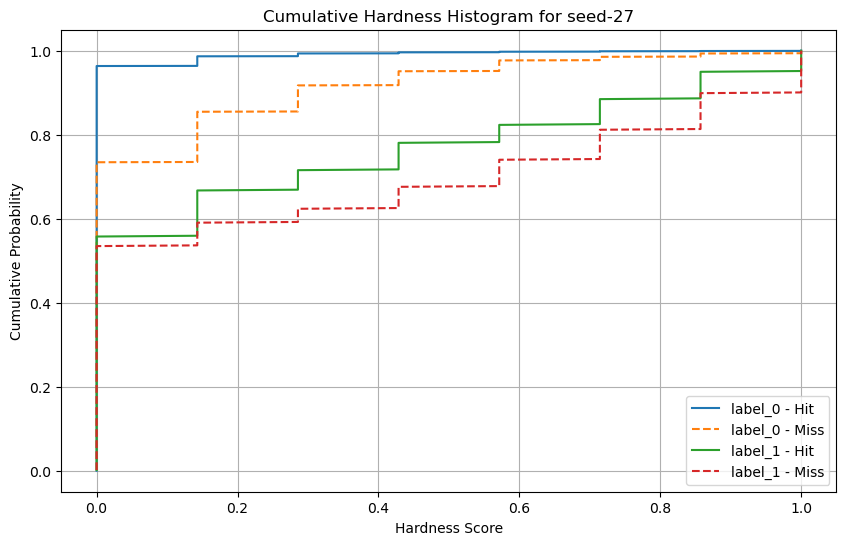

Hardness médio para seed-28: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_29.joblib


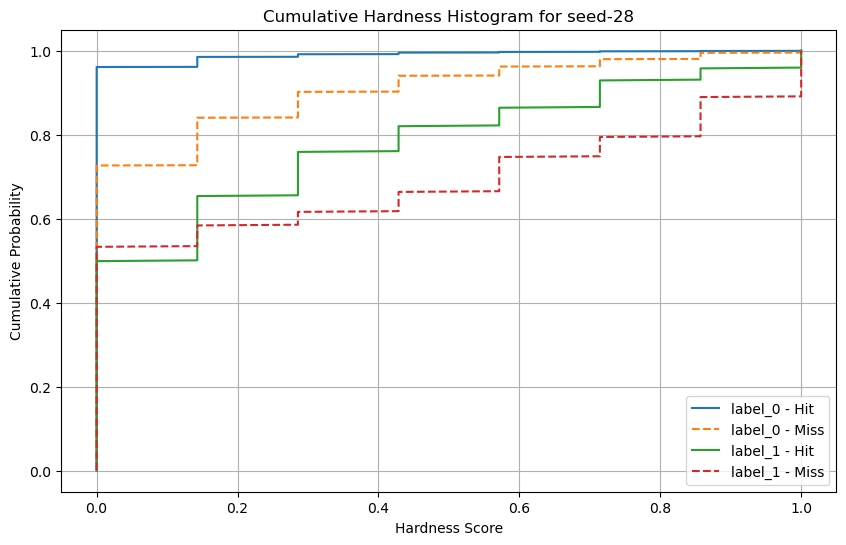

Hardness médio para seed-29: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\BaggingNaiveBayes\model_30.joblib


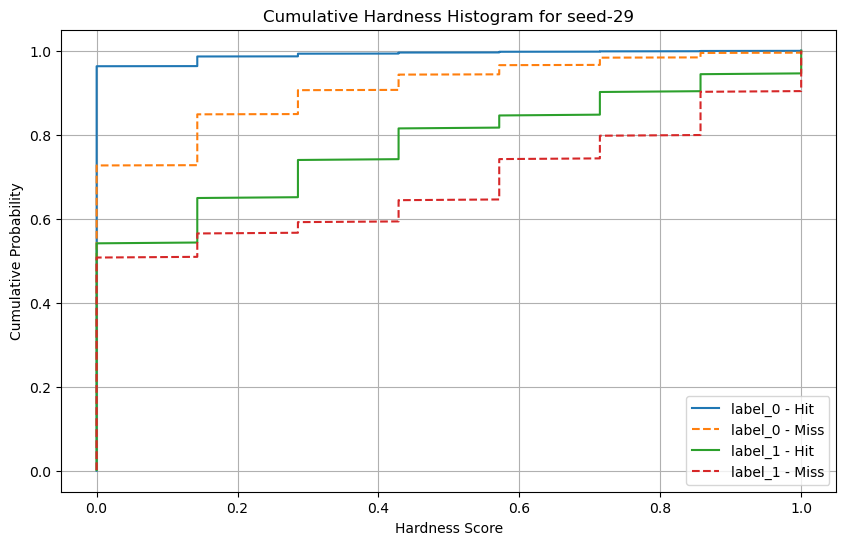

Processando pasta: DecisionTree
Hardness médio para seed-0: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_1.joblib


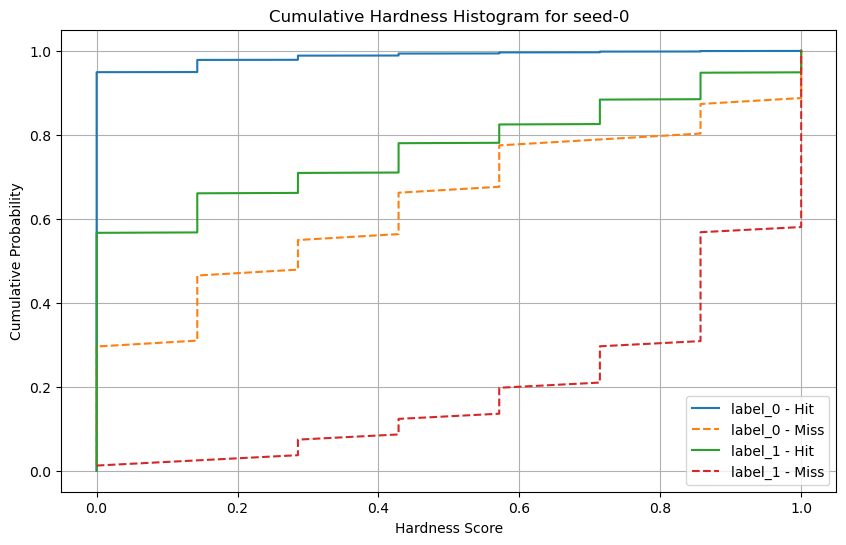

Hardness médio para seed-1: 0.0252
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_2.joblib


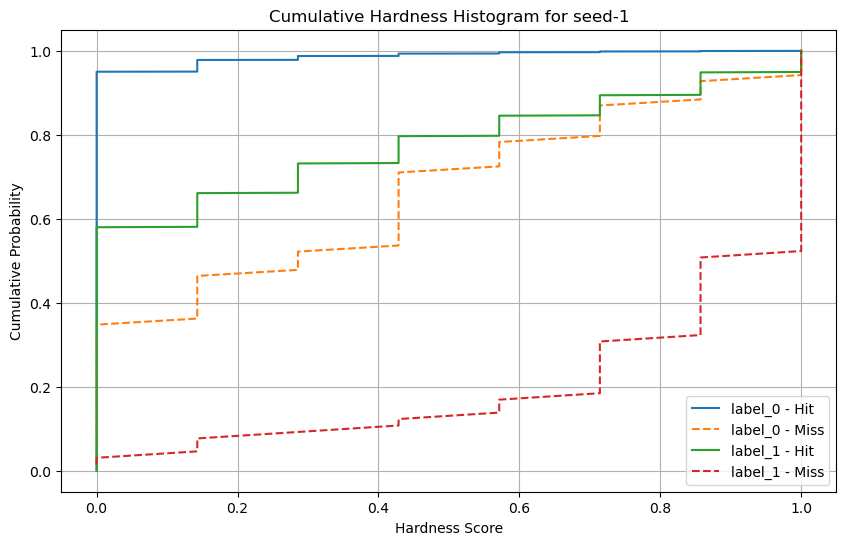

Hardness médio para seed-2: 0.0258
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_3.joblib


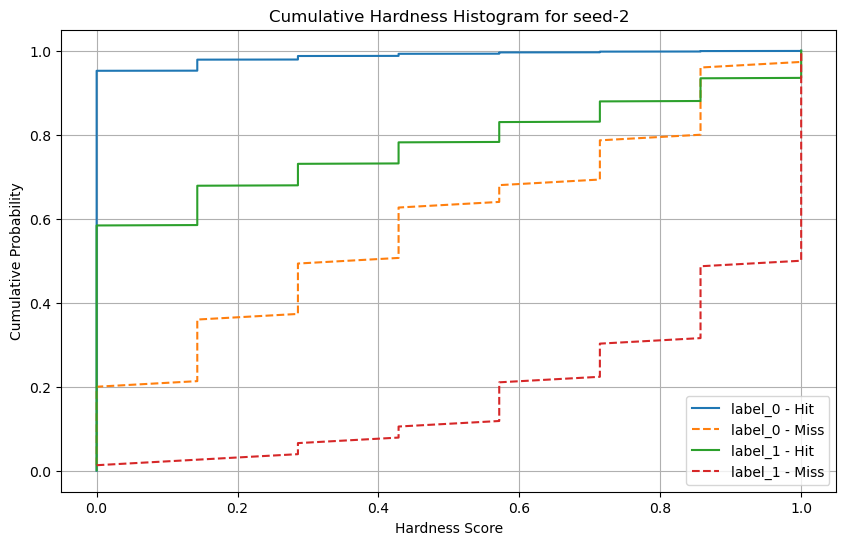

Hardness médio para seed-3: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_4.joblib


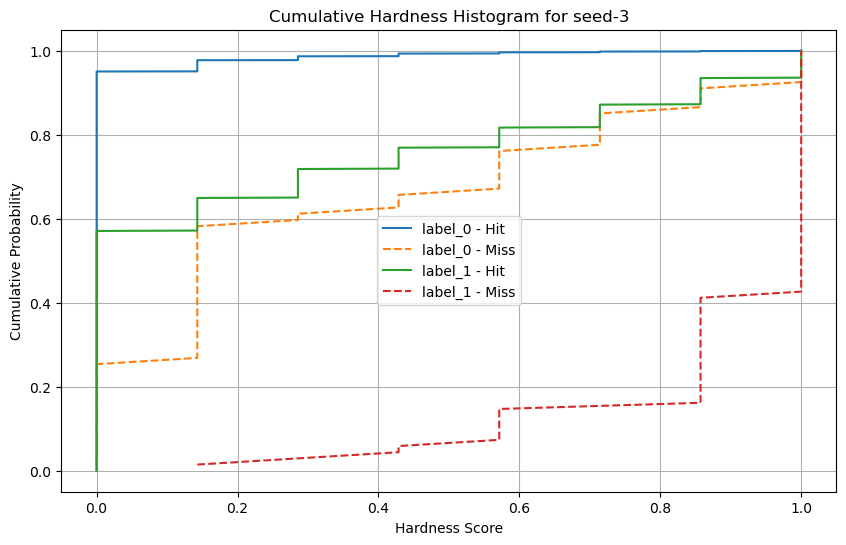

Hardness médio para seed-4: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_5.joblib


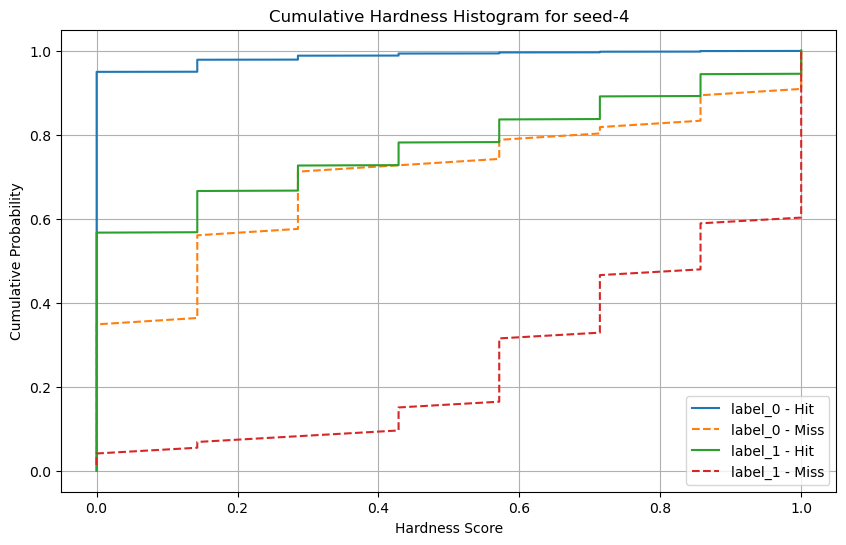

Hardness médio para seed-5: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_6.joblib


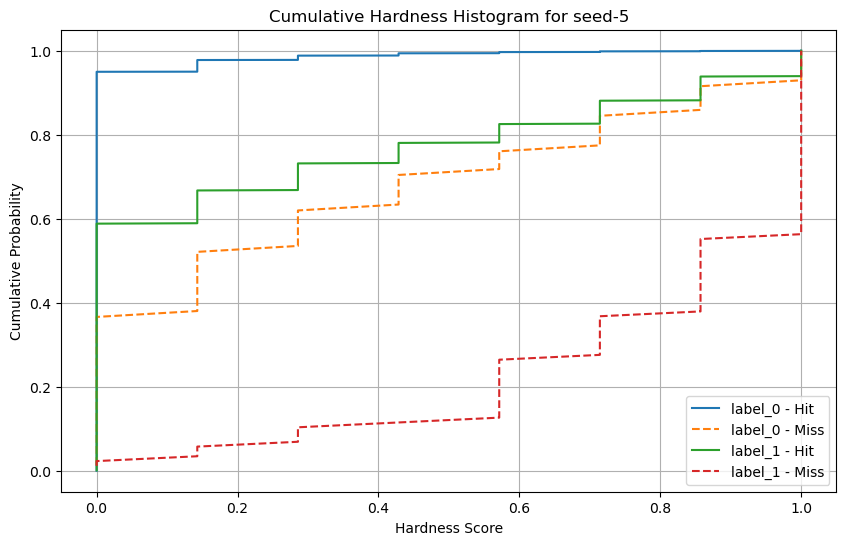

Hardness médio para seed-6: 0.0272
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_7.joblib


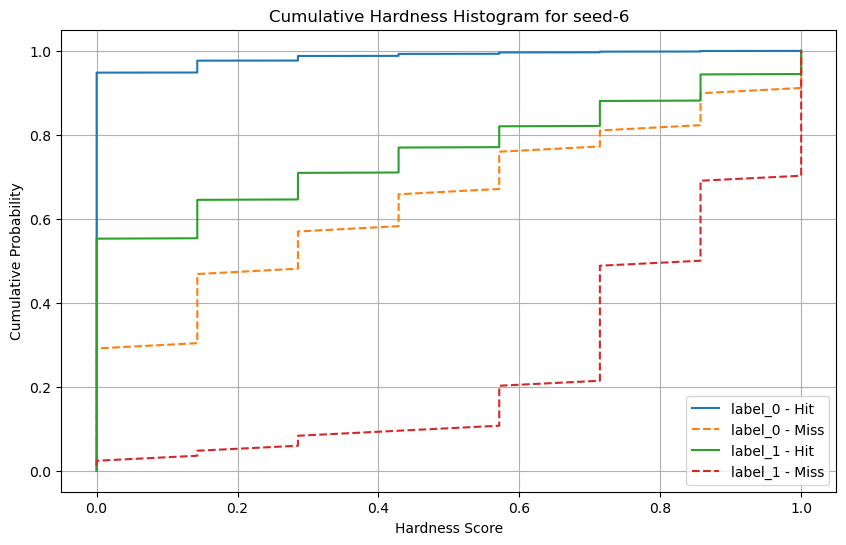

Hardness médio para seed-7: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_8.joblib


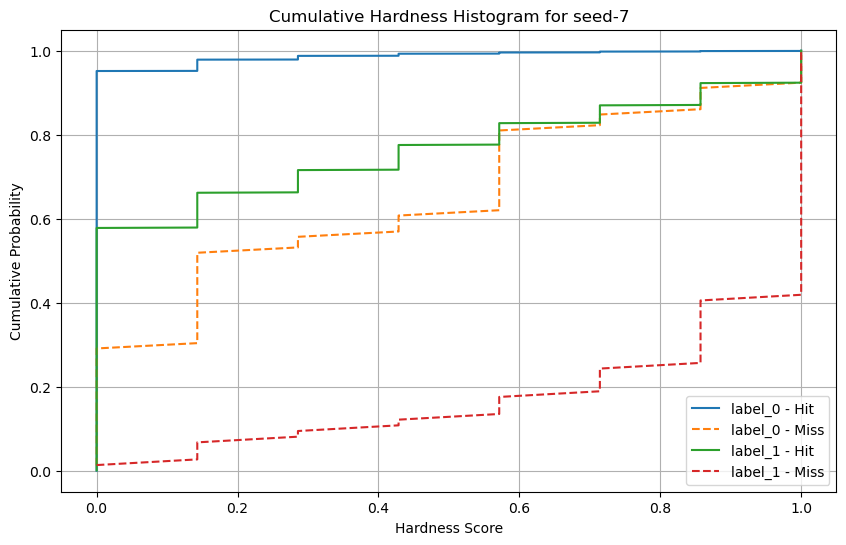

Hardness médio para seed-8: 0.0253
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_9.joblib


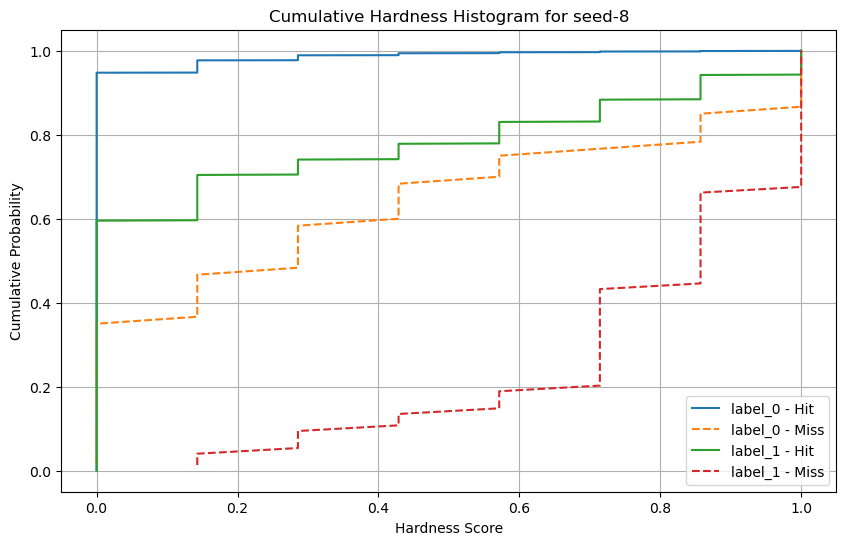

Hardness médio para seed-9: 0.0268
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_10.joblib


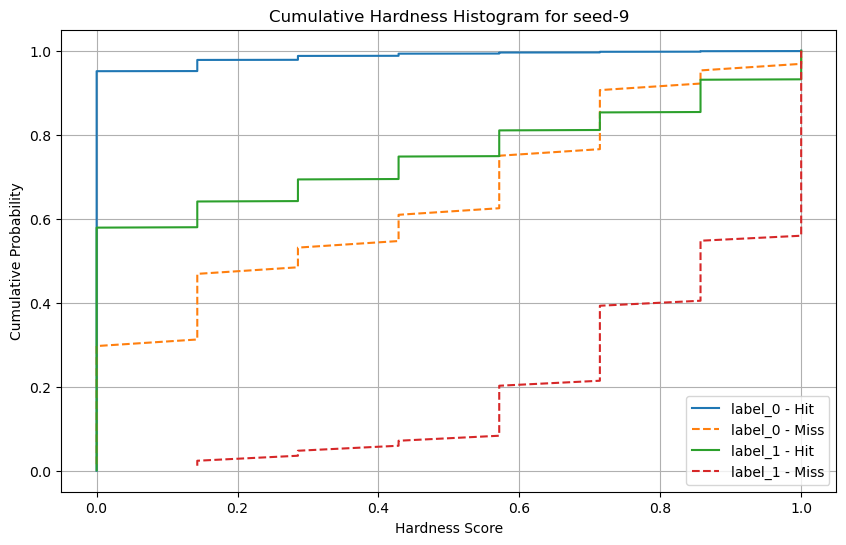

Hardness médio para seed-10: 0.0262
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_11.joblib


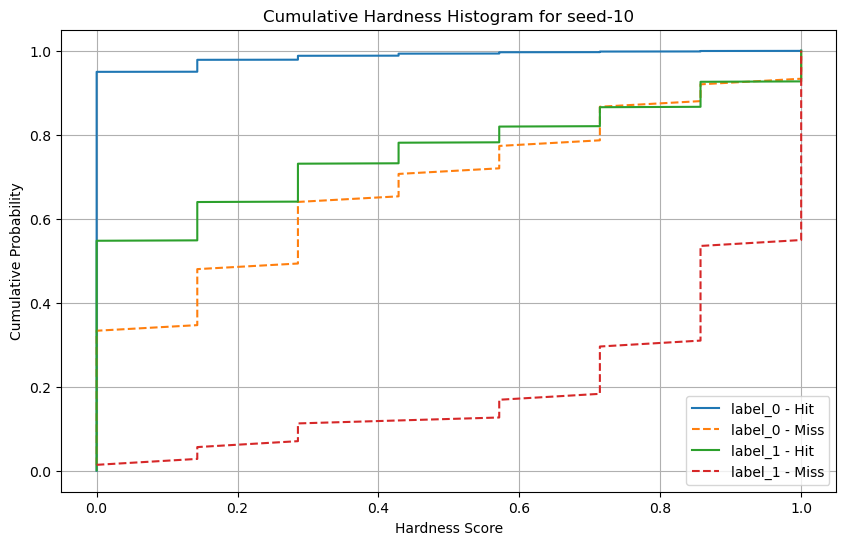

Hardness médio para seed-11: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_12.joblib


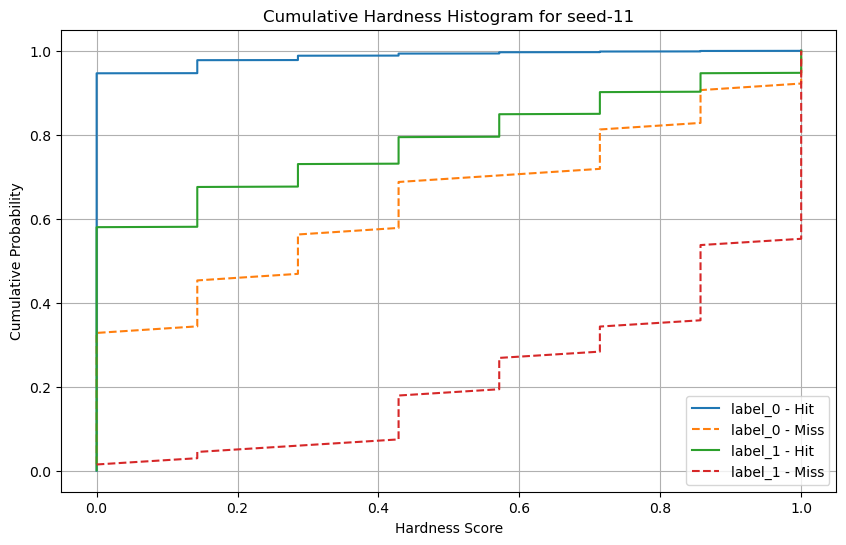

Hardness médio para seed-12: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_13.joblib


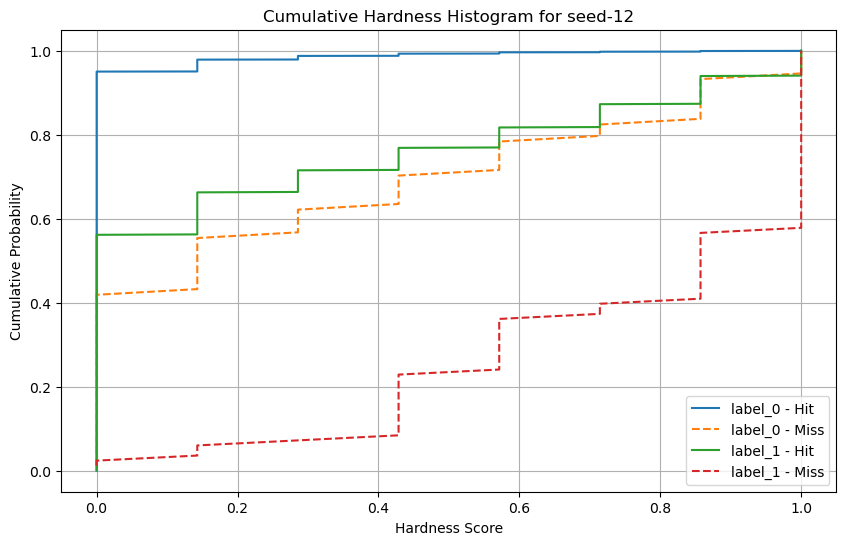

Hardness médio para seed-13: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_14.joblib


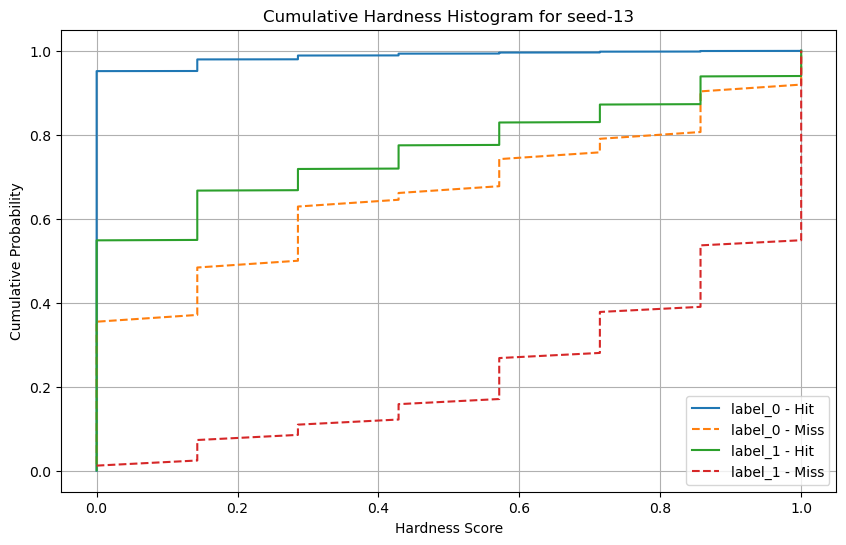

Hardness médio para seed-14: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_15.joblib


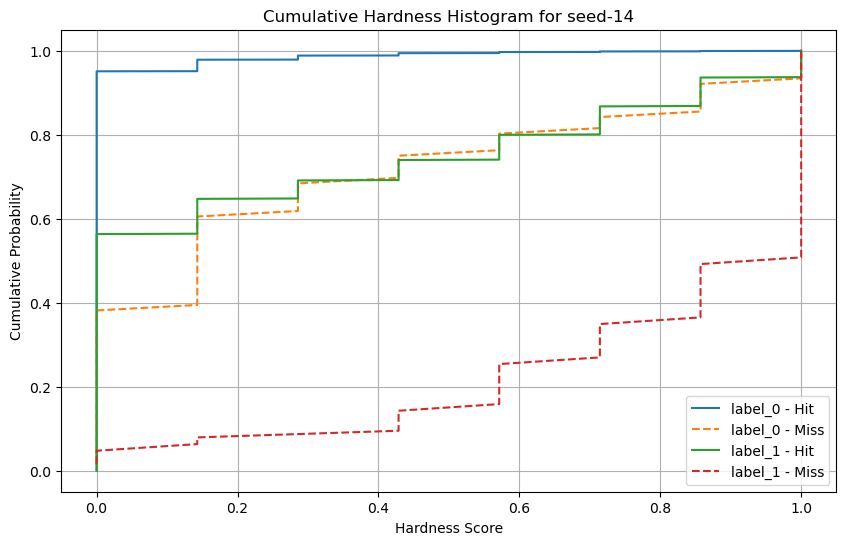

Hardness médio para seed-15: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_16.joblib


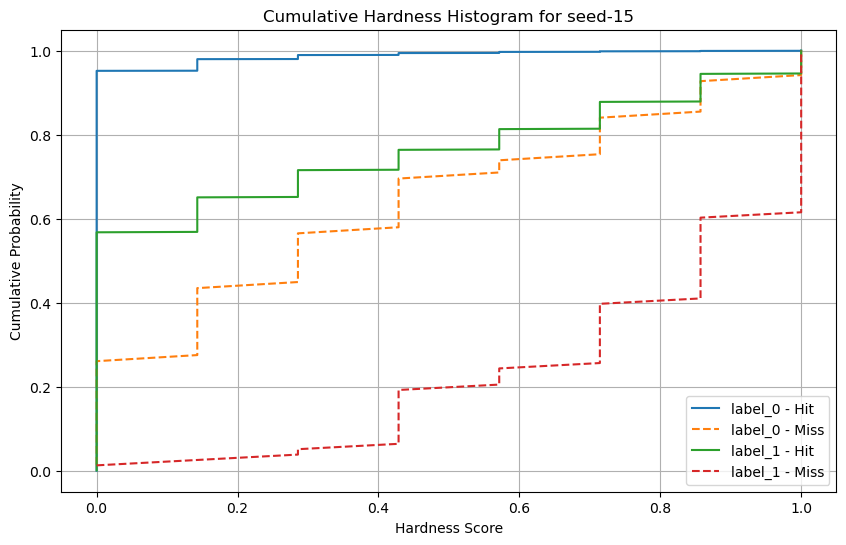

Hardness médio para seed-16: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_17.joblib


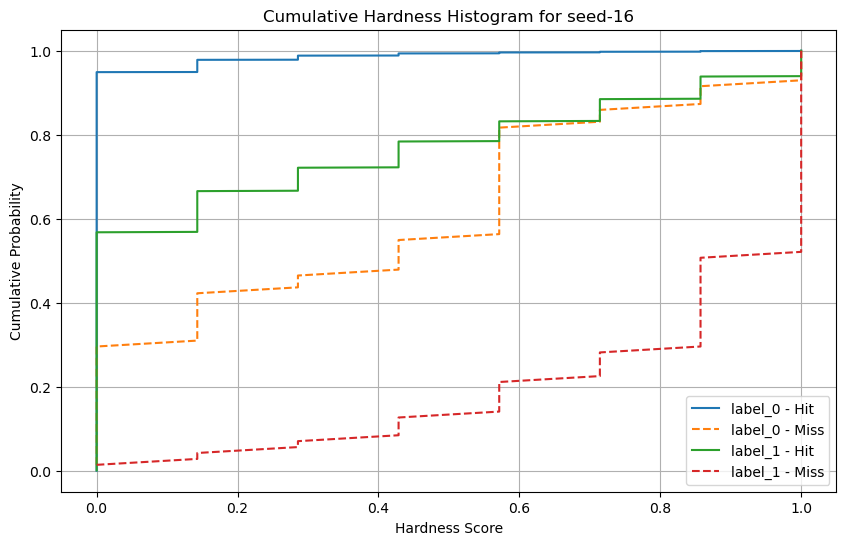

Hardness médio para seed-17: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_18.joblib


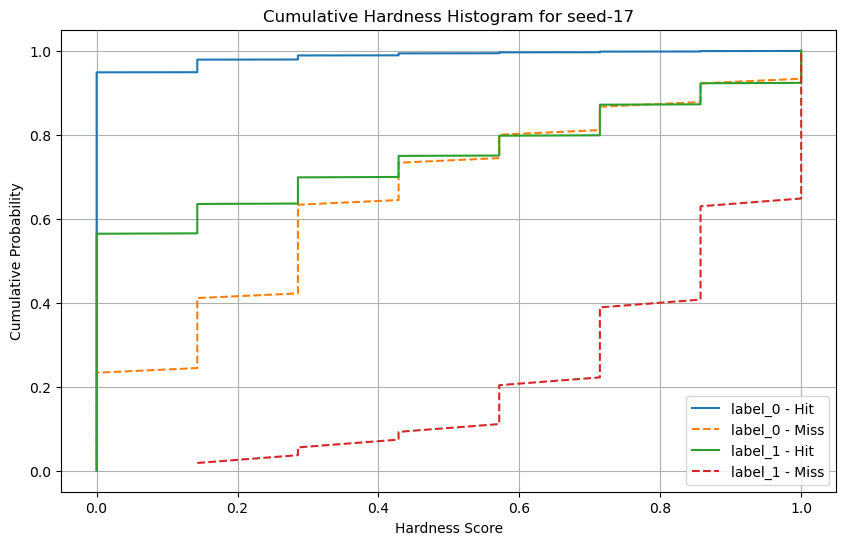

Hardness médio para seed-18: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_19.joblib


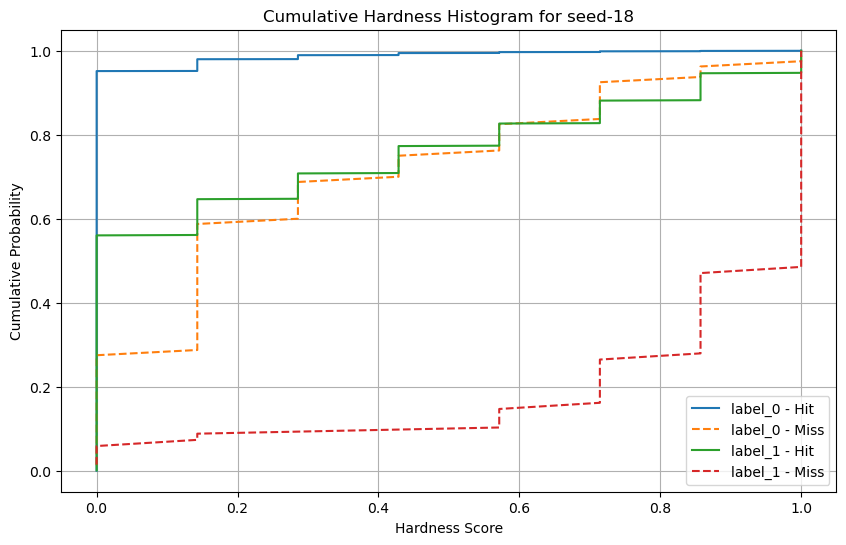

Hardness médio para seed-19: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_20.joblib


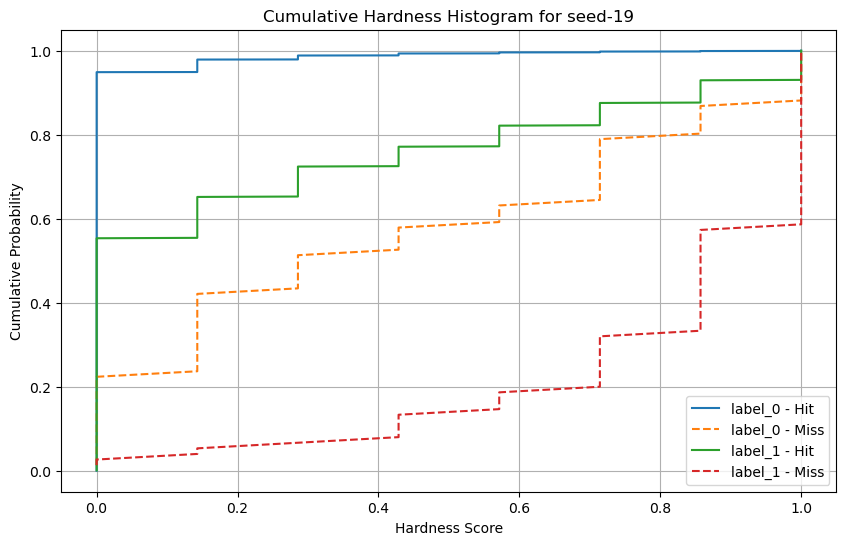

Hardness médio para seed-20: 0.0250
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_21.joblib


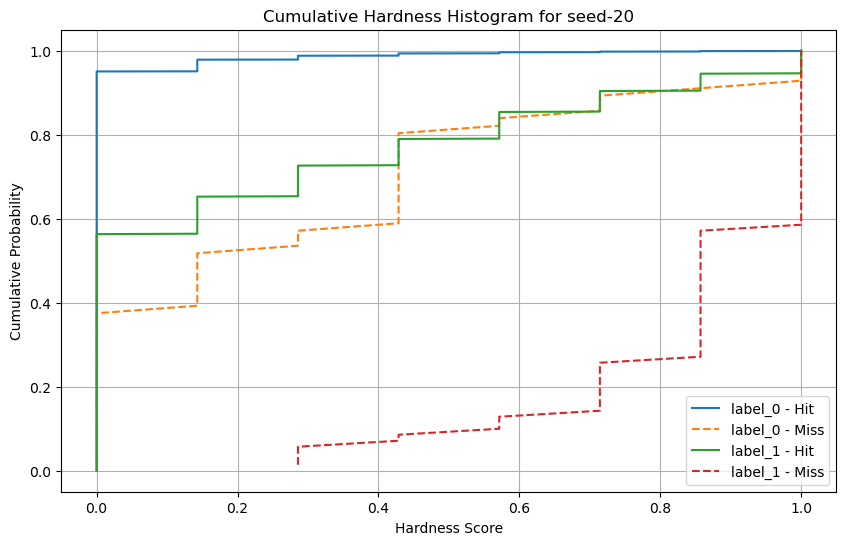

Hardness médio para seed-21: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_22.joblib


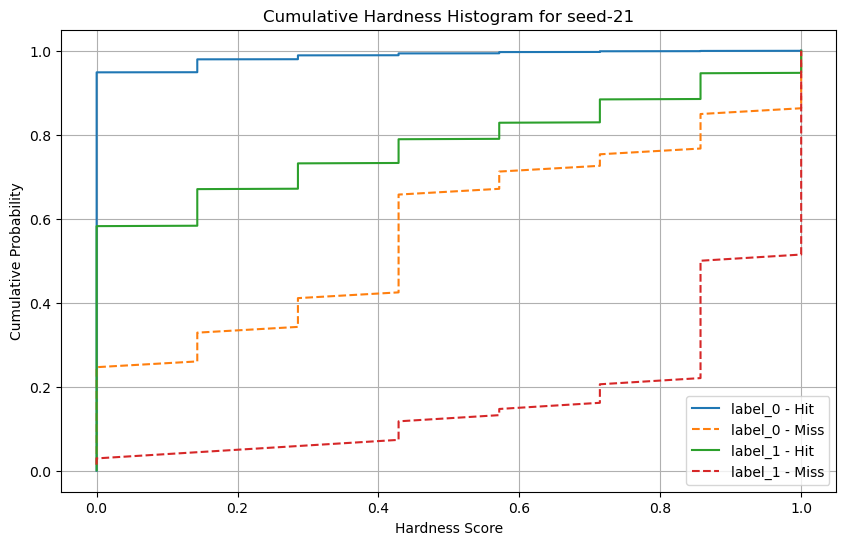

Hardness médio para seed-22: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_23.joblib


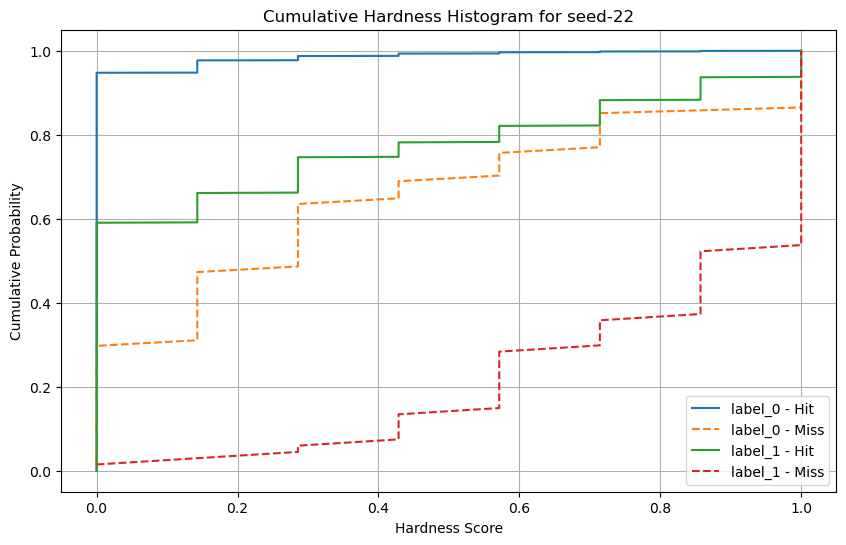

Hardness médio para seed-23: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_24.joblib


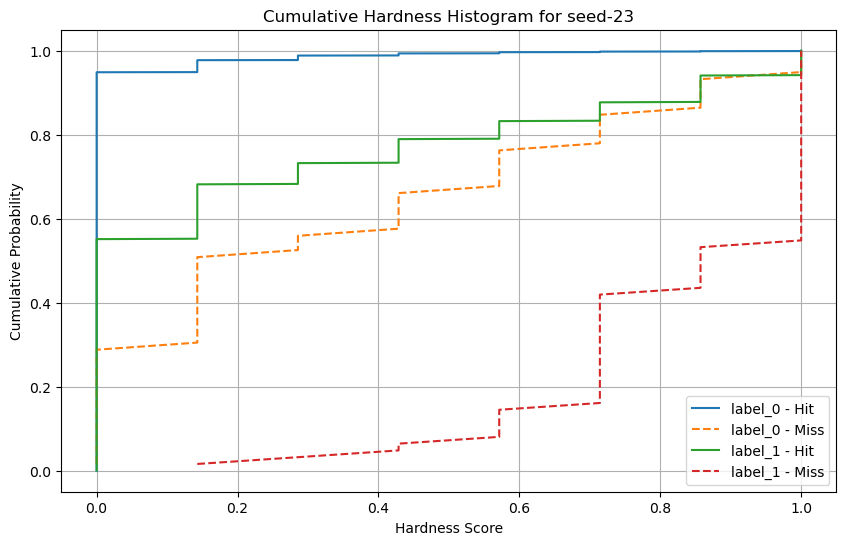

Hardness médio para seed-24: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_25.joblib


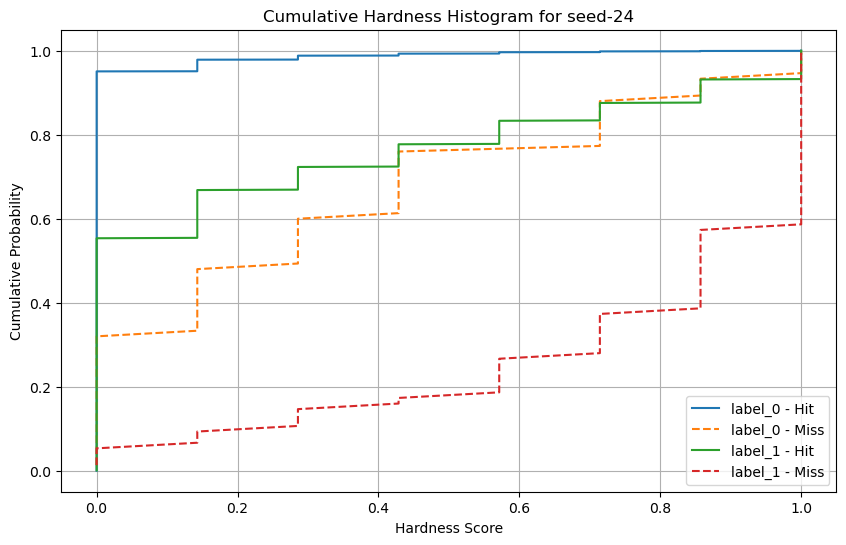

Hardness médio para seed-25: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_26.joblib


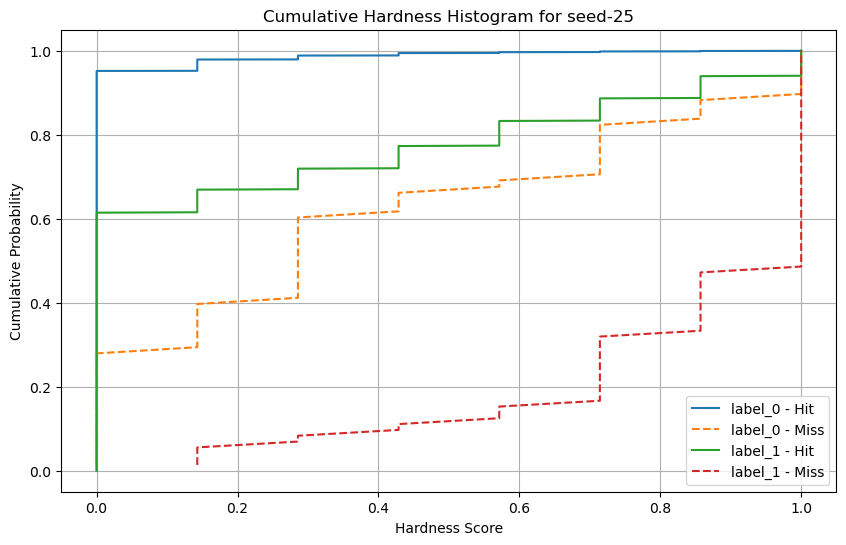

Hardness médio para seed-26: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_27.joblib


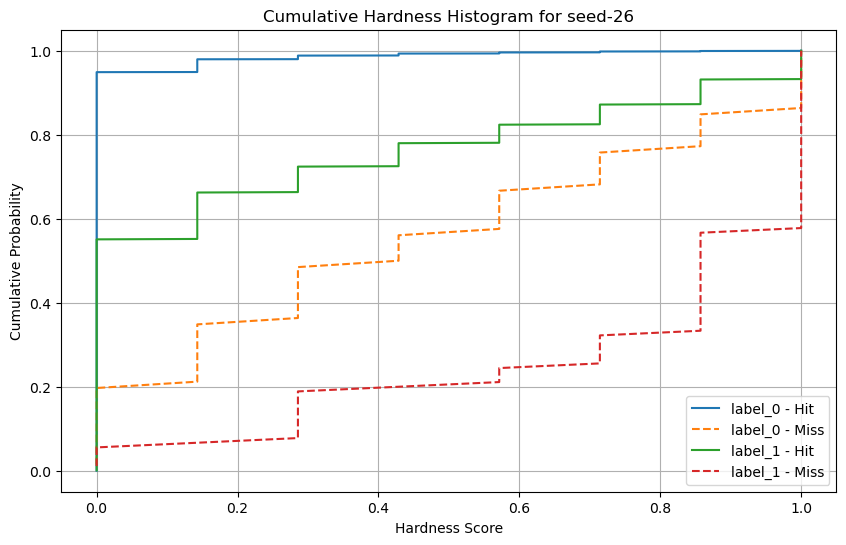

Hardness médio para seed-27: 0.0248
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_28.joblib


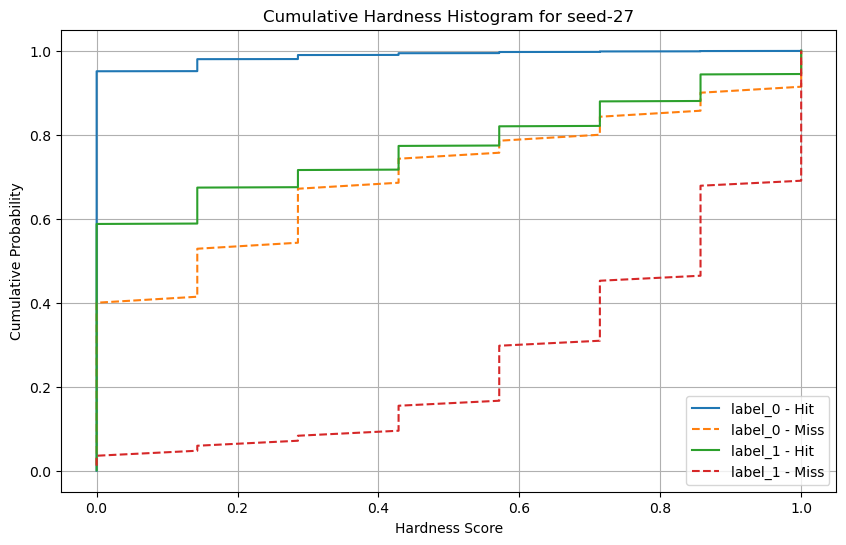

Hardness médio para seed-28: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_29.joblib


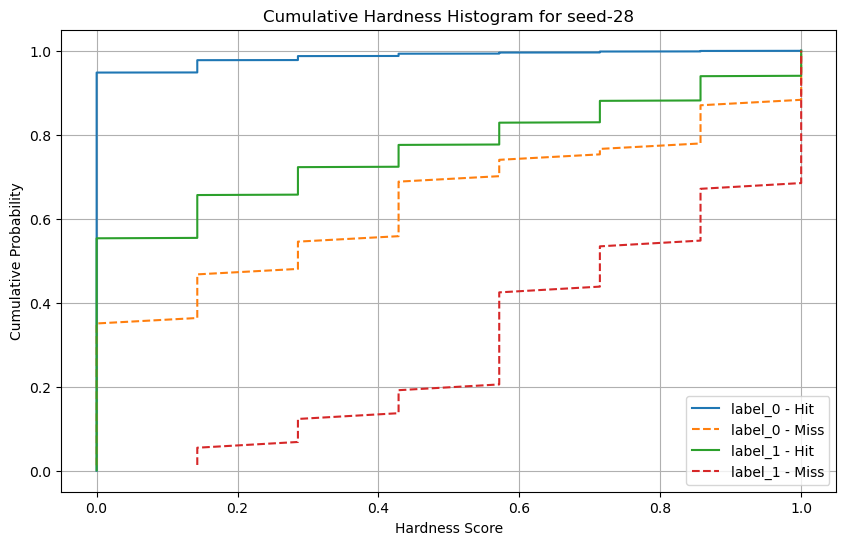

Hardness médio para seed-29: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\DecisionTree\model_30.joblib


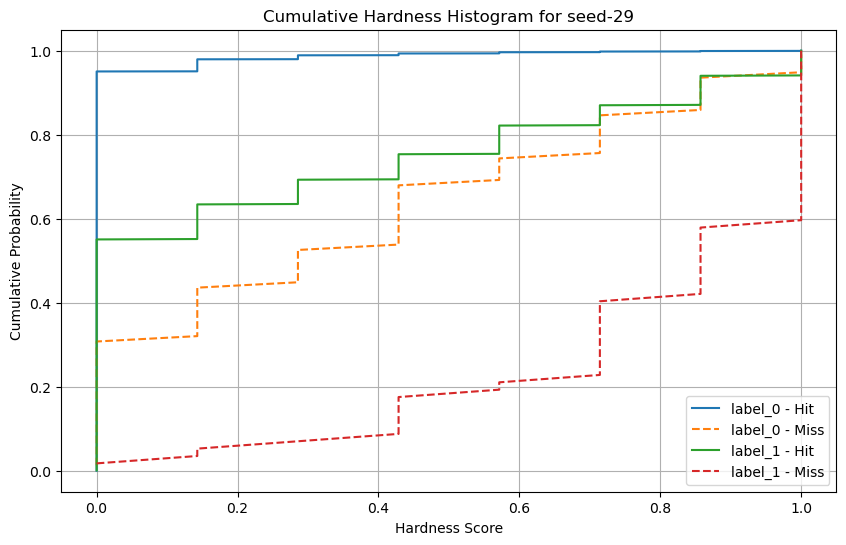

Processando pasta: GradientBoostedDecisionTree
Hardness médio para seed-0: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_1.joblib


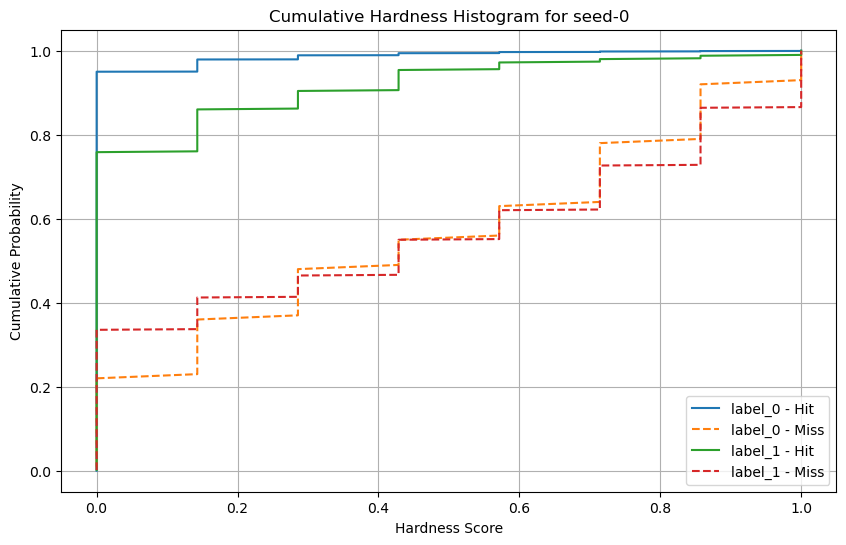

Hardness médio para seed-1: 0.0252
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_2.joblib


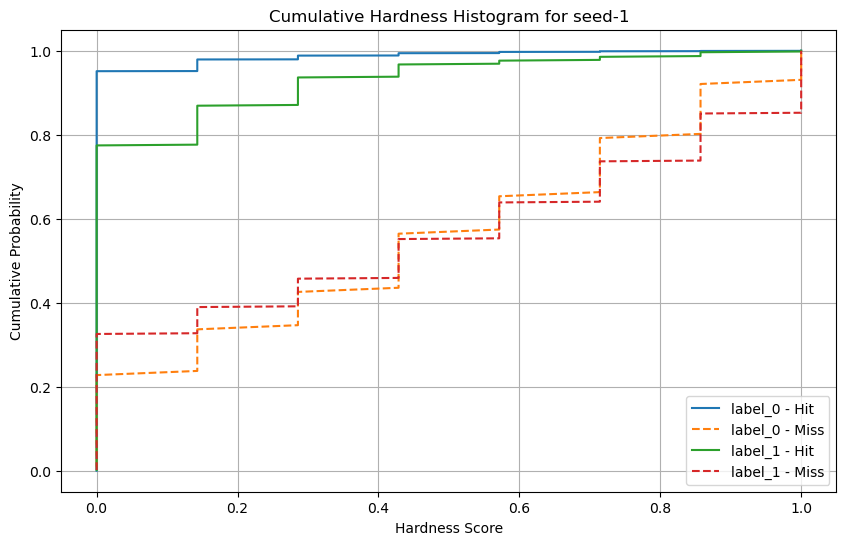

Hardness médio para seed-2: 0.0258
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_3.joblib


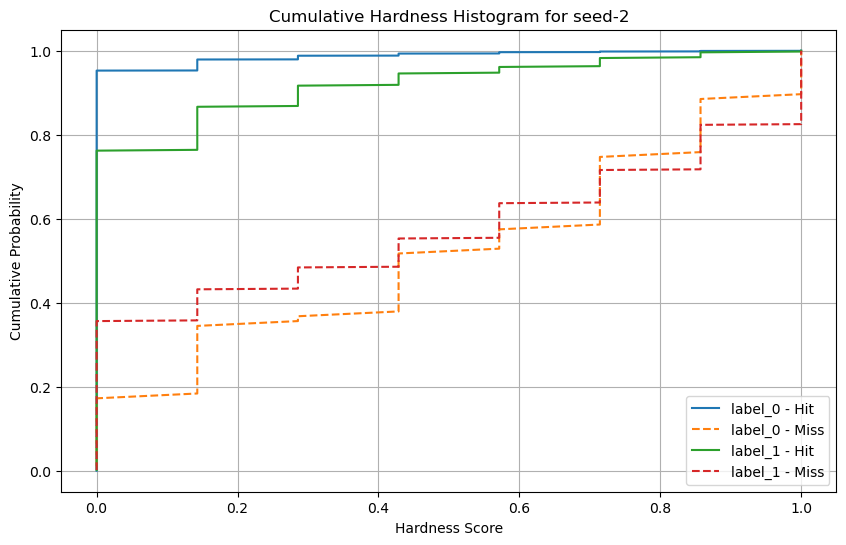

Hardness médio para seed-3: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_4.joblib


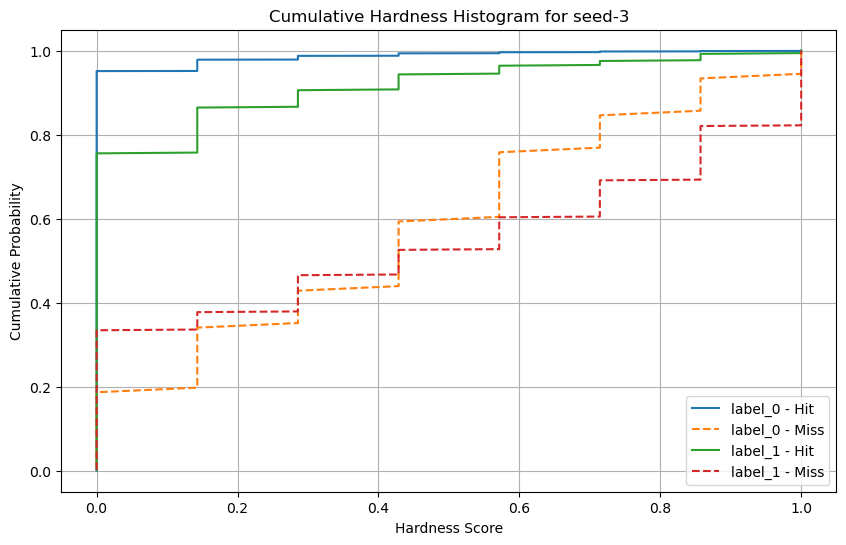

Hardness médio para seed-4: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_5.joblib


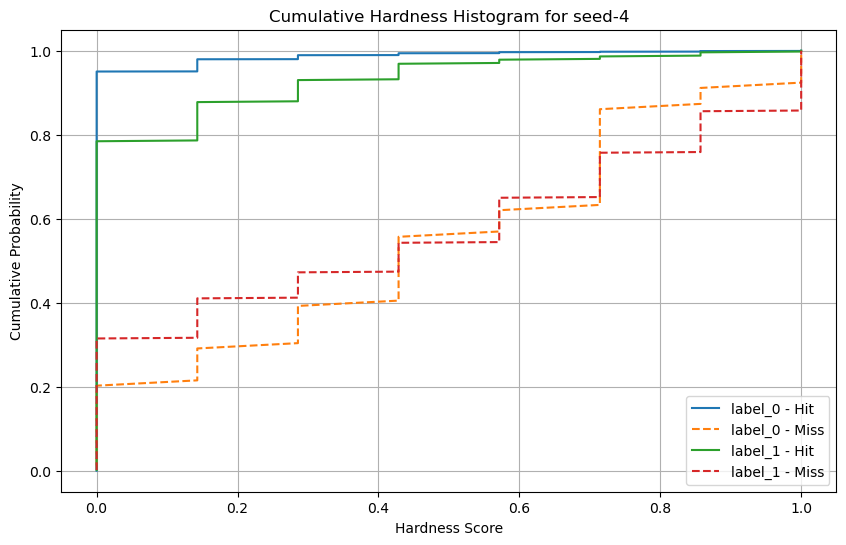

Hardness médio para seed-5: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_6.joblib


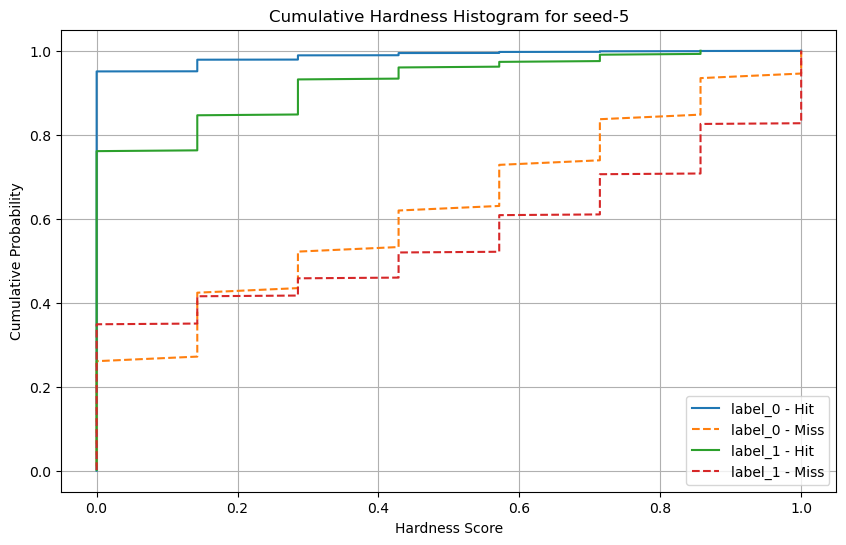

Hardness médio para seed-6: 0.0272
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_7.joblib


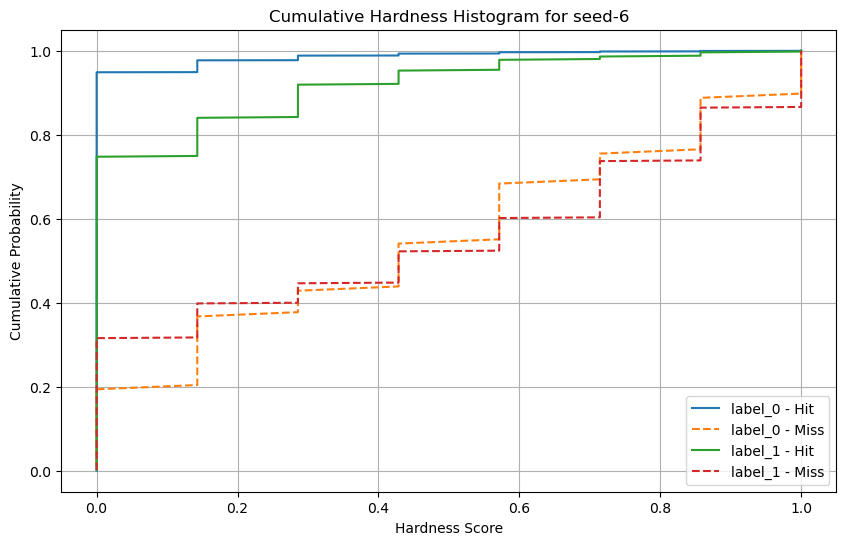

Hardness médio para seed-7: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_8.joblib


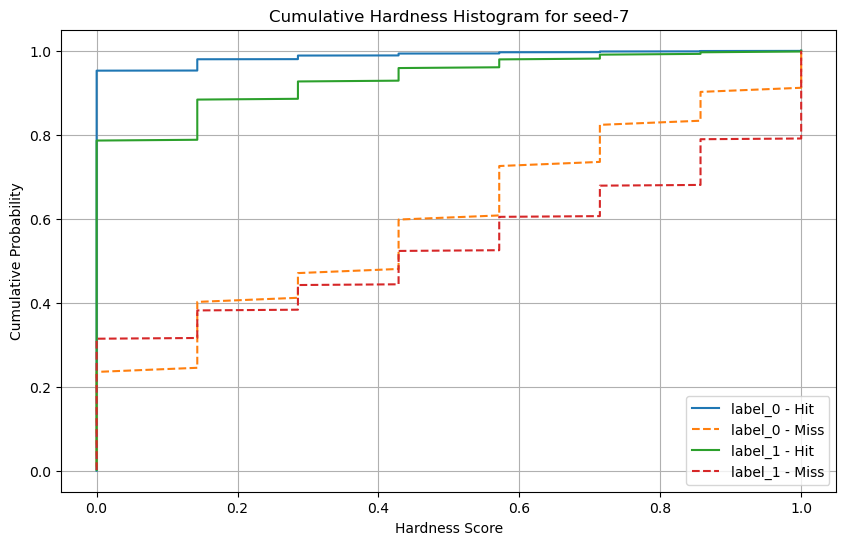

Hardness médio para seed-8: 0.0253
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_9.joblib


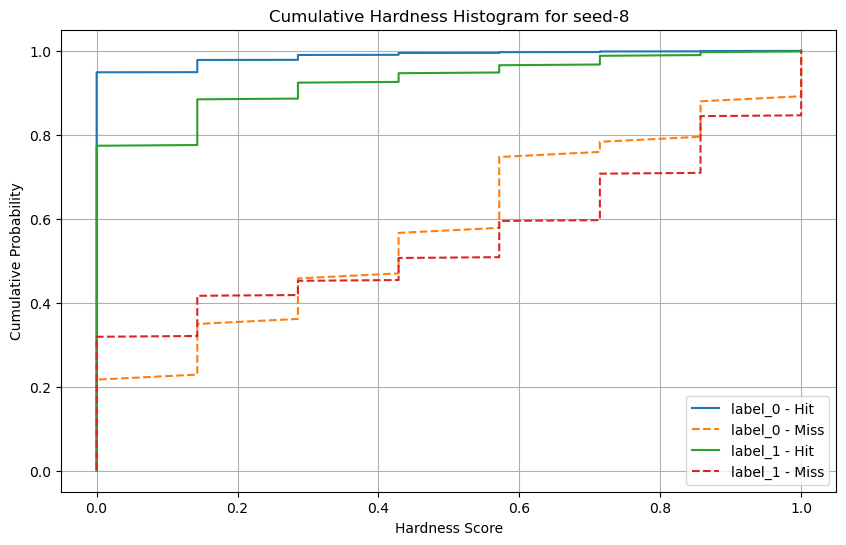

Hardness médio para seed-9: 0.0268
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_10.joblib


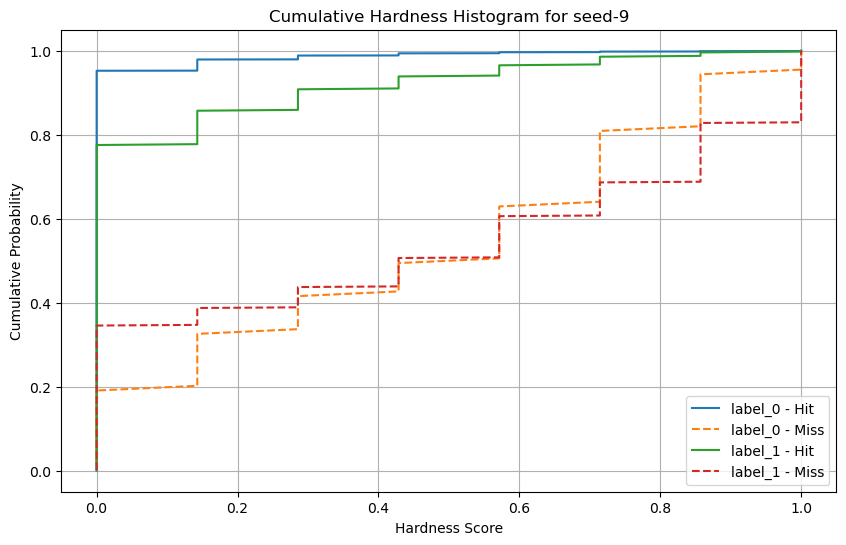

Hardness médio para seed-10: 0.0262
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_11.joblib


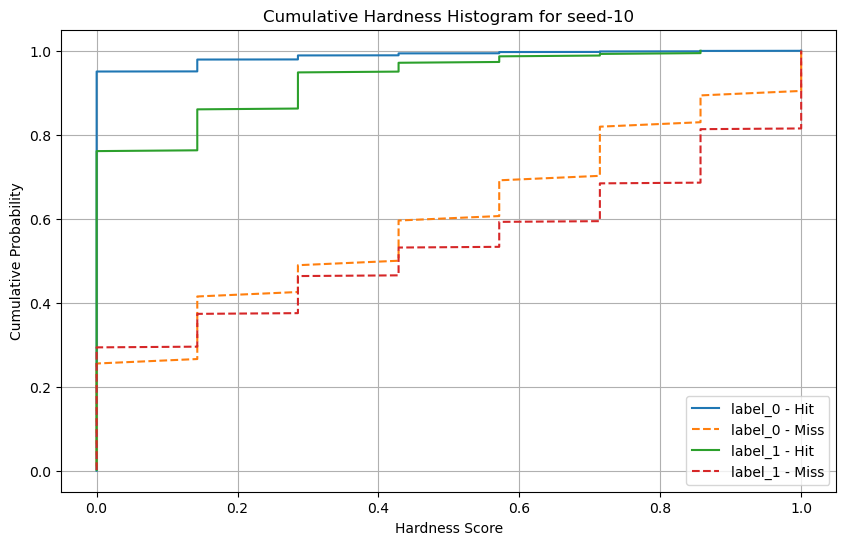

Hardness médio para seed-11: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_12.joblib


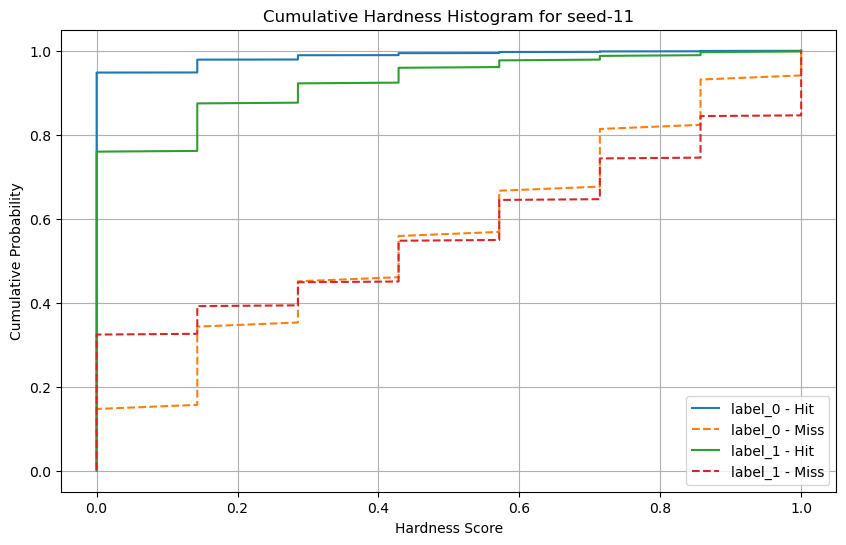

Hardness médio para seed-12: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_13.joblib


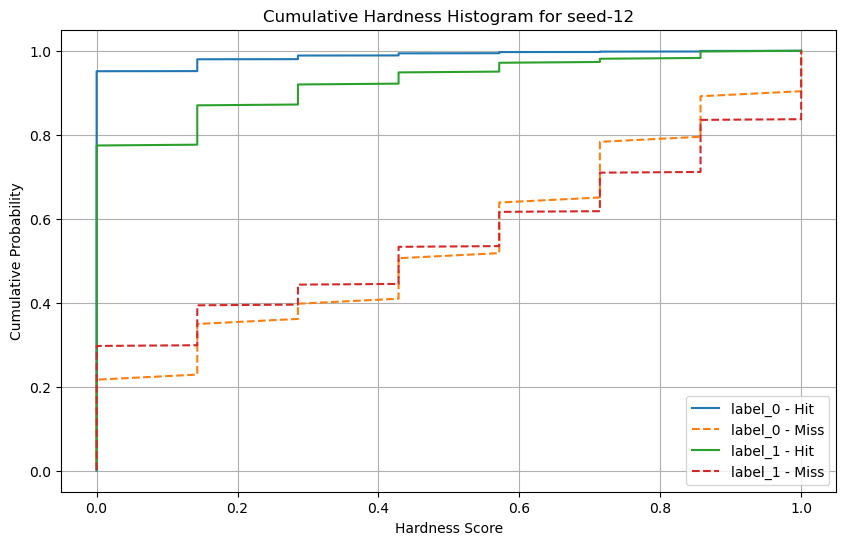

Hardness médio para seed-13: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_14.joblib


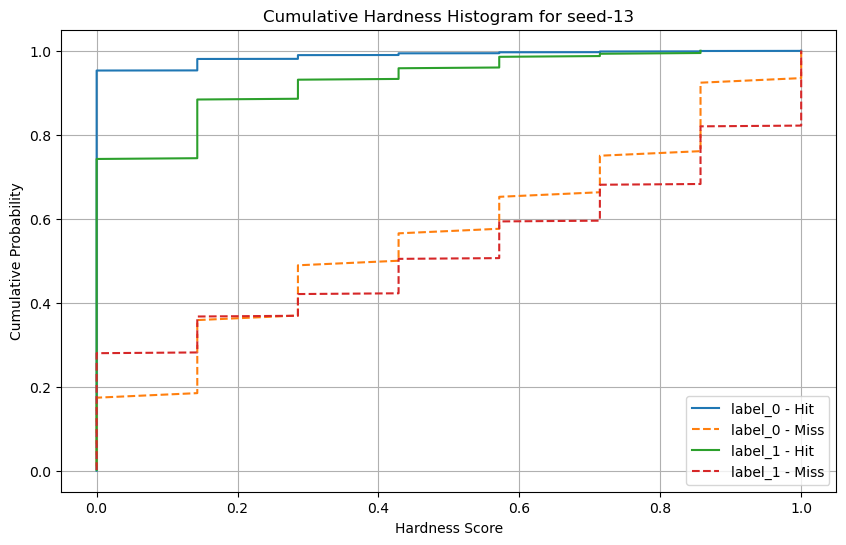

Hardness médio para seed-14: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_15.joblib


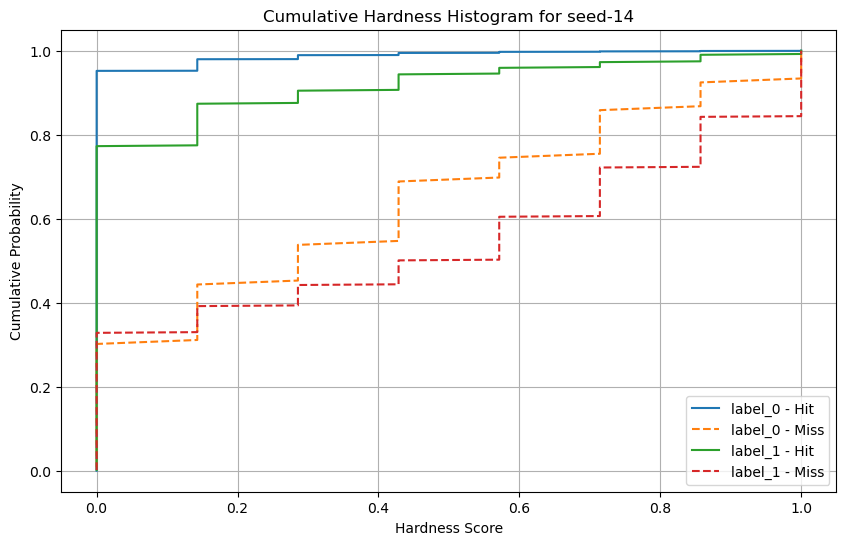

Hardness médio para seed-15: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_16.joblib


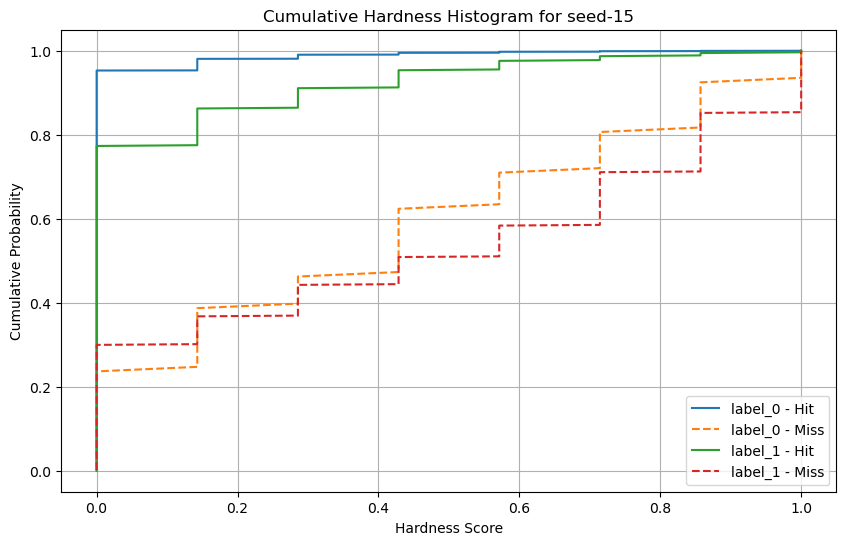

Hardness médio para seed-16: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_17.joblib


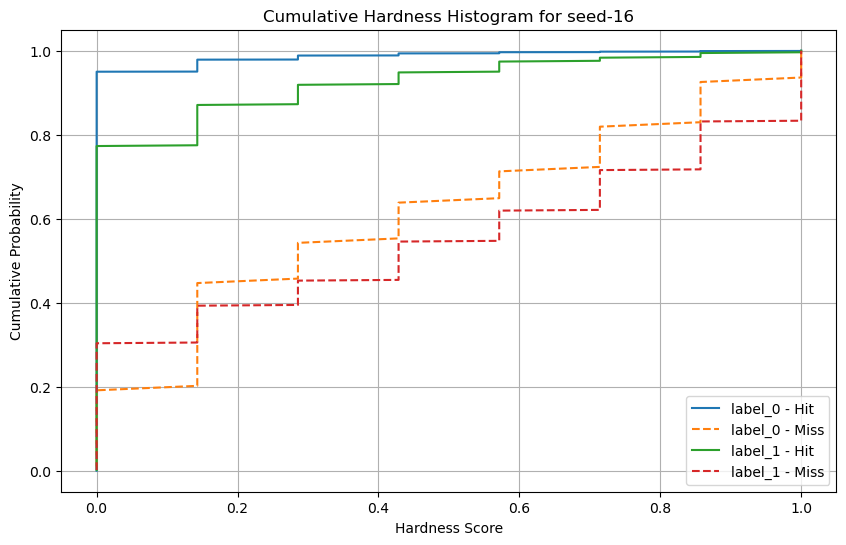

Hardness médio para seed-17: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_18.joblib


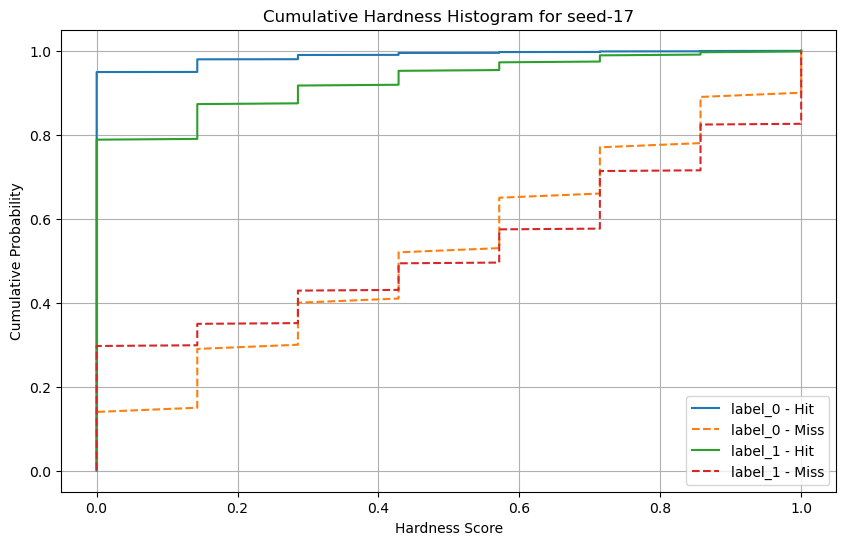

Hardness médio para seed-18: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_19.joblib


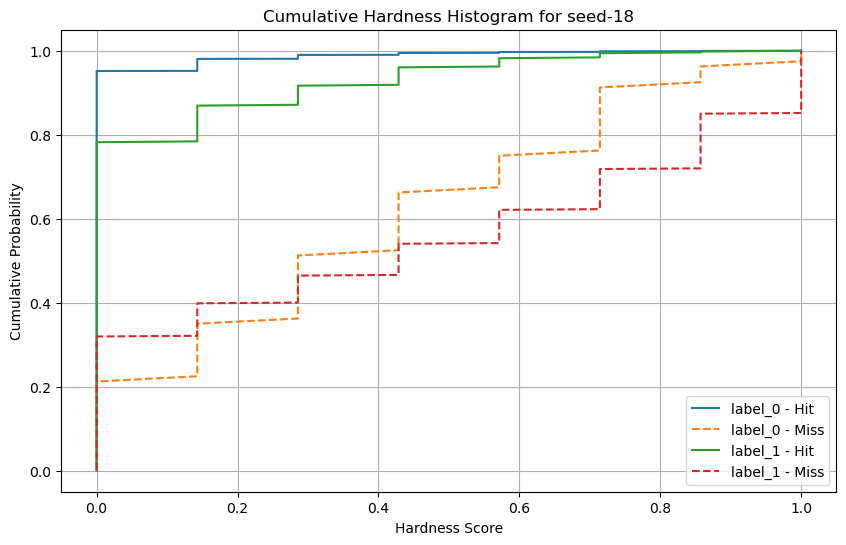

Hardness médio para seed-19: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_20.joblib


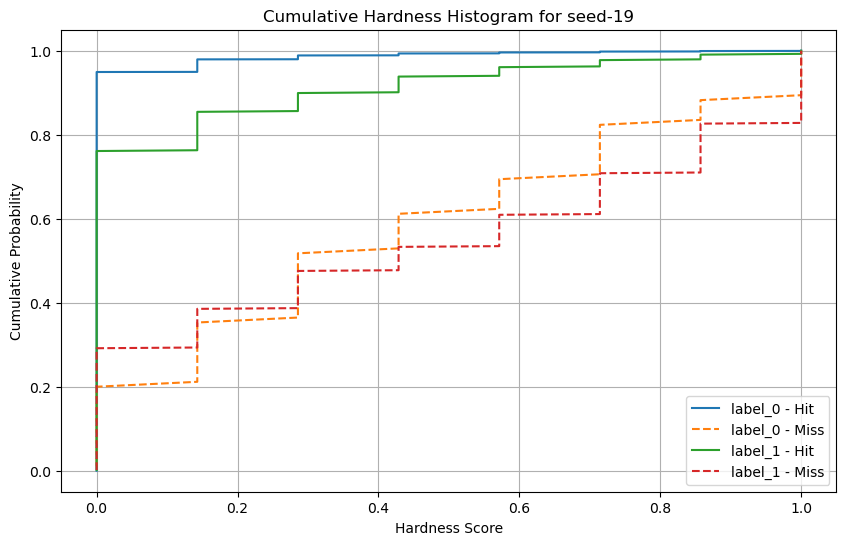

Hardness médio para seed-20: 0.0250
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_21.joblib


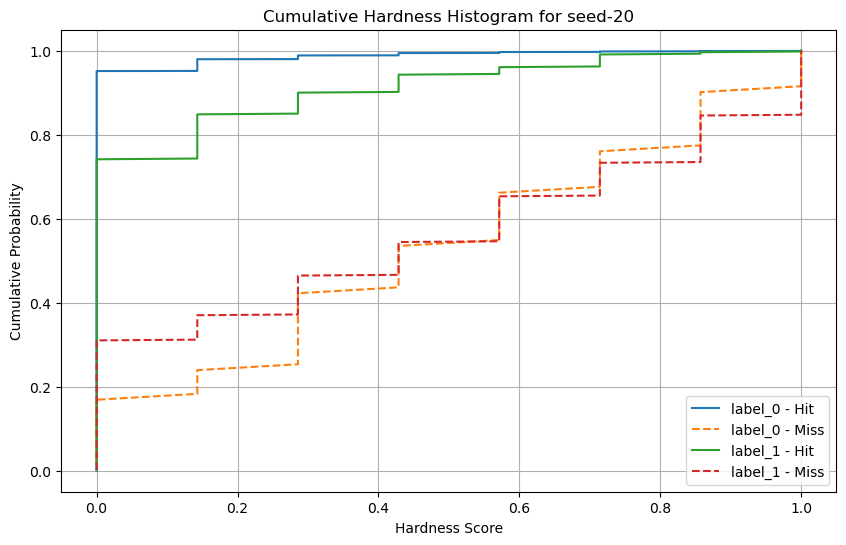

Hardness médio para seed-21: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_22.joblib


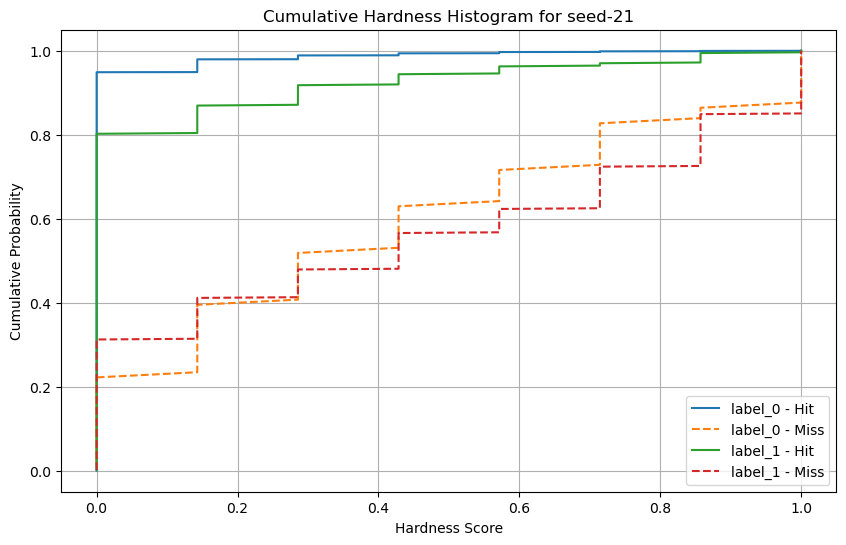

Hardness médio para seed-22: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_23.joblib


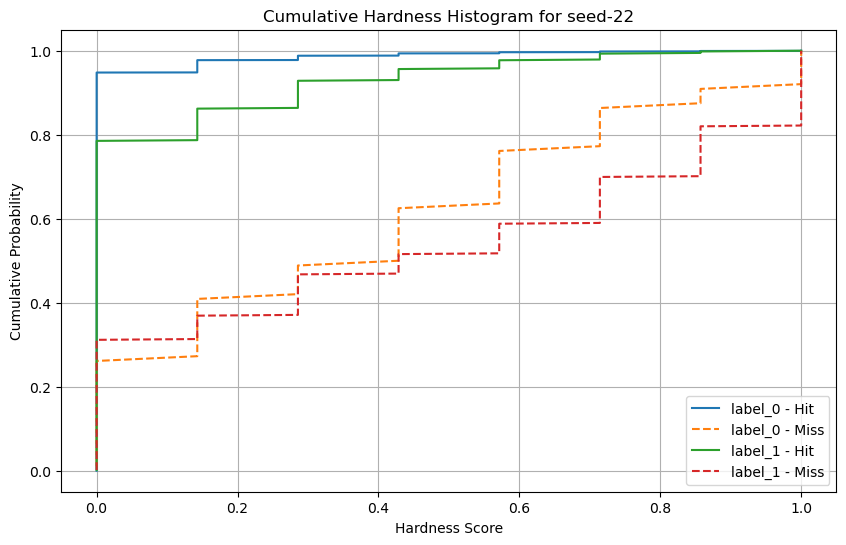

Hardness médio para seed-23: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_24.joblib


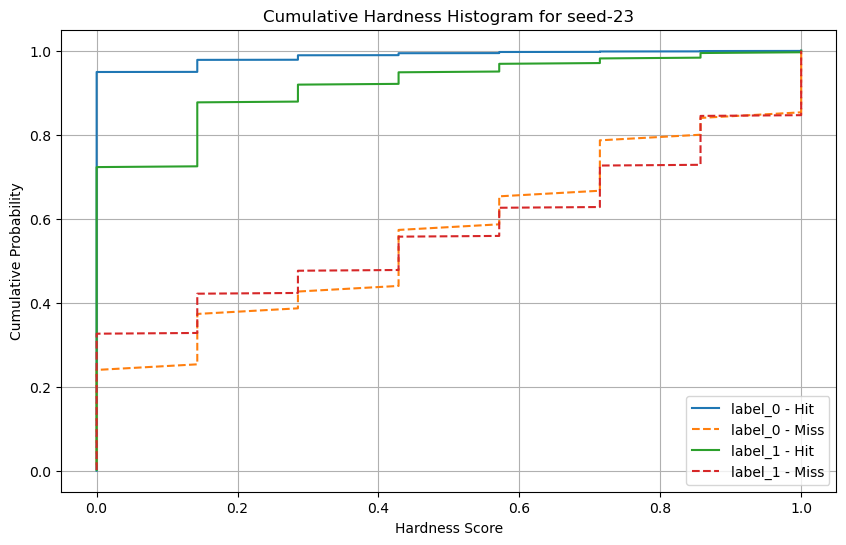

Hardness médio para seed-24: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_25.joblib


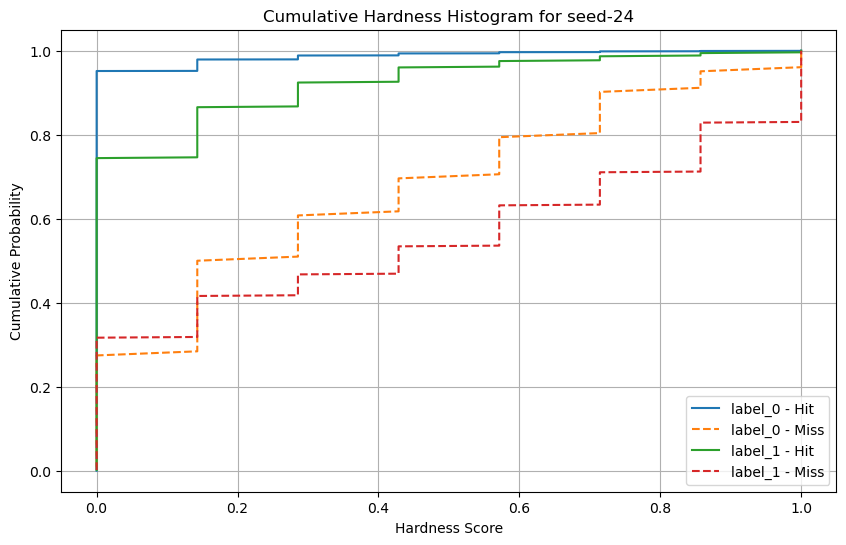

Hardness médio para seed-25: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_26.joblib


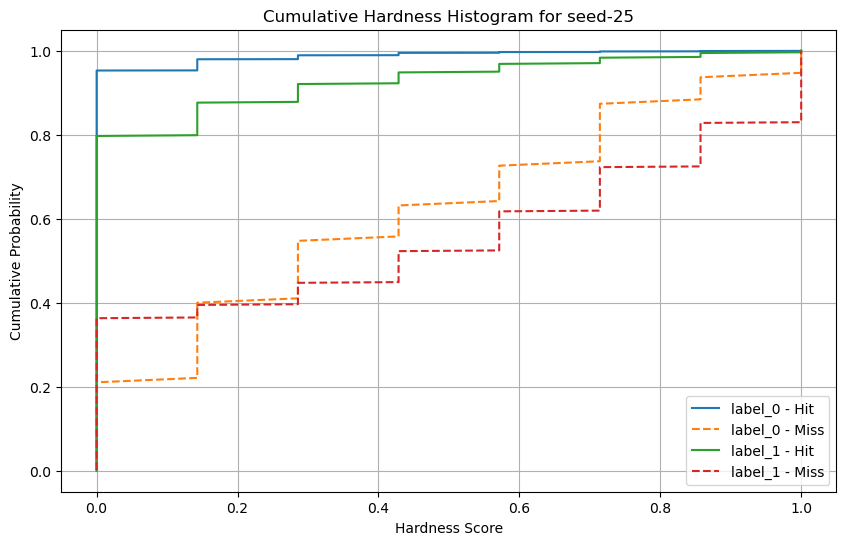

Hardness médio para seed-26: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_27.joblib


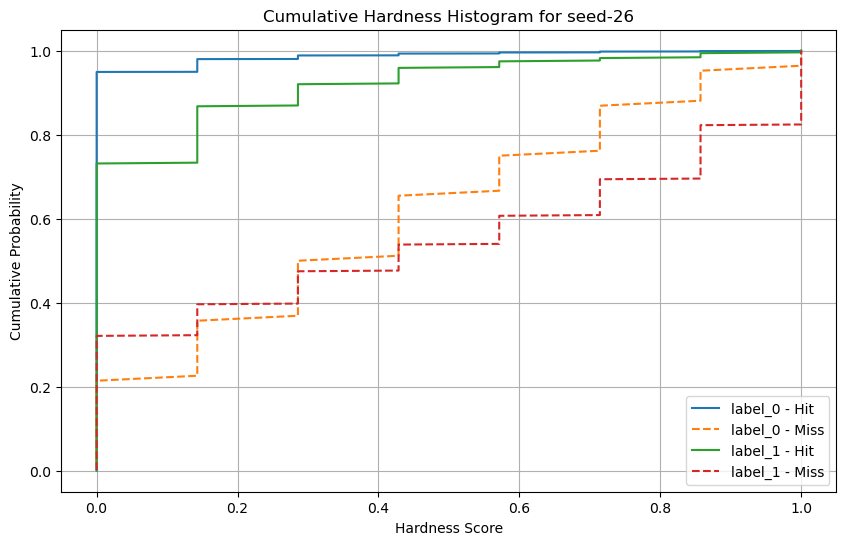

Hardness médio para seed-27: 0.0248
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_28.joblib


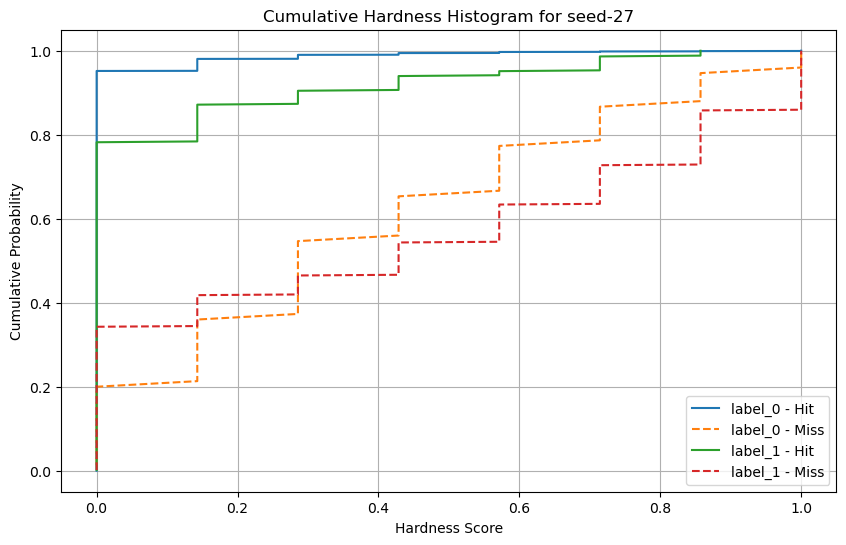

Hardness médio para seed-28: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_29.joblib


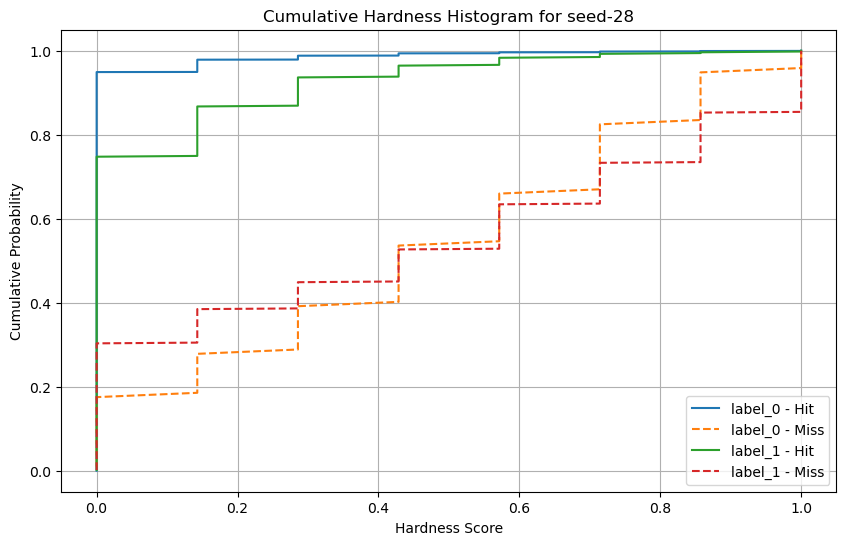

Hardness médio para seed-29: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\GradientBoostedDecisionTree\model_30.joblib


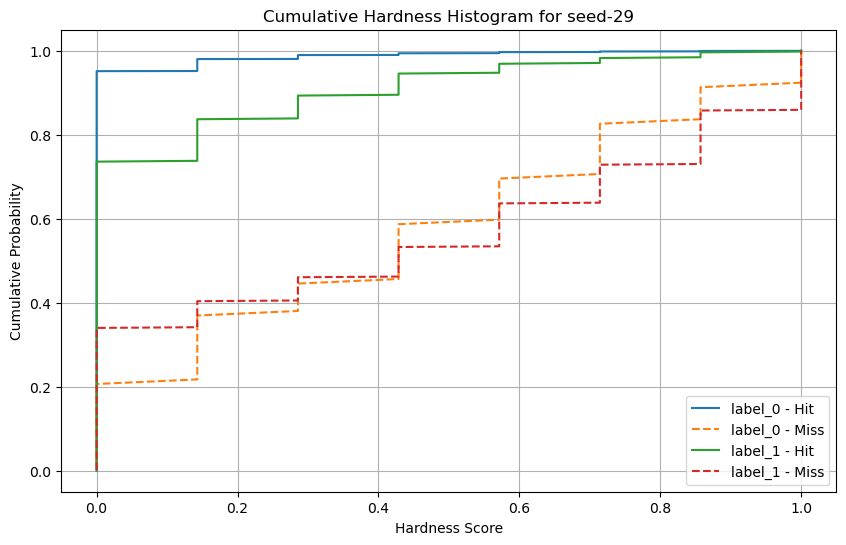

Processando pasta: Knn
Hardness médio para seed-0: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_1.joblib


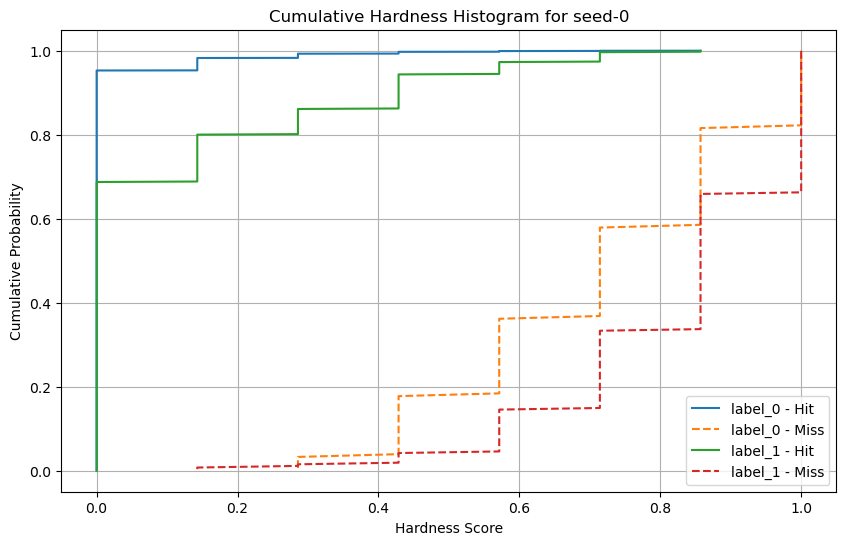

Hardness médio para seed-1: 0.0252
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_2.joblib


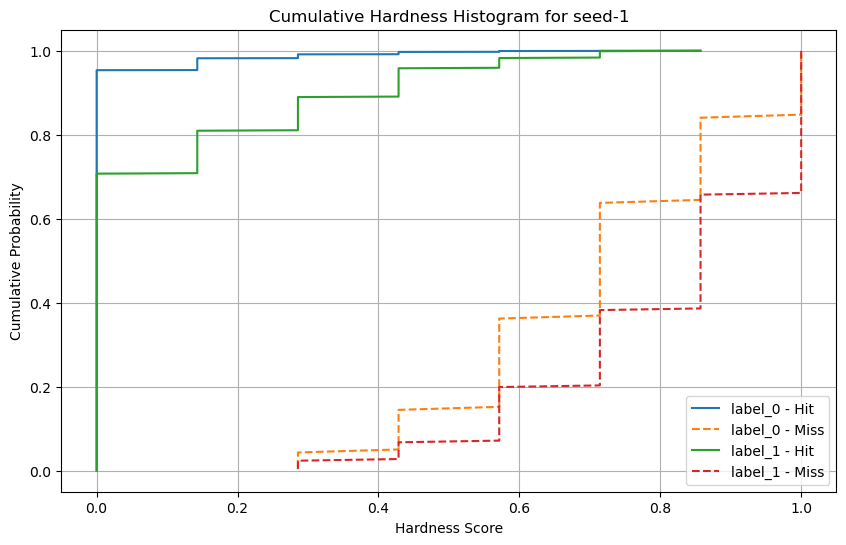

Hardness médio para seed-2: 0.0258
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_3.joblib


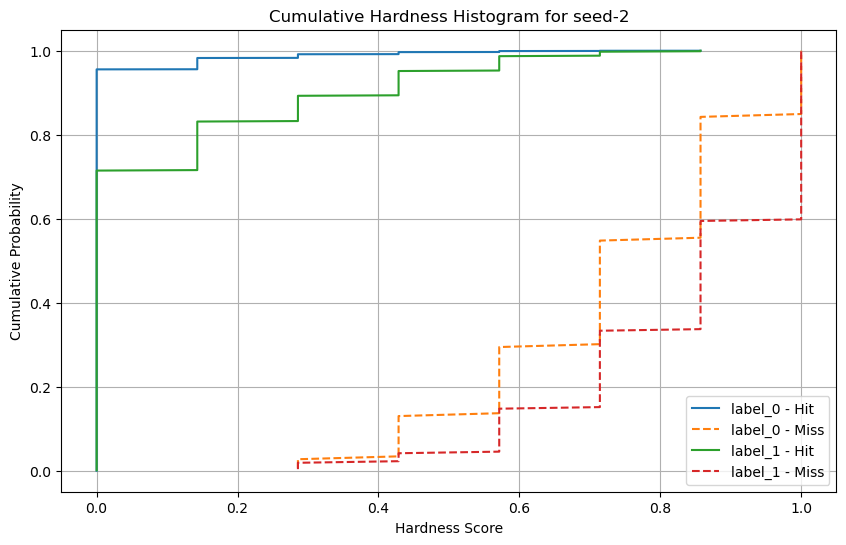

Hardness médio para seed-3: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_4.joblib


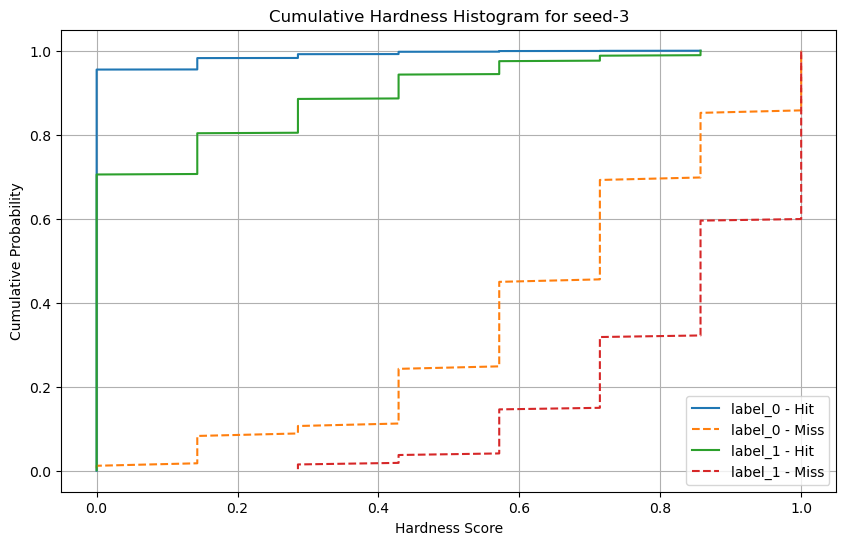

Hardness médio para seed-4: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_5.joblib


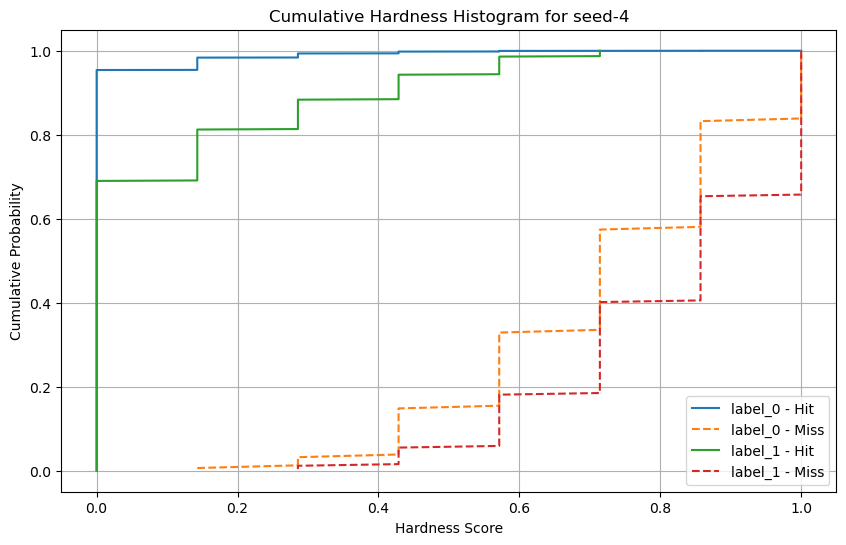

Hardness médio para seed-5: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_6.joblib


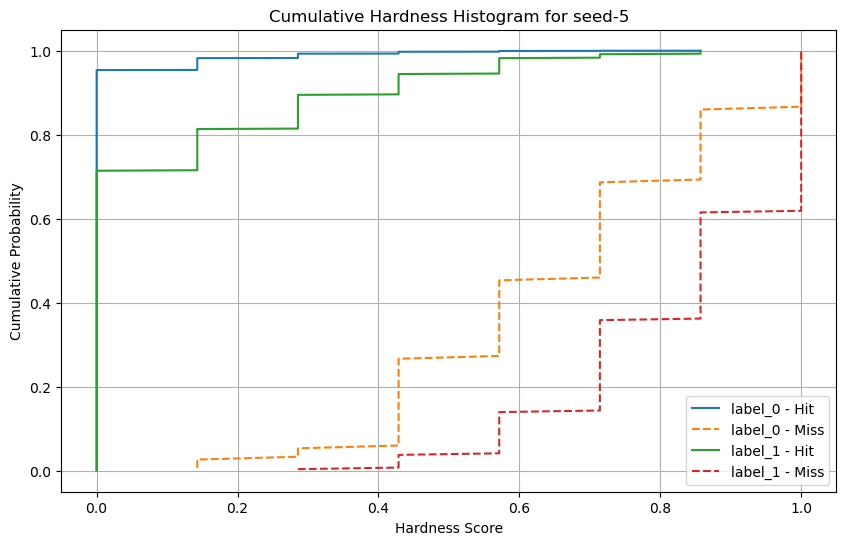

Hardness médio para seed-6: 0.0272
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_7.joblib


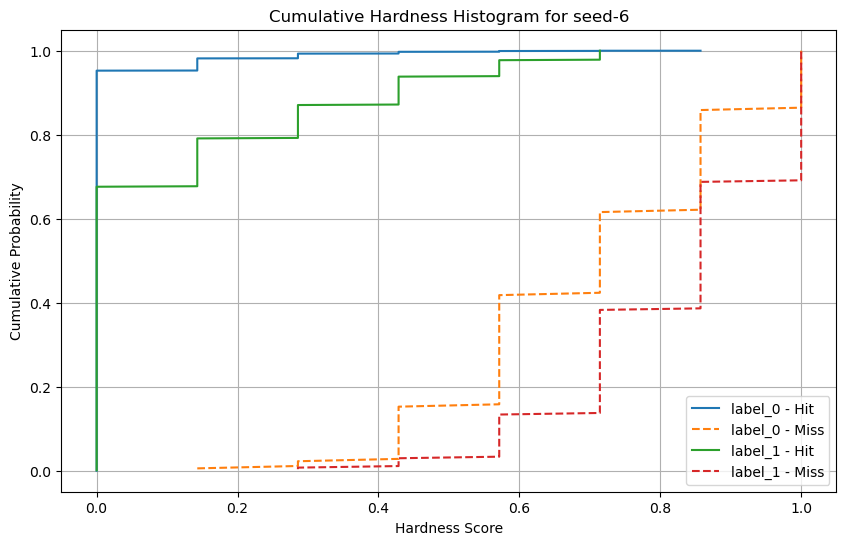

Hardness médio para seed-7: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_8.joblib


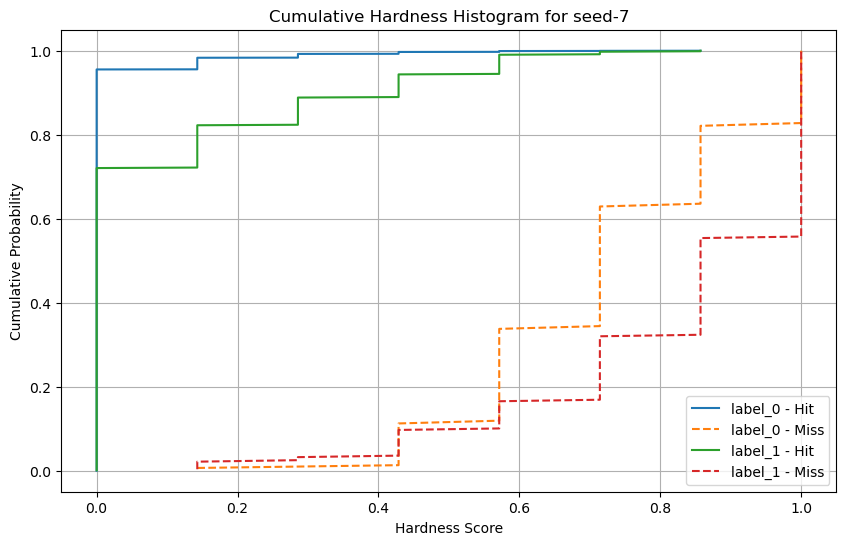

Hardness médio para seed-8: 0.0253
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_9.joblib


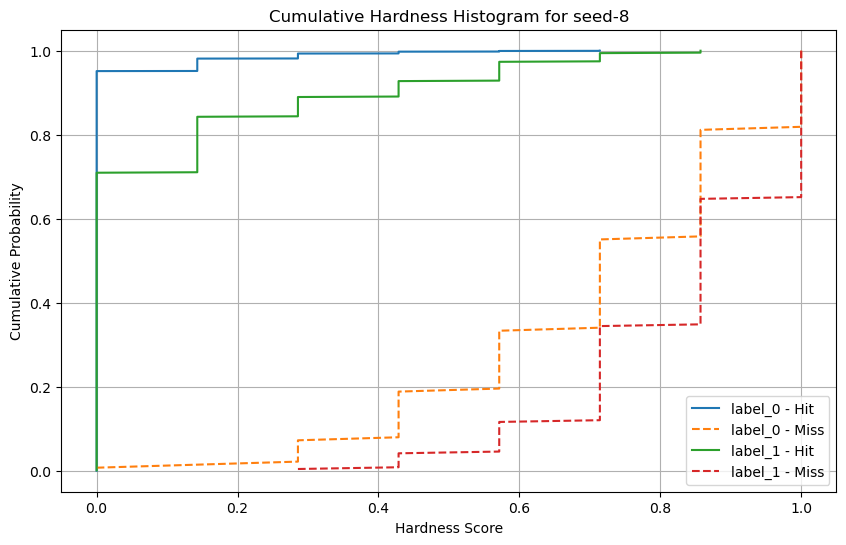

Hardness médio para seed-9: 0.0268
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_10.joblib


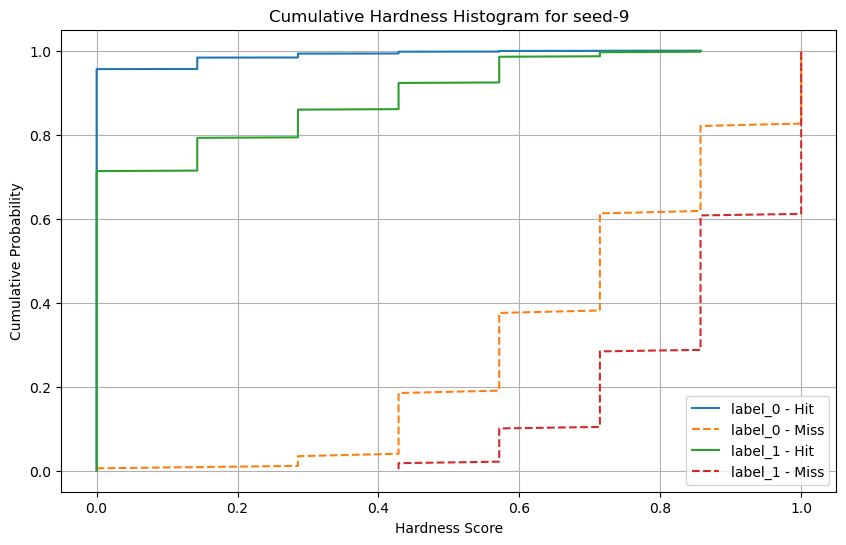

Hardness médio para seed-10: 0.0262
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_11.joblib


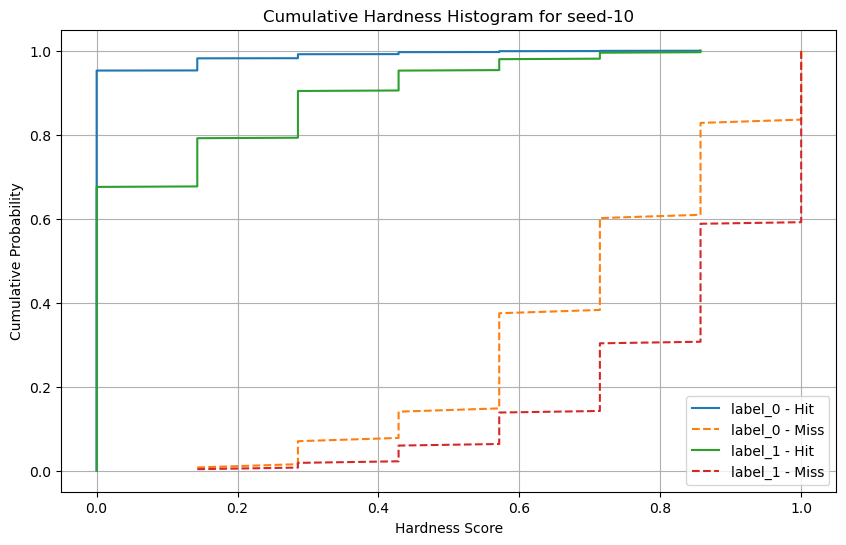

Hardness médio para seed-11: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_12.joblib


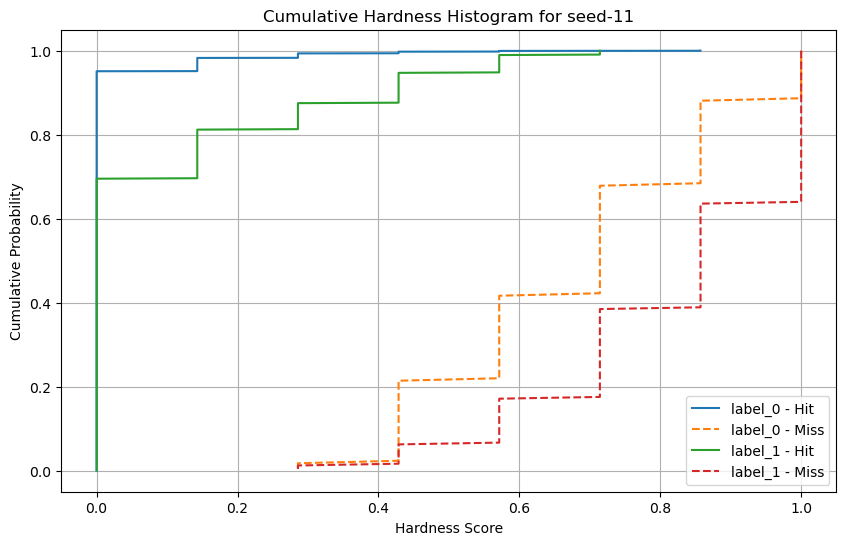

Hardness médio para seed-12: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_13.joblib


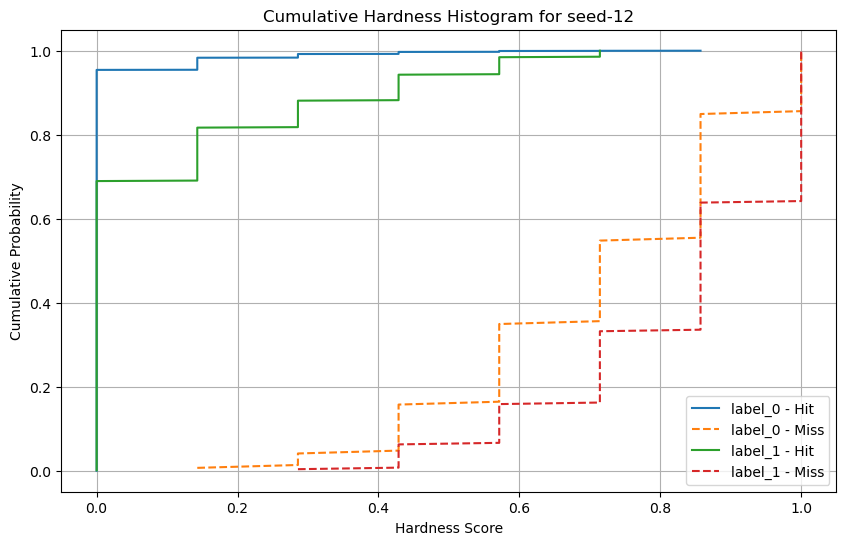

Hardness médio para seed-13: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_14.joblib


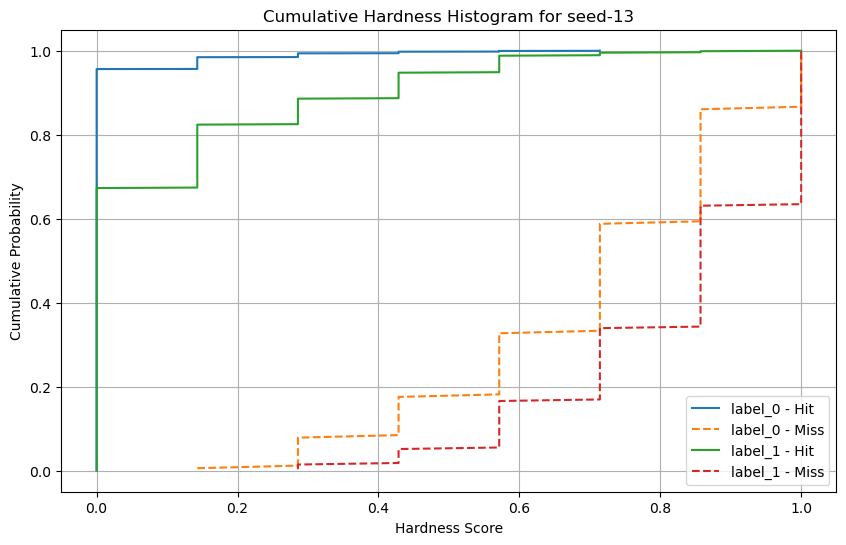

Hardness médio para seed-14: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_15.joblib


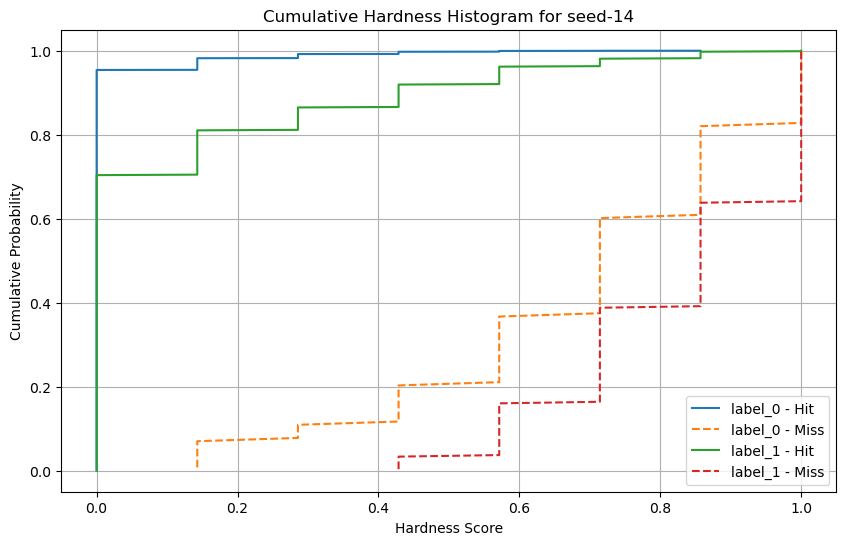

Hardness médio para seed-15: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_16.joblib


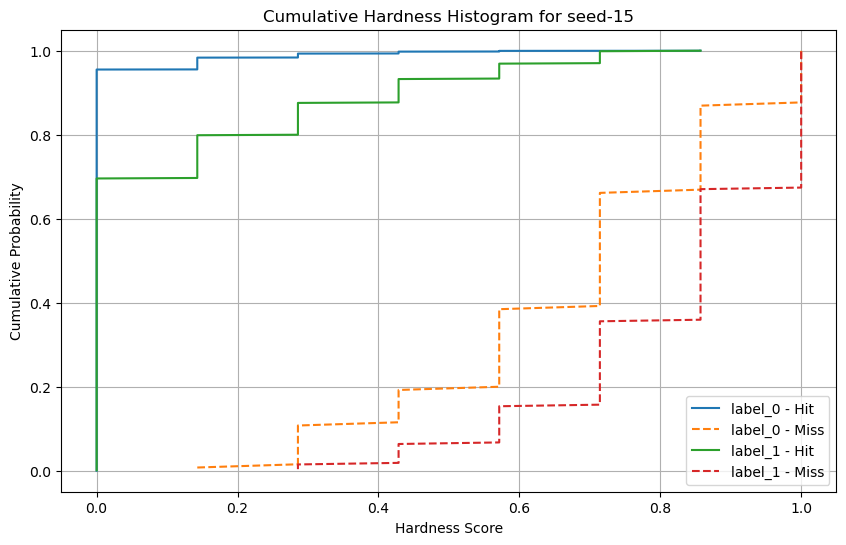

Hardness médio para seed-16: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_17.joblib


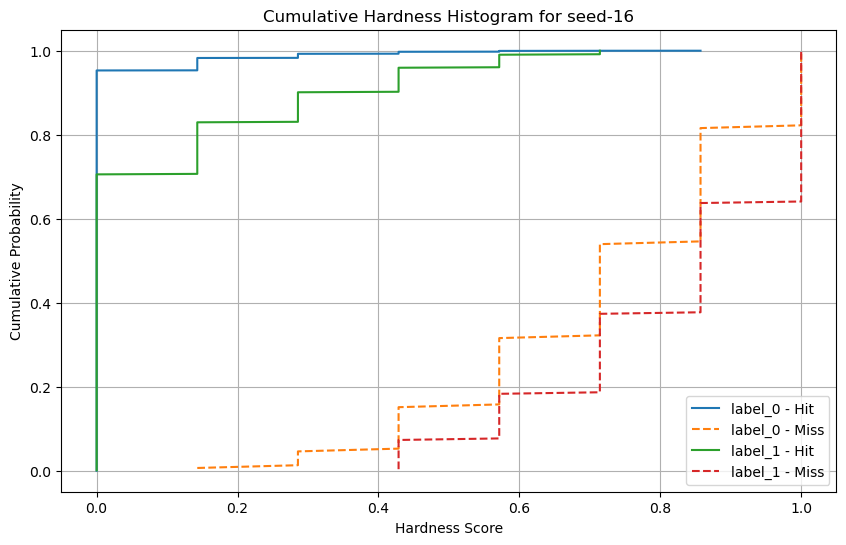

Hardness médio para seed-17: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_18.joblib


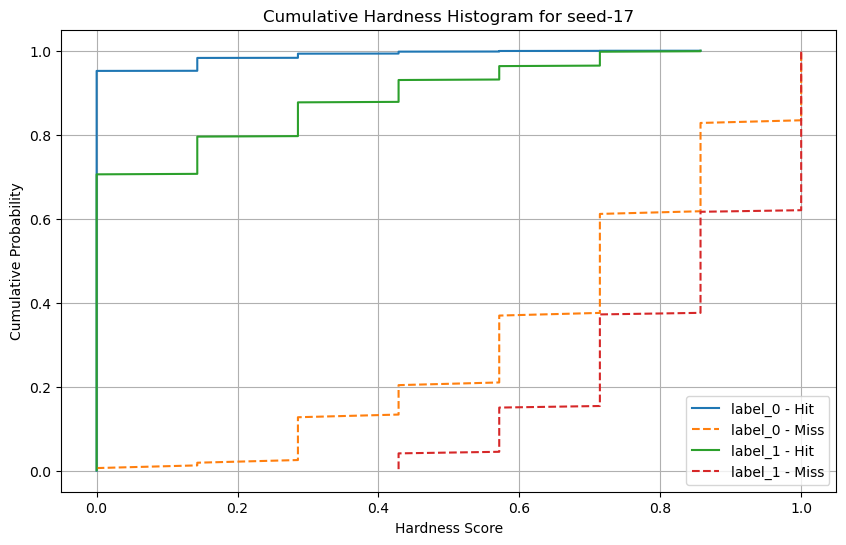

Hardness médio para seed-18: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_19.joblib


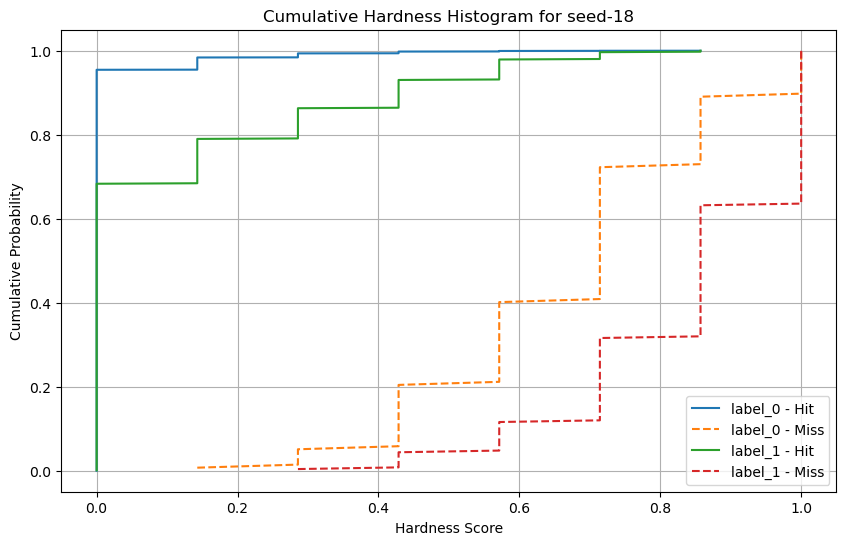

Hardness médio para seed-19: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_20.joblib


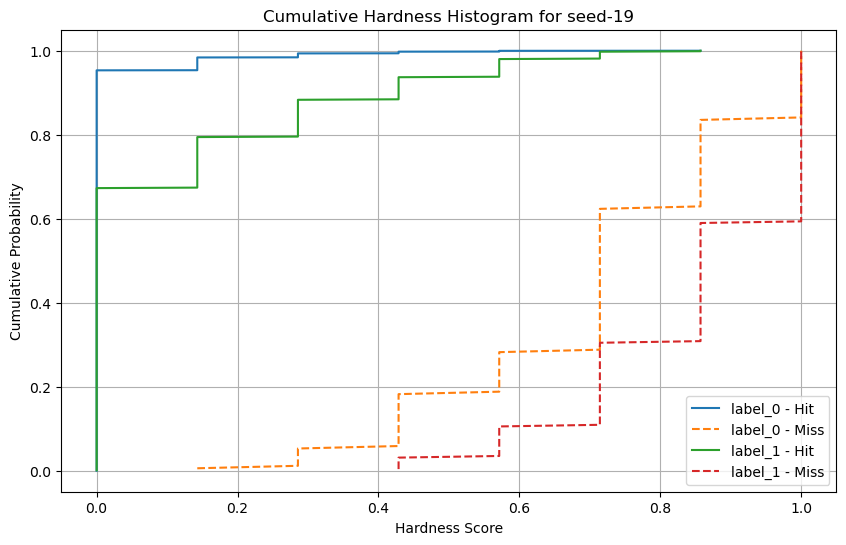

Hardness médio para seed-20: 0.0250
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_21.joblib


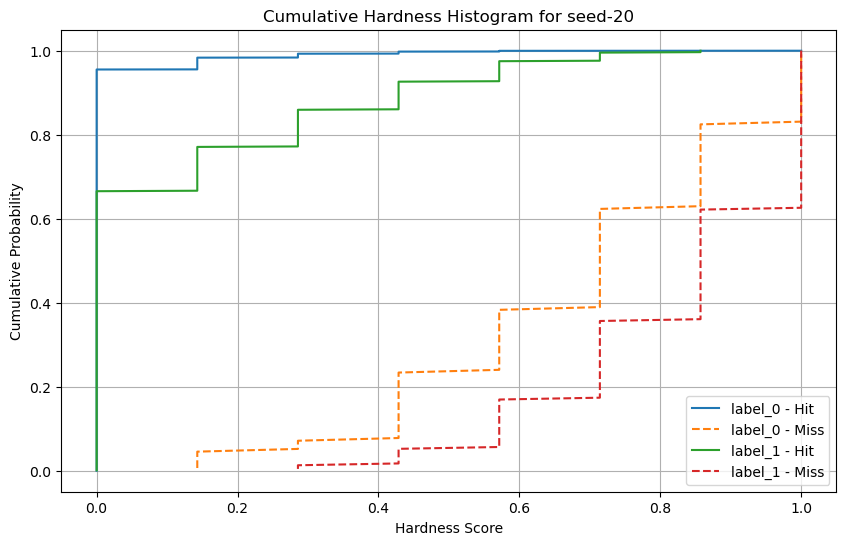

Hardness médio para seed-21: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_22.joblib


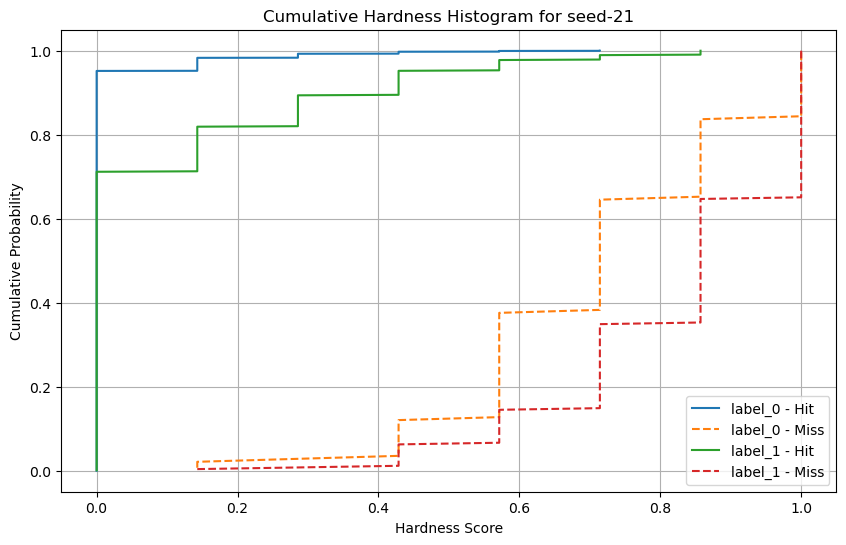

Hardness médio para seed-22: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_23.joblib


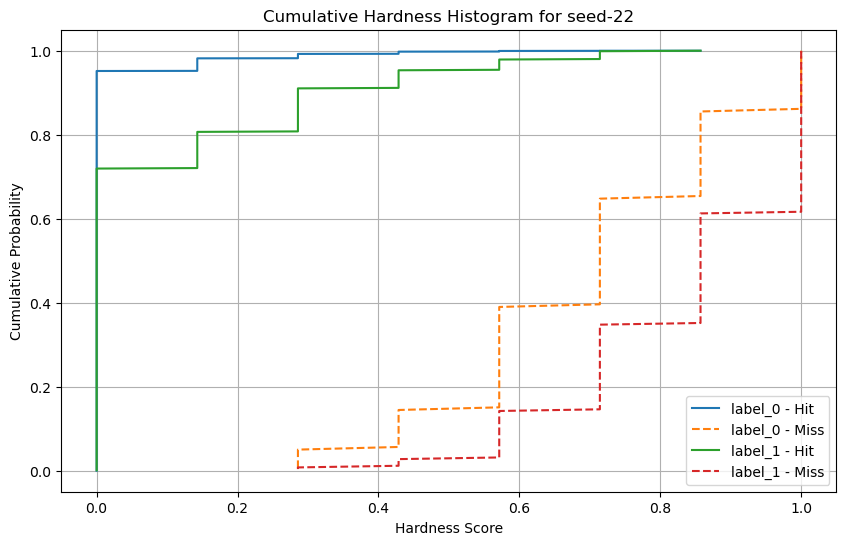

Hardness médio para seed-23: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_24.joblib


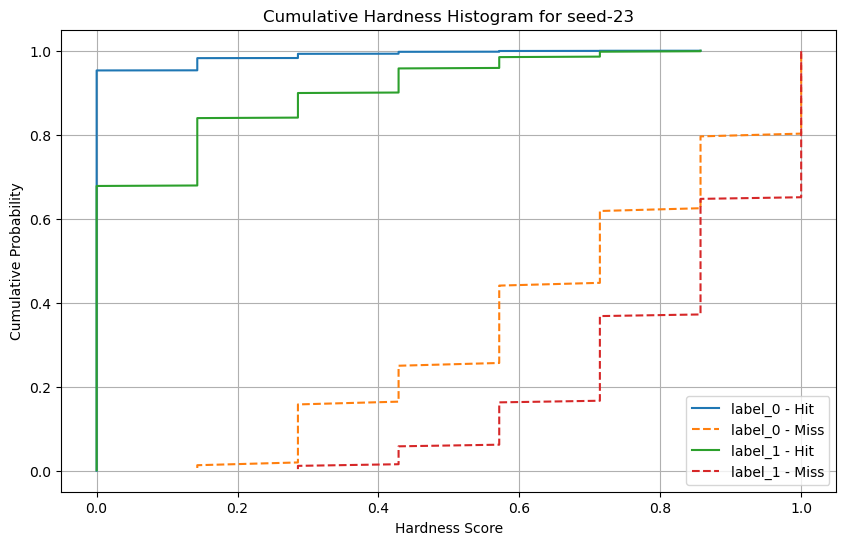

Hardness médio para seed-24: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_25.joblib


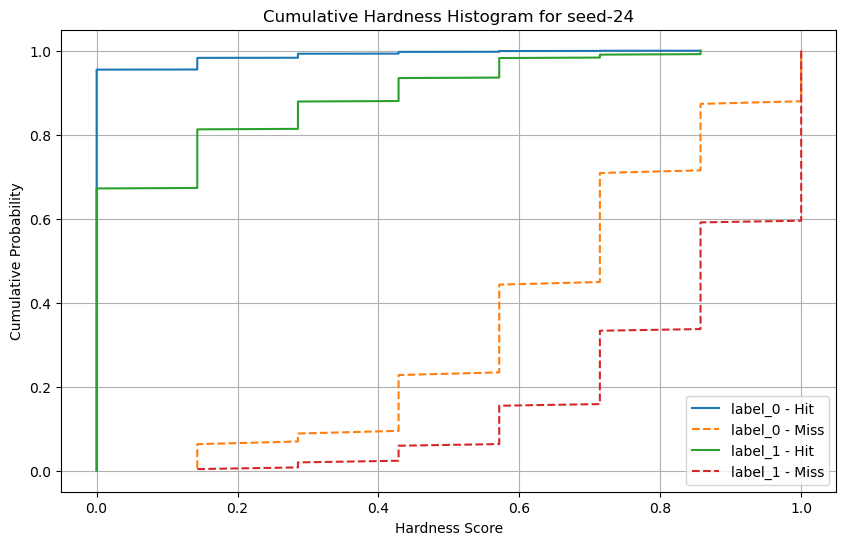

Hardness médio para seed-25: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_26.joblib


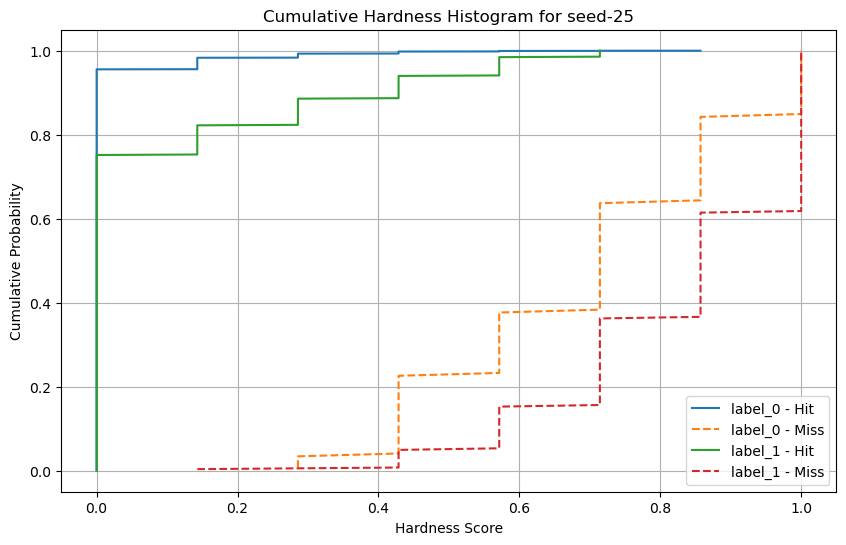

Hardness médio para seed-26: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_27.joblib


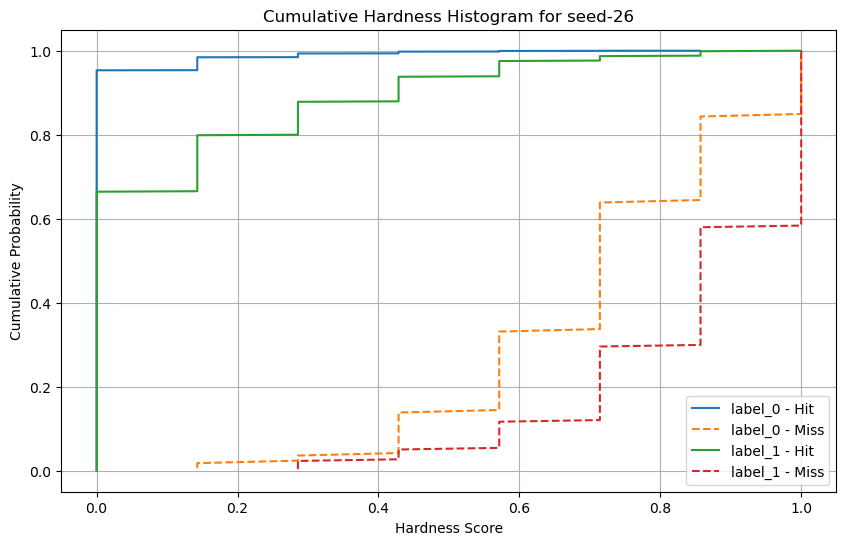

Hardness médio para seed-27: 0.0248
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_28.joblib


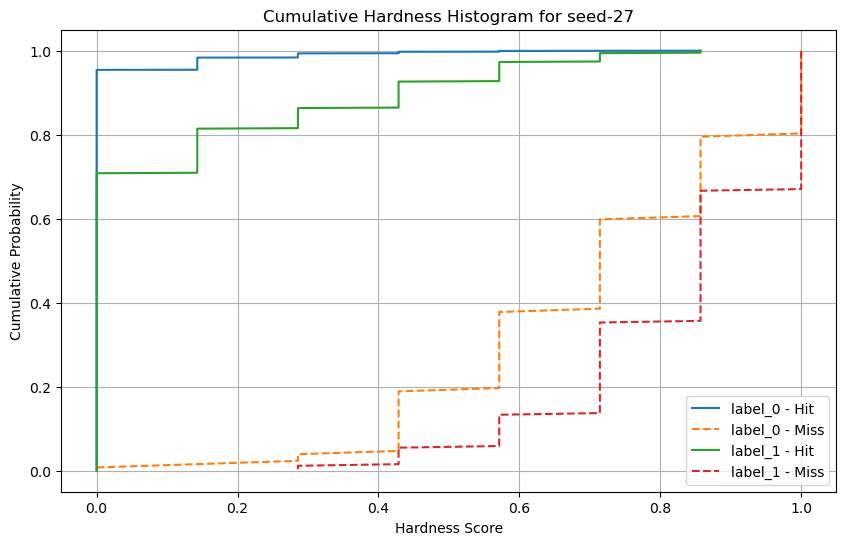

Hardness médio para seed-28: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_29.joblib


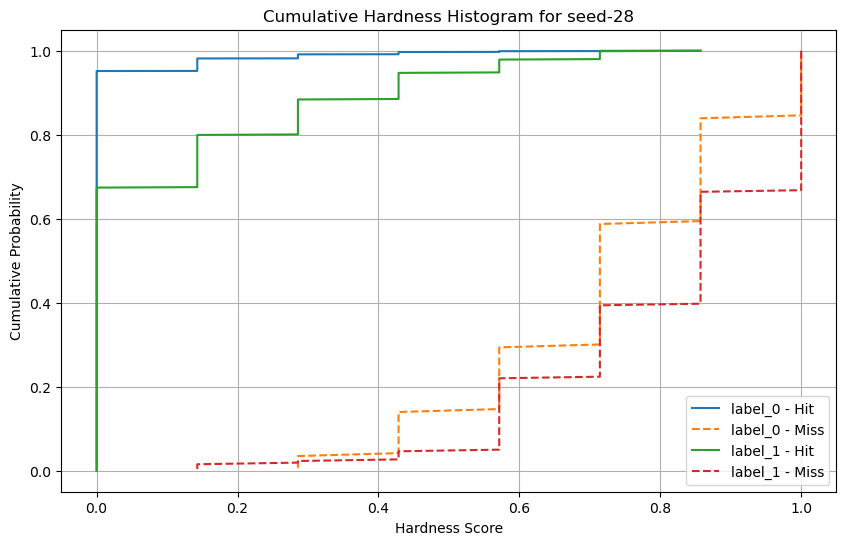

Hardness médio para seed-29: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\Knn\model_30.joblib


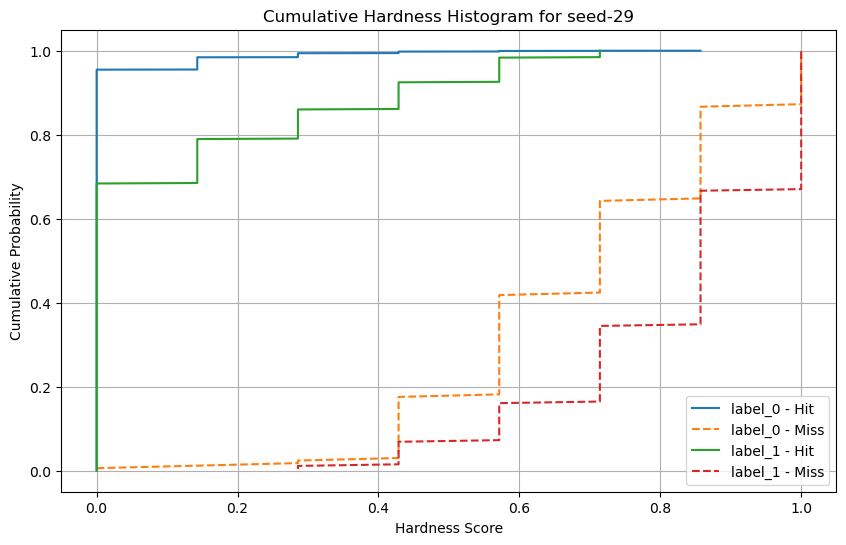

Processando pasta: MLP
Hardness médio para seed-0: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_1.joblib


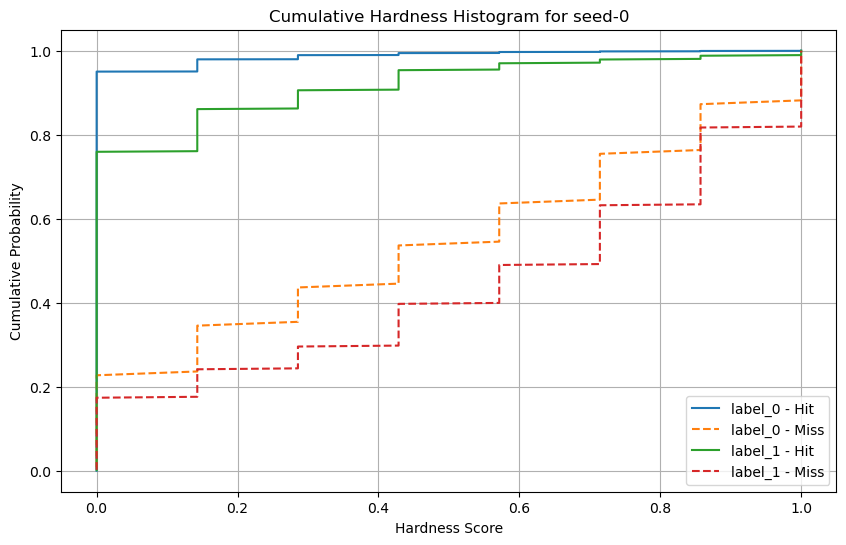

Hardness médio para seed-1: 0.0252
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_2.joblib


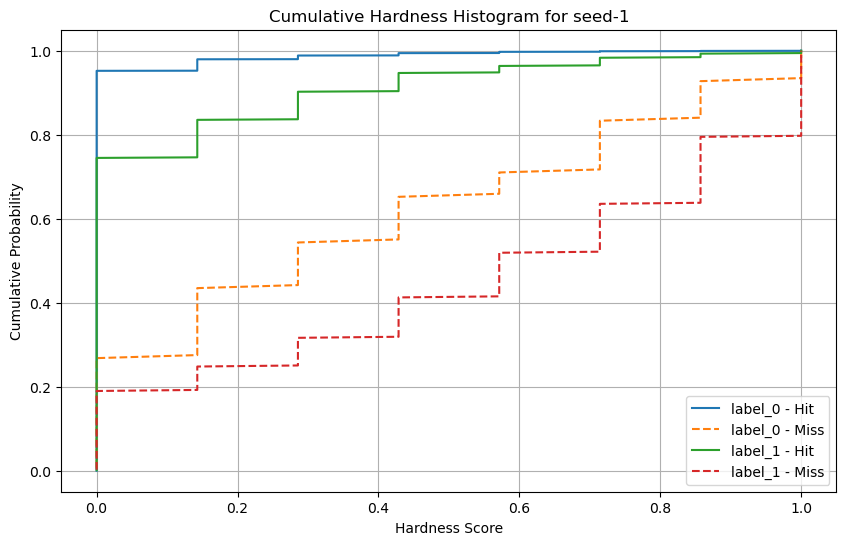

Hardness médio para seed-2: 0.0258
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_3.joblib


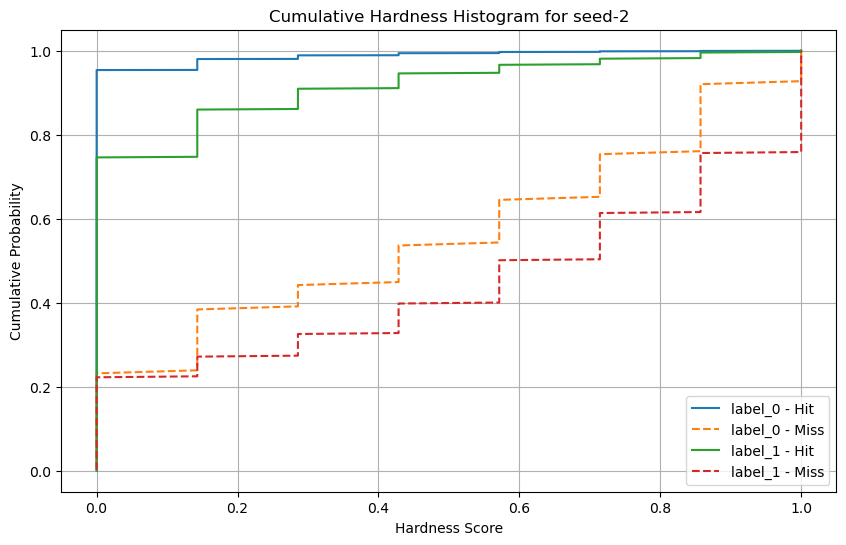

Hardness médio para seed-3: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_4.joblib


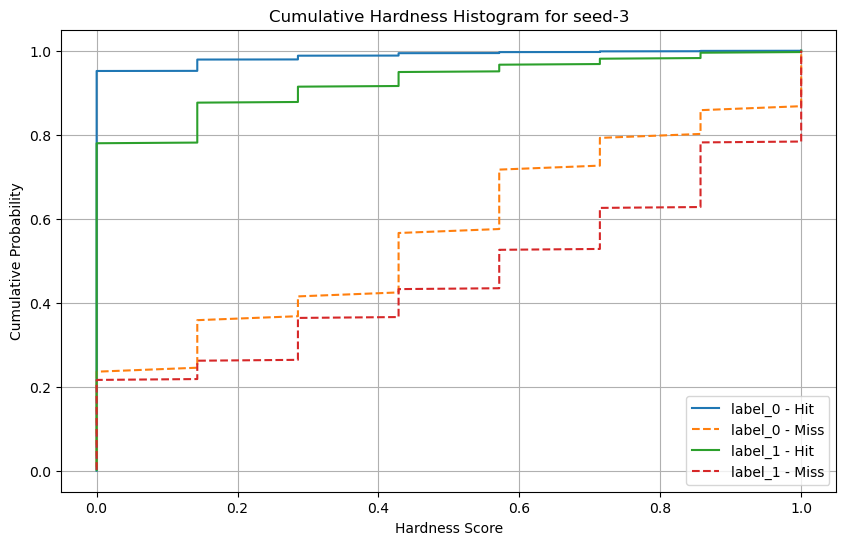

Hardness médio para seed-4: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_5.joblib


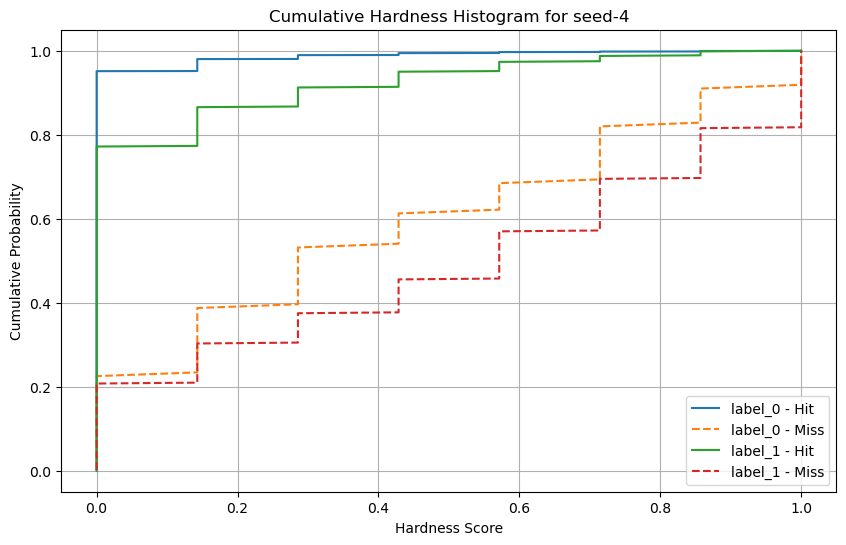

Hardness médio para seed-5: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_6.joblib


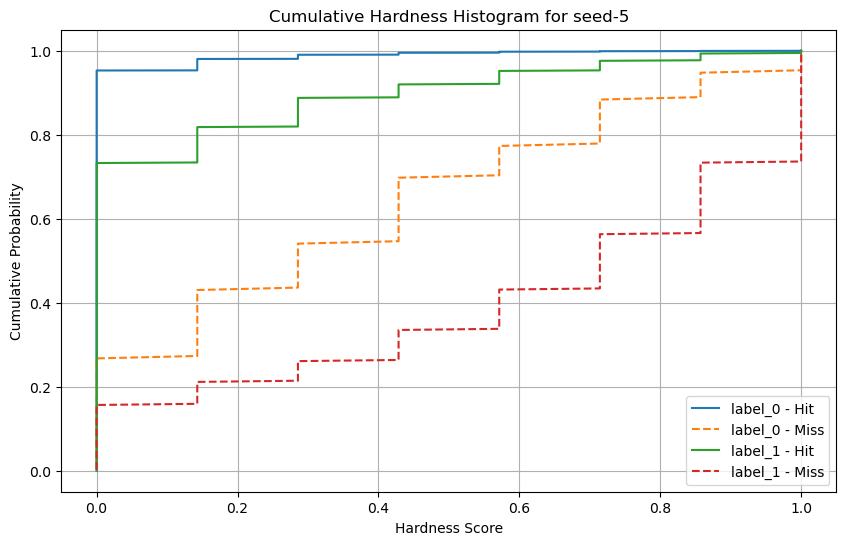

Hardness médio para seed-6: 0.0272
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_7.joblib


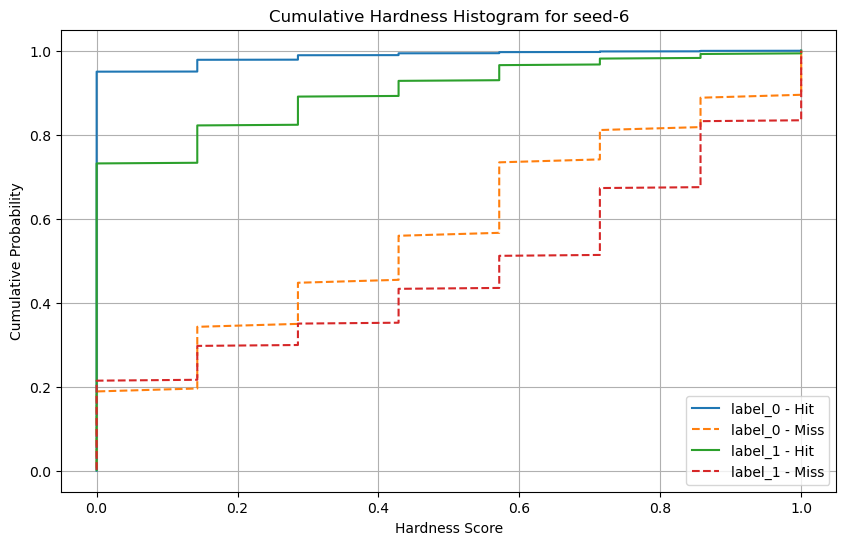

Hardness médio para seed-7: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_8.joblib


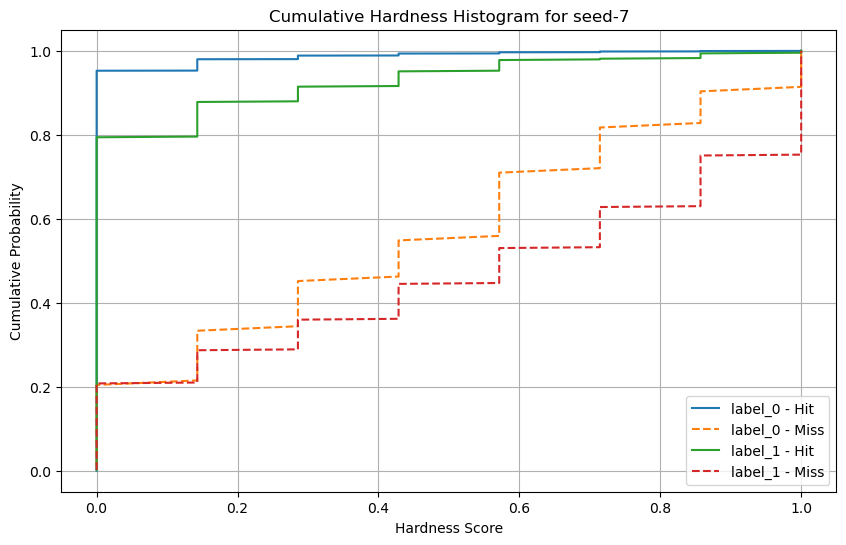

Hardness médio para seed-8: 0.0253
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_9.joblib


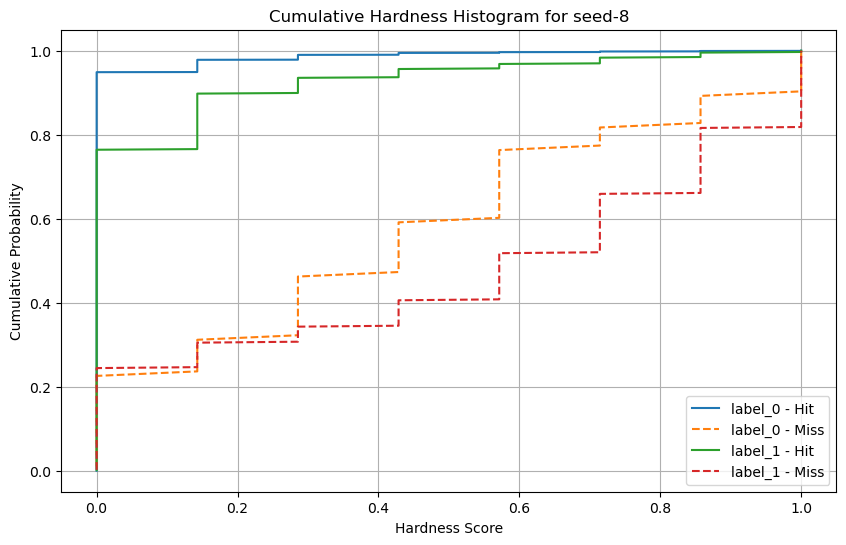

Hardness médio para seed-9: 0.0268
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_10.joblib


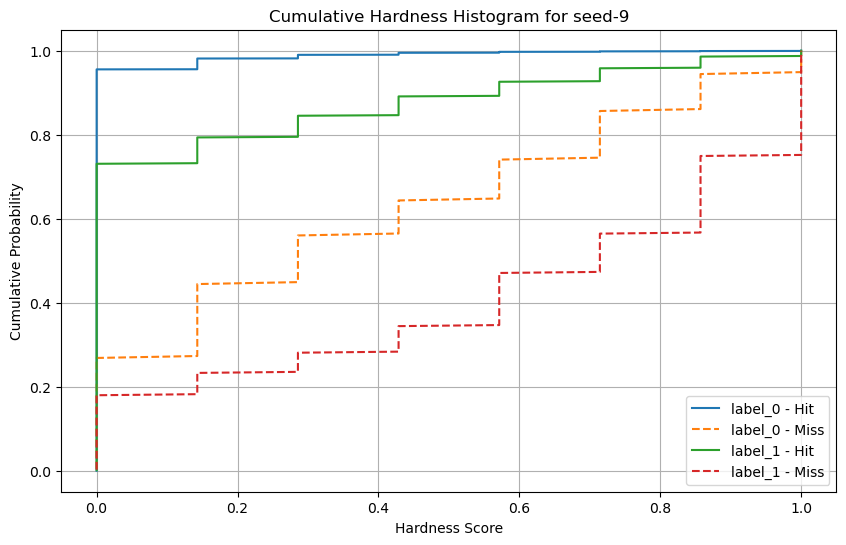

Hardness médio para seed-10: 0.0262
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_11.joblib


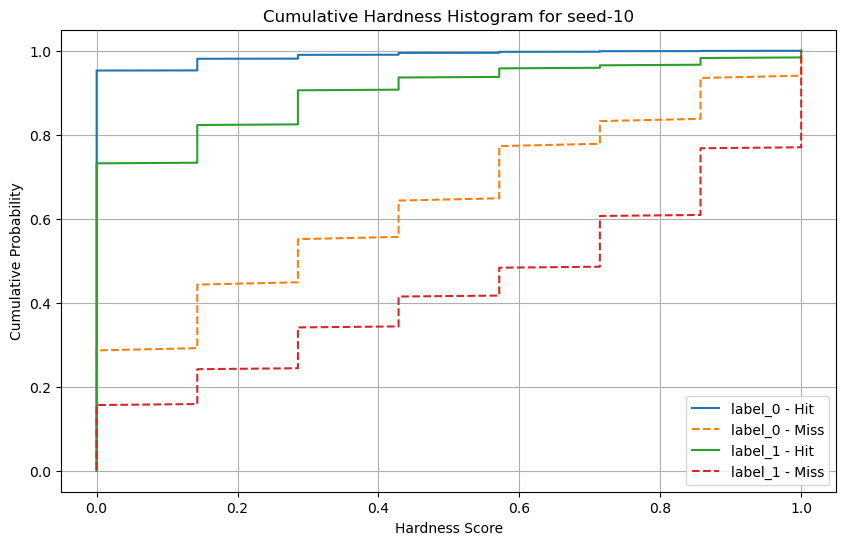

Hardness médio para seed-11: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_12.joblib


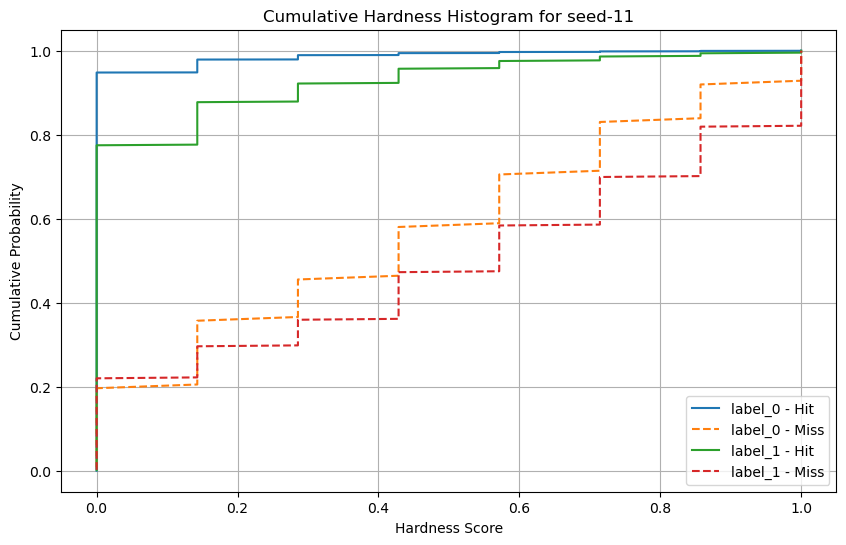

Hardness médio para seed-12: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_13.joblib


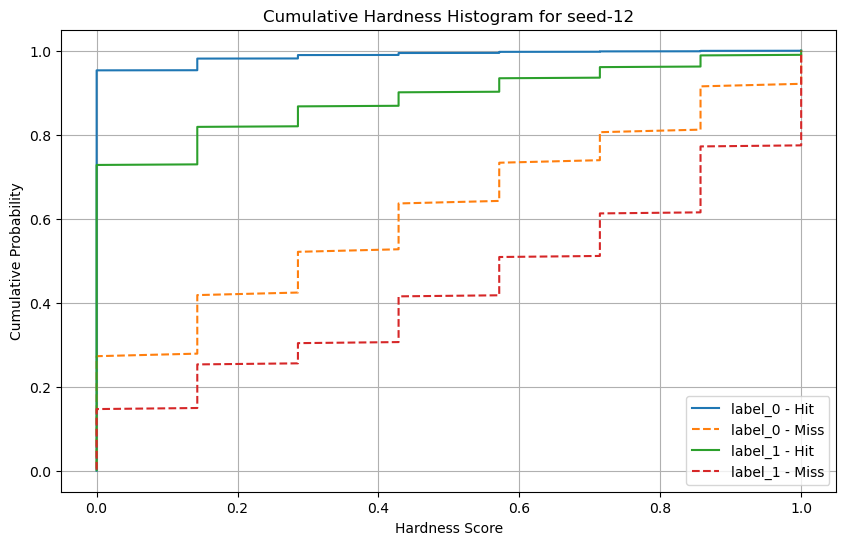

Hardness médio para seed-13: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_14.joblib


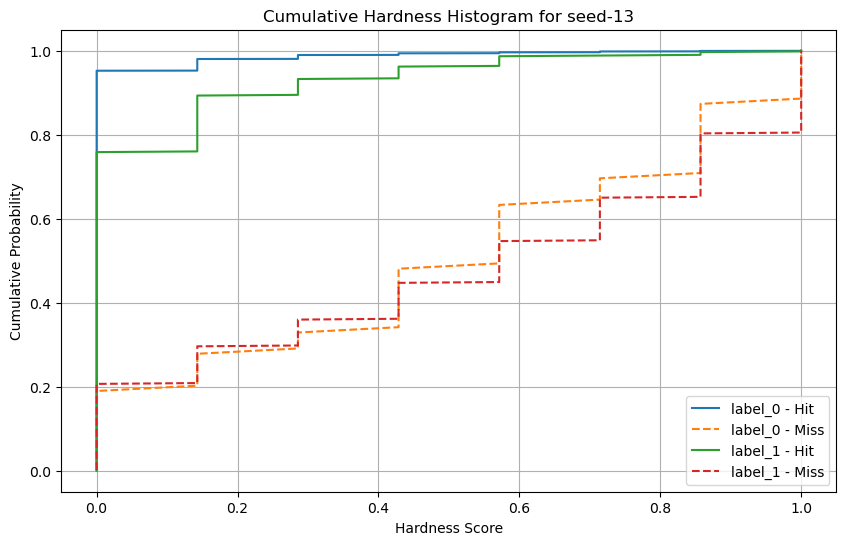

Hardness médio para seed-14: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_15.joblib


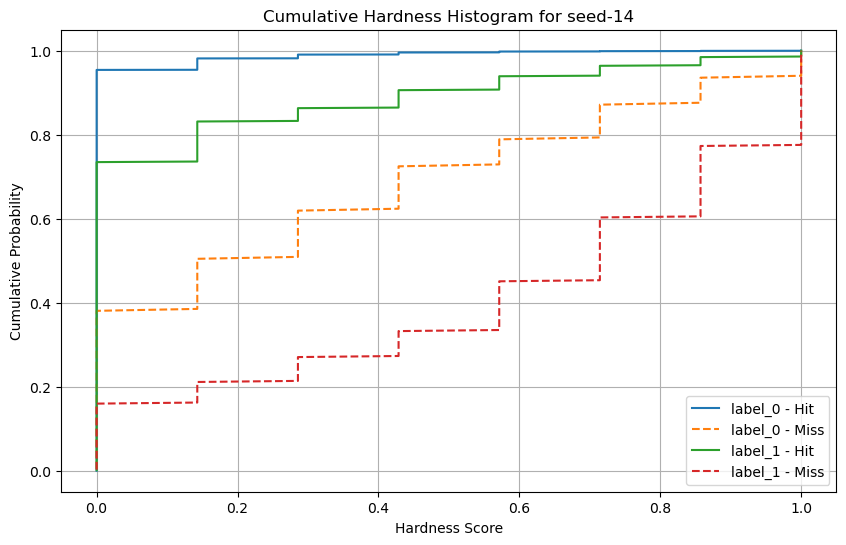

Hardness médio para seed-15: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_16.joblib


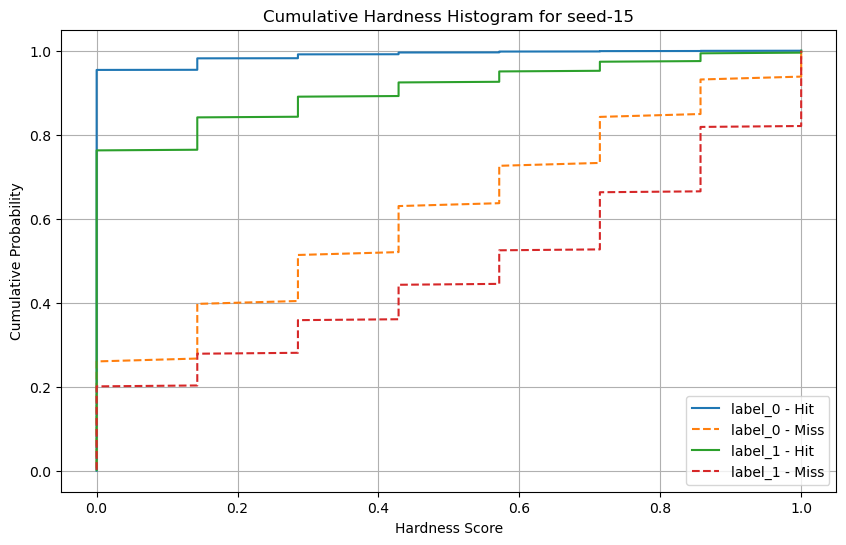

Hardness médio para seed-16: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_17.joblib


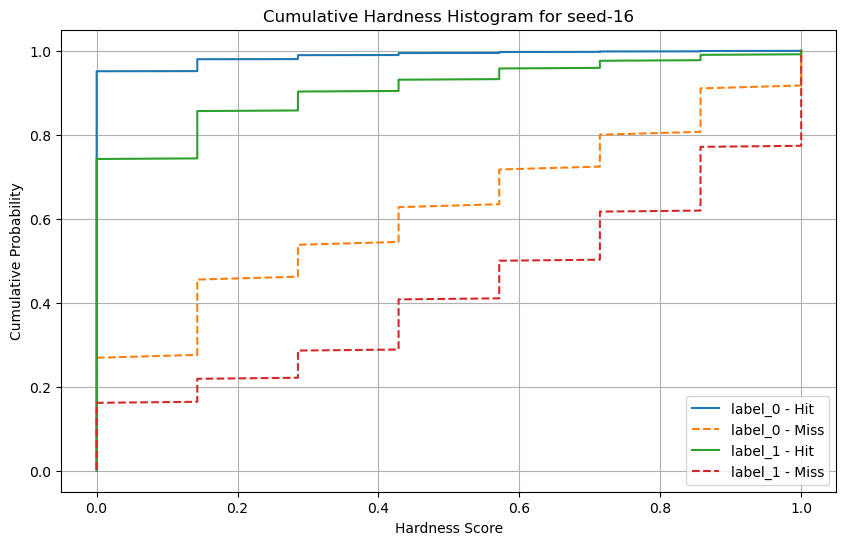

Hardness médio para seed-17: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_18.joblib


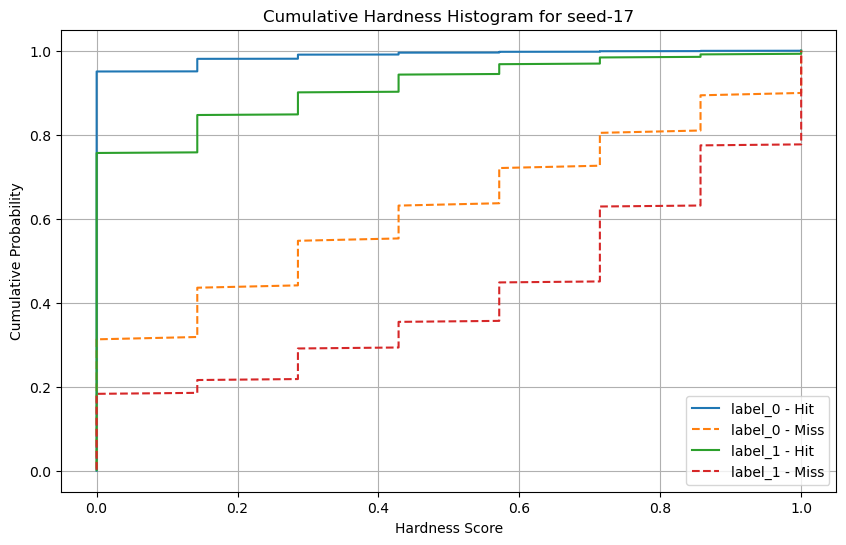

Hardness médio para seed-18: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_19.joblib


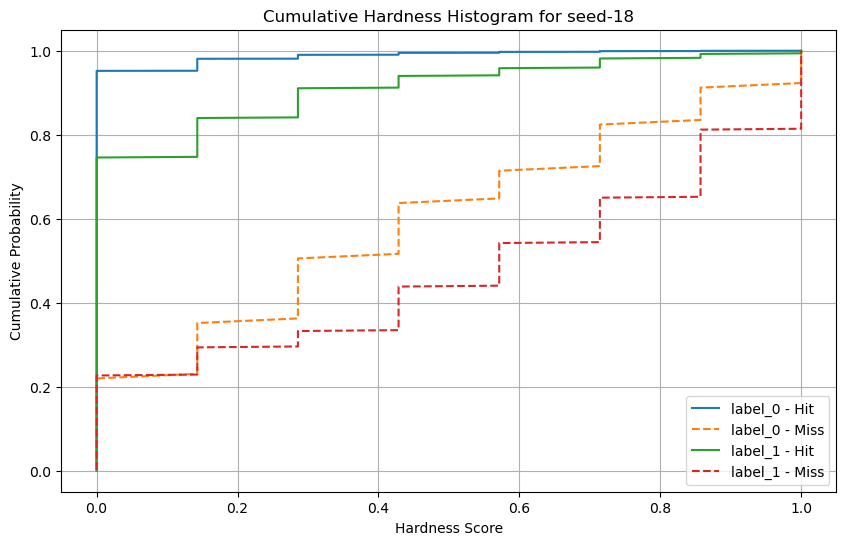

Hardness médio para seed-19: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_20.joblib


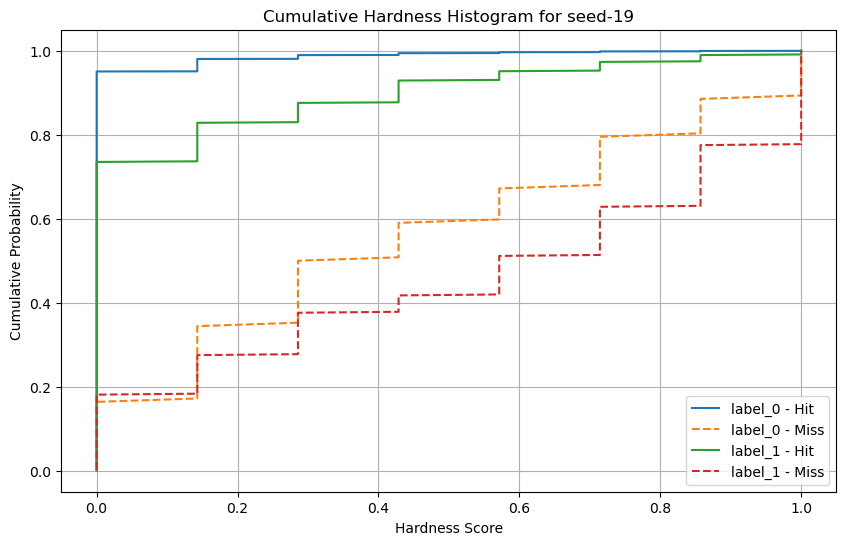

Hardness médio para seed-20: 0.0250
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_21.joblib


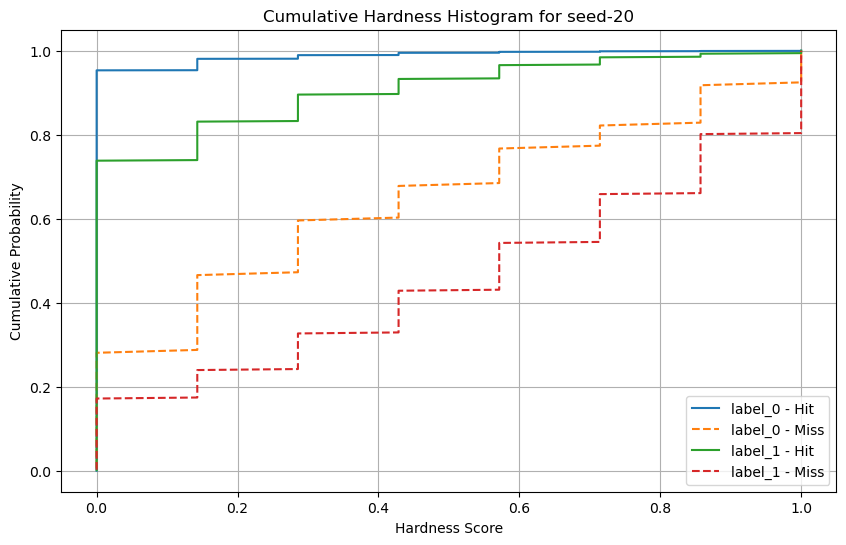

Hardness médio para seed-21: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_22.joblib


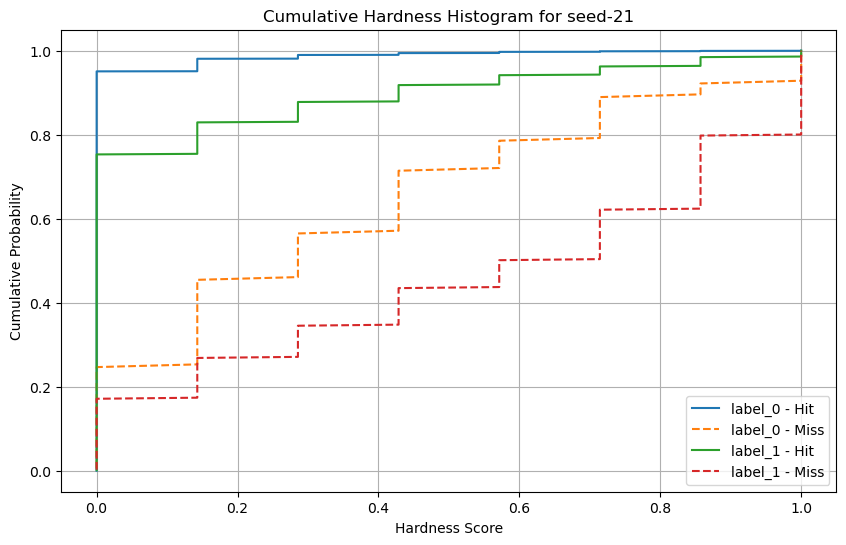

Hardness médio para seed-22: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_23.joblib


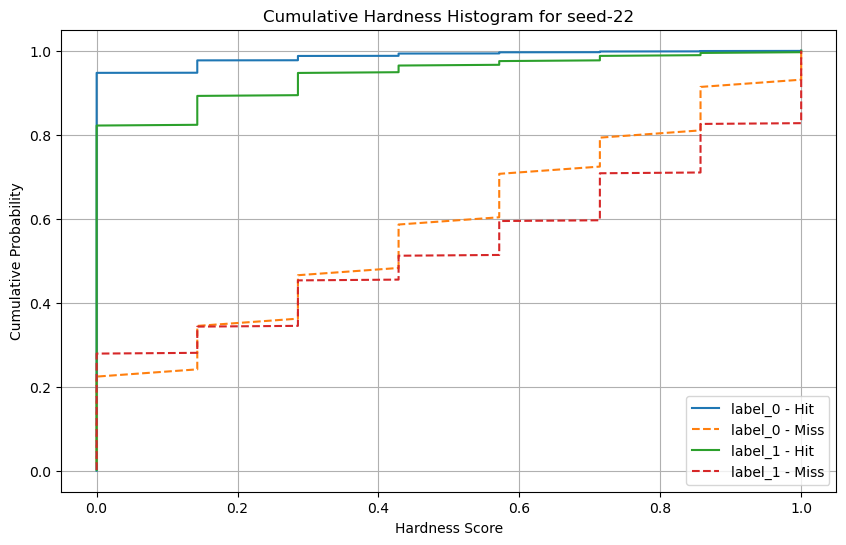

Hardness médio para seed-23: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_24.joblib


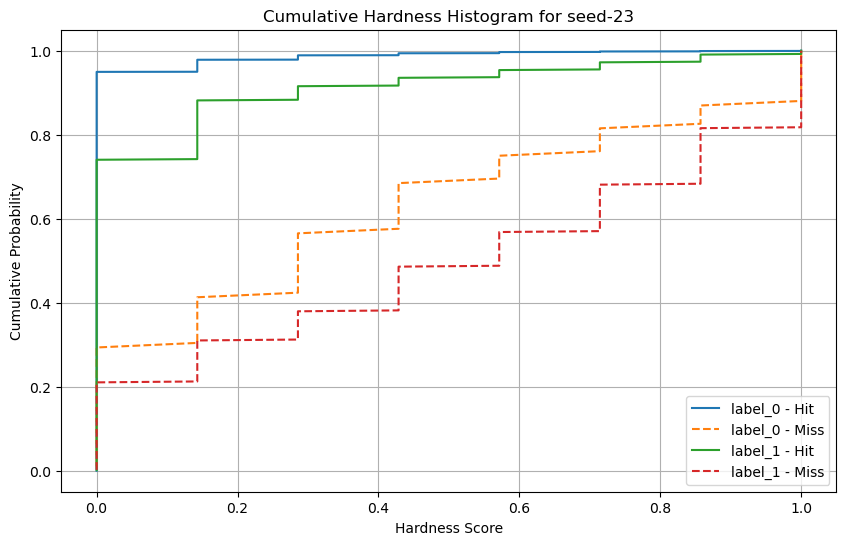

Hardness médio para seed-24: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_25.joblib


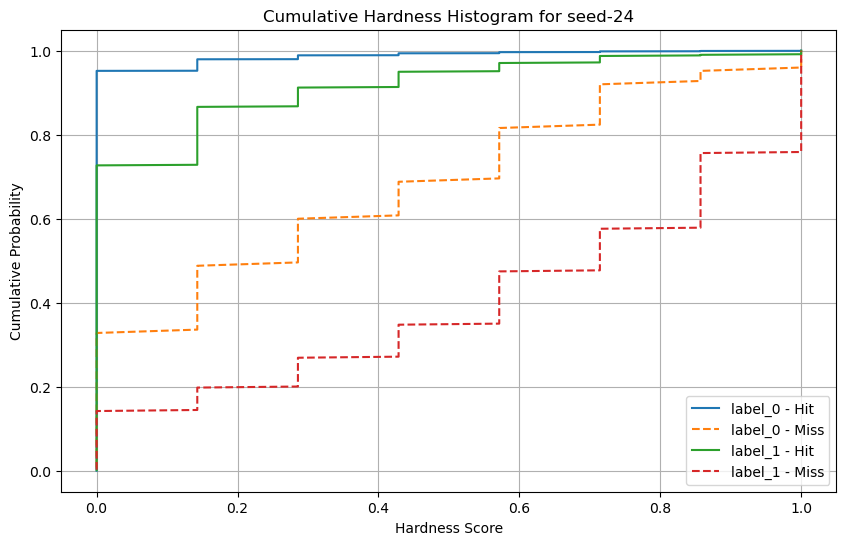

Hardness médio para seed-25: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_26.joblib


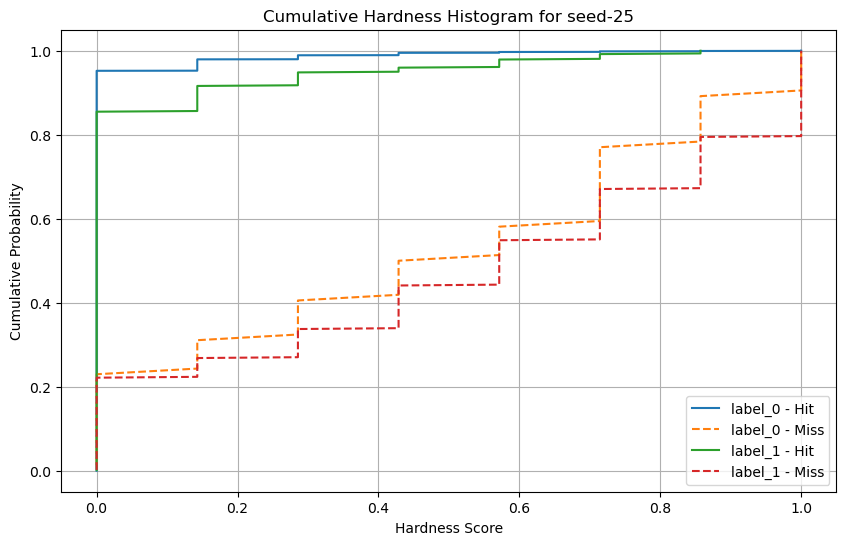

Hardness médio para seed-26: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_27.joblib


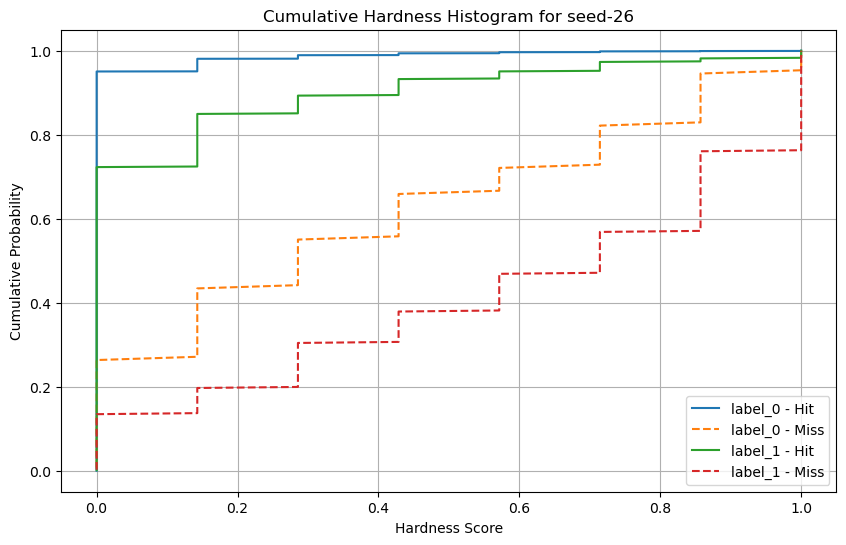

Hardness médio para seed-27: 0.0248
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_28.joblib


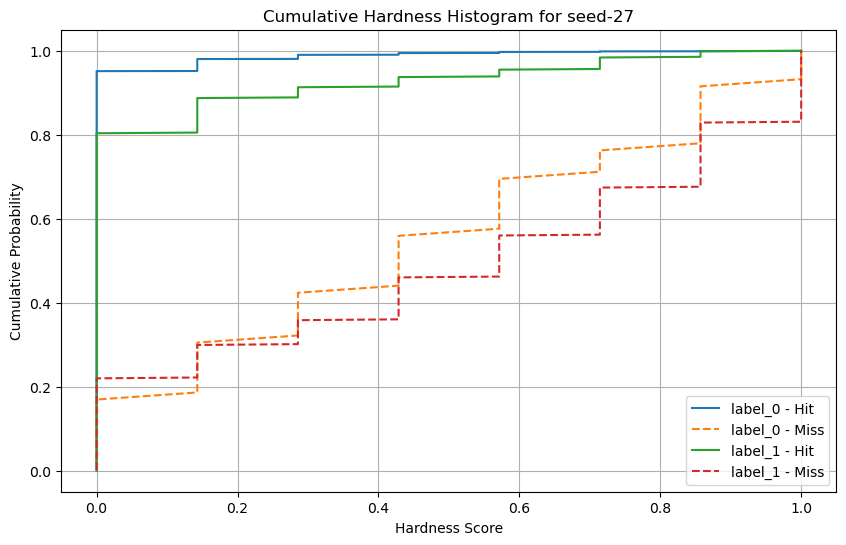

Hardness médio para seed-28: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_29.joblib


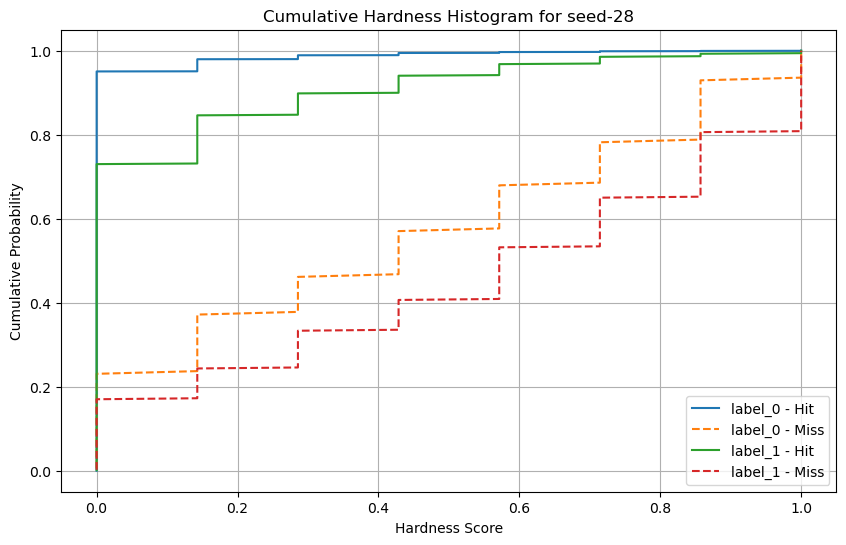

Hardness médio para seed-29: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\MLP\model_30.joblib


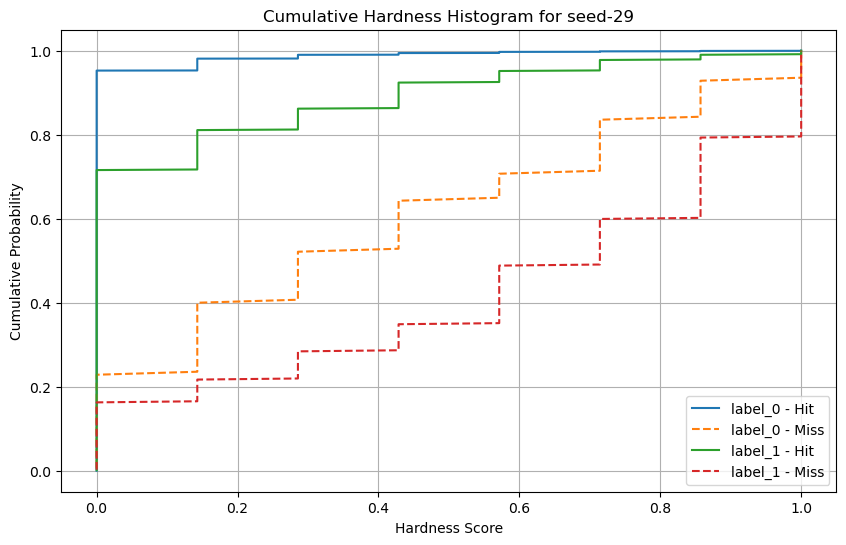

Processando pasta: NaiveBayes
Hardness médio para seed-0: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_1.joblib


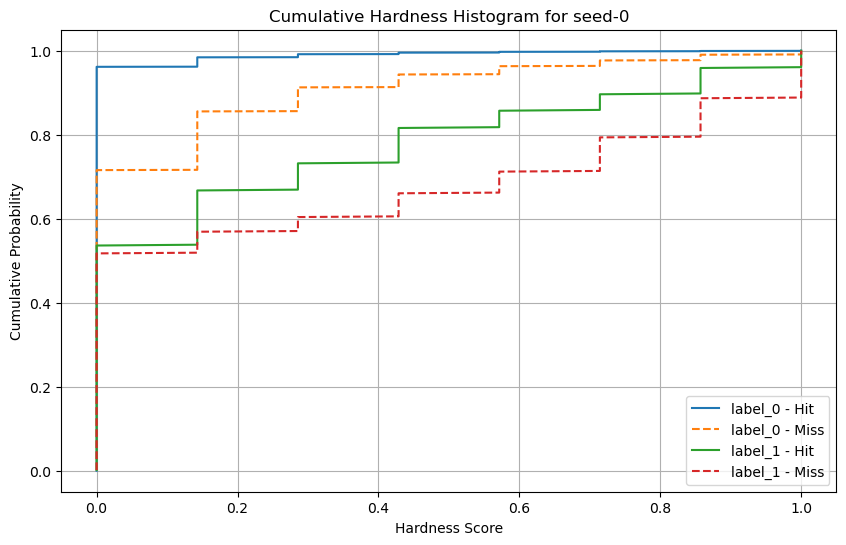

Hardness médio para seed-1: 0.0252
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_2.joblib


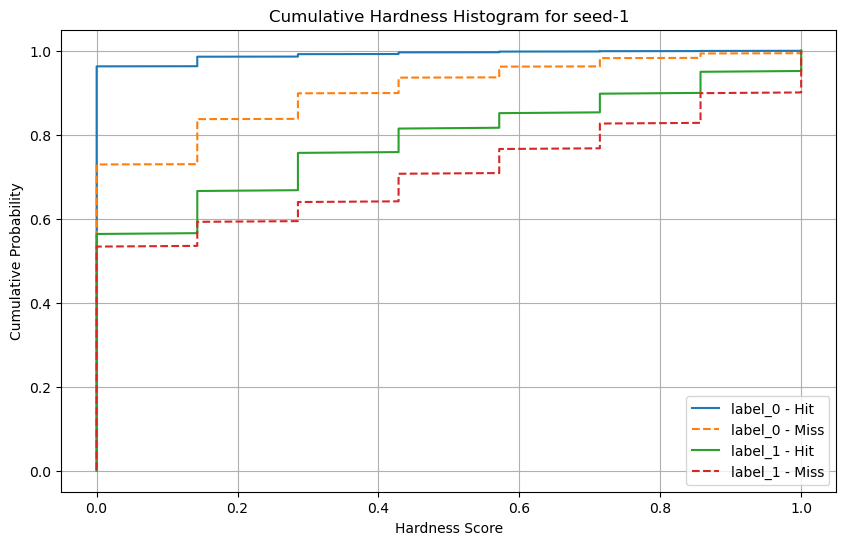

Hardness médio para seed-2: 0.0258
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_3.joblib


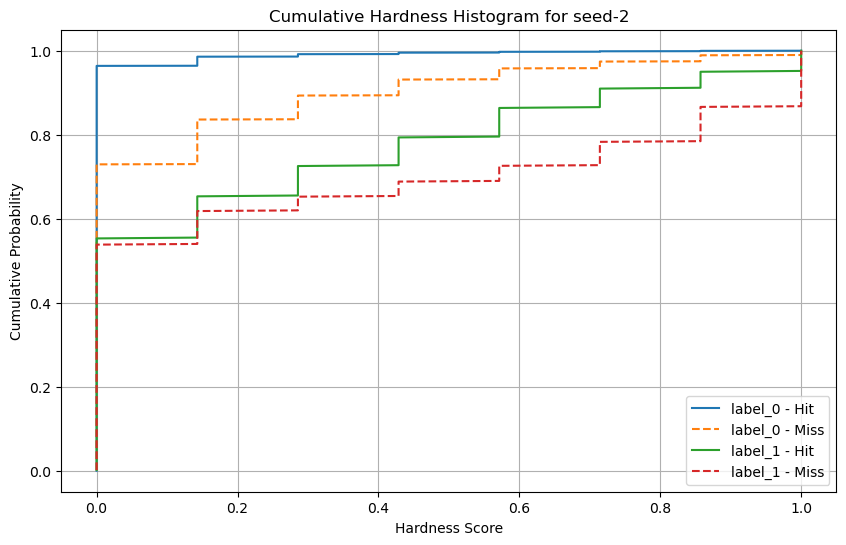

Hardness médio para seed-3: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_4.joblib


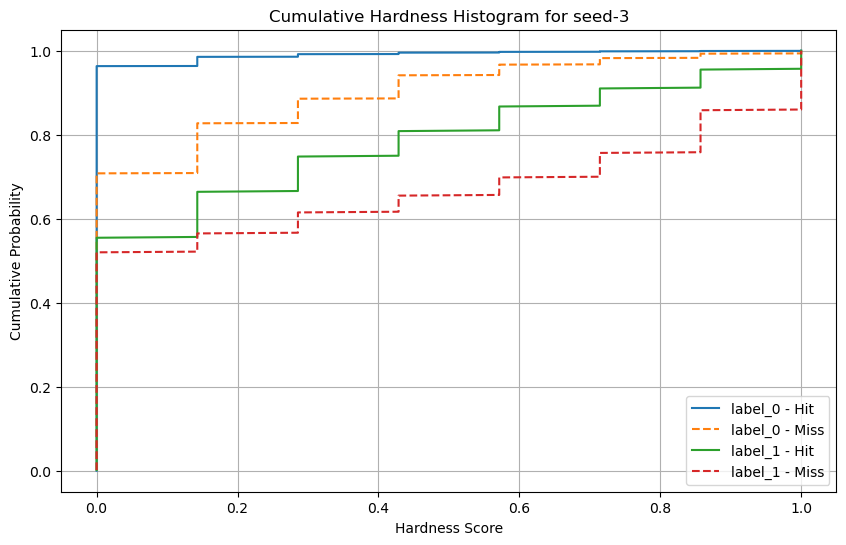

Hardness médio para seed-4: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_5.joblib


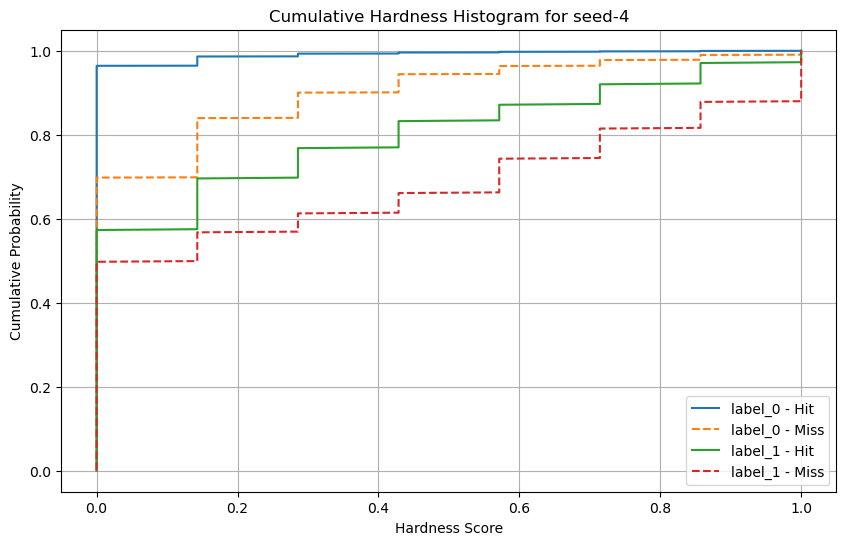

Hardness médio para seed-5: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_6.joblib


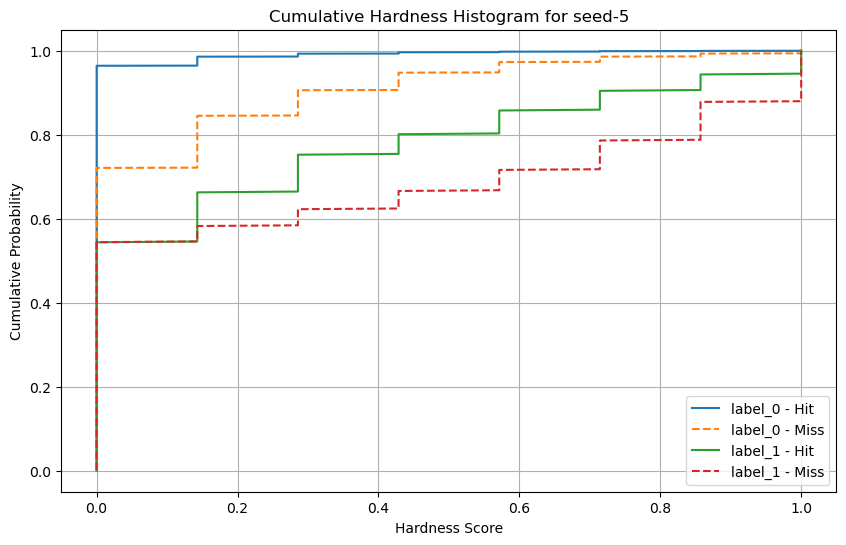

Hardness médio para seed-6: 0.0272
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_7.joblib


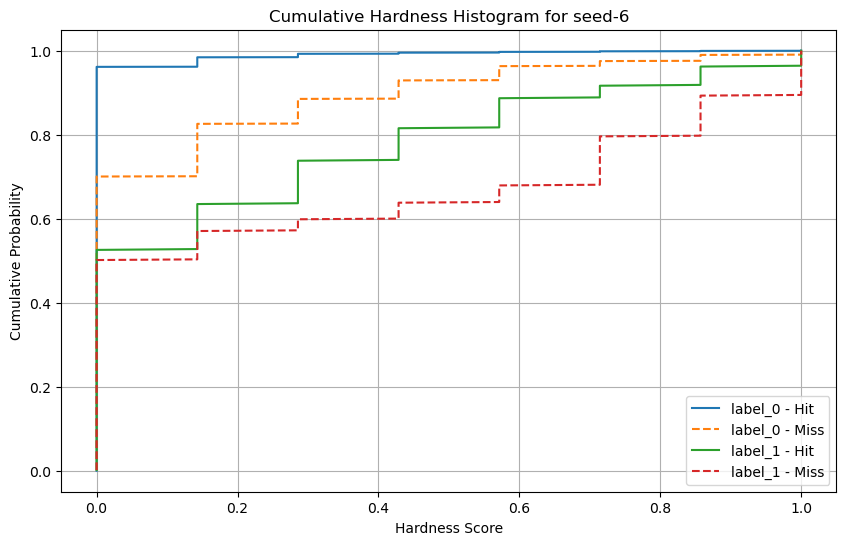

Hardness médio para seed-7: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_8.joblib


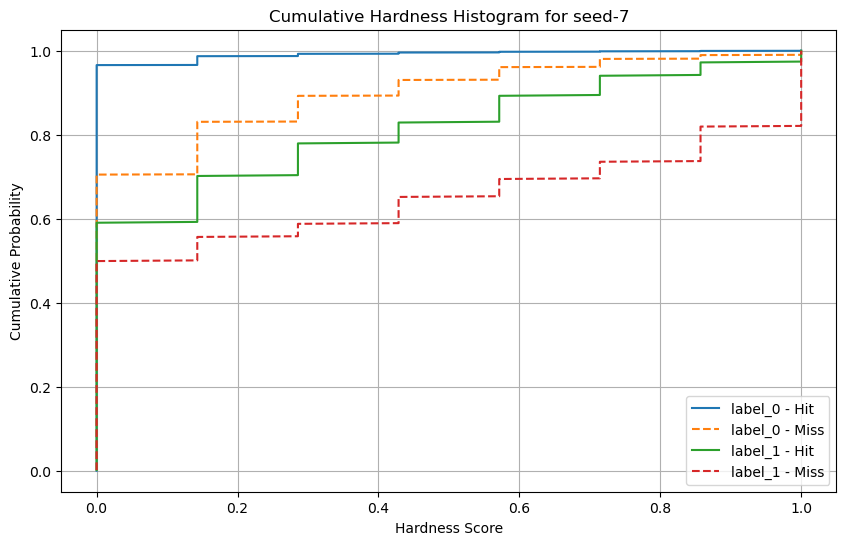

Hardness médio para seed-8: 0.0253
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_9.joblib


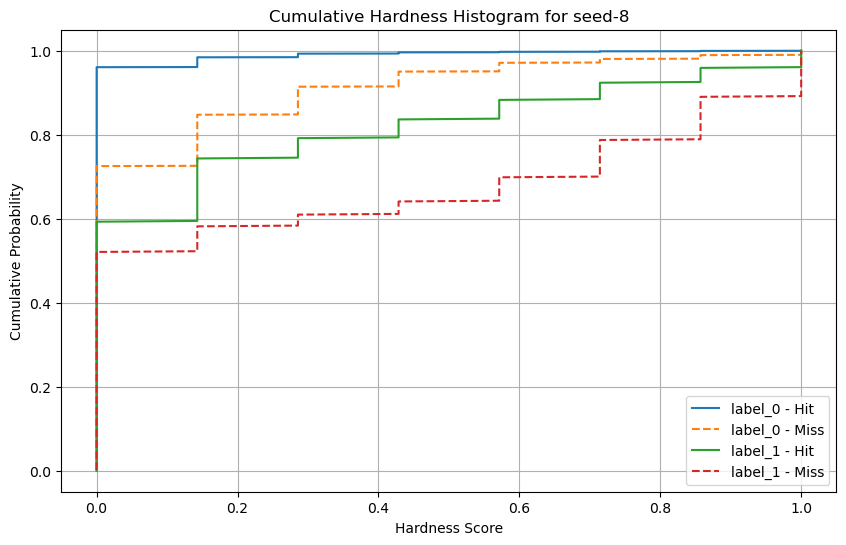

Hardness médio para seed-9: 0.0268
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_10.joblib


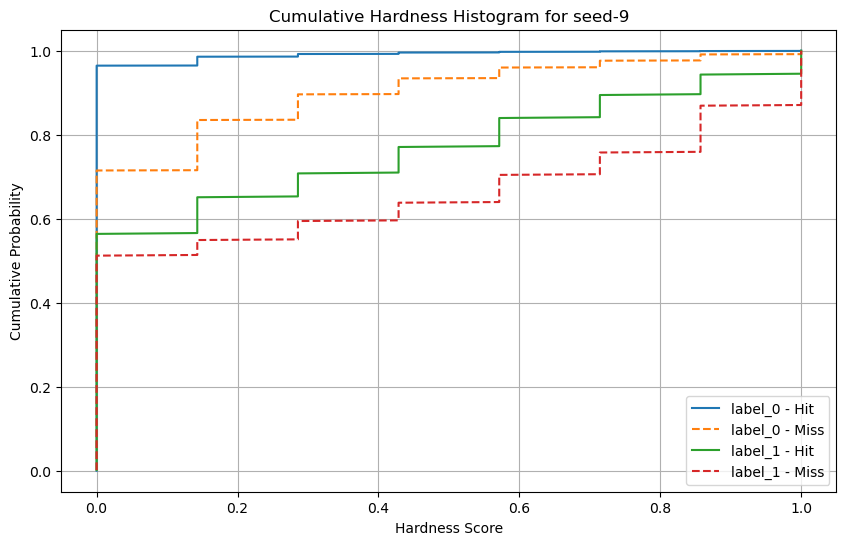

Hardness médio para seed-10: 0.0262
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_11.joblib


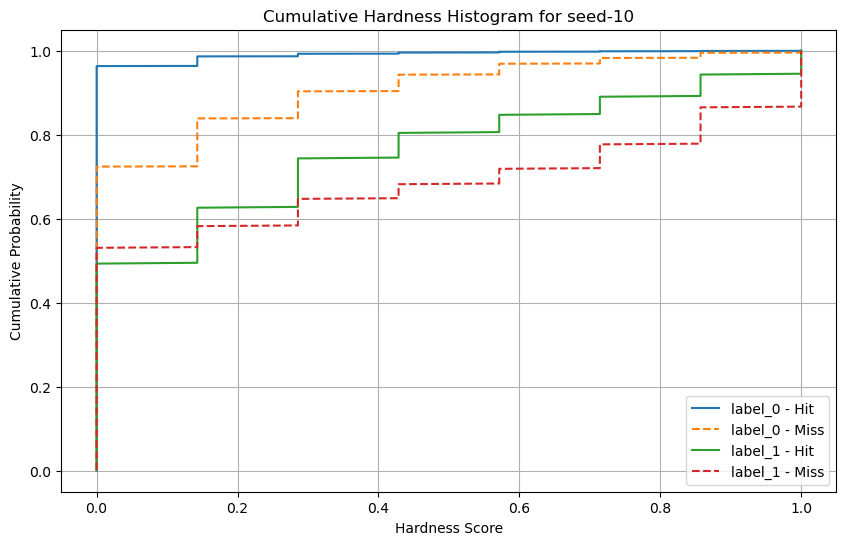

Hardness médio para seed-11: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_12.joblib


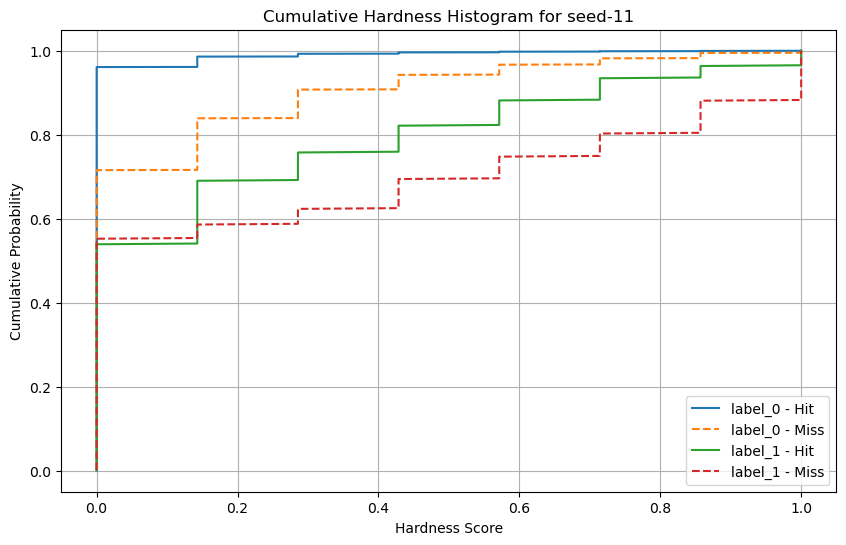

Hardness médio para seed-12: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_13.joblib


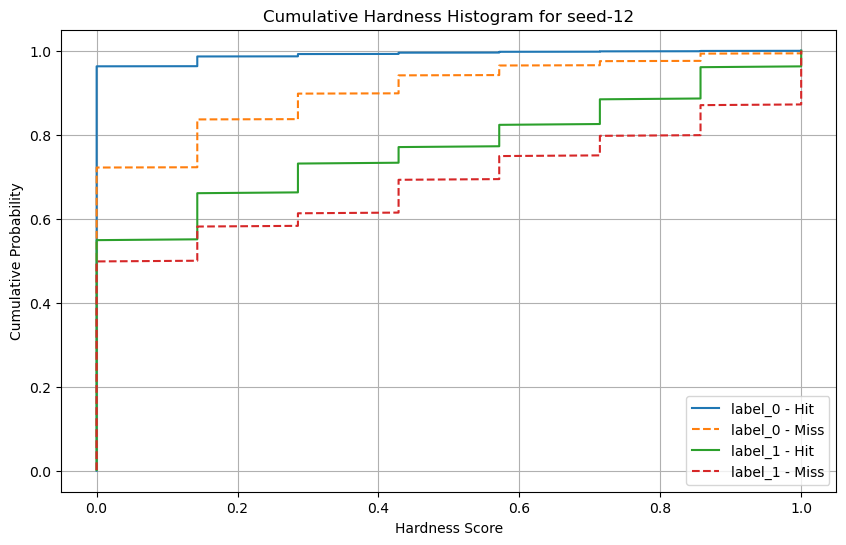

Hardness médio para seed-13: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_14.joblib


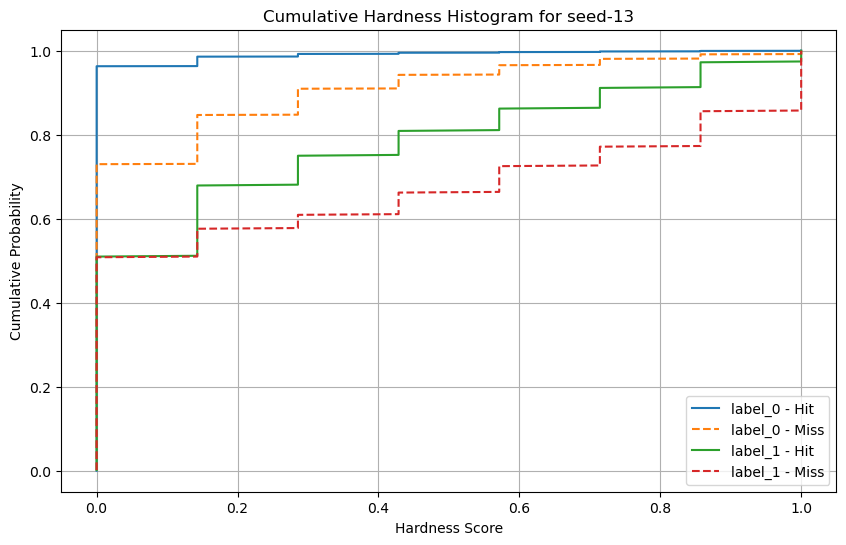

Hardness médio para seed-14: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_15.joblib


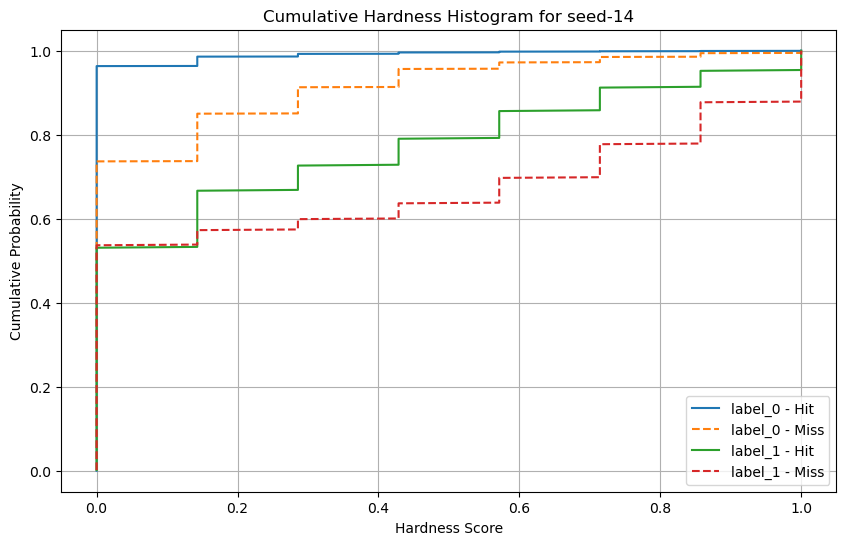

Hardness médio para seed-15: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_16.joblib


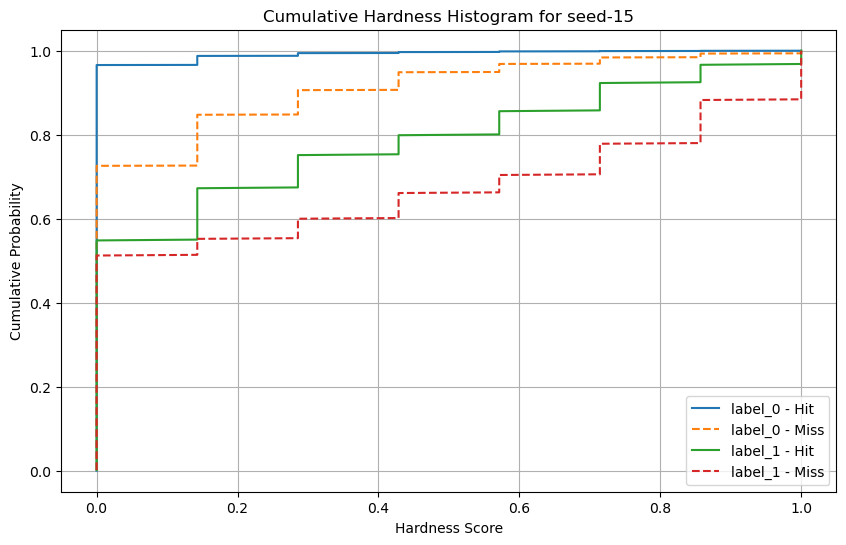

Hardness médio para seed-16: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_17.joblib


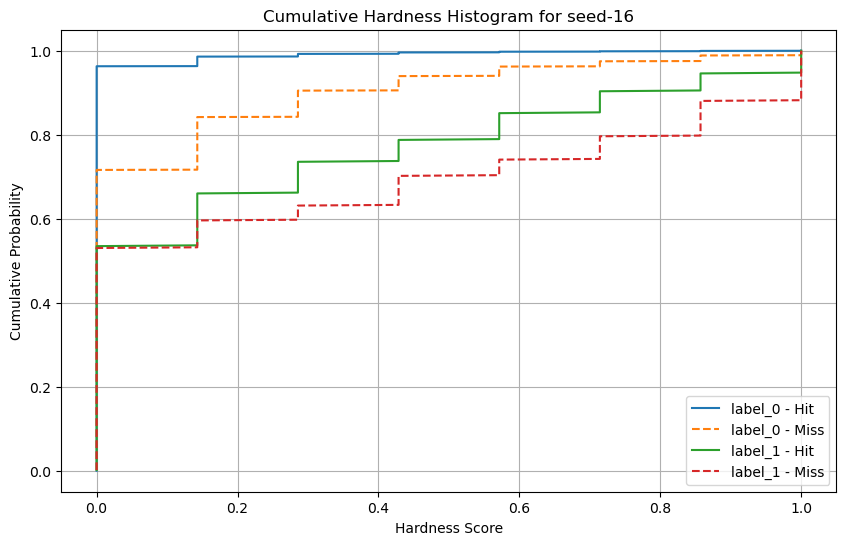

Hardness médio para seed-17: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_18.joblib


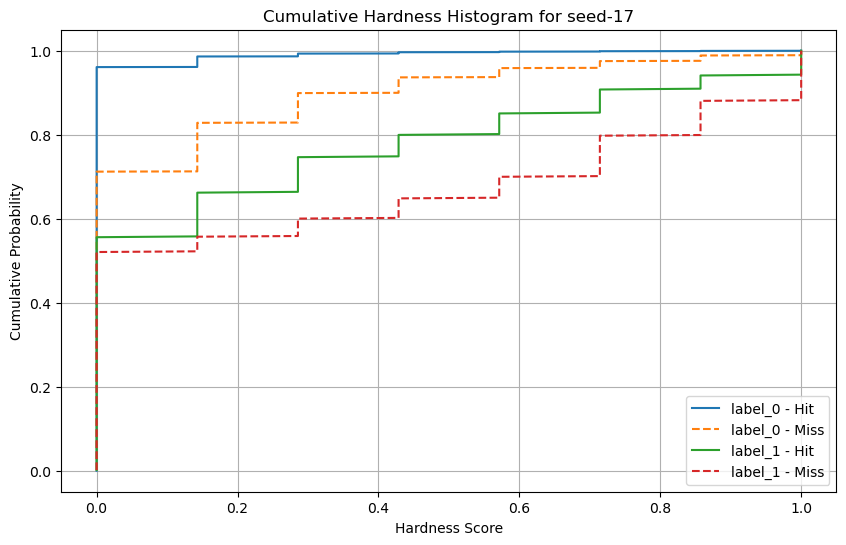

Hardness médio para seed-18: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_19.joblib


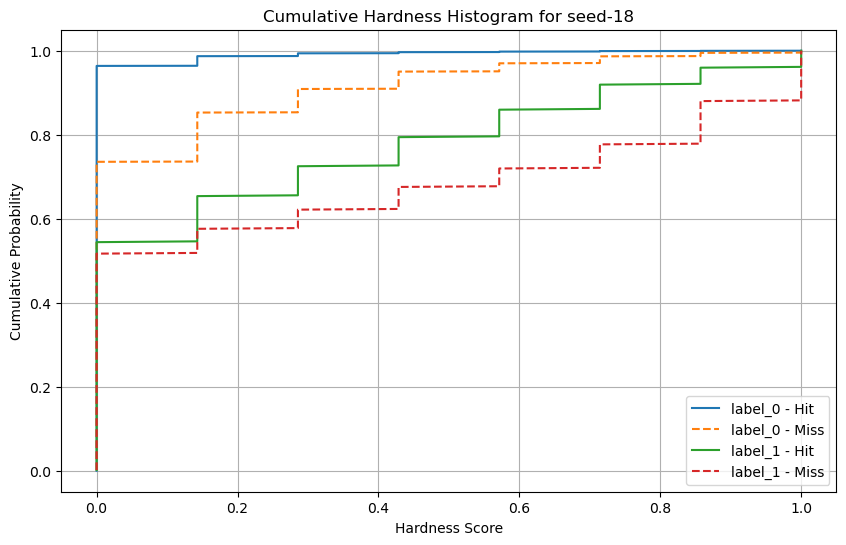

Hardness médio para seed-19: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_20.joblib


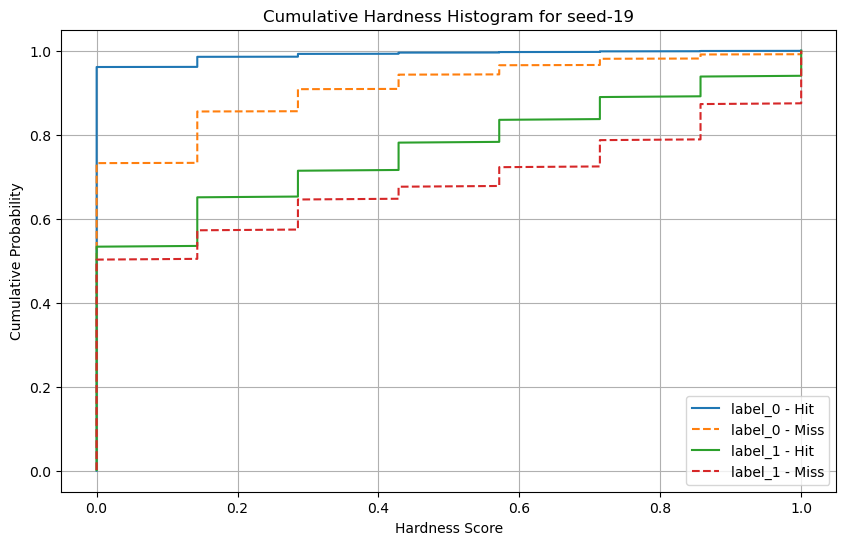

Hardness médio para seed-20: 0.0250
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_21.joblib


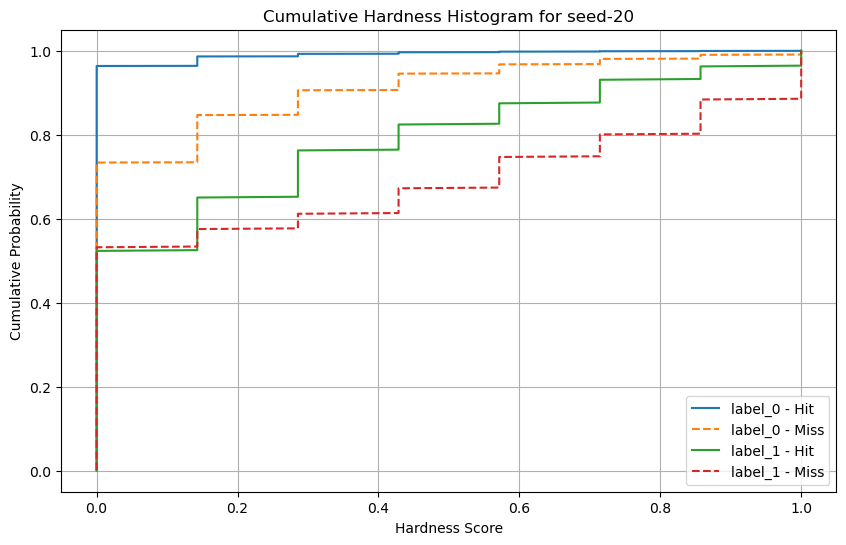

Hardness médio para seed-21: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_22.joblib


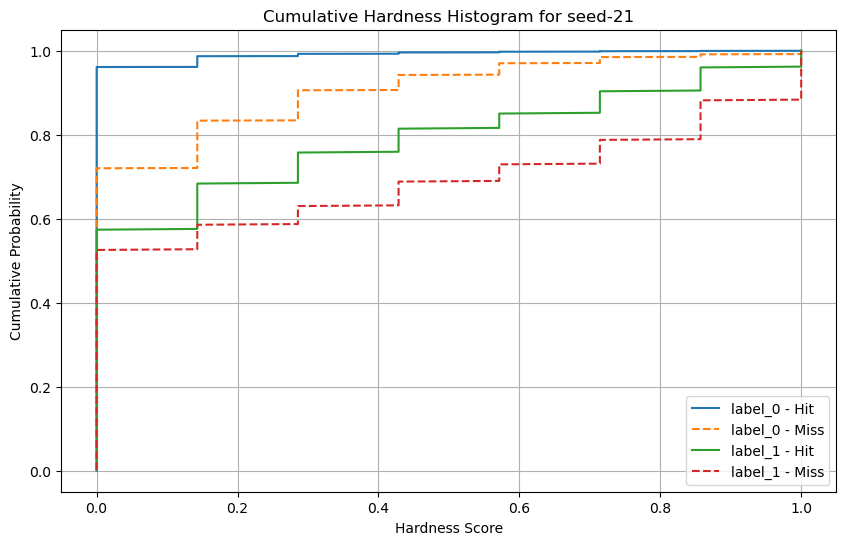

Hardness médio para seed-22: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_23.joblib


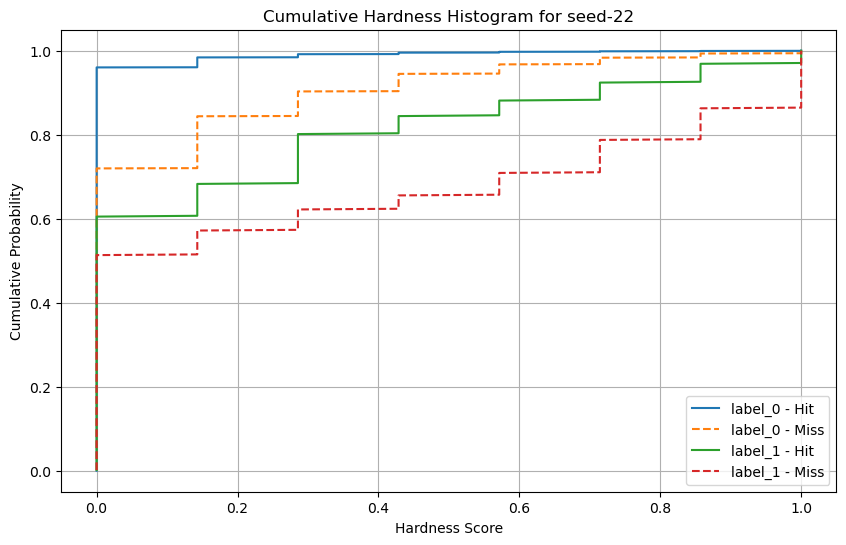

Hardness médio para seed-23: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_24.joblib


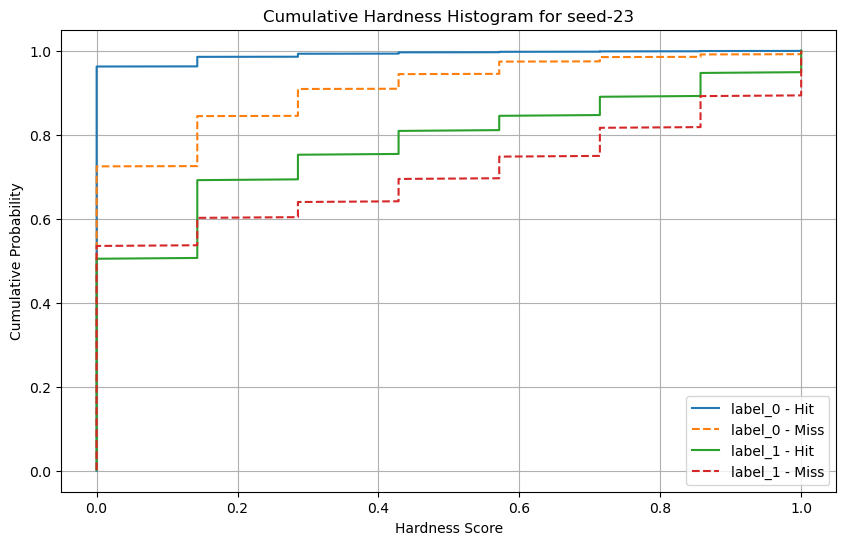

Hardness médio para seed-24: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_25.joblib


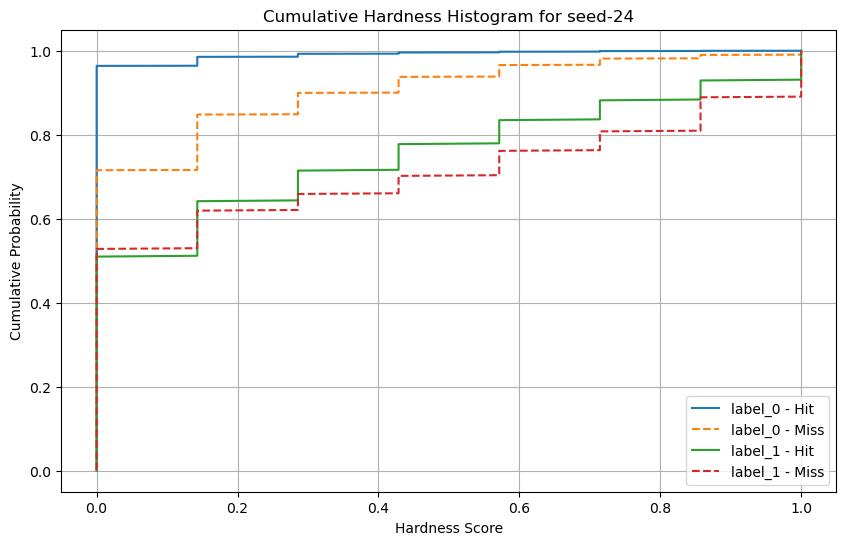

Hardness médio para seed-25: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_26.joblib


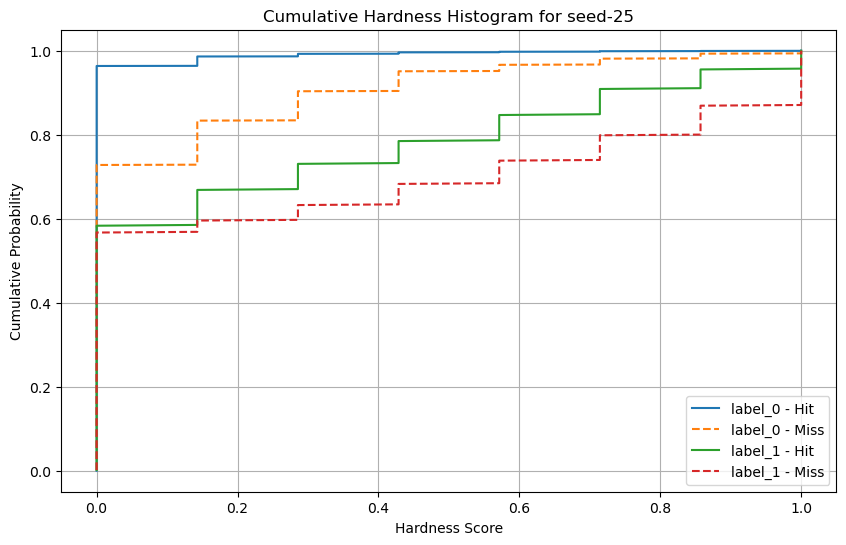

Hardness médio para seed-26: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_27.joblib


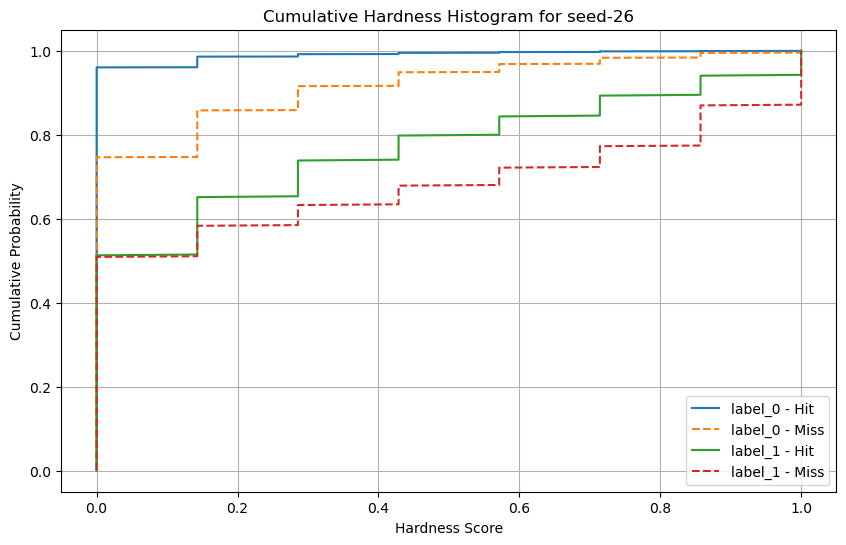

Hardness médio para seed-27: 0.0248
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_28.joblib


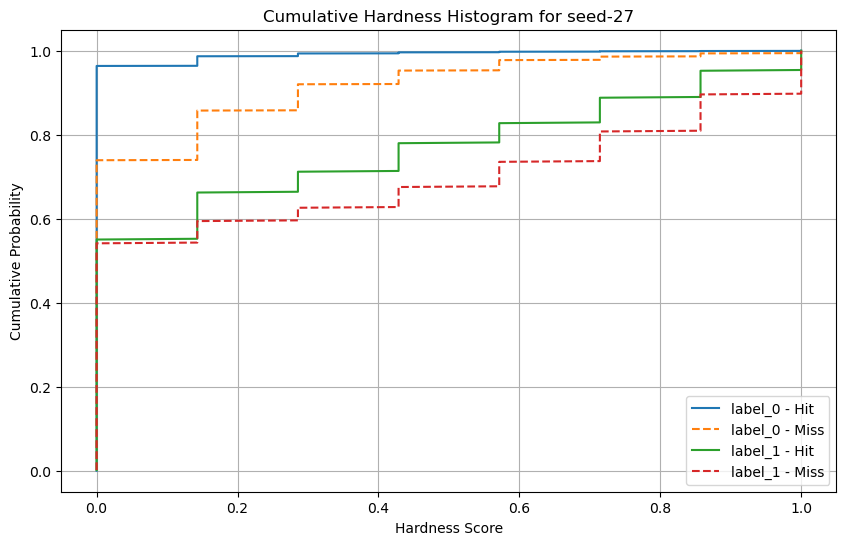

Hardness médio para seed-28: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_29.joblib


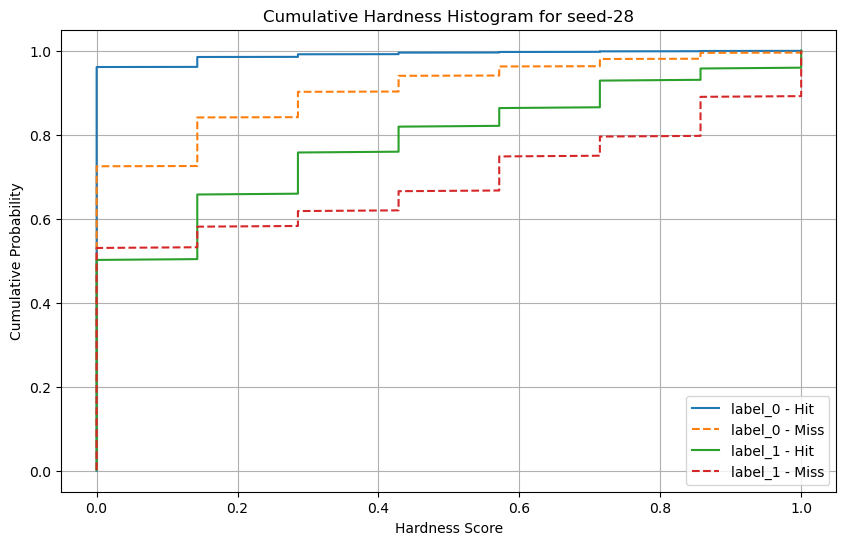

Hardness médio para seed-29: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\NaiveBayes\model_30.joblib


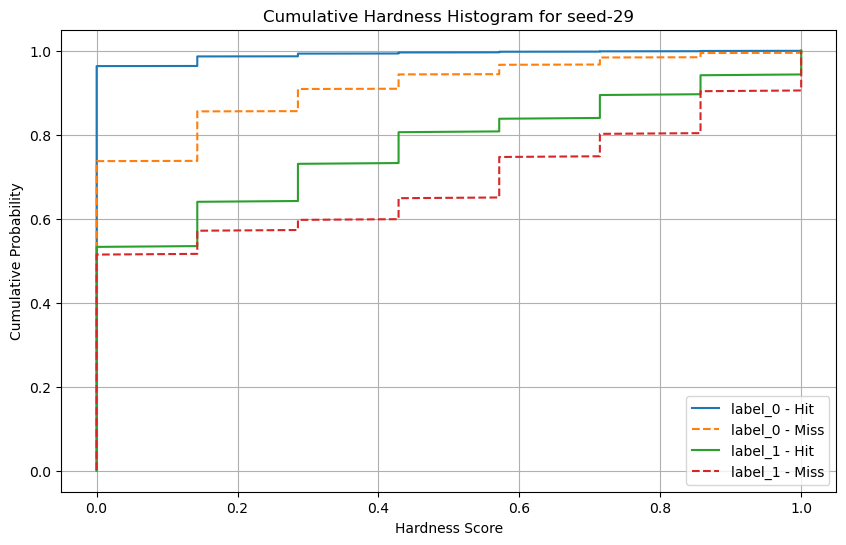

Processando pasta: RandomForest
Hardness médio para seed-0: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_1.joblib


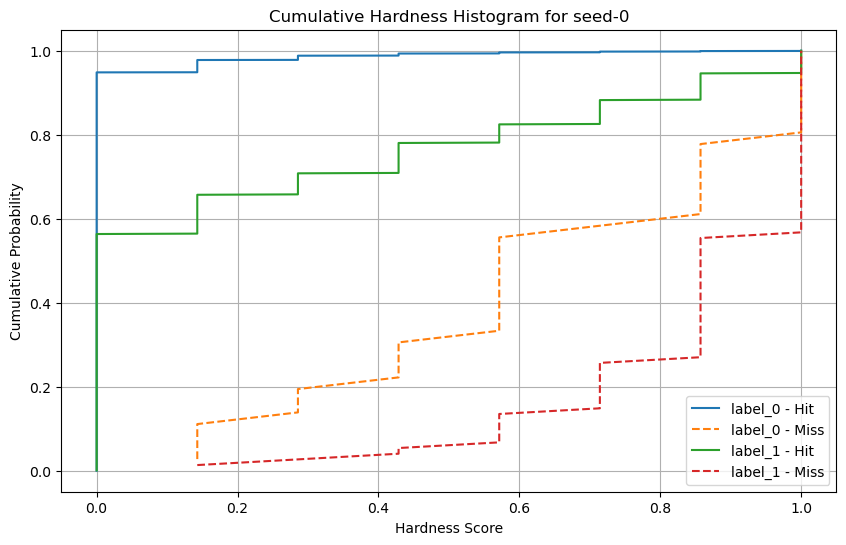

Hardness médio para seed-1: 0.0252
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_2.joblib


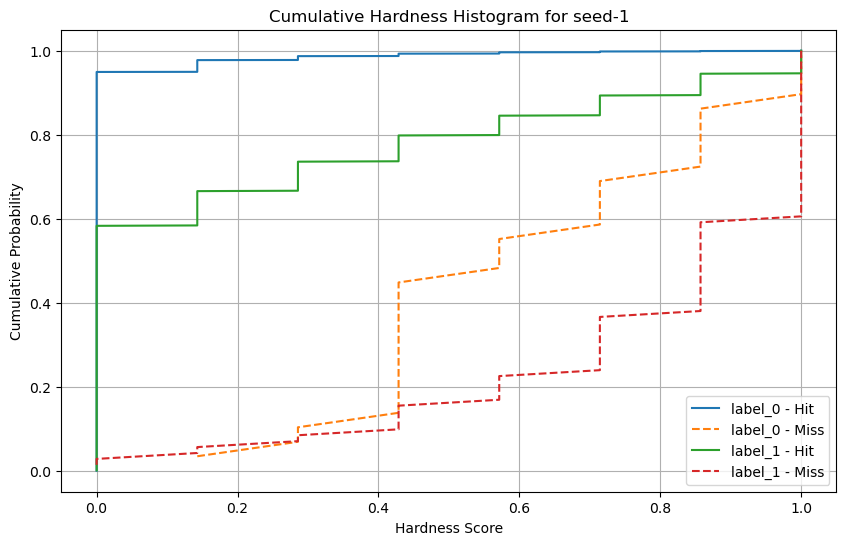

Hardness médio para seed-2: 0.0258
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_3.joblib


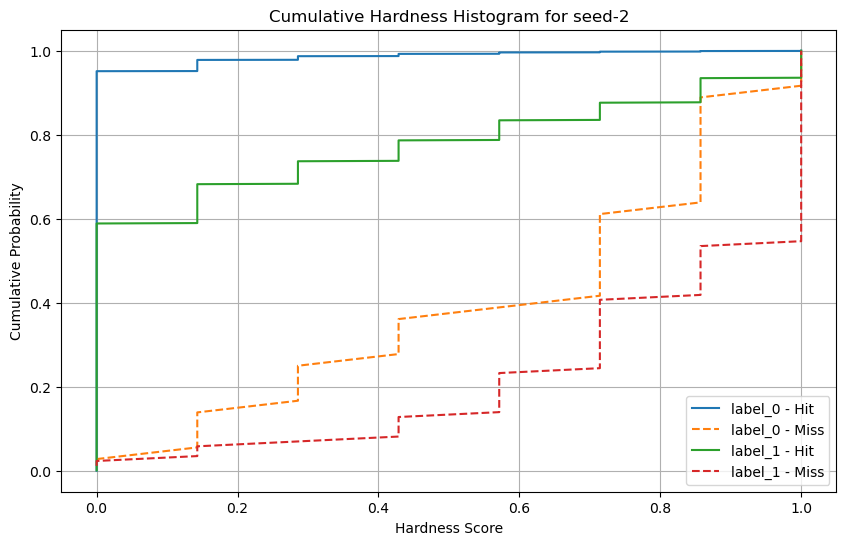

Hardness médio para seed-3: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_4.joblib


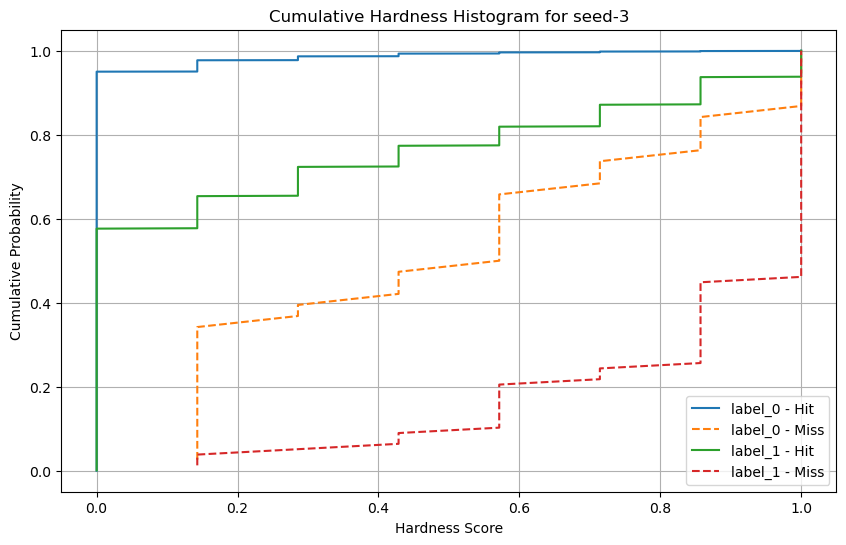

Hardness médio para seed-4: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_5.joblib


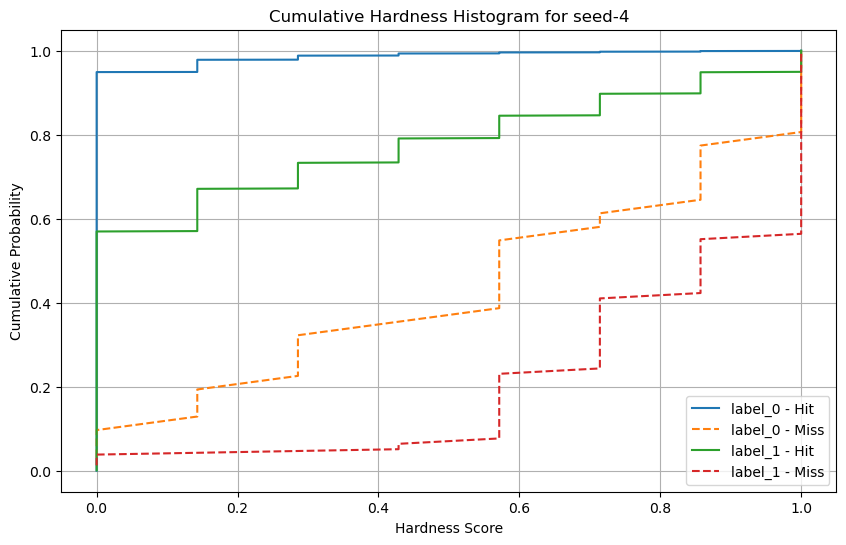

Hardness médio para seed-5: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_6.joblib


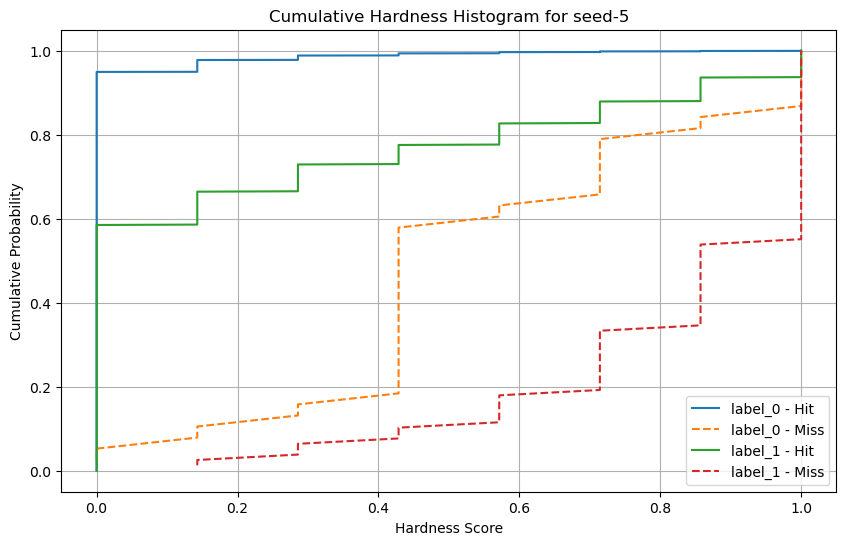

Hardness médio para seed-6: 0.0272
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_7.joblib


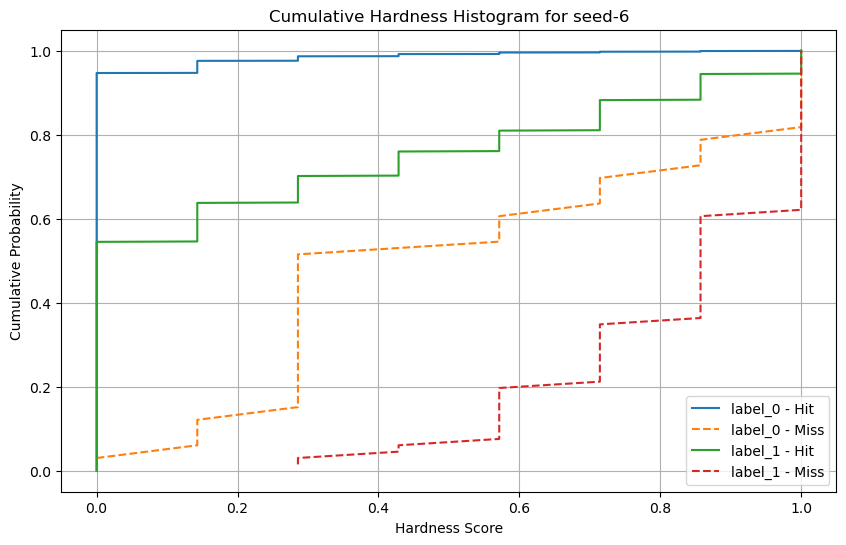

Hardness médio para seed-7: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_8.joblib


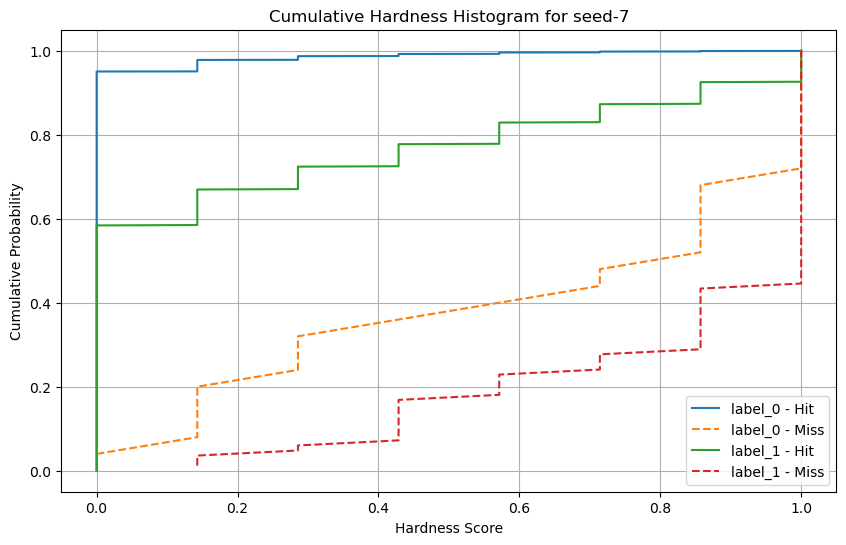

Hardness médio para seed-8: 0.0253
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_9.joblib


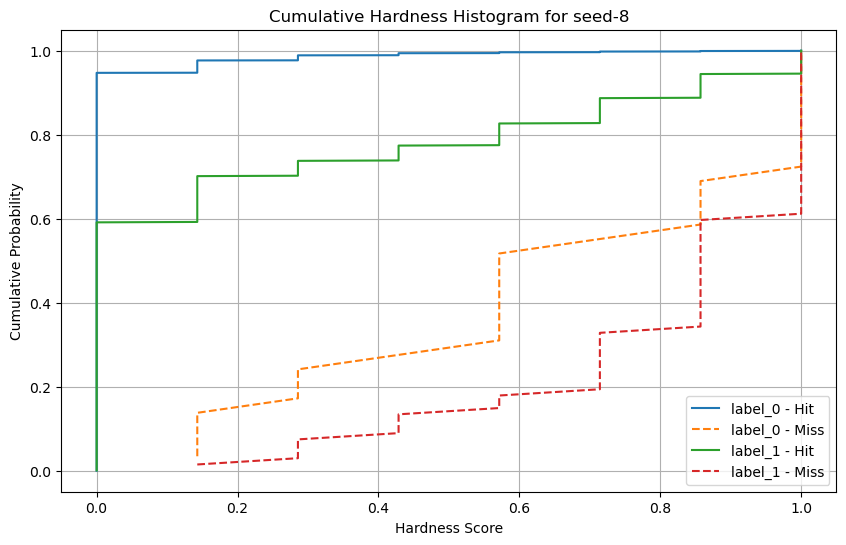

Hardness médio para seed-9: 0.0268
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_10.joblib


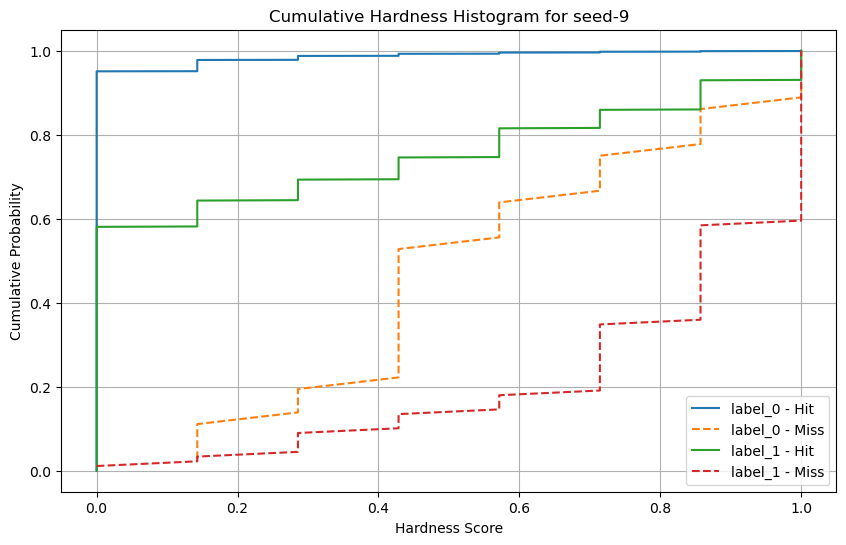

Hardness médio para seed-10: 0.0262
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_11.joblib


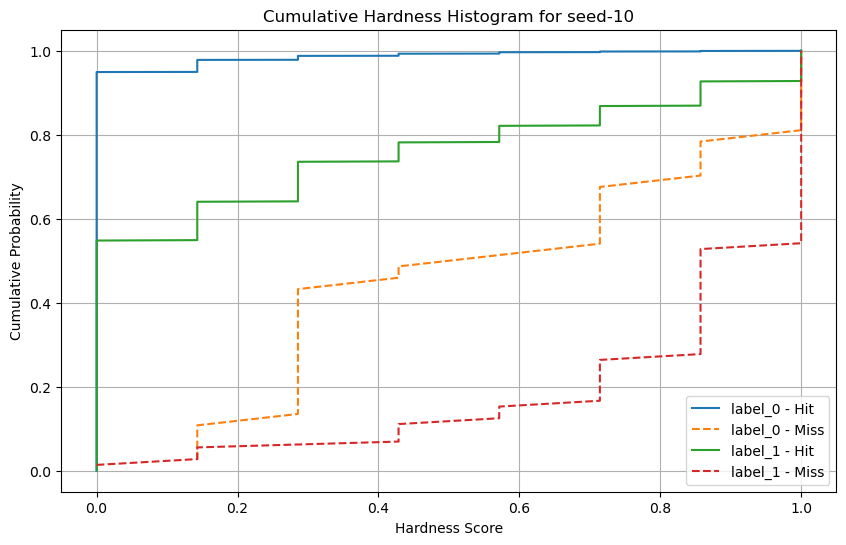

Hardness médio para seed-11: 0.0256
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_12.joblib


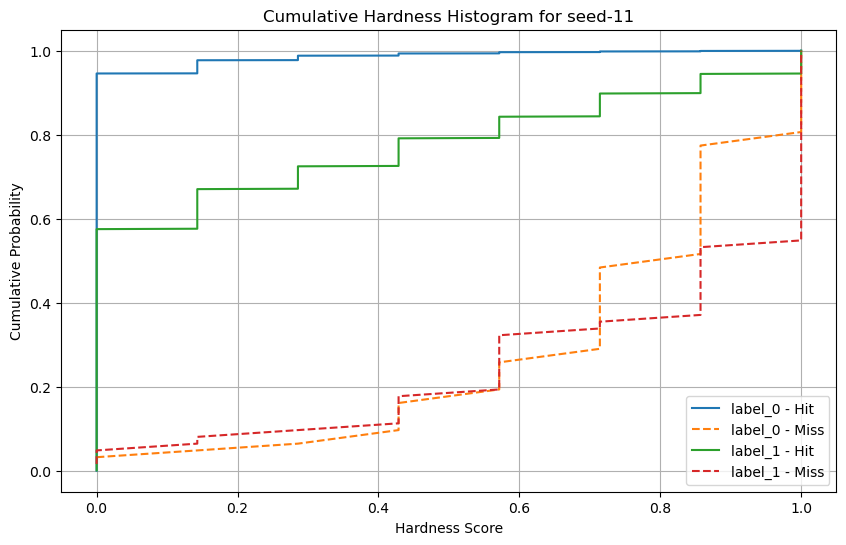

Hardness médio para seed-12: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_13.joblib


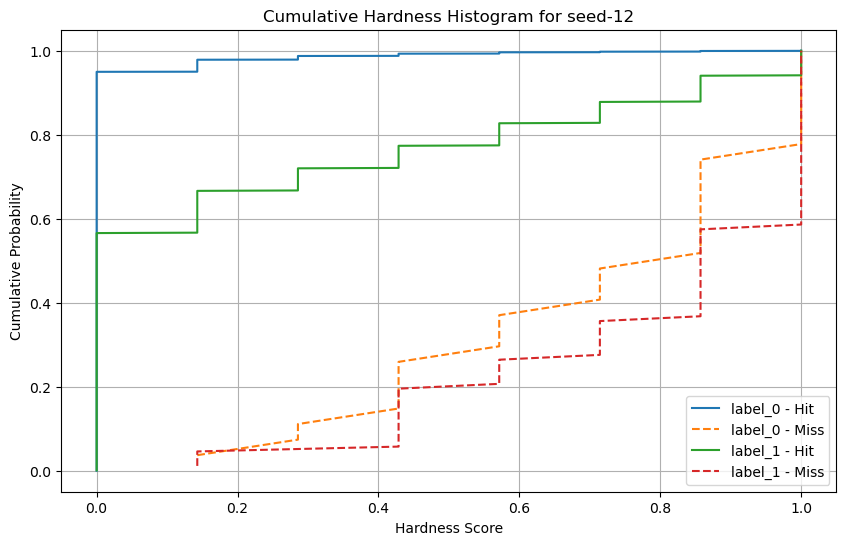

Hardness médio para seed-13: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_14.joblib


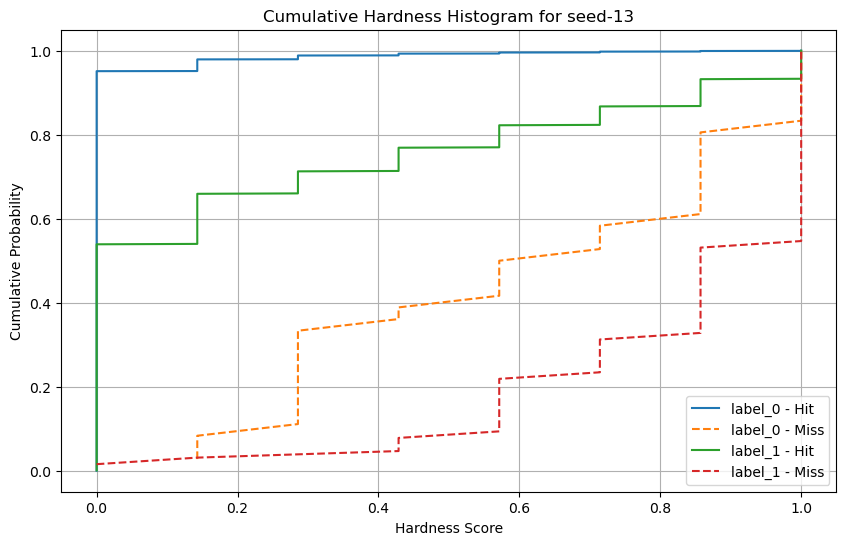

Hardness médio para seed-14: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_15.joblib


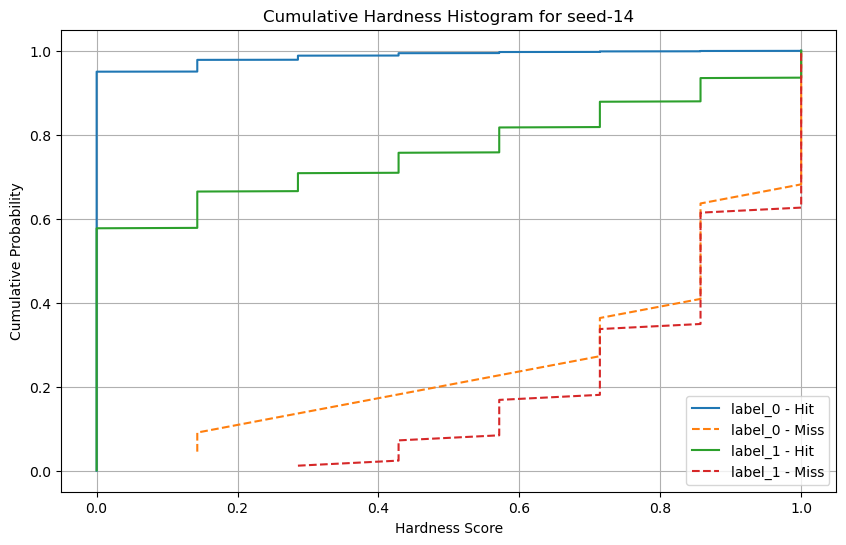

Hardness médio para seed-15: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_16.joblib


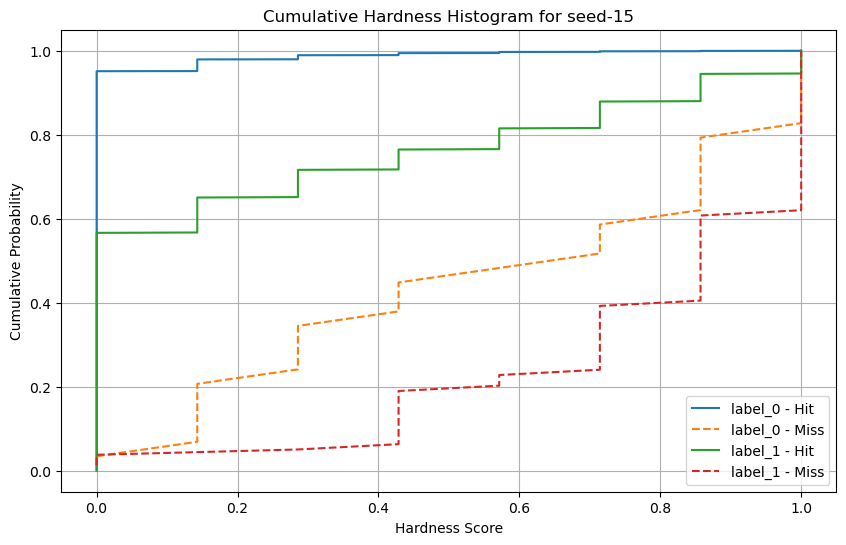

Hardness médio para seed-16: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_17.joblib


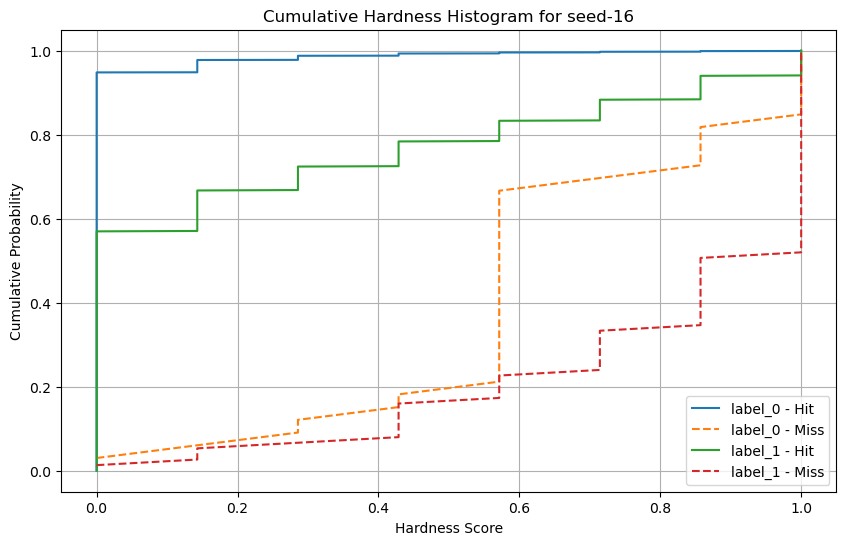

Hardness médio para seed-17: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_18.joblib


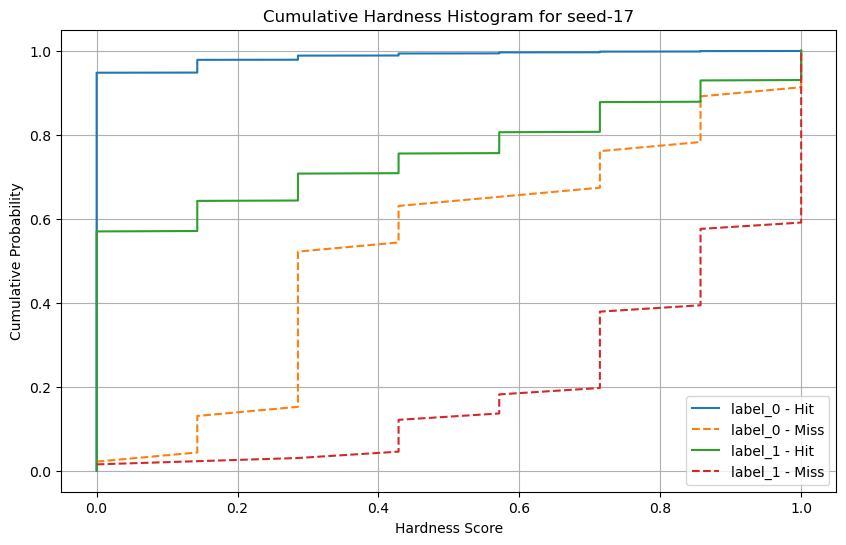

Hardness médio para seed-18: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_19.joblib


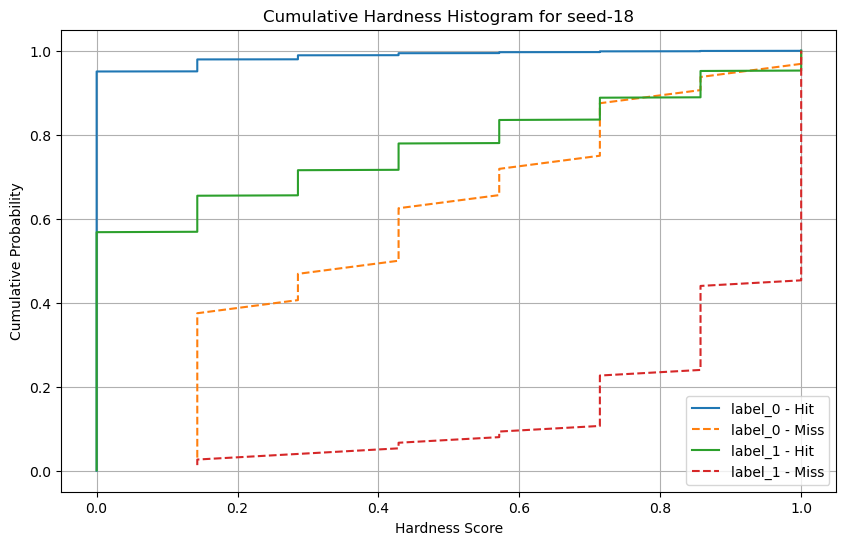

Hardness médio para seed-19: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_20.joblib


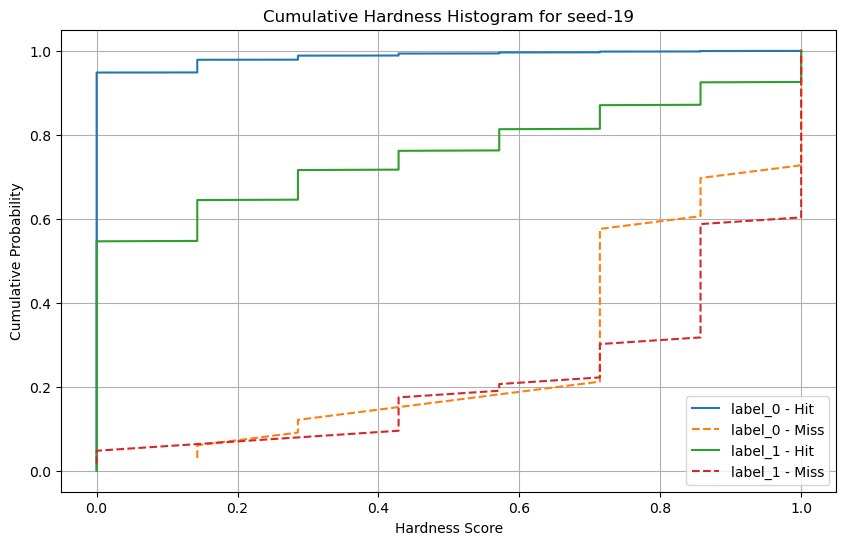

Hardness médio para seed-20: 0.0250
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_21.joblib


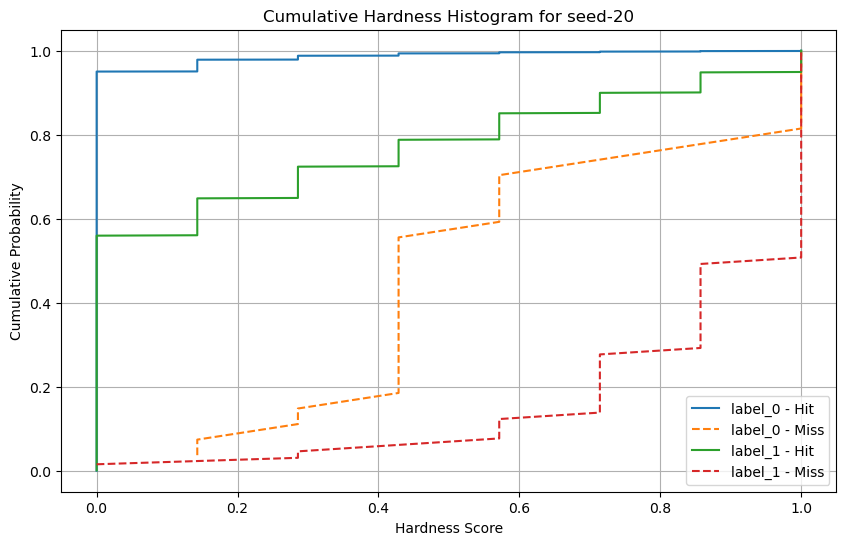

Hardness médio para seed-21: 0.0254
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_22.joblib


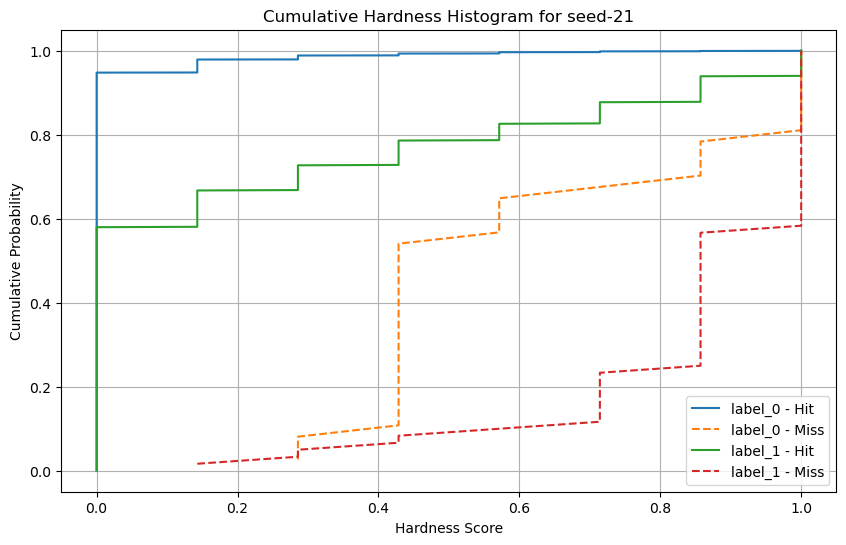

Hardness médio para seed-22: 0.0260
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_23.joblib


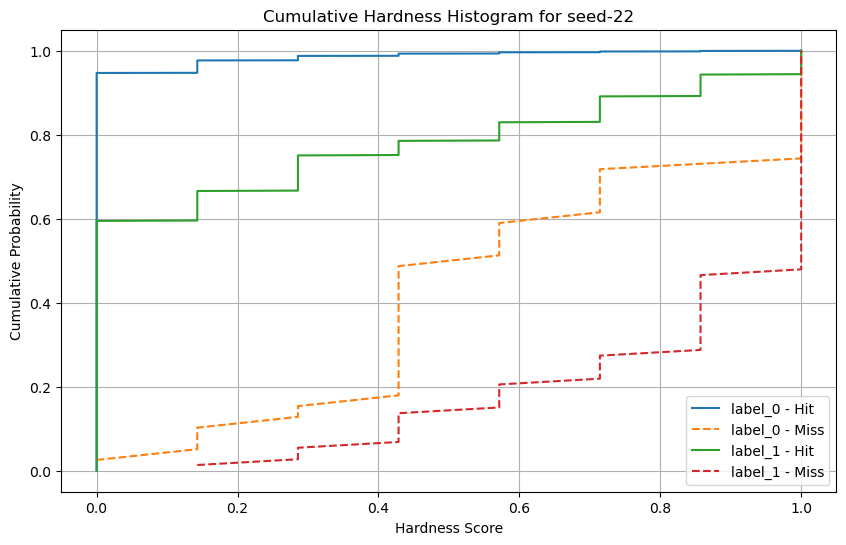

Hardness médio para seed-23: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_24.joblib


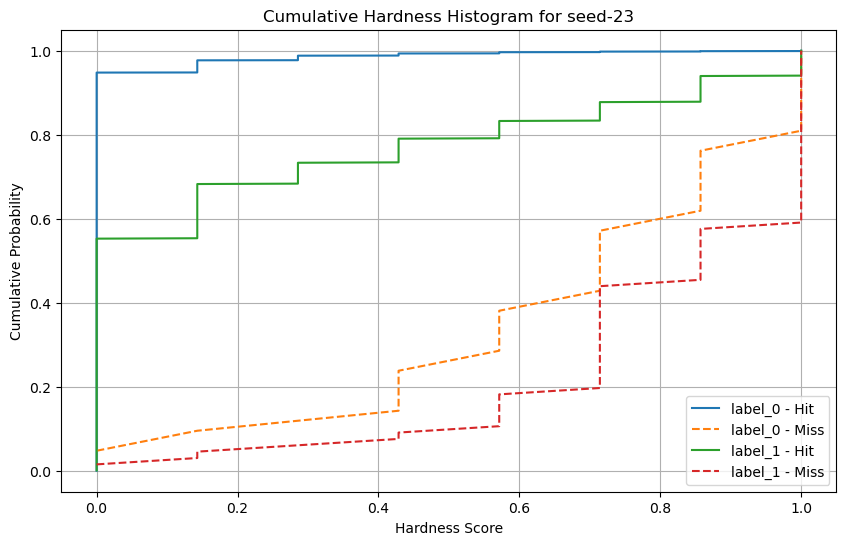

Hardness médio para seed-24: 0.0255
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_25.joblib


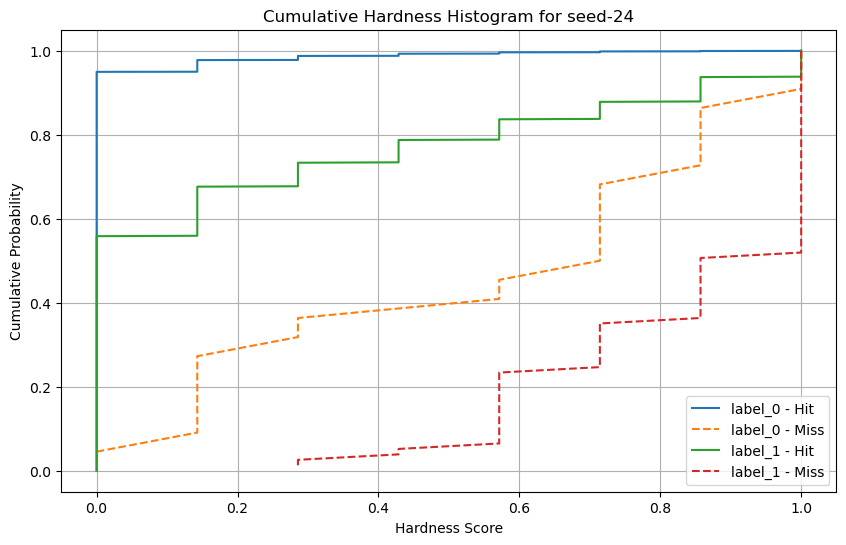

Hardness médio para seed-25: 0.0249
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_26.joblib


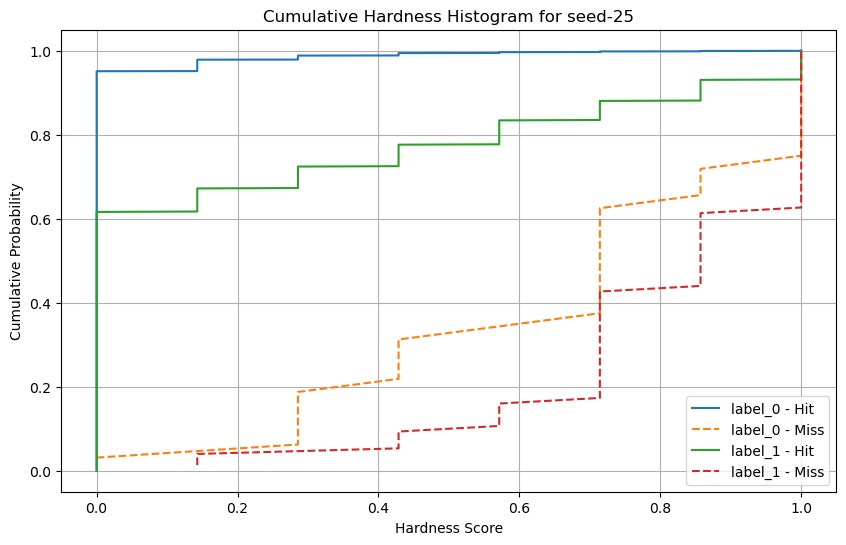

Hardness médio para seed-26: 0.0263
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_27.joblib


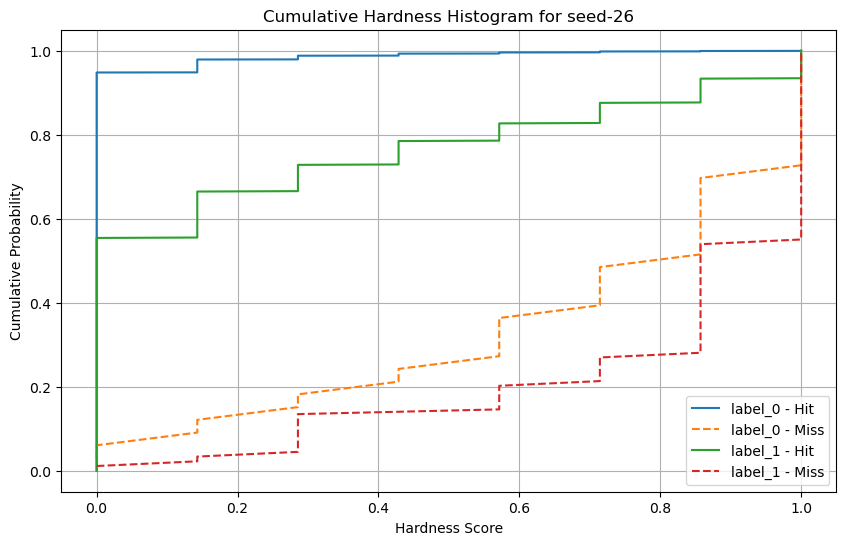

Hardness médio para seed-27: 0.0248
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_28.joblib


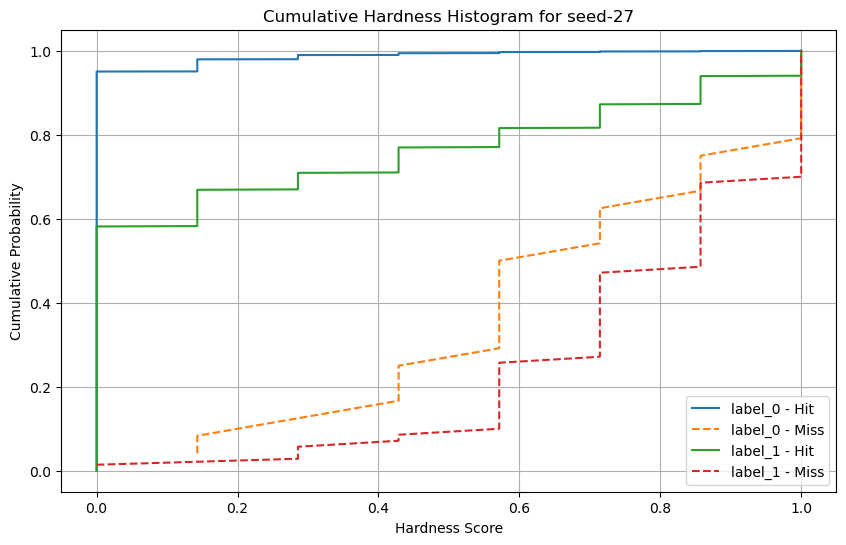

Hardness médio para seed-28: 0.0264
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_29.joblib


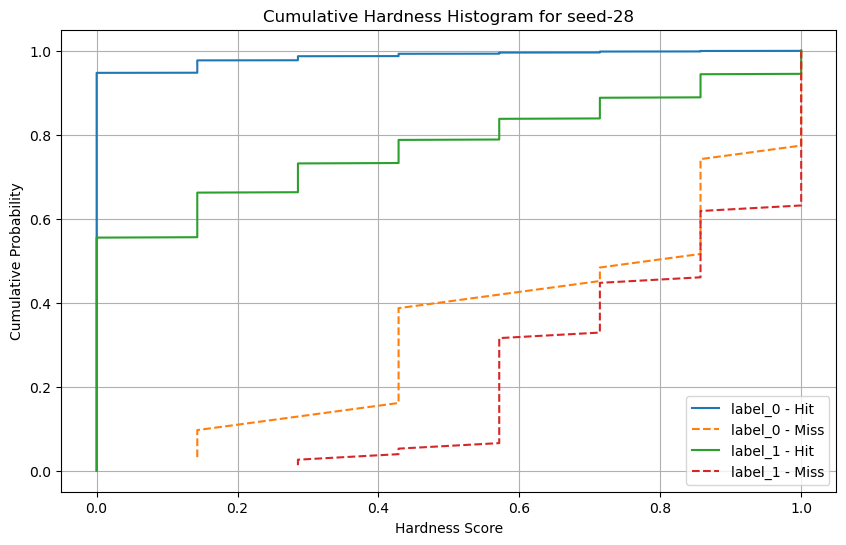

Hardness médio para seed-29: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Unbalanced\RandomForest\model_30.joblib


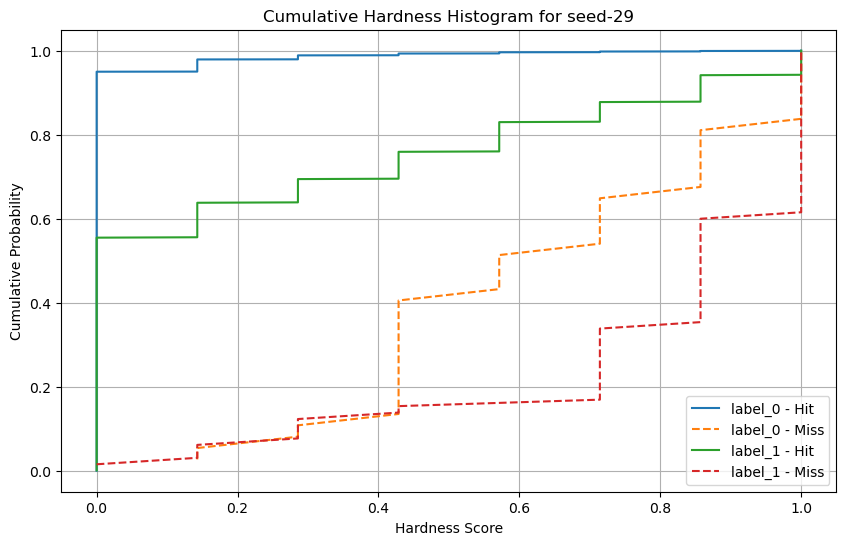

Processando pasta: SingleBest


ValueError: invalid literal for int() with base 10: 'Best_metr'

In [24]:
import os
import joblib
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

models = {}

# Função para ler os dados
x0, y0 = read(LOAD_DATA=False)

with open('modelPredictUnbalanced.json', 'r') as f:
    model_predict = json.load(f)


# Caminho do diretório com os modelos
dir_path = r'E:\DrebinStudy\Unbalanced'

def natural_sort_key(s):
    return int(s[6:-7])

with open('test_kdn_scores_unbalanced.json', 'r') as f:
    kdn_scores = json.load(f)

# Função para criar o gráfico cumulativo para uma seed específica
def plot_cumulative_histogram_single_seed(hardness_table, seed):
    plt.figure(figsize=(10, 6))

    for label in ['label_0', 'label_1']:
        # Hits para a seed especificada
        hit_scores = hardness_table[label]['Hit'][seed]
        sorted_hits = np.sort(hit_scores)
        cumulative_hits = np.arange(1, len(sorted_hits) + 1) / len(sorted_hits)
        plt.plot(sorted_hits, cumulative_hits, label=f"{label} - Hit")

        # Misses para a seed especificada
        miss_scores = hardness_table[label]['Miss'][seed]
        sorted_misses = np.sort(miss_scores)
        cumulative_misses = np.arange(1, len(sorted_misses) + 1) / len(sorted_misses)
        plt.plot(sorted_misses, cumulative_misses, label=f"{label} - Miss", linestyle='--')

    # Configurações do gráfico
    plt.title(f'Cumulative Hardness Histogram for {seed}')
    plt.xlabel('Hardness Score')
    plt.ylabel('Cumulative Probability')
    plt.legend()
    plt.grid(True)
    plt.show()

# Loop para percorrer todas as pastas no diretório (tirando 'Metrics')
for folder_name in os.listdir(dir_path):
    folder_path = os.path.join(dir_path, folder_name)
    
    # Verifica se é uma pasta e se não é a pasta 'Metrics'
    if os.path.isdir(folder_path) and folder_name != 'Metrics' and folder_name != 'Bagging2' and folder_name != 'KNOP' and folder_name != 'METADES' and folder_name != 'OLA':
        print(f'Processando pasta: {folder_name}')
        i = 0
        hardness_table = {'label_0': {'Hit':{}, 'Miss':{}}, 'label_1': {'Hit':{}, 'Miss':{}}}

        if folder_path not in list(model_predict.keys()):
            model_predict[folder_path] = dict()
        # Processar os modelos dentro da pasta
        for file_name in sorted(os.listdir(folder_path), key=natural_sort_key):
            if file_name in list(model_predict[folder_path].keys()):
                i += 1
                continue
            file_path = os.path.join(folder_path, file_name)
            x_train, x_test, y_train, y_test = train_test_split(
                np.arange(len(x0)), y0, test_size=0.2, stratify=y0, random_state=i)
            hardness_score = np.array(list(kdn_scores[f"seed-{i}"].values()))
            
            model = joblib.load(file_path)
            y_pred = model.predict(x0[x_test])
            indices_diferentes = np.where(y_pred != y_test)[0].tolist()

            model_predict[folder_path][file_name] = indices_diferentes

            with open("modelPredictUnbalanced.json", "w") as file:
                json.dump(model_predict, file, indent=4)

            # Separar os scores por label
            for label in [0, 1]:
                hit_scores = hardness_score[(y_test == y_pred) & (y_test == label)]
                miss_scores = hardness_score[(y_test != y_pred) & (y_test == label)]
                hardness_table[f'label_{label}']['Hit'][f'seed-{str(i)}'] = hit_scores
                hardness_table[f'label_{label}']['Miss'][f'seed-{str(i)}'] = miss_scores

            print(f"Hardness médio para seed-{i}: {np.mean(hardness_score):.4f}")
            i += 1   
            print(f'Arquivo de modelo encontrado: {file_path}')
            
            # Gerar gráfico cumulativo para o modelo atual
            #plot_cumulative_histogram_single_seed(hardness_table, f'seed-{i-1}')  # Mostrar para o último seed processado
        
        # Salvar a hardness_table por pasta
        models[folder_name] = hardness_table
        

In [26]:
import numpy as np
from sklearn.model_selection import train_test_split
from deslib.util.instance_hardness import kdn_score
import json
from sklearn.neighbors import NearestNeighbors

test_kdn_scores = {}

x0, y0 = read(LOAD_DATA= False)

def calculate_kdn_for_seed(random_state, x0, y0, k=7, balanced = False):
    test_kdn_scores[f'seed-{random_state}'] = dict() 
    
    # Dividir os dados de treino e teste
    x_train, x_test, y_train, y_test = train_test_split(
        np.arange(len(x0)), y0, test_size=0.2, stratify=y0, random_state=random_state)
    
    # Checar o Instance Hardness 
    if balanced:
        smote = SMOTE(sampling_strategy='auto', k_neighbors=5, random_state=random_state)
        x_train_balanced, y_train_balanced = smote.fit_resample(x0[x_train], y_train)
        x_train_new = np.concatenate([x_train, np.arange(len(x0)-1, (len(x_train_balanced)-len(x_train)+len(x0)))])
        x0 = np.concatenate([x0, x_train_balanced[len(x_train)-1:]])
        y_train = np.concatenate([y_train, y_train_balanced[len(y_train)-1:]])
        x_train = x_train_new
        

    # Calcular os vizinhos mais próximos usando os dados de treino
    nbrs = NearestNeighbors(n_neighbors=k, algorithm='kd_tree').fit(x0[x_train])
    
    # Encontrar os vizinhos mais próximos para os pontos de teste
    _, indices = nbrs.kneighbors(x0[x_test])
    
    # Calcular o KDN score para cada ponto de teste
    for i, idxs in enumerate(indices):
        # Verificar se os k vizinhos pertencem a uma classe diferente
        diff_class = y_train[idxs] != y_test[i]
        score = np.sum(diff_class) / k
        
        # Armazenar o resultado no dicionário
        test_kdn_scores[f'seed-{random_state}'][f'index-{int(x_test[i])}'] = score

    if balanced:
        with open('test_kdn_scores_balanced.json', 'w') as json_file:
            json.dump(test_kdn_scores, json_file, indent=4)
    else:
         with open('test_kdn_scores_bagging2.json', 'w') as json_file:
            json.dump(test_kdn_scores, json_file, indent=4)


# Calcular o KDN score para diferentes sementes
calculate_kdn_for_seed(42, x0, y0, k=7, balanced= False)

Loading previous data ...
(129013, 8) (129013,)


Loading previous data ...
(129013, 8) (129013,)
Processando pasta: DecisionTree
Hardness médio para seed-0: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\DecisionTree\1


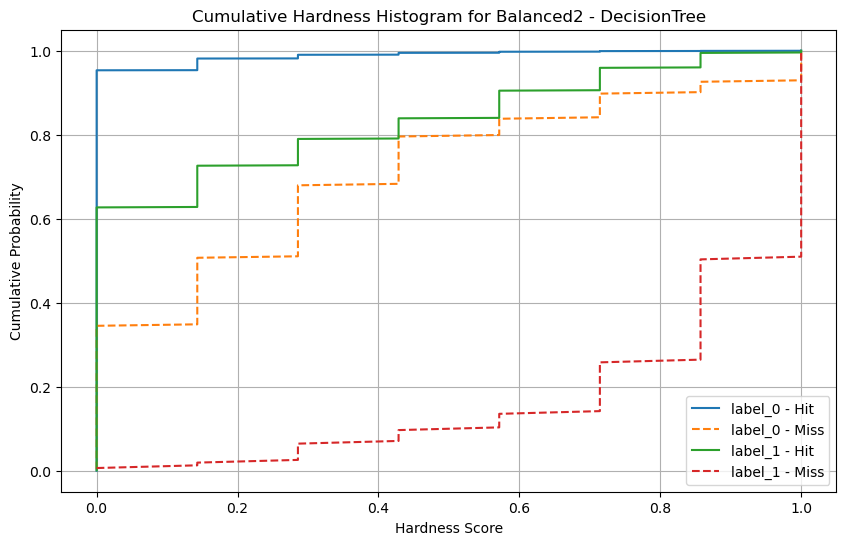

Processando pasta: Knn
Hardness médio para seed-0: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\Knn\1


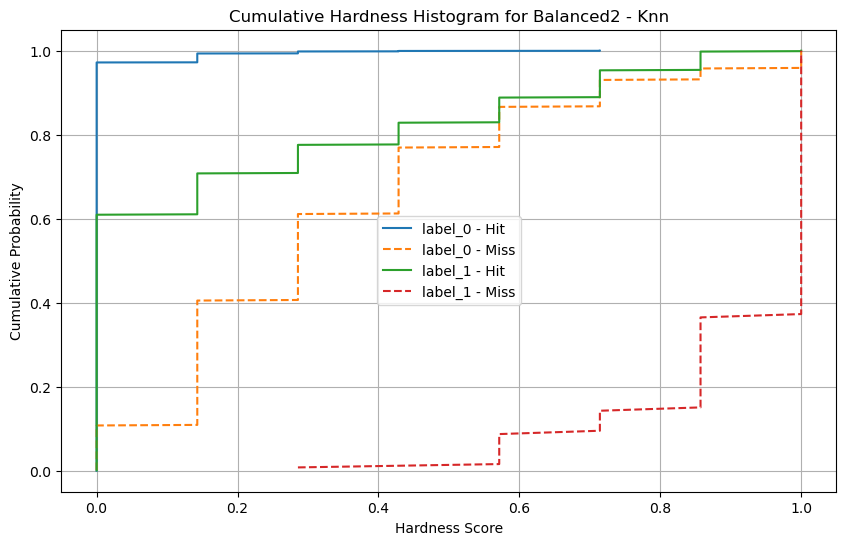

Processando pasta: MLP
Hardness médio para seed-0: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\1


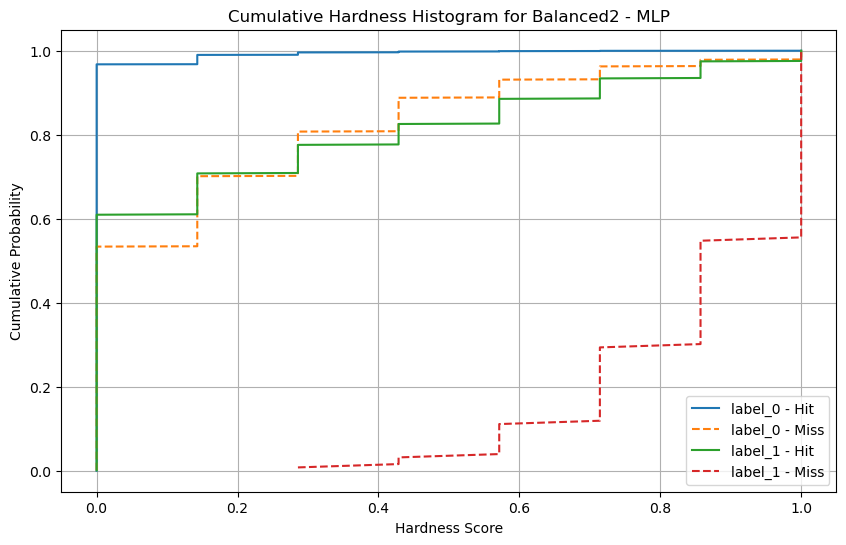

Processando pasta: NaiveBayes
Hardness médio para seed-0: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\1


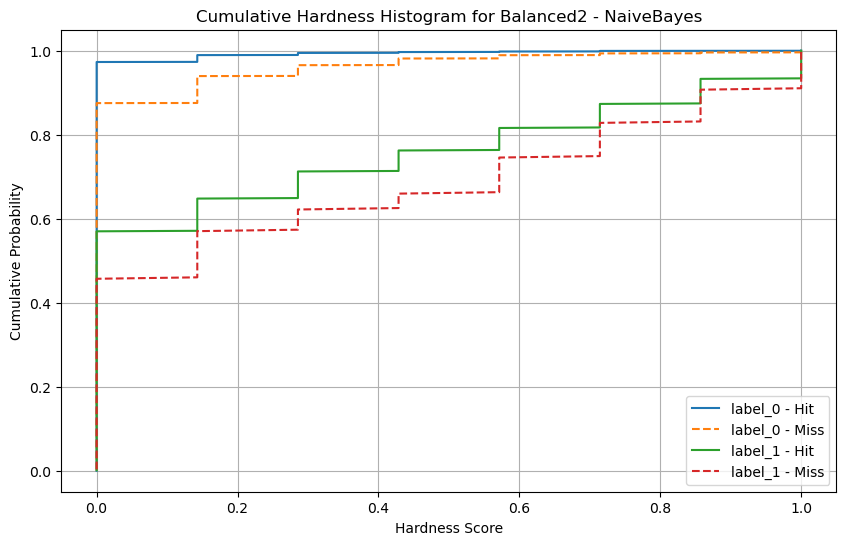

In [23]:
import os
import joblib
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

models = {}

# Função para ler os dados
x0, y0 = read(LOAD_DATA=False)

with open('modelPredictBalanced.json', 'r') as f:
    model_predict = json.load(f)


# Caminho do diretório com os modelos
dir_path = r'E:\DrebinStudy\Balanced\Bagging2'

def natural_sort_key(s):
    return int(s)

with open('test_kdn_scores_bagging2.json', 'r') as f:
    kdn_scores = json.load(f)

# Função para criar o gráfico cumulativo para uma seed específica
def plot_cumulative_histogram_single_seed(hardness_table, seed, title):
    plt.figure(figsize=(10, 6))

    for label in ['label_0', 'label_1']:
        # Hits para a seed especificada
        hit_scores = hardness_table[label]['Hit'][seed]
        sorted_hits = np.sort(hit_scores)
        cumulative_hits = np.arange(1, len(sorted_hits) + 1) / len(sorted_hits)
        plt.plot(sorted_hits, cumulative_hits, label=f"{label} - Hit")

        # Misses para a seed especificada
        miss_scores = hardness_table[label]['Miss'][seed]
        sorted_misses = np.sort(miss_scores)
        cumulative_misses = np.arange(1, len(sorted_misses) + 1) / len(sorted_misses)
        plt.plot(sorted_misses, cumulative_misses, label=f"{label} - Miss", linestyle='--')

    # Configurações do gráfico
    plt.title(f'Cumulative Hardness Histogram for {title}')
    plt.xlabel('Hardness Score')
    plt.ylabel('Cumulative Probability')
    plt.legend()
    plt.grid(True)
    plt.show()

# Loop para percorrer todas as pastas no diretório (tirando 'Metrics')
for folder_name in os.listdir(dir_path):
    folder_path = os.path.join(dir_path, folder_name)
    
    # Verifica se é uma pasta e se não é a pasta 'Metrics'
    if os.path.isdir(folder_path) and folder_name != 'Metrics' and folder_name != 'Bagging2' and folder_name != 'KNOP' and folder_name != 'METADES' and folder_name != 'OLA':
        print(f'Processando pasta: {folder_name}')
        i = 0
        hardness_table = {'label_0': {'Hit':{}, 'Miss':{}}, 'label_1': {'Hit':{}, 'Miss':{}}}

        if folder_path not in list(model_predict.keys()):
            model_predict[folder_path] = dict()
        # Processar os modelos dentro da pasta
        for file_name in sorted(os.listdir(folder_path), key=natural_sort_key)[:1]:
            # if file_name in list(model_predict[folder_path].keys()):
            #     i += 1
            #     continue
            file_path = os.path.join(folder_path, file_name)
            x_train, x_test, y_train, y_test = train_test_split(
                np.arange(len(x0)), y0, test_size=0.2, stratify=y0, random_state=42)
            hardness_score = np.array(list(kdn_scores[f"seed-42"].values()))
            
            loaded_estimators = []
            for j in range(30):
                model_path = os.path.join(file_path, f'model_{j+1}.joblib')
                Bagging = joblib.load(model_path)
                loaded_estimators.append(Bagging)

            # Fazer a previsão combinada
            y_preds = np.array([estimator.predict(x0[x_test]) for estimator in loaded_estimators])
            y_pred = np.apply_along_axis(lambda x: np.bincount(x).argmax(), axis=0, arr=y_preds)
            indices_diferentes = np.where(y_pred != y_test)[0].tolist()

            model_predict[folder_path][file_name] = indices_diferentes

            with open("modelPredictBalanced.json", "w") as file:
                json.dump(model_predict, file, indent=4)

            # Separar os scores por label
            for label in [0, 1]:
                hit_scores = hardness_score[(y_test == y_pred) & (y_test == label)]
                miss_scores = hardness_score[(y_test != y_pred) & (y_test == label)]
                hardness_table[f'label_{label}']['Hit'][f'seed-{str(i)}'] = hit_scores
                hardness_table[f'label_{label}']['Miss'][f'seed-{str(i)}'] = miss_scores

            print(f"Hardness médio para seed-{i}: {np.mean(hardness_score):.4f}")
            i += 1   
            print(f'Arquivo de modelo encontrado: {file_path}')
            
            # Gerar gráfico cumulativo para o modelo atual
            plot_cumulative_histogram_single_seed(hardness_table, f'seed-{i-1}', f'Balanced2 - {file_path[33:-2]}')  # Mostrar para o último seed processado
        
        # Salvar a hardness_table por pasta
        models[folder_name] = hardness_table

Loading previous data ...
(129013, 8) (129013,)
Processando pasta: DecisionTree
Processando pasta: Knn
Processando pasta: MLP
Hardness médio para seed-10: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\11


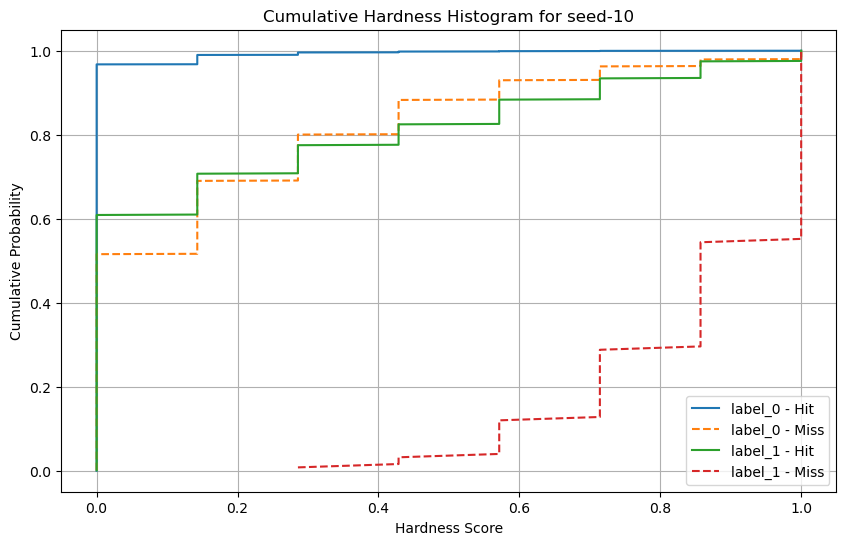

Hardness médio para seed-11: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\12


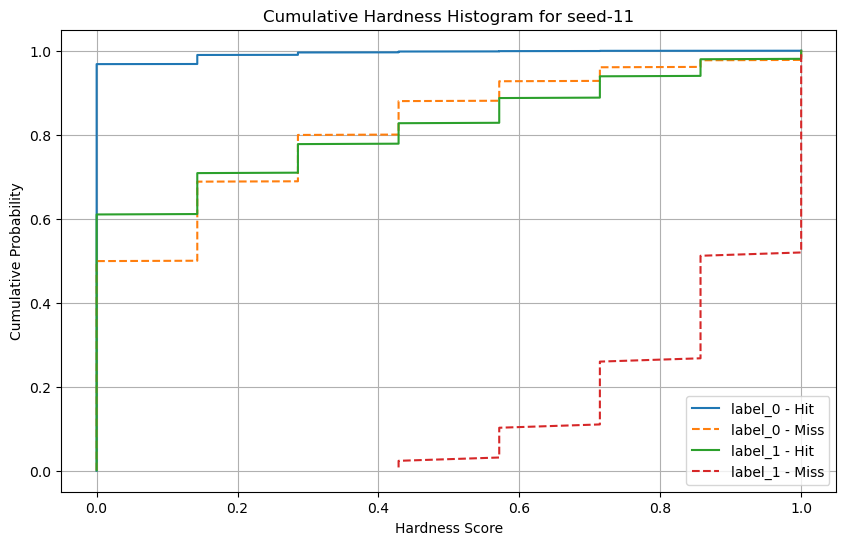

Hardness médio para seed-12: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\13


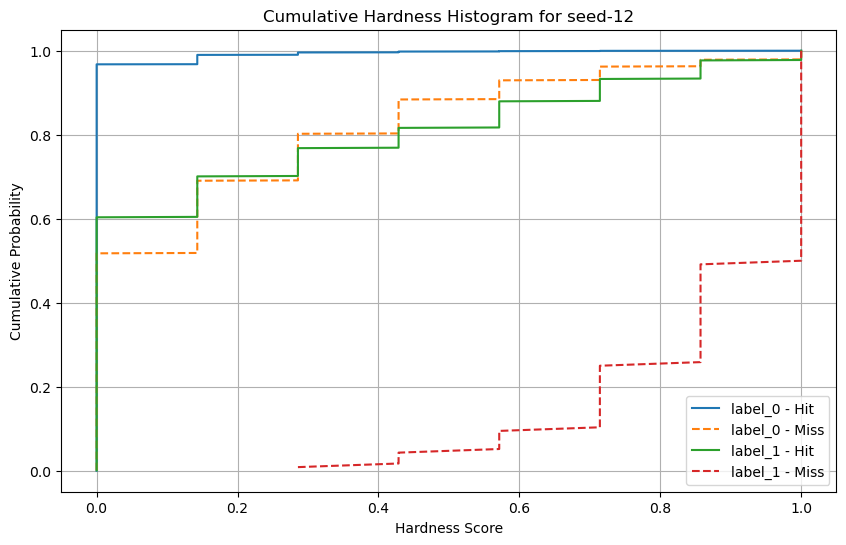

Hardness médio para seed-13: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\14


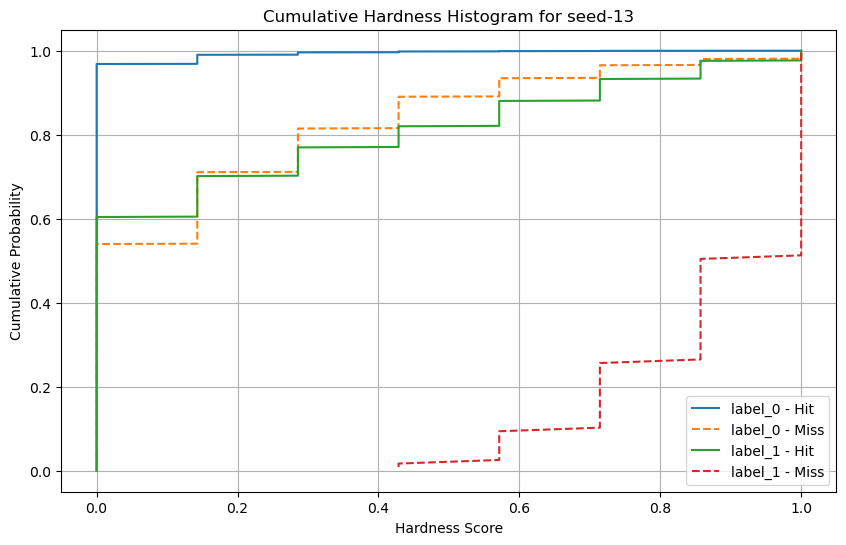

Hardness médio para seed-14: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\15


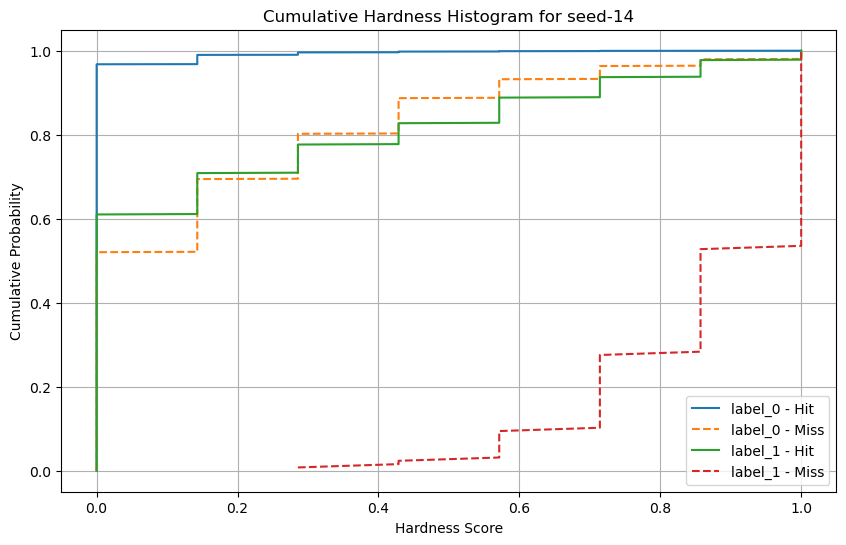

Hardness médio para seed-15: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\16


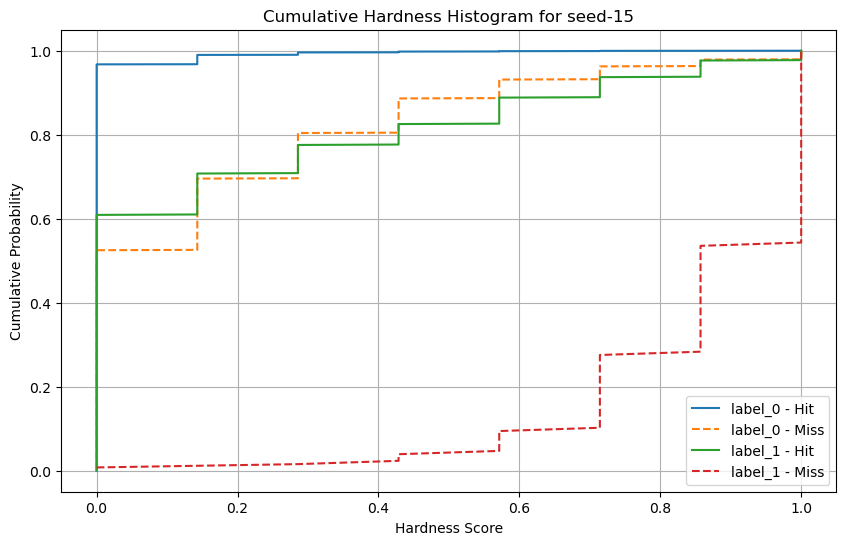

Hardness médio para seed-16: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\17


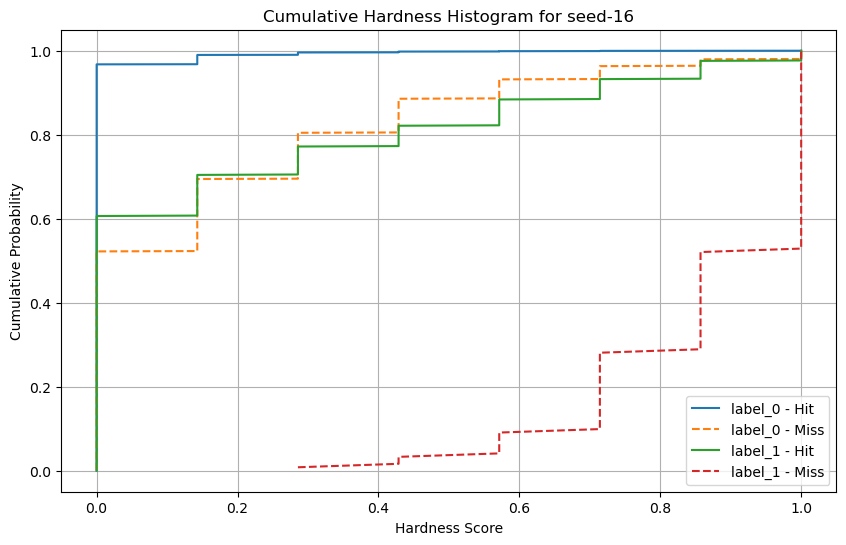

Hardness médio para seed-17: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\18


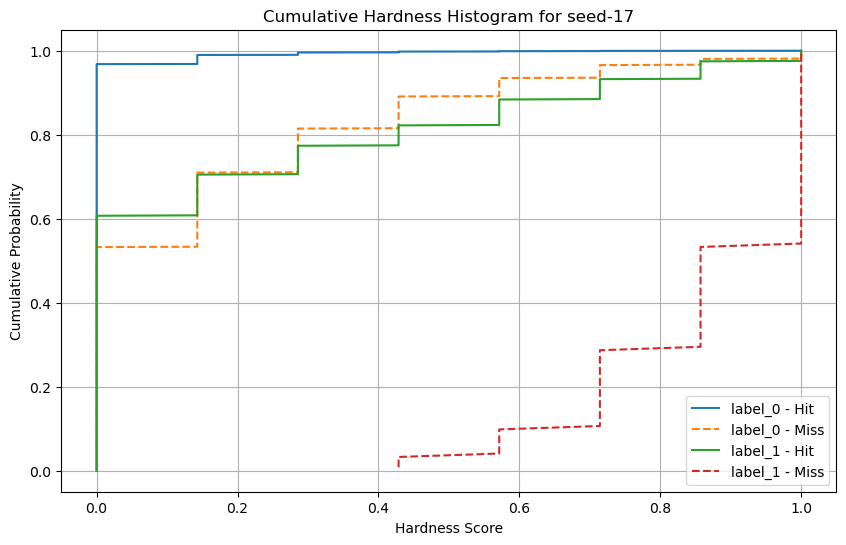

Hardness médio para seed-18: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\19


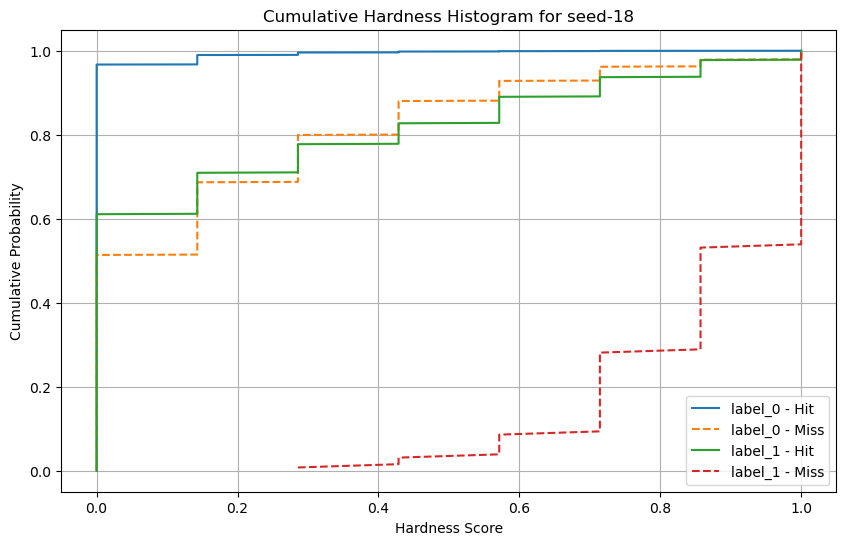

Hardness médio para seed-19: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\20


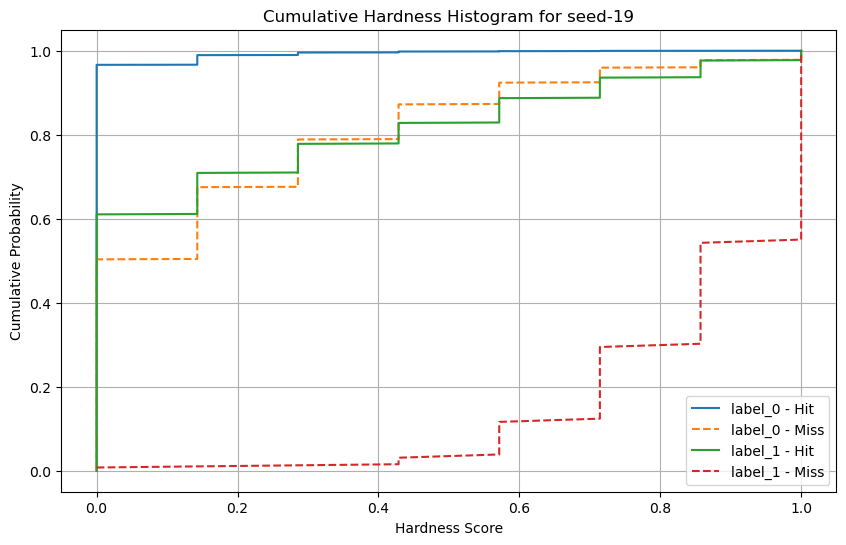

Hardness médio para seed-20: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\21


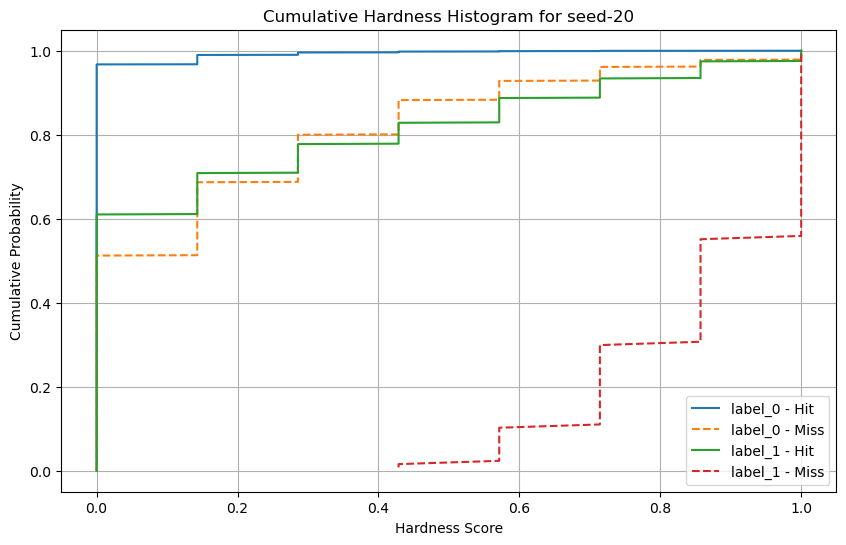

Hardness médio para seed-21: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\22


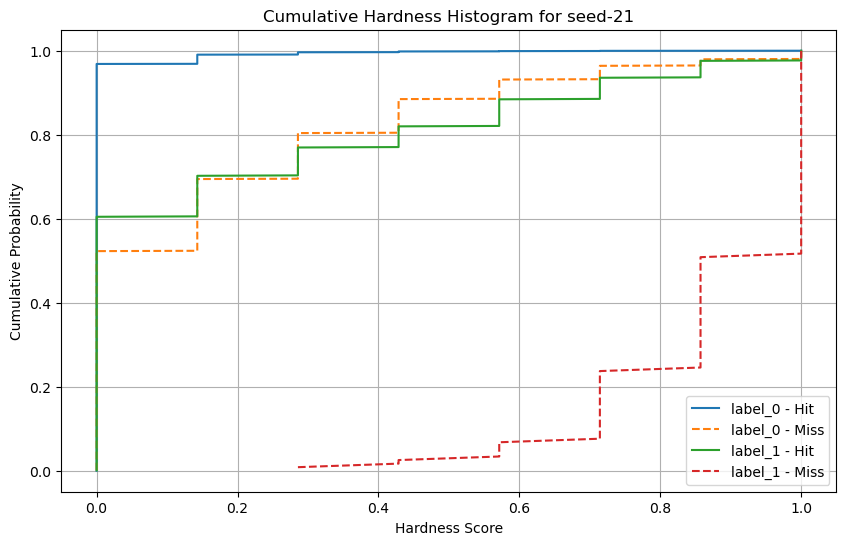

Hardness médio para seed-22: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\23


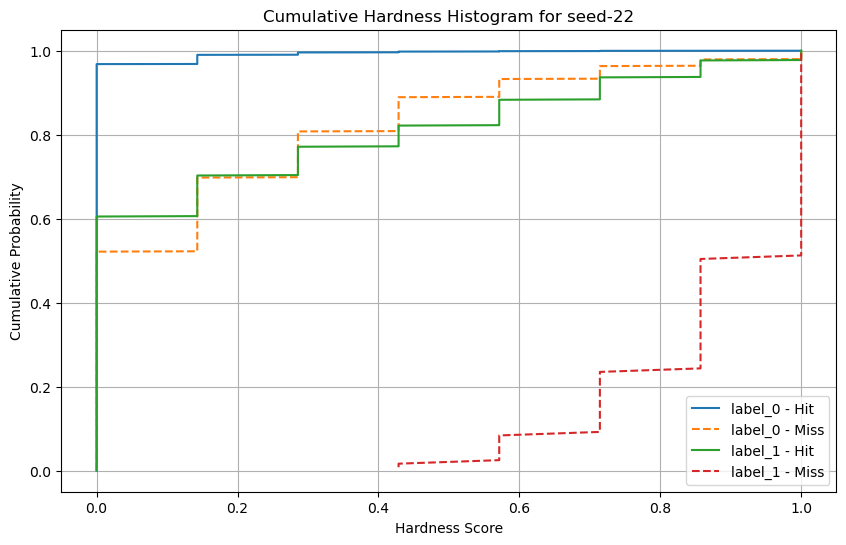

Hardness médio para seed-23: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\24


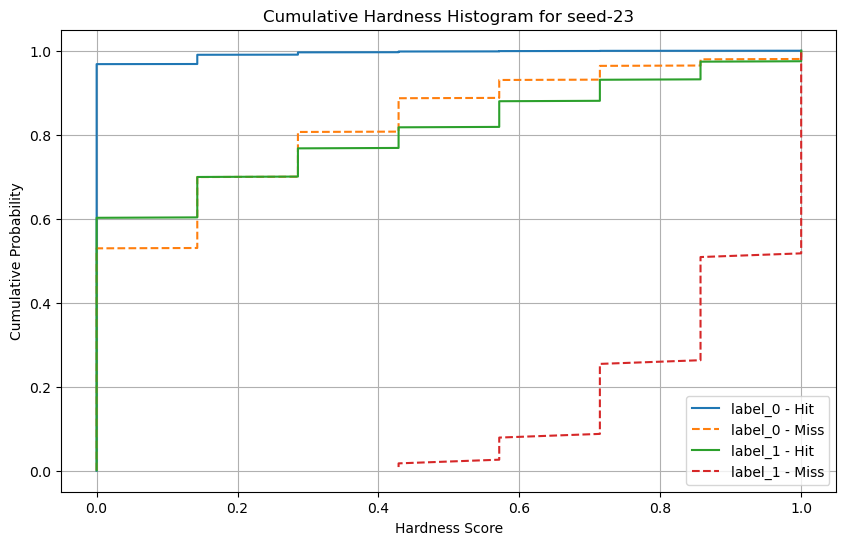

Hardness médio para seed-24: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\25


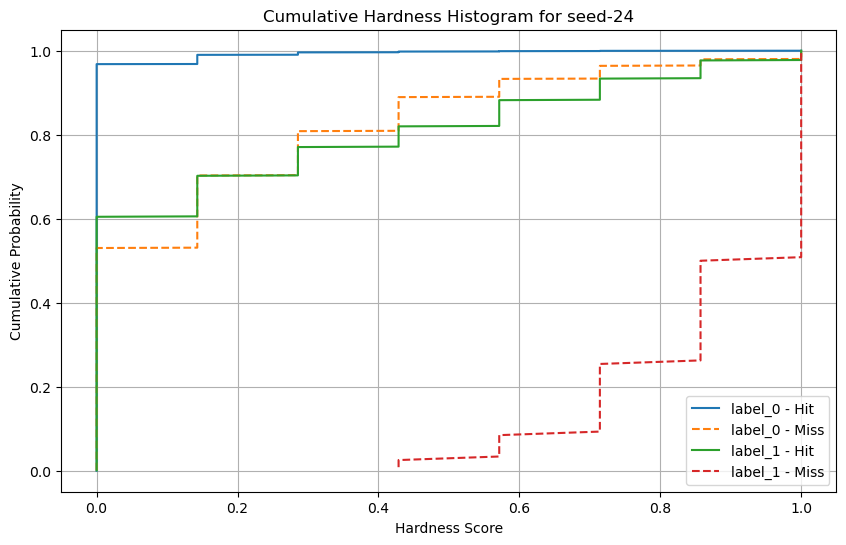

Hardness médio para seed-25: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\26


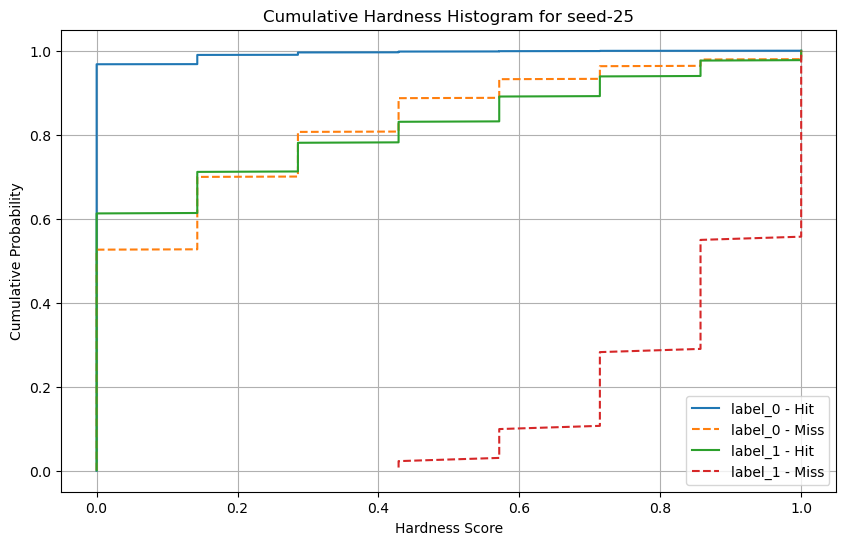

Hardness médio para seed-26: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\27


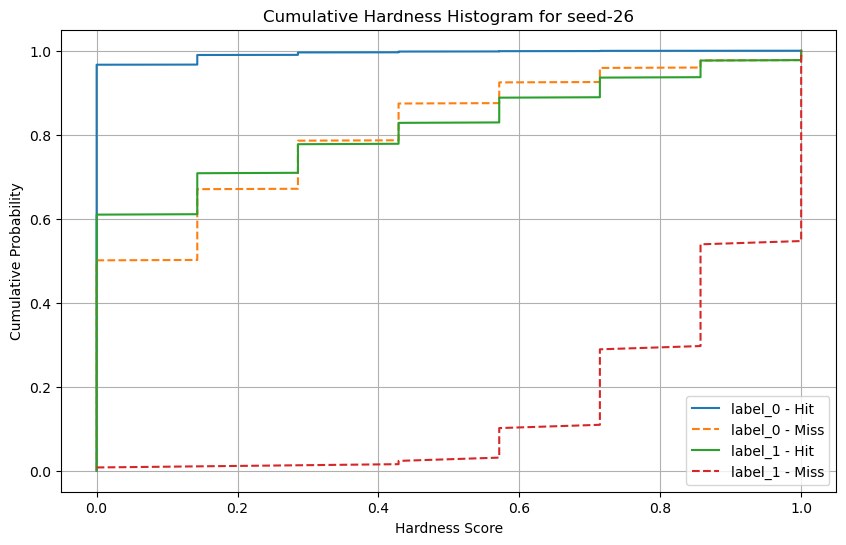

Hardness médio para seed-27: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\28


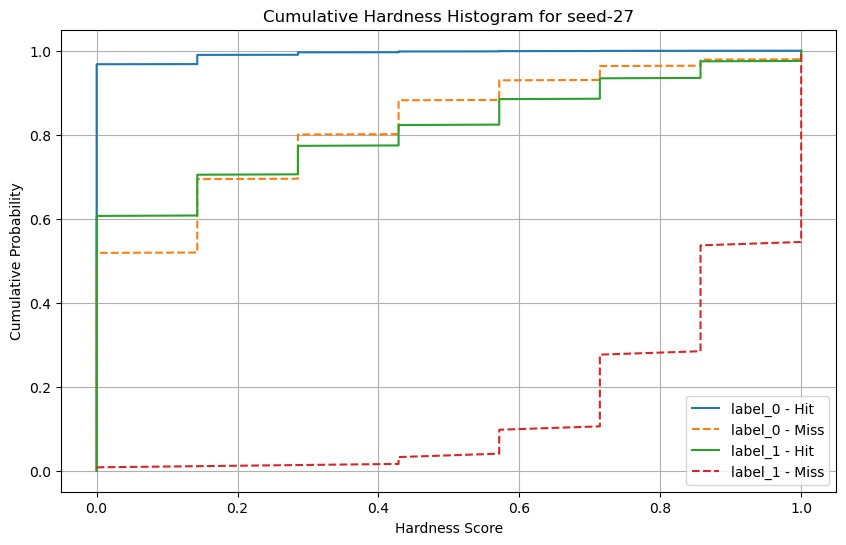

Hardness médio para seed-28: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\29


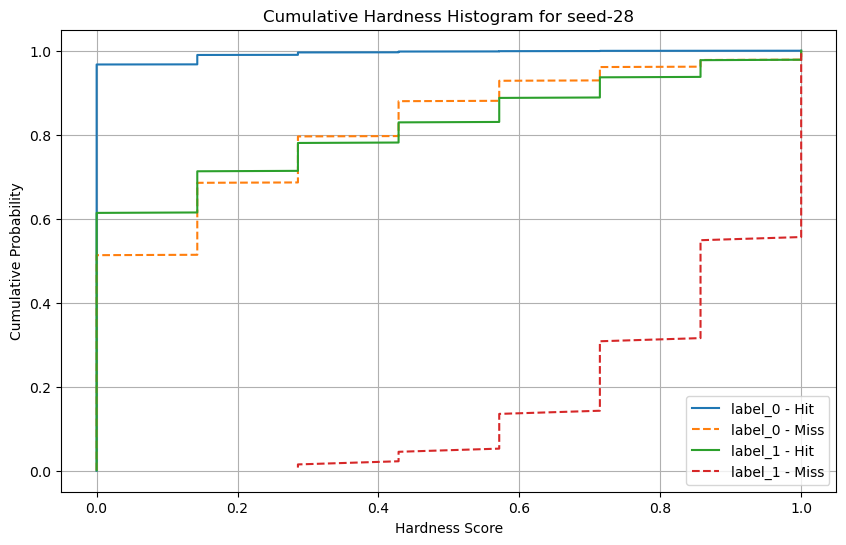

Hardness médio para seed-29: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\MLP\30


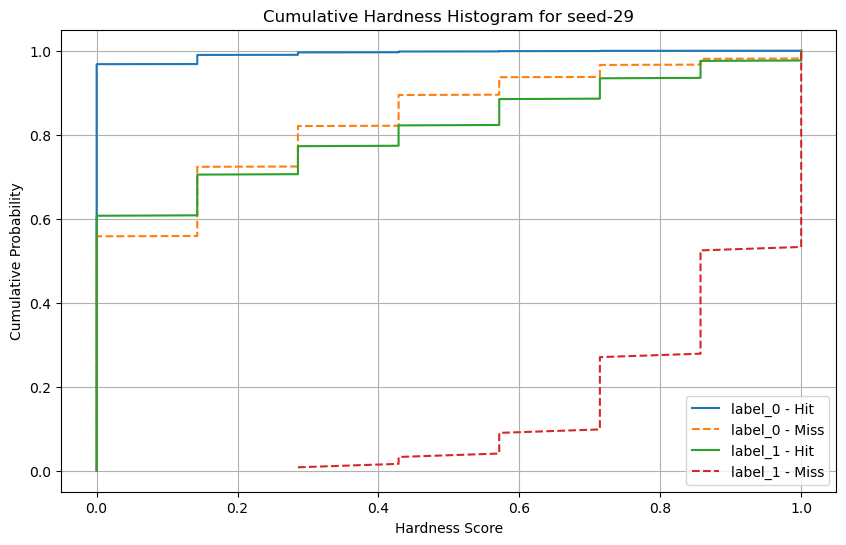

Processando pasta: NaiveBayes
Hardness médio para seed-0: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\1


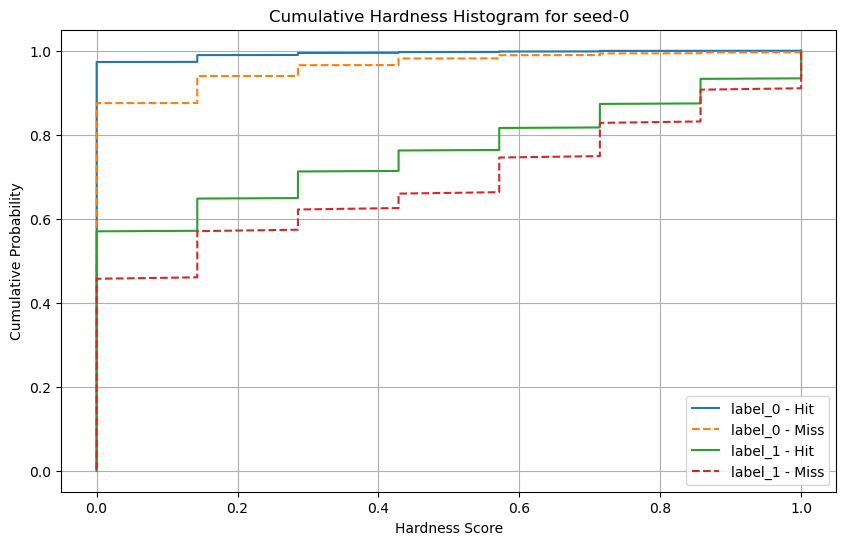

Hardness médio para seed-1: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\2


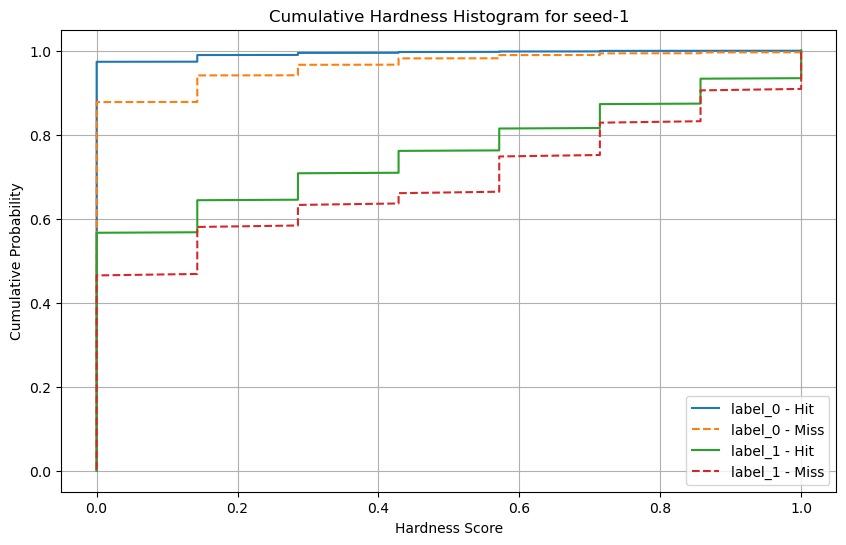

Hardness médio para seed-2: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\3


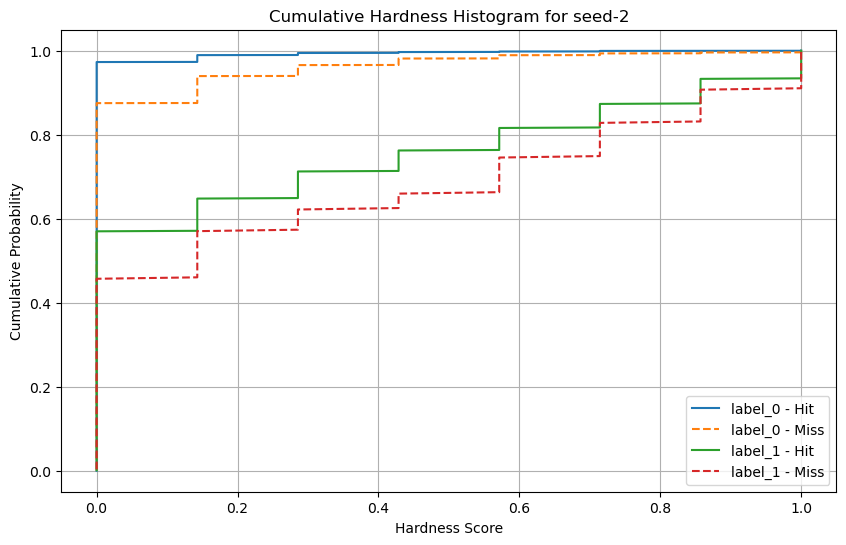

Hardness médio para seed-3: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\4


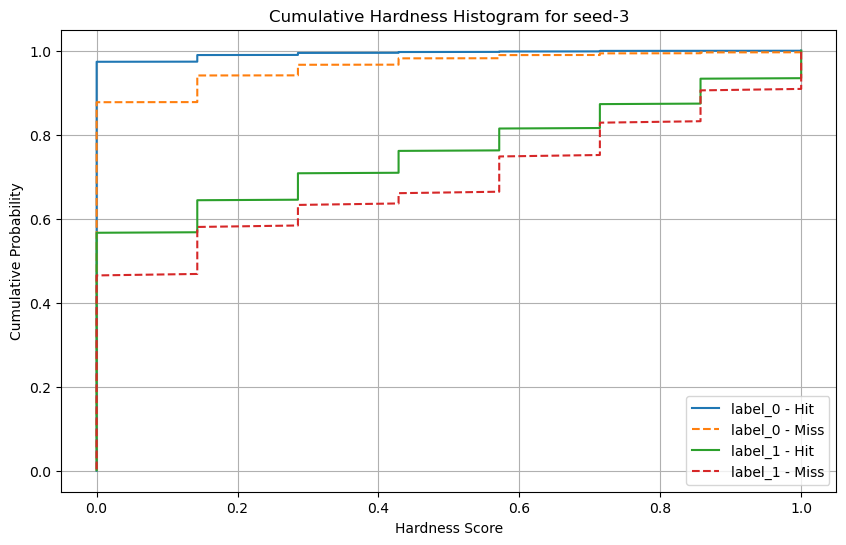

Hardness médio para seed-4: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\5


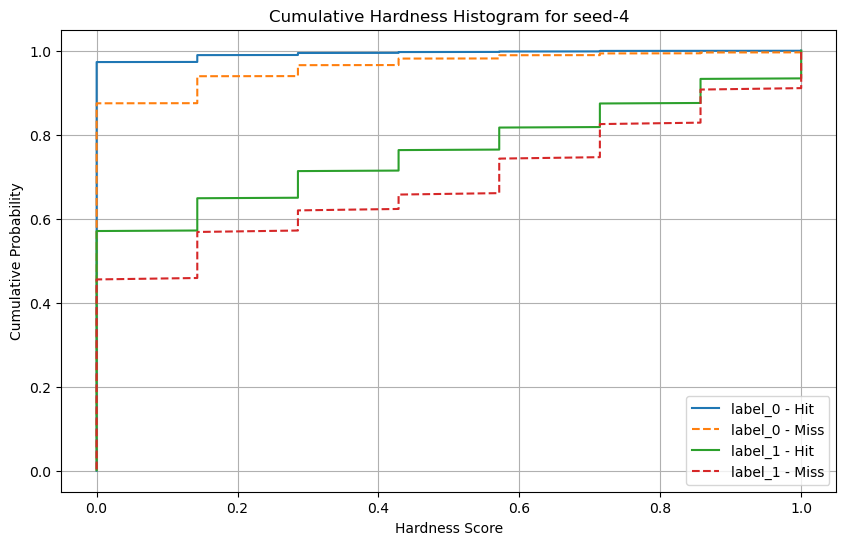

Hardness médio para seed-5: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\6


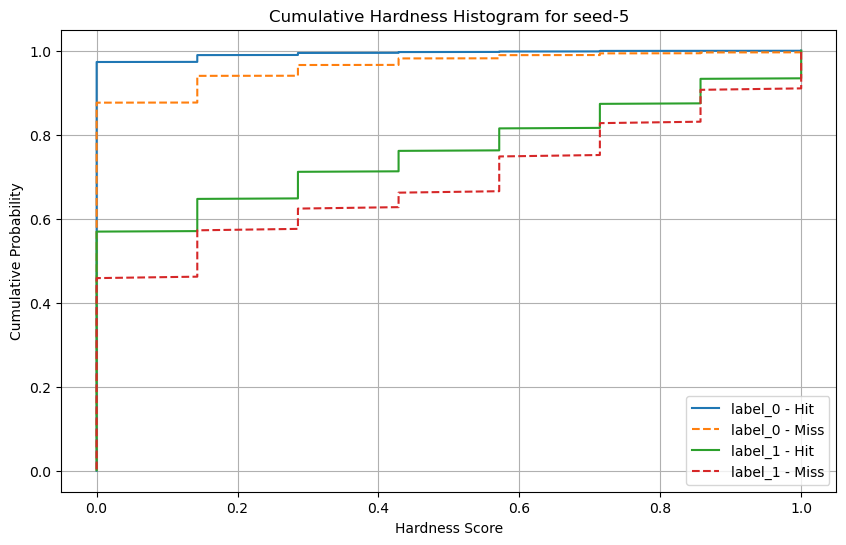

Hardness médio para seed-6: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\7


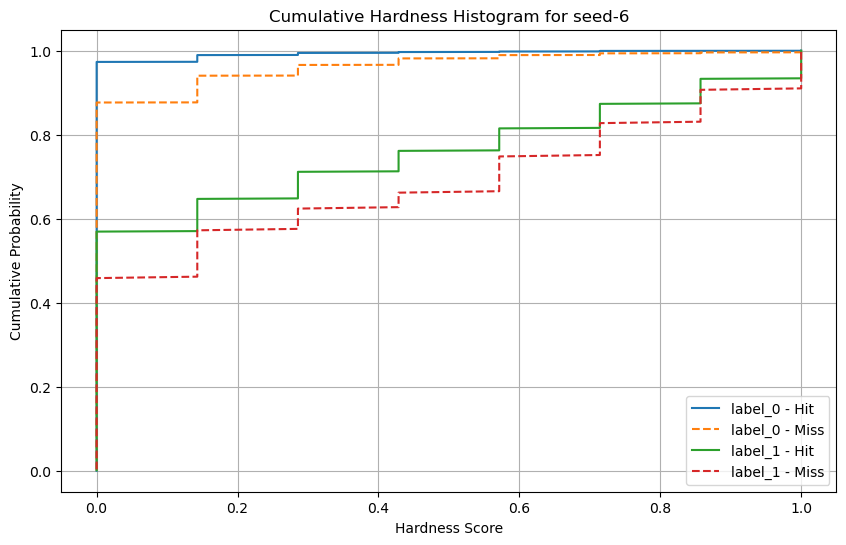

Hardness médio para seed-7: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\8


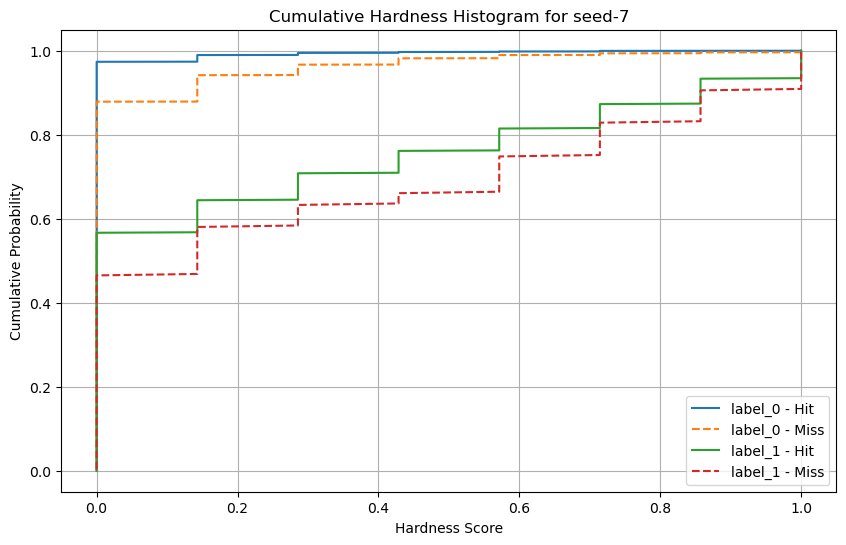

Hardness médio para seed-8: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\9


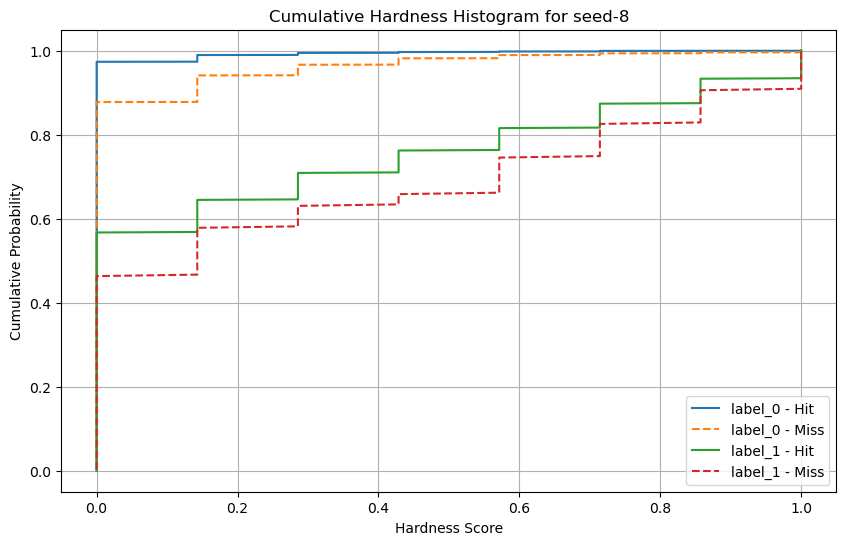

Hardness médio para seed-10: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\11


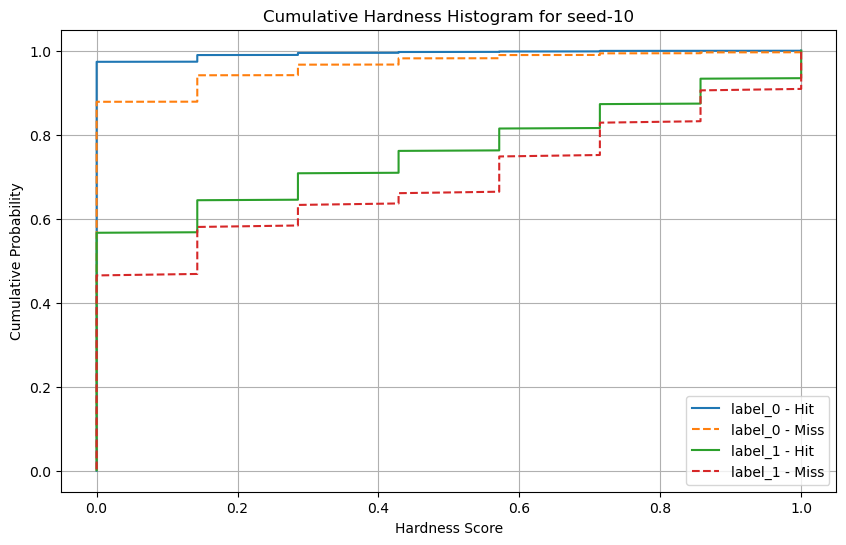

Hardness médio para seed-11: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\12


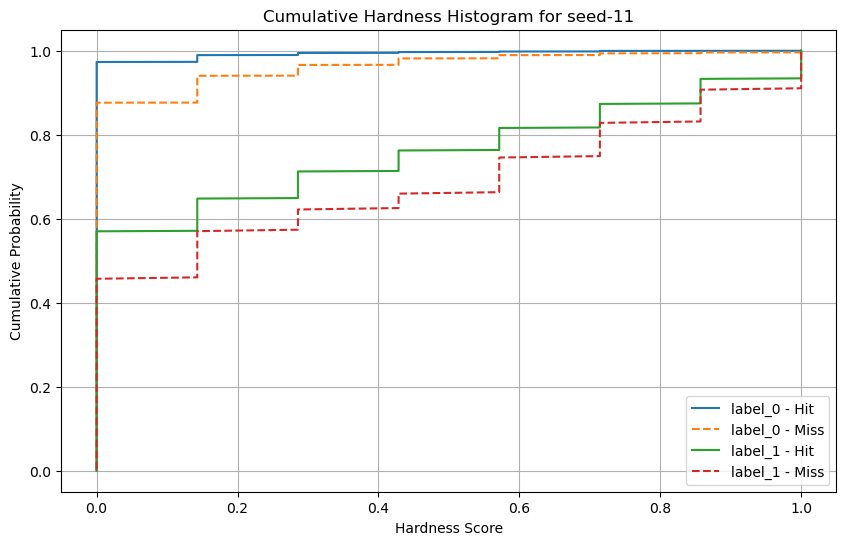

Hardness médio para seed-12: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\13


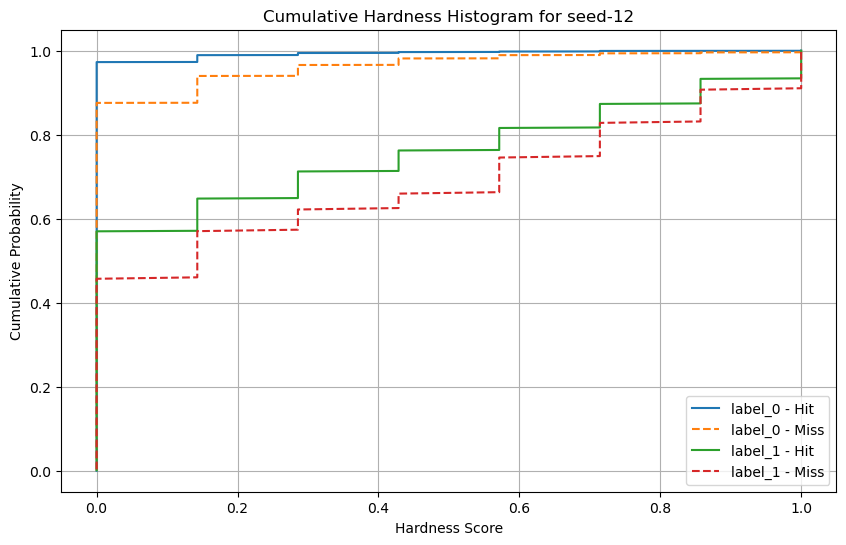

Hardness médio para seed-13: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\14


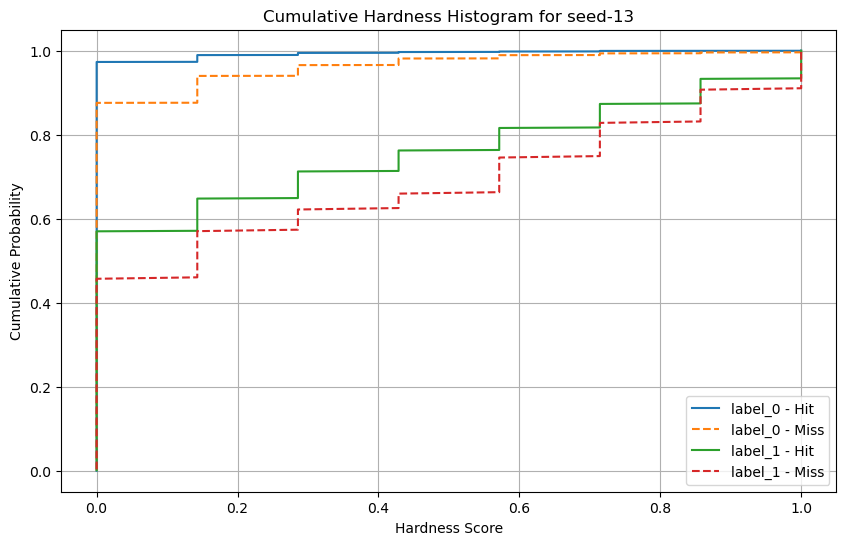

Hardness médio para seed-14: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\15


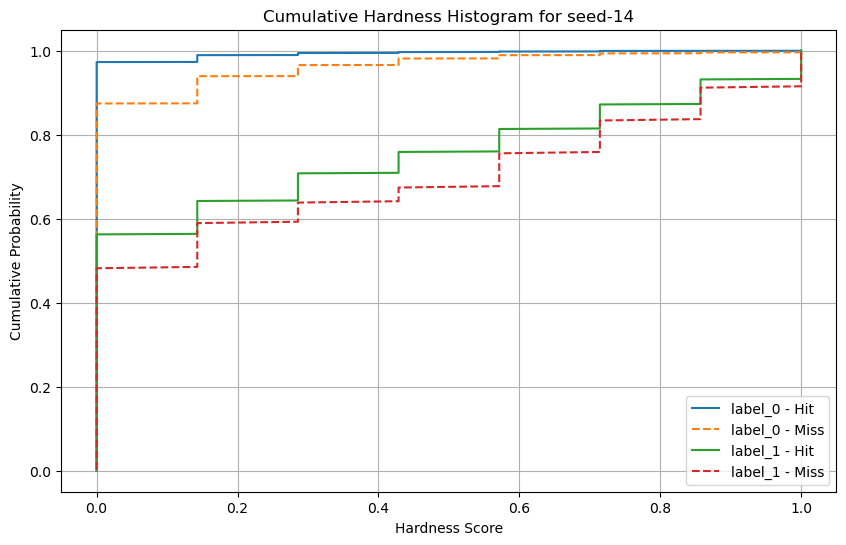

Hardness médio para seed-15: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\16


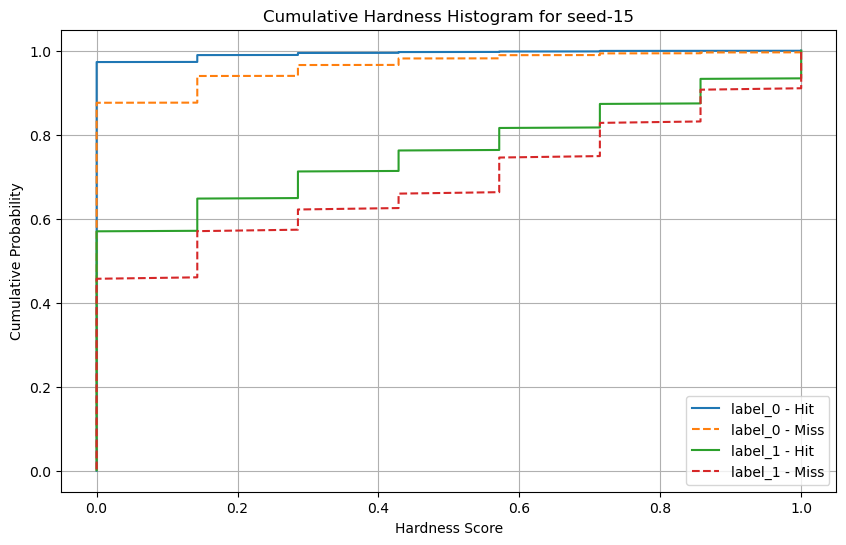

Hardness médio para seed-16: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\17


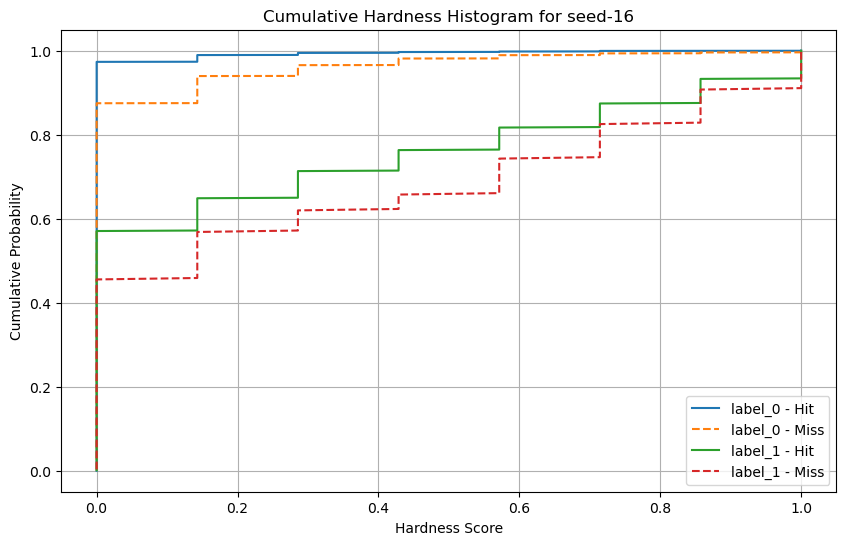

Hardness médio para seed-17: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\18


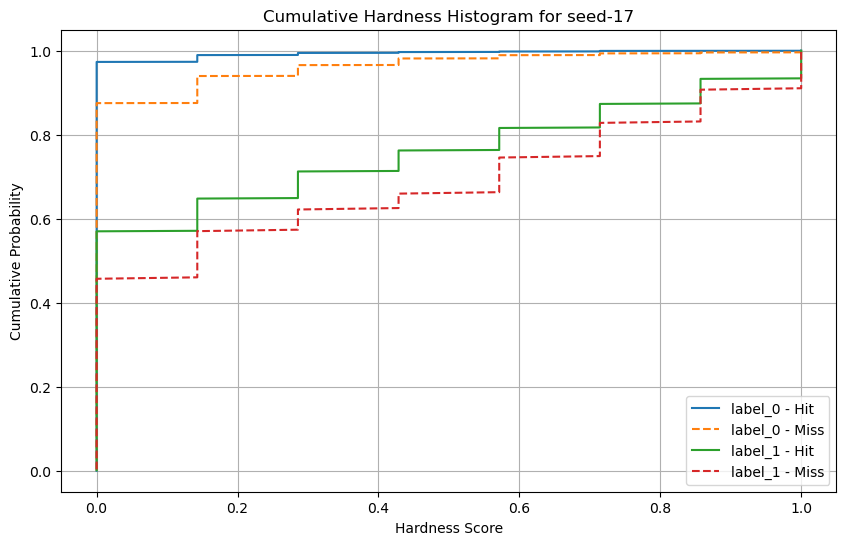

Hardness médio para seed-18: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\19


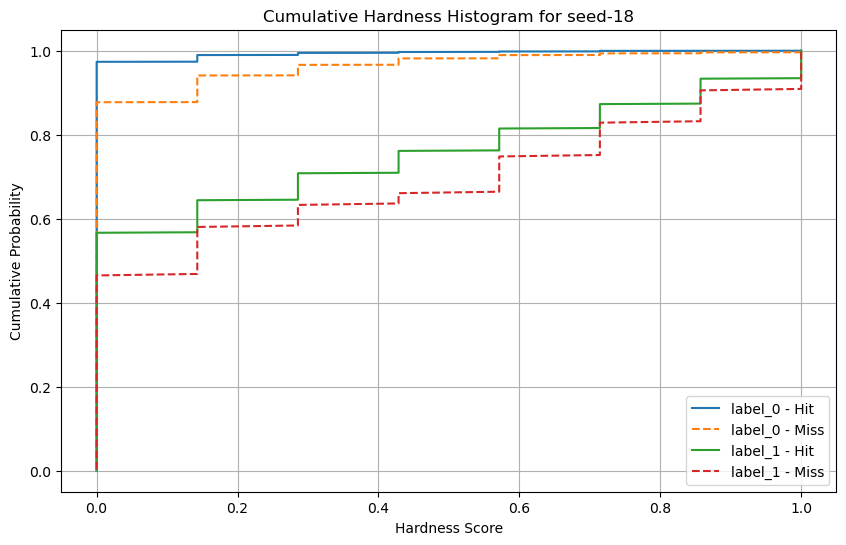

Hardness médio para seed-19: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\20


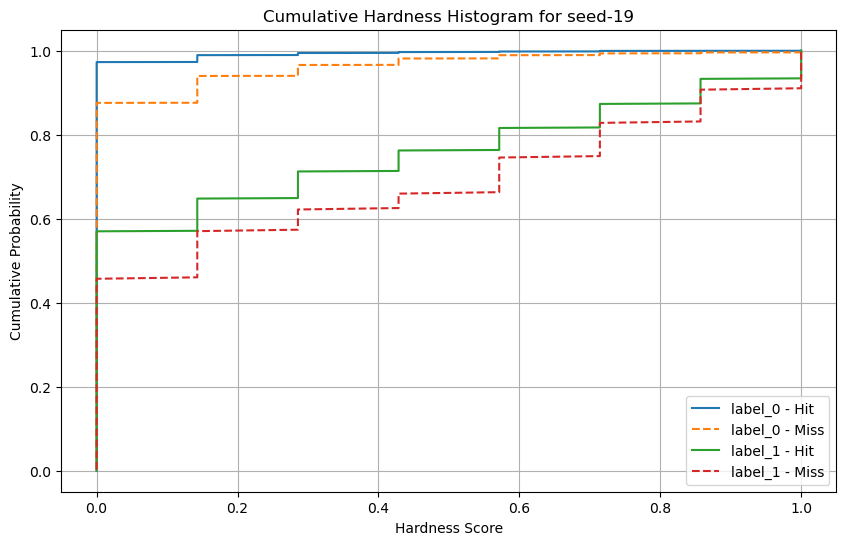

Hardness médio para seed-20: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\21


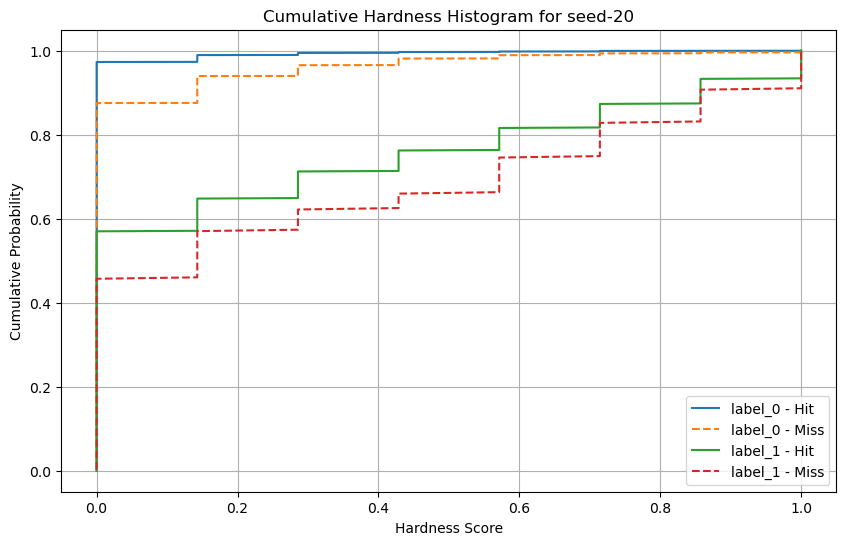

Hardness médio para seed-21: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\22


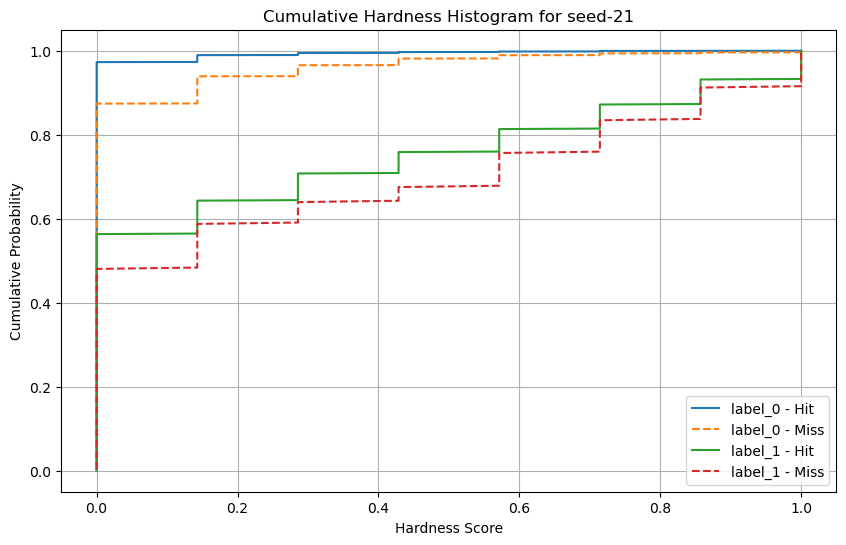

Hardness médio para seed-22: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\23


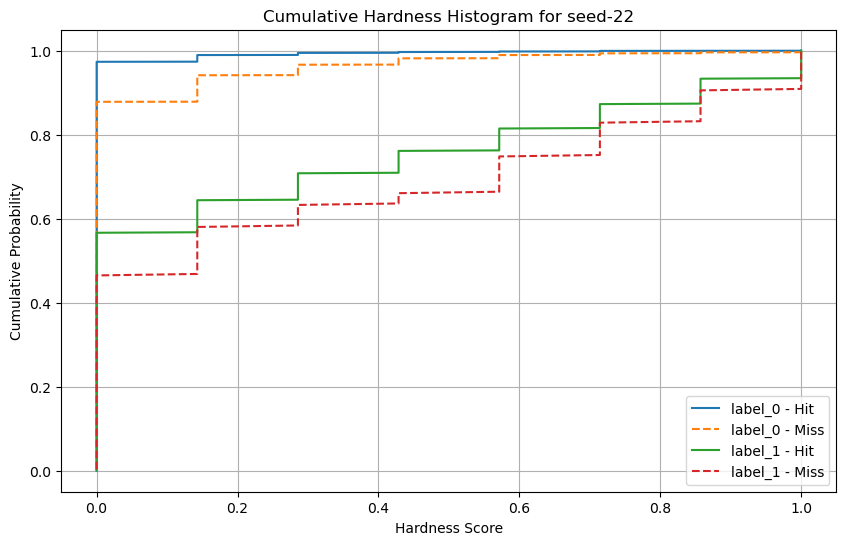

Hardness médio para seed-23: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\24


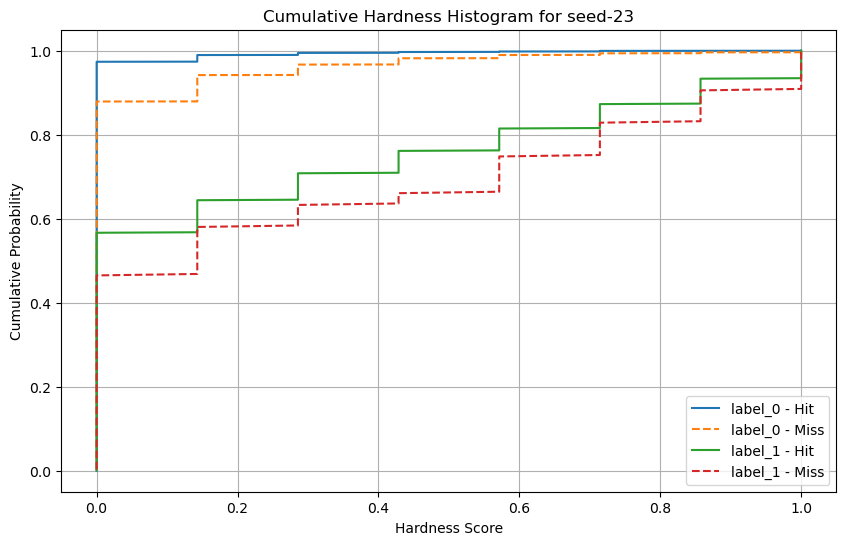

Hardness médio para seed-24: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\25


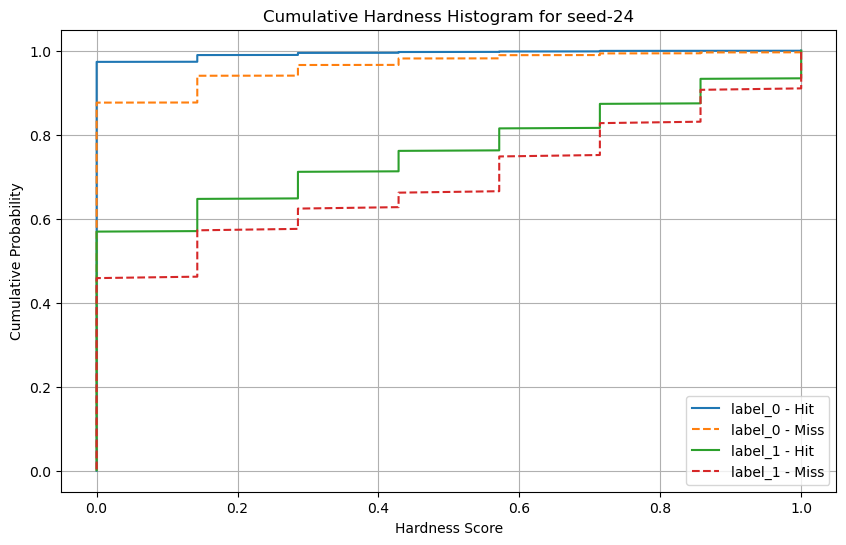

Hardness médio para seed-25: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\26


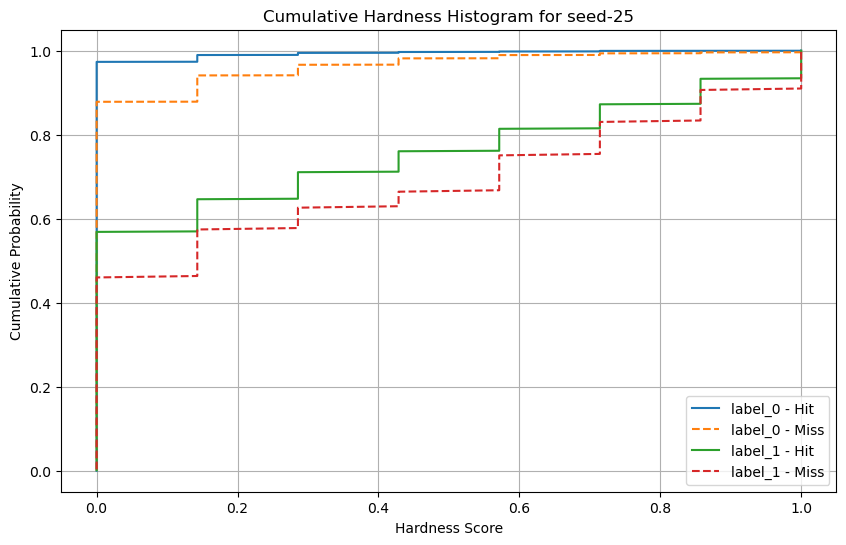

Hardness médio para seed-26: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\27


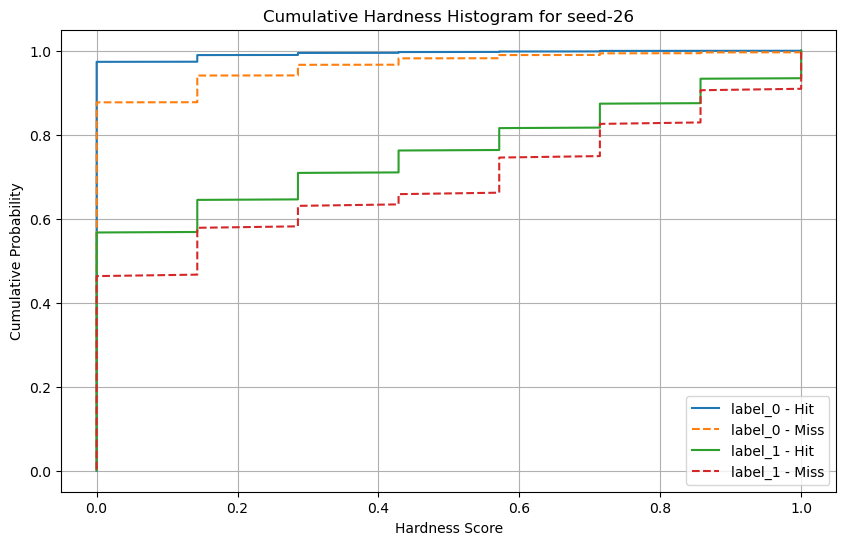

Hardness médio para seed-27: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\28


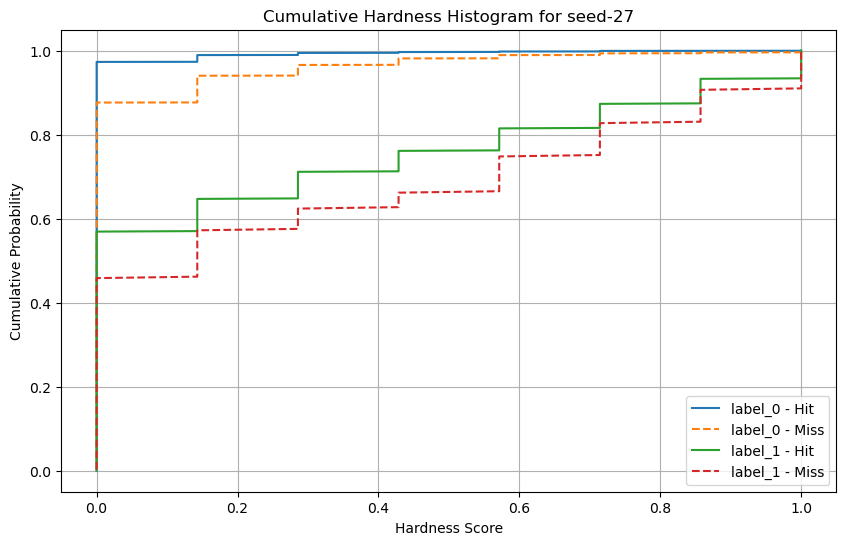

Hardness médio para seed-28: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\29


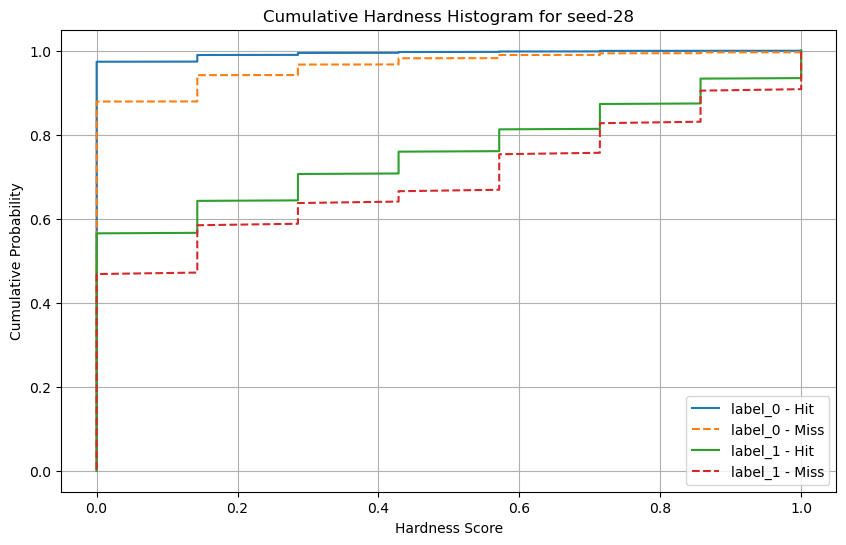

Hardness médio para seed-29: 0.0257
Arquivo de modelo encontrado: E:\DrebinStudy\Balanced\Bagging2\NaiveBayes\30


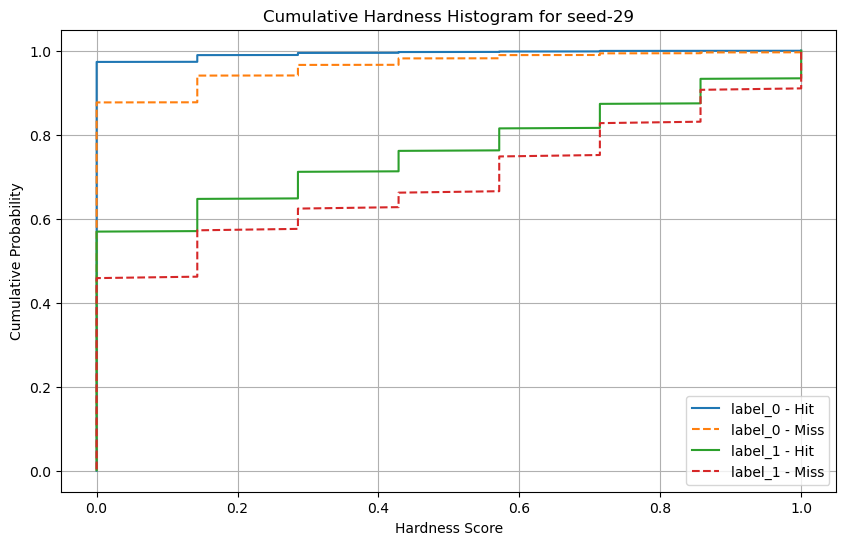

In [32]:
import os
import joblib
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

models = {}

# Função para ler os dados
x0, y0 = read(LOAD_DATA=False)

with open('modelPredictBalanced.json', 'r') as f:
    model_predict = json.load(f)


# Caminho do diretório com os modelos
dir_path = r'E:\DrebinStudy\Balanced\Bagging2'

def natural_sort_key(s):
    return int(s)

with open('test_kdn_scores_bagging2.json', 'r') as f:
    kdn_scores = json.load(f)

# Função para criar o gráfico cumulativo para uma seed específica
def plot_cumulative_histogram_single_seed(hardness_table, seed):
    plt.figure(figsize=(10, 6))

    for label in ['label_0', 'label_1']:
        # Hits para a seed especificada
        hit_scores = hardness_table[label]['Hit'][seed]
        sorted_hits = np.sort(hit_scores)
        cumulative_hits = np.arange(1, len(sorted_hits) + 1) / len(sorted_hits)
        plt.plot(sorted_hits, cumulative_hits, label=f"{label} - Hit")

        # Misses para a seed especificada
        miss_scores = hardness_table[label]['Miss'][seed]
        sorted_misses = np.sort(miss_scores)
        cumulative_misses = np.arange(1, len(sorted_misses) + 1) / len(sorted_misses)
        plt.plot(sorted_misses, cumulative_misses, label=f"{label} - Miss", linestyle='--')

    # Configurações do gráfico
    plt.title(f'Cumulative Hardness Histogram for {seed}')
    plt.xlabel('Hardness Score')
    plt.ylabel('Cumulative Probability')
    plt.legend()
    plt.grid(True)
    plt.show()

# Loop para percorrer todas as pastas no diretório (tirando 'Metrics')
for folder_name in os.listdir(dir_path):
    folder_path = os.path.join(dir_path, folder_name)
    
    # Verifica se é uma pasta e se não é a pasta 'Metrics'
    if os.path.isdir(folder_path) and folder_name != 'Metrics' and folder_name != 'Bagging2' and folder_name != 'KNOP' and folder_name != 'METADES' and folder_name != '10':
        print(f'Processando pasta: {folder_name}')
        i = 0
        hardness_table = {'label_0': {'Hit':{}, 'Miss':{}}, 'label_1': {'Hit':{}, 'Miss':{}}}

        if folder_path not in list(model_predict.keys()):
            model_predict[folder_path] = dict()
        # Processar os modelos dentro da pasta
        for file_name in sorted(os.listdir(folder_path), key=natural_sort_key):
            if file_name in list(model_predict[folder_path].keys()) or file_name == '10':
                i += 1
                continue
            file_path = os.path.join(folder_path, file_name)
            x_train, x_test, y_train, y_test = train_test_split(
                np.arange(len(x0)), y0, test_size=0.2, stratify=y0, random_state=42)
            hardness_score = np.array(list(kdn_scores[f"seed-42"].values()))
            
            loaded_estimators = []
            for j in range(30):
                model_path = os.path.join(file_path, f'model_{j+1}.joblib')
                Bagging = joblib.load(model_path)
                loaded_estimators.append(Bagging)

            # Fazer a previsão combinada
            y_preds = np.array([estimator.predict(x0[x_test]) for estimator in loaded_estimators])
            y_pred = np.apply_along_axis(lambda x: np.bincount(x).argmax(), axis=0, arr=y_preds)
            indices_diferentes = np.where(y_pred != y_test)[0].tolist()

            model_predict[folder_path][file_name] = indices_diferentes

            with open("modelPredictBalanced.json", "w") as file:
                json.dump(model_predict, file, indent=4)

            # Separar os scores por label
            for label in [0, 1]:
                hit_scores = hardness_score[(y_test == y_pred) & (y_test == label)]
                miss_scores = hardness_score[(y_test != y_pred) & (y_test == label)]
                hardness_table[f'label_{label}']['Hit'][f'seed-{str(i)}'] = hit_scores
                hardness_table[f'label_{label}']['Miss'][f'seed-{str(i)}'] = miss_scores

            print(f"Hardness médio para seed-{i}: {np.mean(hardness_score):.4f}")
            i += 1   
            print(f'Arquivo de modelo encontrado: {file_path}')
            
            # Gerar gráfico cumulativo para o modelo atual
            plot_cumulative_histogram_single_seed(hardness_table, f'seed-{i-1}')  # Mostrar para o último seed processado
        
        # Salvar a hardness_table por pasta
        models[folder_name] = hardness_table
        with open("models_hardness_table.json", "w") as file:
                json.dump(model_predict, file, indent=4)


In [ ]:
import os
import joblib
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

with open('models_hardness_table.json', 'r') as f:
    models = json.load(f)

# Função para ler os dados
x0, y0 = read(LOAD_DATA=False)

with open('modelPredictBalanced.json', 'r') as f:
    model_predict = json.load(f)


# Caminho do diretório com os modelos
dir_path = r'E:\DrebinStudy\Balanced\Bagging2'

def natural_sort_key(s):
    return int(s)

with open('test_kdn_scores_bagging2.json', 'r') as f:
    kdn_scores = json.load(f)

# Loop para percorrer todas as pastas no diretório (tirando 'Metrics')
for folder_name in os.listdir(dir_path):
    folder_path = os.path.join(dir_path, folder_name)
    
    # Verifica se é uma pasta e se não é a pasta 'Metrics'
    if os.path.isdir(folder_path) and folder_name != 'Metrics' and folder_name != 'Bagging2' and folder_name != 'KNOP' and folder_name != 'METADES' and folder_name != '10':
        print(f'Processando pasta: {folder_name}')
        i = 0
        hardness_table = {'label_0': {'Hit':{}, 'Miss':{}}, 'label_1': {'Hit':{}, 'Miss':{}}}

        if folder_path not in list(model_predict.keys()):
            model_predict[folder_path] = dict()
        # Processar os modelos dentro da pasta
        for file_name in sorted(os.listdir(folder_path), key=natural_sort_key):
            if file_name in list(model_predict[folder_path].keys()) or file_name == '10':
                i += 1
                continue
            file_path = os.path.join(folder_path, file_name)
            x_train, x_test, y_train, y_test = train_test_split(
                np.arange(len(x0)), y0, test_size=0.2, stratify=y0, random_state=42)
            hardness_score = np.array(list(kdn_scores[f"seed-42"].values()))
            
            loaded_estimators = []
            for j in range(30):
                model_path = os.path.join(file_path, f'model_{j+1}.joblib')
                Bagging = joblib.load(model_path)
                loaded_estimators.append(Bagging)

            # Fazer a previsão combinada
            y_preds = np.array([estimator.predict(x0[x_test]) for estimator in loaded_estimators])
            y_pred = np.apply_along_axis(lambda x: np.bincount(x).argmax(), axis=0, arr=y_preds)
            indices_diferentes = np.where(y_pred != y_test)[0].tolist()

            model_predict[folder_path][file_name] = indices_diferentes

            with open("modelPredictBalanced.json", "w") as file:
                json.dump(model_predict, file, indent=4)

            # Separar os scores por label
            for label in [0, 1]:
                hit_scores = hardness_score[(y_test == y_pred) & (y_test == label)]
                miss_scores = hardness_score[(y_test != y_pred) & (y_test == label)]
                hardness_table[f'label_{label}']['Hit'][f'seed-{str(i)}'] = hit_scores
                hardness_table[f'label_{label}']['Miss'][f'seed-{str(i)}'] = miss_scores

            print(f"Hardness médio para seed-{i}: {np.mean(hardness_score):.4f}")
            i += 1   
            print(f'Arquivo de modelo encontrado: {file_path}')
            
            # Gerar gráfico cumulativo para o modelo atual
            plot_cumulative_histogram_single_seed(hardness_table, f'seed-{i-1}')  # Mostrar para o último seed processado
        
        # Salvar a hardness_table por pasta
        models[folder_name] = hardness_table
        with open("models_hardness_table.json", "w") as file:
                json.dump(model_predict, file, indent=4)


In [ ]:
import os
import joblib
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

models = {}

# Função para ler os dados
x0, y0 = read(LOAD_DATA=False)

# Caminho do diretório com os modelos
dir_path = r'E:\DrebinStudy\Balanced'

# Função para criar o gráfico cumulativo para uma seed específica
def plot_cumulative_histogram_single_seed(hardness_table, seed):
    plt.figure(figsize=(10, 6))

    for label in ['label_0', 'label_1']:
        # Hits para a seed especificada
        hit_scores = hardness_table[label]['Hit'][seed]
        sorted_hits = np.sort(hit_scores)
        cumulative_hits = np.arange(1, len(sorted_hits) + 1) / len(sorted_hits)
        plt.plot(sorted_hits, cumulative_hits, label=f"{label} - Hit")

        # Misses para a seed especificada
        miss_scores = hardness_table[label]['Miss'][seed]
        sorted_misses = np.sort(miss_scores)
        cumulative_misses = np.arange(1, len(sorted_misses) + 1) / len(sorted_misses)
        plt.plot(sorted_misses, cumulative_misses, label=f"{label} - Miss", linestyle='--')

    # Configurações do gráfico
    plt.title(f'Cumulative Hardness Histogram for {seed}')
    plt.xlabel('Hardness Score')
    plt.ylabel('Cumulative Probability')
    plt.legend()
    plt.grid(True)
    plt.show()

# Loop para percorrer todas as pastas no diretório (tirando 'Metrics')
for folder_name in ['RandomForest', 'MLP', 'NaiveBayes']:
    folder_path = os.path.join(dir_path, folder_name)
    
    # Verifica se é uma pasta e se não é a pasta 'Metrics'
    if os.path.isdir(folder_path) and folder_name != 'Metrics' and folder_name != 'Bagging2':
        print(f'Processando pasta: {folder_name}')
        i = 0
        hardness_table = {'label_0': {'Hit':{}, 'Miss':{}}, 'label_1': {'Hit':{}, 'Miss':{}}}

        # Processar os modelos dentro da pasta
        for file_name in os.listdir(folder_path):
            file_path = os.path.join(folder_path, file_name)
            x_train, x_test, y_train, y_test = train_test_split(x0, y0, test_size=0.2, stratify=y0, random_state=i)
            hardness_score = kdn_score(x_test, y_test, k=7)[0]
            model = joblib.load(file_path)
            y_pred = model.predict(x_test)

            # Separar os scores por label
            for label in [0, 1]:
                hit_scores = hardness_score[(y_test == y_pred) & (y_test == label)]
                miss_scores = hardness_score[(y_test != y_pred) & (y_test == label)]
                hardness_table[f'label_{label}']['Hit'][f'seed-{str(i)}'] = hit_scores
                hardness_table[f'label_{label}']['Miss'][f'seed-{str(i)}'] = miss_scores

            print(f"Hardness médio para seed-{i}: {np.mean(hardness_score):.4f}")
            i += 1   
            print(f'Arquivo de modelo encontrado: {file_path}')
            
            # Gerar gráfico cumulativo para o modelo atual
            plot_cumulative_histogram_single_seed(hardness_table, f'seed-{i-1}')  # Mostrar para o último seed processado
        
        # Salvar a hardness_table por pasta
        models[folder_name] = hardness_table

In [ ]:
DES = {
    "SingleBest": SingleBest,
    "StaticSelection": StaticSelection,
    "OLA": OLA,
    # "KNORAU": KNORAU,
    # "KNORAE": KNORAE,
    "KNOP": KNOP,
    "METADES": METADES
}

In [ ]:
x_all, y_all = read(LOAD_DATA=False)


for name, classifier in DES.items():
        print(f'Processando modelo: {name}')
        hardness_table = {'label_0': {'Hit':{}, 'Miss':{}}, 'label_1': {'Hit':{}, 'Miss':{}}}

        # Processar os modelos dentro da pasta
        for i in range(30):
            x_train, x_test, y_train, y_test = train_test_split(x0, y0, test_size=0.2, stratify=y0, random_state=i)
            smote = SMOTE(sampling_strategy='auto', k_neighbors=5)
            x_train, y_train = smote.fit_resample(x_train, y_train)
            hardness_score = kdn_score(x_test, y_test, k=7)[0]
            ensemble = RandomForestClassifier(n_estimators=100)
            ensemble.fit(x_train, y_train)
            des_model = model(ensemble)
            des_model.fit(x_train, y_train)
            
            y_pred = des_model.predict(x_test)

            # Separar os scores por label
            for label in [0, 1]:
                hit_scores = hardness_score[(y_test == y_pred) & (y_test == label)]
                miss_scores = hardness_score[(y_test != y_pred) & (y_test == label)]
                hardness_table[f'label_{label}']['Hit'][f'seed-{str(i)}'] = hit_scores
                hardness_table[f'label_{label}']['Miss'][f'seed-{str(i)}'] = miss_scores

            print(f"Hardness médio para seed-{i}: {np.mean(hardness_score):.4f}")            
            # Gerar gráfico cumulativo para o modelo atual
            plot_cumulative_histogram_single_seed(hardness_table, f'seed-{i}')  # Mostrar para o último seed processado
        
        # Salvar a hardness_table por pasta
        models[name] = hardness_table

In [ ]:
import plotly.express as px
import pandas as pd
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler

# Opcional: normalizar os dados
scaler = StandardScaler()
x_scaled = scaler.fit_transform(x)

# Aplicar t-SNE ou UMAP
tsne = TSNE(n_components=3, random_state=42)
x_embedded = tsne.fit_transform(x_scaled)

# Colocar o resultado em um DataFrame para visualização
df = pd.DataFrame(x_embedded, columns=['Dim1', 'Dim2', 'Dim3'])
df['Label'] = y  # Adicionar rótulos

# Criar o gráfico 3D interativo
fig = px.scatter_3d(df, x='Dim1', y='Dim2', z='Dim3', color='Label',
                    title="Visualização do Espaço de Instâncias com t-SNE",
                    labels={"Dim1": "Componente 1", "Dim2": "Componente 2", "Dim3": "Componente 3"})

# Exibir o gráfico
fig.show()


In [ ]:
smote = SMOTE(sampling_strategy='auto', k_neighbors=5)
x, y = smote.fit_resample(x, y)

In [ ]:
import plotly.express as px
import pandas as pd
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler

# Opcional: normalizar os dados
scaler = StandardScaler()
x_scaled = scaler.fit_transform(x)

# Aplicar t-SNE ou UMAP
tsne = TSNE(n_components=3, random_state=42)
x_embedded = tsne.fit_transform(x_scaled)

# Colocar o resultado em um DataFrame para visualização
df = pd.DataFrame(x_embedded, columns=['Dim1', 'Dim2', 'Dim3'])
df['Label'] = y  # Adicionar rótulos

# Criar o gráfico 3D interativo
fig = px.scatter_3d(df, x='Dim1', y='Dim2', z='Dim3', color='Label',
                    title="Visualização do Espaço de Instâncias com t-SNE",
                    labels={"Dim1": "Componente 1", "Dim2": "Componente 2", "Dim3": "Componente 3"})

# Exibir o gráfico
fig.show()

In [ ]:
x0, y0 = read(LOAD_DATA=False)

In [ ]:
# Identificando as novas instâncias
num_original_samples = len(x0)
num_resampled_samples = len(x)

# Adicionando a classe 2 às novas instâncias
new_labels = np.array([2] * (num_resampled_samples - num_original_samples))

# Unindo os rótulos gerados (classe 2) ao dataset balanceado
# As classes 0 e 1 continuam com seus rótulos originais
y_modified = np.concatenate([y0, new_labels])


In [ ]:
import plotly.express as px
import pandas as pd
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler

# Opcional: normalizar os dados
scaler = StandardScaler()
x_scaled = scaler.fit_transform(x)

# Aplicar t-SNE ou UMAP
tsne = TSNE(n_components=3, random_state=42)
x_embedded = tsne.fit_transform(x_scaled)

# Colocar o resultado em um DataFrame para visualização
df = pd.DataFrame(x_embedded, columns=['Dim1', 'Dim2', 'Dim3'])
df['Label'] = y_modified  # Adicionar rótulos

# Criar o gráfico 3D interativo
fig = px.scatter_3d(df, x='Dim1', y='Dim2', z='Dim3', color='Label',
                    title="Visualização do Espaço de Instâncias com t-SNE",
                    labels={"Dim1": "Componente 1", "Dim2": "Componente 2", "Dim3": "Componente 3"})

# Exibir o gráfico
fig.show()

In [ ]:
hardness_table = {}
x0, y0 = read(LOAD_DATA=False)
for i in range(30):
    x_train, x_test, y_train, y_test = train_test_split(x0, y0, test_size=0.2, stratify=y0, random_state = i)
    hardness_score = kdn_score(x_test, y_test, k=7)[0]
    hardness_table[f"seed-{i}"] = hardness_score
    print(f"Hardness médio para {f'seed-{i}'}: {np.mean(hardness_score):.4f}")

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Número de gráficos que você deseja (5 neste caso)
num_plots = 6

# Criar subplots (uma figura com múltiplos gráficos)
fig, axs = plt.subplots(num_plots, 1, figsize=(8, num_plots * 4))  # 5 gráficos verticais

# Definir a quantidade de modelos por gráfico
models_per_plot = len(hardness_table) // num_plots

# Iterador para controlar qual gráfico está sendo plotado
plot_idx = 0

# Iterar sobre os modelos
for i, model_name in enumerate(hardness_table):
    # Obter dados ordenados e calcular cumulativo
    sorted_data = np.sort(hardness_table[model_name])
    cumulative = np.arange(1, len(sorted_data) + 1) / len(sorted_data)
    
    # Plotar no gráfico atual
    axs[plot_idx].plot(sorted_data, cumulative, label=f'{model_name}')
    axs[plot_idx].set_title(f"Hardness Distribution for Models {plot_idx+1}")
    axs[plot_idx].set_xlabel("Hardness")
    axs[plot_idx].set_ylabel("Cumulative Percentage")
    axs[plot_idx].set_ylim(0.90, 1.0)
    axs[plot_idx].grid(True)
    axs[plot_idx].legend()
    
    # Mudar para o próximo gráfico a cada `models_per_plot` modelos
    if (i + 1) % models_per_plot == 0 and plot_idx < num_plots - 1:
        plot_idx += 1

# Ajustar o layout para evitar sobreposição
plt.tight_layout()

# Mostrar o gráfico
plt.show()


In [ ]:
hardness_table = {'label_0': [], 'label_1': []}

# Ler os dados
x0, y0 = read(LOAD_DATA=False)

for i in range(30):
    x_train, x_test, y_train, y_test = train_test_split(x0, y0, test_size=0.2, stratify=y0, random_state=i)
    hardness_score = kdn_score(x_test, y_test, k=7)[0]
    
    # Separar os scores por label
    for label in [0, 1]:
        label_scores = hardness_score[y_test == label]
        hardness_table[f'label_{label}'].extend(label_scores)
    
    print(f"Hardness médio para seed-{i}: {np.mean(hardness_score):.4f}")

# Número de gráficos que você deseja
num_plots = 2

# Criar subplots (uma figura com múltiplos gráficos)
fig, axs = plt.subplots(num_plots, 1, figsize=(8, num_plots * 4))

# Iterar sobre os labels
for idx, label in enumerate([0, 1]):
    # Obter dados ordenados e calcular cumulativo
    sorted_data = np.sort(hardness_table[f'label_{label}'])
    cumulative = np.arange(1, len(sorted_data) + 1) / len(sorted_data)
    
    # Plotar no gráfico atual
    axs[idx].plot(sorted_data, cumulative, label=f'Label {label}')
    axs[idx].set_title(f"Hardness Distribution for Label {label}")
    axs[idx].set_xlabel("Hardness")
    axs[idx].set_ylabel("Cumulative Percentage")
    axs[idx].set_ylim(0.0, 1.0)
    axs[idx].grid(True)
    axs[idx].legend()

# Ajustar o layout para evitar sobreposição
plt.tight_layout()

# Mostrar o gráfico
plt.show()

In [ ]:
hardness_table = {'label_0': {}, 'label_1': {}}

# Ler os dados
x0, y0 = read(LOAD_DATA=False)

for i in range(30):
    x_train, x_test, y_train, y_test = train_test_split(x0, y0, test_size=0.2, stratify=y0, random_state=i)
    hardness_score = kdn_score(x_test, y_test, k=7)[0]
    
    # Separar os scores por label
    for label in [0, 1]:
        label_scores = hardness_score[y_test == label]
        hardness_table[f'label_{label}'][f'seed-{str(i)}'] = label_scores
    
    print(f"Hardness médio para seed-{i}: {np.mean(hardness_score):.4f}")

# Número de gráficos que você deseja
num_plots = 6

# Iterar sobre os modelos
for i, model_name in enumerate(hardness_table):
    # Obter dados ordenados e calcular cumulativo
    sorted_data = np.sort(hardness_table[model_name])
    cumulative = np.arange(1, len(sorted_data) + 1) / len(sorted_data)
    
    # Plotar no gráfico atual
    axs[plot_idx].plot(sorted_data, cumulative, label=f'{model_name}')
    axs[plot_idx].set_title(f"Hardness Distribution for Models {plot_idx+1}")
    axs[plot_idx].set_xlabel("Hardness")
    axs[plot_idx].set_ylabel("Cumulative Percentage")
    axs[plot_idx].set_ylim(0.90, 1.0)
    axs[plot_idx].grid(True)
    axs[plot_idx].legend()
    
    # Mudar para o próximo gráfico a cada `models_per_plot` modelos
    if (i + 1) % models_per_plot == 0 and plot_idx < num_plots - 1:
        plot_idx += 1

# Ajustar o layout para evitar sobreposição
plt.tight_layout()

# Mostrar o gráfico
plt.show()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def plot_cumulative_hardness_scores(hardness_table):
    # Plotar gráficos cumulativos para cada seed e label
    for label in hardness_table.keys():
        plt.figure(figsize=(12, 6))
        
        for seed in hardness_table[label].keys():
            scores = np.array(hardness_table[label][seed])
            # Ordenar scores para criar o gráfico cumulativo
            sorted_scores = np.sort(scores)
            # Calcular a distribuição cumulativa
            cumulative_distribution = np.arange(1, len(sorted_scores) + 1) / len(sorted_scores)
            plt.plot(sorted_scores, cumulative_distribution, label=f'Seed {seed}')
        
        plt.title(f'Cumulative Hardness Scores for Label {label}')
        plt.xlabel('Hardness Score')
        plt.ylabel('Cumulative Probability')
        plt.legend()
        plt.grid(True)
        plt.show()

    # Plotar gráficos cumulativos agregados para cada label
    for label in hardness_table.keys():
        plt.figure(figsize=(12, 6))
        all_scores = np.concatenate([np.array(scores) for scores in hardness_table[label].values()])
        sorted_scores = np.sort(all_scores)
        cumulative_distribution = np.arange(1, len(sorted_scores) + 1) / len(sorted_scores)
        plt.plot(sorted_scores, cumulative_distribution, label=f'Label {label}')
        
        plt.title(f'Cumulative Hardness Scores for Label {label}')
        plt.xlabel('Hardness Score')
        plt.ylabel('Cumulative Probability')
        plt.legend()
        plt.grid(True)
        plt.show()

# Chamada da função
plot_cumulative_hardness_scores(hardness_table)


In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def plot_cumulative_hardness_scores_for_seed(hardness_table, seed):
    plt.figure(figsize=(12, 6))
    
    # Plotar gráficos cumulativos para cada label
    for label in hardness_table.keys():
        scores = np.array(hardness_table[label][seed])
        # Ordenar scores para criar o gráfico cumulativo
        sorted_scores = np.sort(scores)
        # Calcular a distribuição cumulativa
        cumulative_distribution = np.arange(1, len(sorted_scores) + 1) / len(sorted_scores)
        plt.plot(sorted_scores, cumulative_distribution, label=f'Label {label}')
    
    plt.title(f'Cumulative Hardness Scores for Seed {seed}')
    plt.xlabel('Hardness Score')
    plt.ylabel('Cumulative Probability')
    plt.legend()
    plt.grid(True)
    plt.show()

# Escolher a seed específica que você deseja plotar
seed_to_plot = 'seed-0'

# Chamada da função para a seed específica
plot_cumulative_hardness_scores_for_seed(hardness_table, seed_to_plot)


In [ ]:
import os

models = {}

hardness_table = {'label_0': {'Hit':{}, 'Miss':{}}, 'label_1': {'Hit':{}, 'Miss':{}}}

# Ler os dados
x0, y0 = read(LOAD_DATA=False)

# Caminho do diretório com os modelos
dir_path = r'E:\DrebinStudy\Unbalanced'

# Loop para percorrer todas as pastas no diretório
for folder_name in os.listdir(dir_path)[:1]:
    folder_path = os.path.join(dir_path, folder_name)
    
    # Verifica se é uma pasta e se não é a pasta 'Metrics'
    if os.path.isdir(folder_path) and folder_name != 'Metrics':
        print(f'Processando pasta: {folder_name}')
        i = 0
        hardness_table = {'label_0': {'Hit':{}, 'Miss':{}}, 'label_1': {'Hit':{}, 'Miss':{}}}
        # Aqui você pode inserir o código para processar os modelos dentro da pasta
        for file_name in os.listdir(folder_path):
            file_path = os.path.join(folder_path, file_name)
            x_train, x_test, y_train, y_test = train_test_split(x0, y0, test_size=0.2, stratify=y0, random_state=i)
            hardness_score = kdn_score(x_test, y_test, k=7)[0]
            model = joblib.load(file_path)
            y_pred = model.predict(x_test)

            # Separar os scores por label
            for label in [0, 1]:
                hit_scores = hardness_score[(y_test == y_pred) & (y_test == label)]
                miss_scores = hardness_score[(y_test != y_pred) & (y_test == label)]
                hardness_table[f'label_{label}']['Hit'][f'seed-{str(i)}'] = hit_scores
                hardness_table[f'label_{label}']['Miss'][f'seed-{str(i)}'] = miss_scores
            
            print(f"Hardness médio para seed-{i}: {np.mean(hardness_score):.4f}")
            i += 1   
            # Faz algo com os arquivos de modelo
            print(f'Arquivo de modelo encontrado: {file_path}')
        models[folder_name] = hardness_table

In [ ]:
import os
import joblib
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

models = {}

# Função para ler os dados
x0, y0 = read(LOAD_DATA=False)

# Caminho do diretório com os modelos
dir_path = r'E:\DrebinStudy\Unbalanced'

# Função para criar o gráfico cumulativo para uma seed específica
def plot_cumulative_histogram_single_seed(hardness_table, seed):
    plt.figure(figsize=(10, 6))

    for label in ['label_0', 'label_1']:
        # Hits para a seed especificada
        hit_scores = hardness_table[label]['Hit'][seed]
        sorted_hits = np.sort(hit_scores)
        cumulative_hits = np.arange(1, len(sorted_hits) + 1) / len(sorted_hits)
        plt.plot(sorted_hits, cumulative_hits, label=f"{label} - Hit")

        # Misses para a seed especificada
        miss_scores = hardness_table[label]['Miss'][seed]
        sorted_misses = np.sort(miss_scores)
        cumulative_misses = np.arange(1, len(sorted_misses) + 1) / len(sorted_misses)
        plt.plot(sorted_misses, cumulative_misses, label=f"{label} - Miss", linestyle='--')

    # Configurações do gráfico
    plt.title(f'Cumulative Hardness Histogram for {seed}')
    plt.xlabel('Hardness Score')
    plt.ylabel('Cumulative Probability')
    plt.legend()
    plt.grid(True)
    plt.show()

# Loop para percorrer todas as pastas no diretório (tirando 'Metrics')
for folder_name in os.listdir(dir_path):
    folder_path = os.path.join(dir_path, folder_name)
    
    # Verifica se é uma pasta e se não é a pasta 'Metrics'
    if os.path.isdir(folder_path) and folder_name != 'Metrics':
        print(f'Processando pasta: {folder_name}')
        i = 0
        hardness_table = {'label_0': {'Hit':{}, 'Miss':{}}, 'label_1': {'Hit':{}, 'Miss':{}}}

        # Processar os modelos dentro da pasta
        for file_name in os.listdir(folder_path):
            file_path = os.path.join(folder_path, file_name)
            x_train, x_test, y_train, y_test = train_test_split(x0, y0, test_size=0.2, stratify=y0, random_state=i)
            hardness_score = kdn_score(x_test, y_test, k=7)[0]
            model = joblib.load(file_path)
            y_pred = model.predict(x_test)

            # Separar os scores por label
            for label in [0, 1]:
                hit_scores = hardness_score[(y_test == y_pred) & (y_test == label)]
                miss_scores = hardness_score[(y_test != y_pred) & (y_test == label)]
                hardness_table[f'label_{label}']['Hit'][f'seed-{str(i)}'] = hit_scores
                hardness_table[f'label_{label}']['Miss'][f'seed-{str(i)}'] = miss_scores

            print(f"Hardness médio para seed-{i}: {np.mean(hardness_score):.4f}")
            i += 1   
            print(f'Arquivo de modelo encontrado: {file_path}')
            
            # Gerar gráfico cumulativo para o modelo atual
            plot_cumulative_histogram_single_seed(hardness_table, f'seed-{i-1}')  # Mostrar para o último seed processado
        
        # Salvar a hardness_table por pasta
        models[folder_name] = hardness_table

In [ ]:
hardness_table = {'label_0': {'Hit':{}, 'Miss':{}}, 'label_1': {'Hit':{}, 'Miss':{}}}

# Ler os dados
x0, y0 = read(LOAD_DATA=False)

for i in range(30):
    x_train, x_test, y_train, y_test = train_test_split(x0, y0, test_size=0.2, stratify=y0, random_state=i)
    hardness_score = kdn_score(x_test, y_test, k=7)[0]
    model = joblib.load(f"E:\DrebinStudy\Balanced\RandomForest\model_{i+1}.joblib")
    y_pred = model.predict(x_test)

    # Separar os scores por label
    for label in [0, 1]:
        hit_scores = hardness_score[(y_test == y_pred) & (y_test == label)]
        miss_scores = hardness_score[(y_test != y_pred) & (y_test == label)]
        hardness_table[f'label_{label}']['Hit'][f'seed-{str(i)}'] = hit_scores
        hardness_table[f'label_{label}']['Miss'][f'seed-{str(i)}'] = miss_scores
    
    print(f"Hardness médio para seed-{i}: {np.mean(hardness_score):.4f}")

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Função para criar o gráfico cumulativo
def plot_cumulative_histogram(hardness_table):
    plt.figure(figsize=(10, 6))

    for label in ['label_0', 'label_1']:
        # Hits
        hit_scores = np.concatenate([hardness_table[label]['Hit'][seed] for seed in hardness_table[label]['Hit']])
        sorted_hits = np.sort(hit_scores)
        cumulative_hits = np.arange(1, len(sorted_hits) + 1) / len(sorted_hits)
        plt.plot(sorted_hits, cumulative_hits, label=f"{label} - Hit")

        # Misses
        miss_scores = np.concatenate([hardness_table[label]['Miss'][seed] for seed in hardness_table[label]['Miss']])
        sorted_misses = np.sort(miss_scores)
        cumulative_misses = np.arange(1, len(sorted_misses) + 1) / len(sorted_misses)
        plt.plot(sorted_misses, cumulative_misses, label=f"{label} - Miss", linestyle='--')

    # Configurações do gráfico
    plt.title('Cumulative Hardness Histogram')
    plt.xlabel('Hardness Score')
    plt.ylabel('Cumulative Probability')
    plt.legend()
    plt.grid(True)
    plt.show()

# Exibir o gráfico
plot_cumulative_histogram(hardness_table)


In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Função para criar o gráfico cumulativo para uma seed específica
def plot_cumulative_histogram_single_seed(hardness_table, seed):
    plt.figure(figsize=(10, 6))

    for label in ['label_0', 'label_1']:
        # Hits para a seed especificada
        hit_scores = hardness_table[label]['Hit'][seed]
        sorted_hits = np.sort(hit_scores)
        cumulative_hits = np.arange(1, len(sorted_hits) + 1) / len(sorted_hits)
        plt.plot(sorted_hits, cumulative_hits, label=f"{label} - Hit")

        # Misses para a seed especificada
        miss_scores = hardness_table[label]['Miss'][seed]
        sorted_misses = np.sort(miss_scores)
        cumulative_misses = np.arange(1, len(sorted_misses) + 1) / len(sorted_misses)
        plt.plot(sorted_misses, cumulative_misses, label=f"{label} - Miss", linestyle='--')

    # Configurações do gráfico
    plt.title(f'Cumulative Hardness Histogram for {seed}')
    plt.xlabel('Hardness Score')
    plt.ylabel('Cumulative Probability')
    plt.legend()
    plt.grid(True)
    plt.show()

# Exibir o gráfico para uma seed específica
for i in range(30):
    plot_cumulative_histogram_single_seed(hardness_table, f'seed-{i}')
